In [2]:
# conda activate bioem

# Data manipulation 
import pandas as pd 
import numpy as np

# Data viz
import matplotlib.pyplot as plt 
import seaborn as sns

# ML
from sklearn.model_selection import train_test_split
from lazypredict.Supervised import LazyRegressor
from sklearn.metrics import mean_absolute_error
from scipy import stats
from sklearn.decomposition import PCA 

This notebook assess the prediction accuracy of MICs derived from SBLs using different protein language models (plm) and 42 different regression algorithms.
 


# load the data 

In [3]:
# load data without the extreme values
df = pd.read_pickle("../results/mics/training_dset_mics_clean.pkl")

# select sbls
df = df[df.bla_class.str.contains("Class A|Class C|Class D")]
df_a = df[df.bla_class.str.contains("Class A")]
df_c = df[df.bla_class.str.contains("Class C")]
df_d = df[df.bla_class.str.contains("Class D")]

# take a subset of the whole df with the most important data for training purposes
df = df[[
    'protein_name', 'bla_class', 'antibiotic', 'antibiotic_class', 'fold','log2_fold', 'seq', 
    'esm1b', 'esm', 'onehot', 't5xlu50', 't5bfd', 'xlnet', 'bepler', 'carp640M']]

# rename the onehot col
df = df.rename(columns={"onehot": "aa_composition"})

# enlist the antibiotic data per each bla class
uniq_anti_a = df_a.antibiotic.unique().tolist()
uniq_anti_c = df_c.antibiotic.unique().tolist()
uniq_anti_d = df_d.antibiotic.unique().tolist()
uniq_anti = df.antibiotic.unique().tolist()

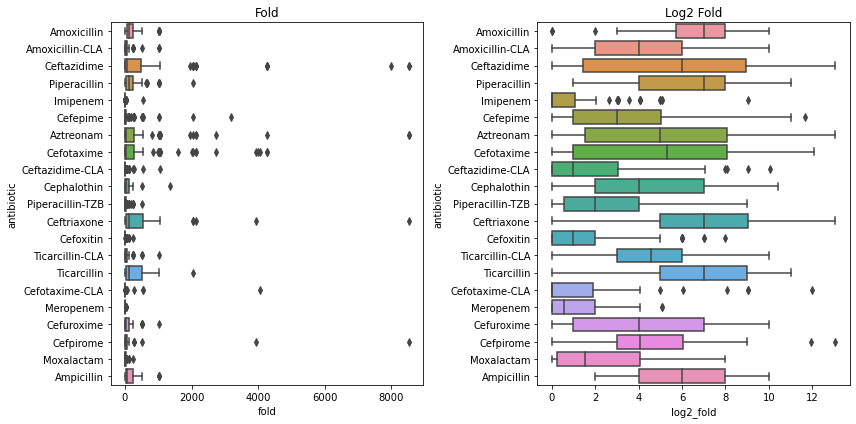

In [4]:
# plots
fig, axs = plt.subplots(nrows = 1, ncols = 2, figsize = (12, 6))

# fold
sns.boxplot(data = df, y = "antibiotic", x = "fold", ax = axs[0])
axs[0].set_title("Fold")

# log2_fold
sns.boxplot(data = df, y = "antibiotic", x = "log2_fold", ax = axs[1])
axs[1].set_title("Log2 Fold")

plt.tight_layout()
plt.show()

# select the best regressor

## esm1b

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using esm1b
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.40s/it]


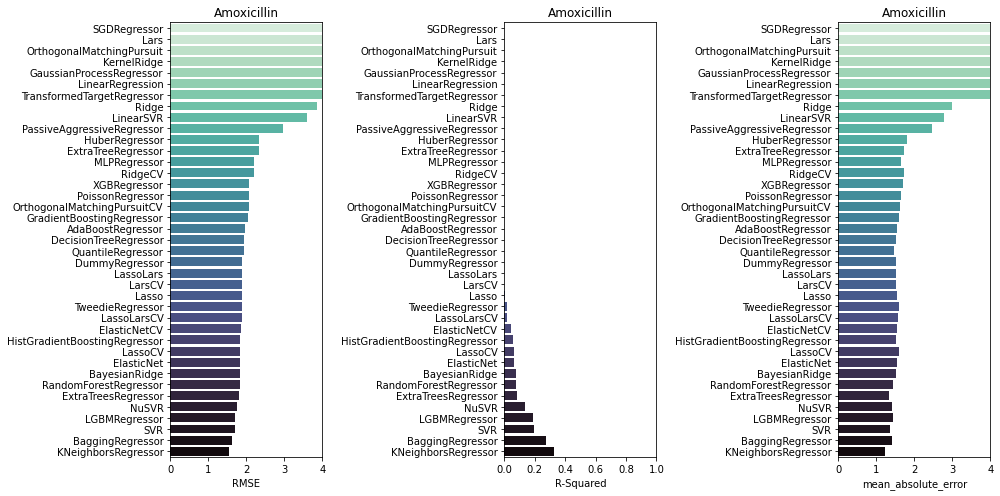

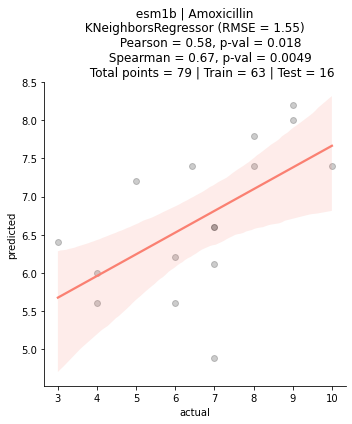

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using esm1b
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:08<00:00,  1.62s/it]


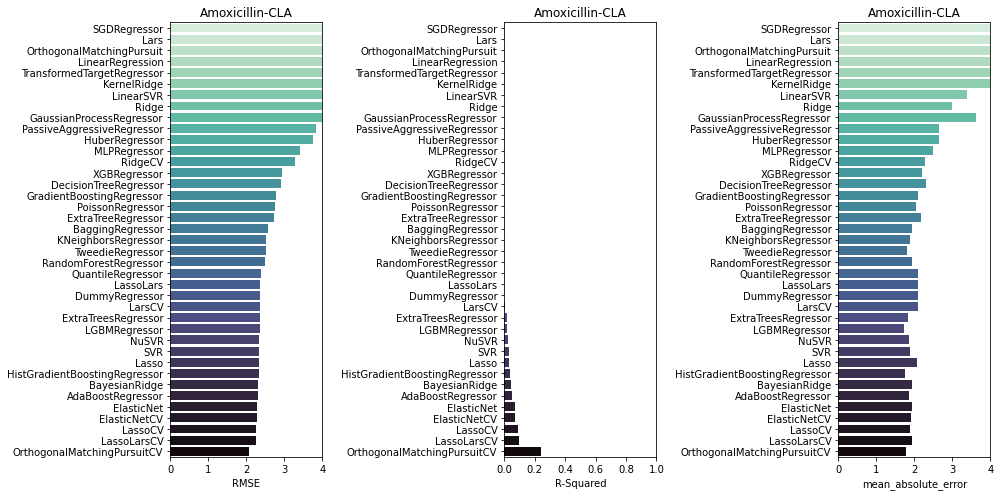

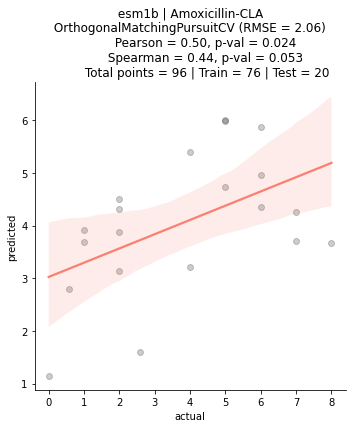

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using esm1b
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:22<00:00,  1.97s/it]


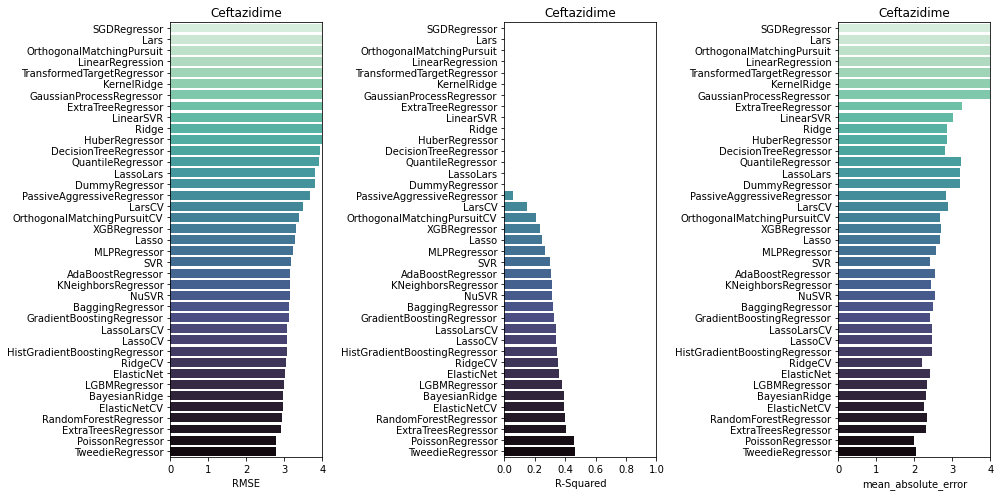

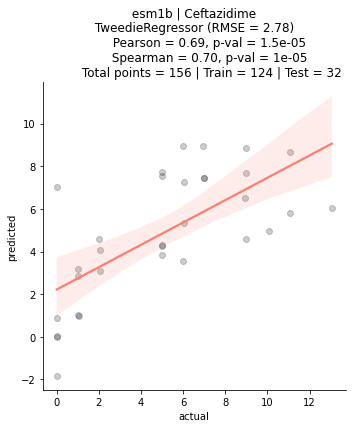

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using esm1b
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:11<00:00,  1.71s/it]


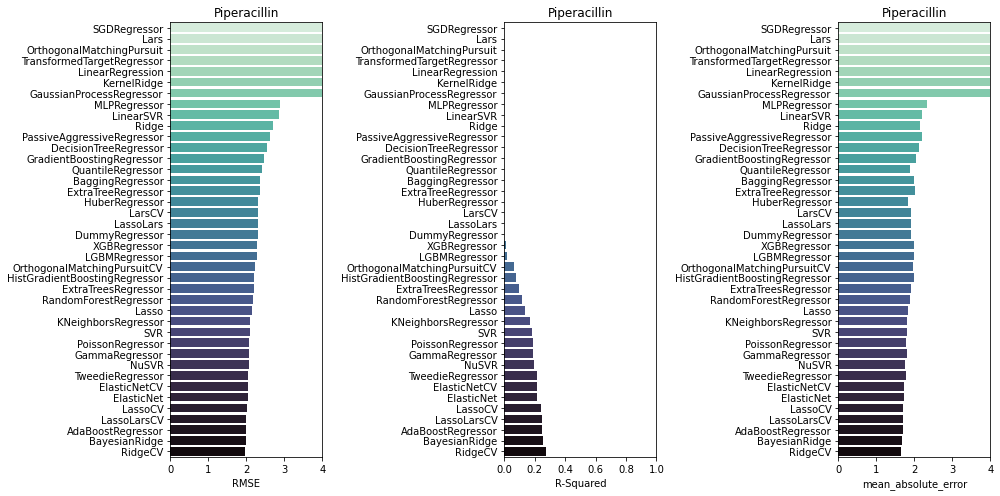

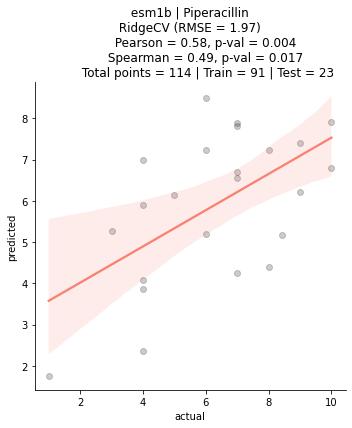

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using esm1b
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:15<00:00,  1.79s/it]


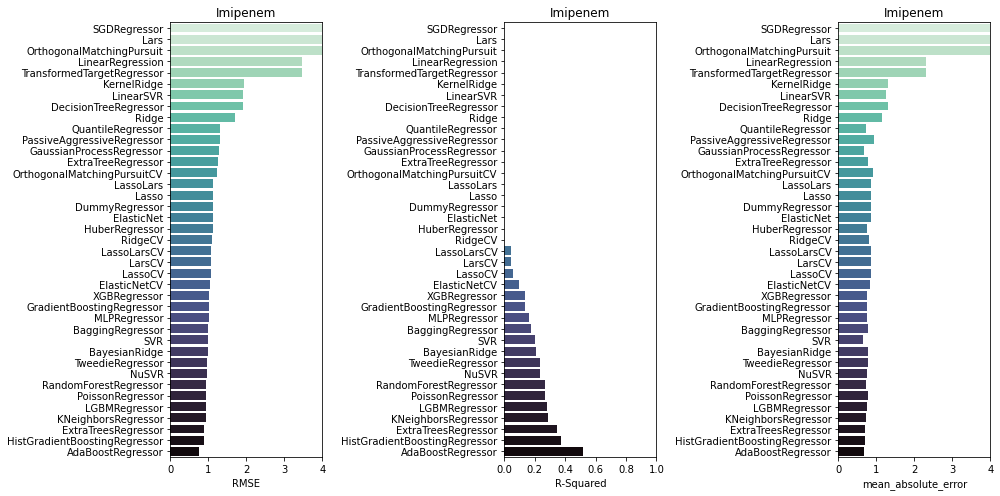

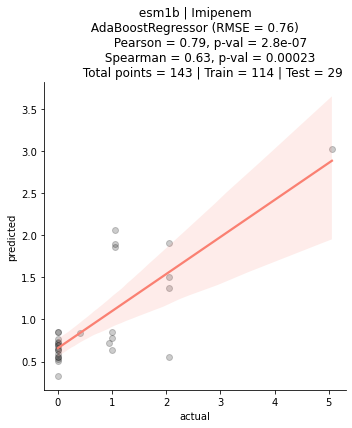

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using esm1b
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:51<00:00,  1.22s/it]


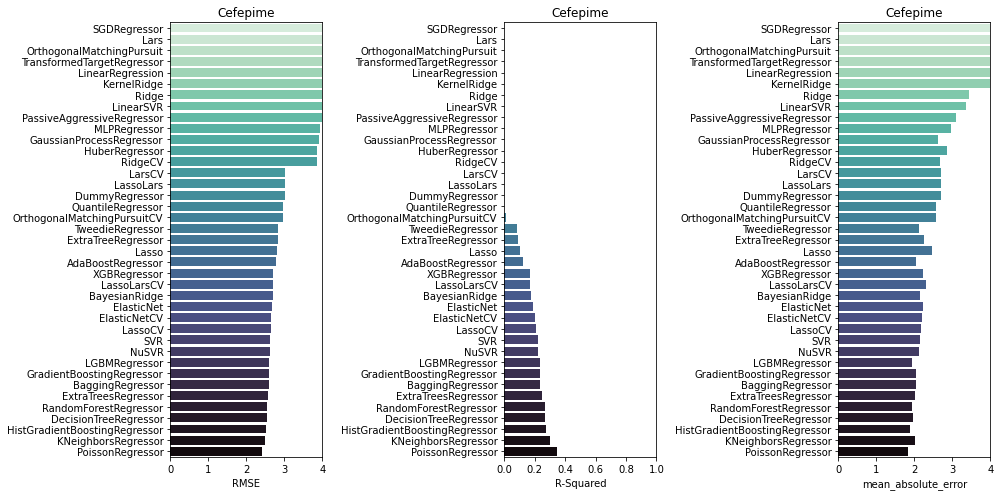

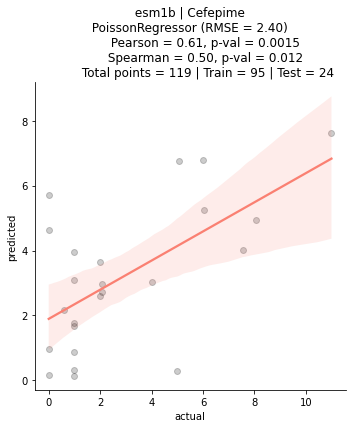

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using esm1b
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:12<00:00,  1.74s/it]


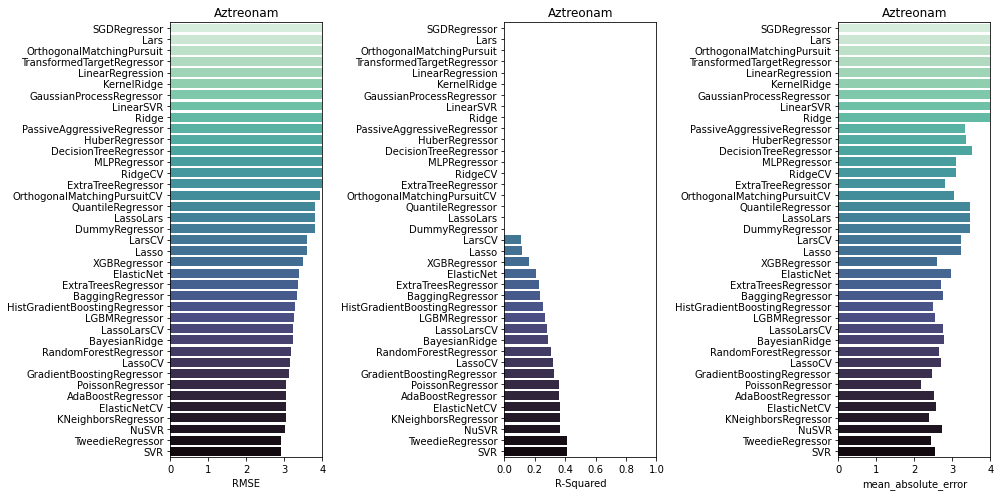

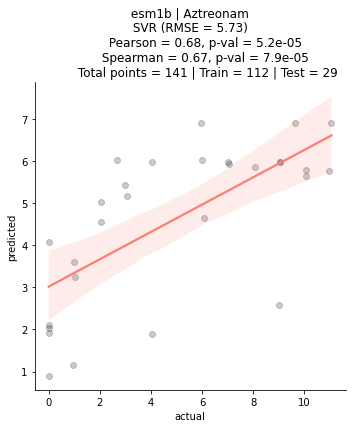

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using esm1b
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:57<00:00,  1.37s/it]


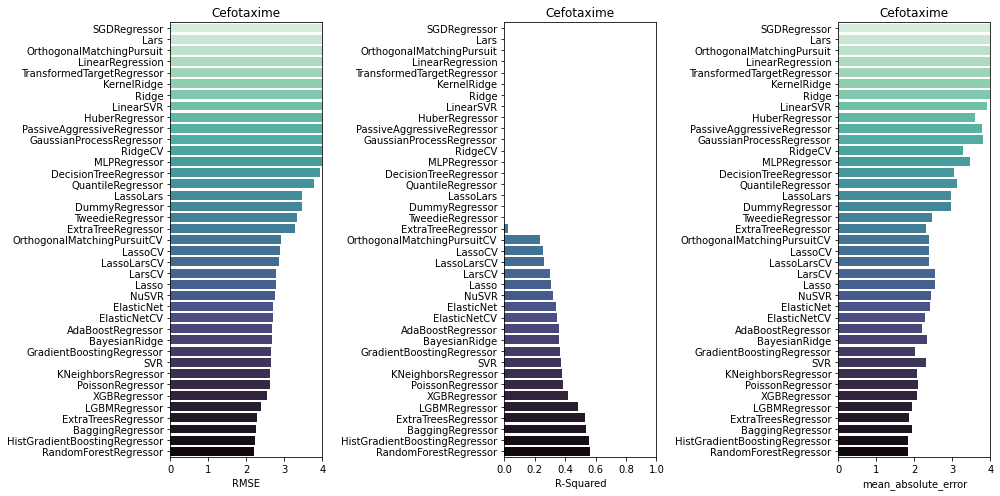

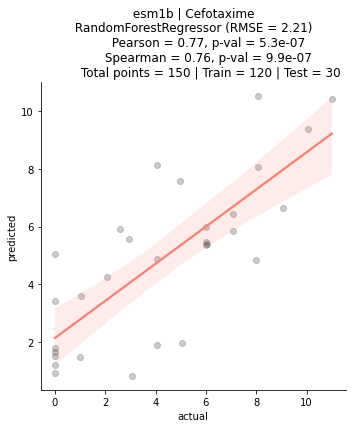

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using esm1b
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:54<00:00,  1.30s/it]


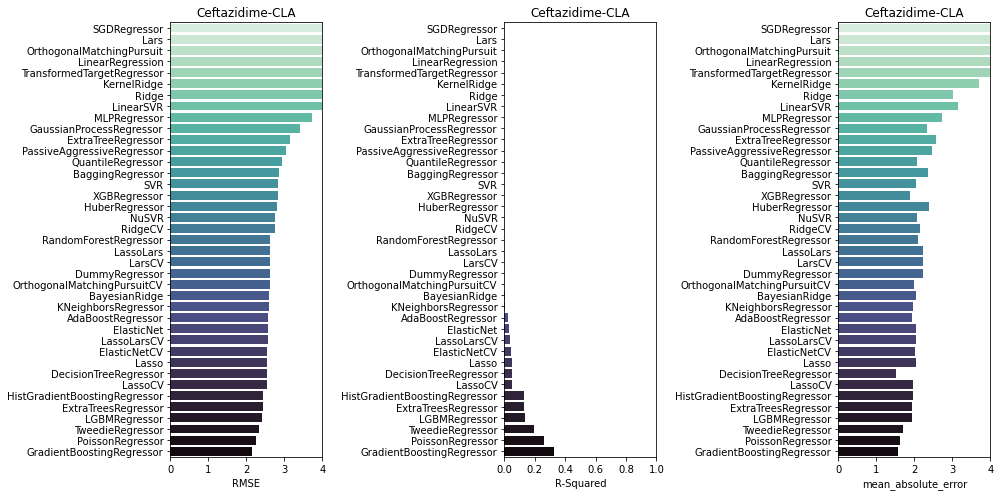

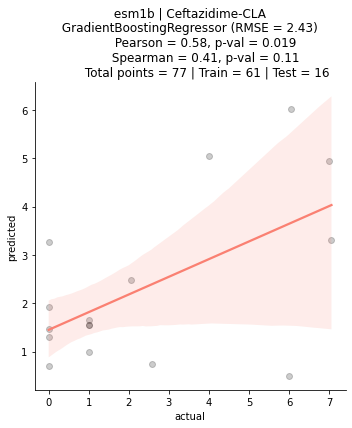

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using esm1b
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:56<00:00,  1.33s/it]


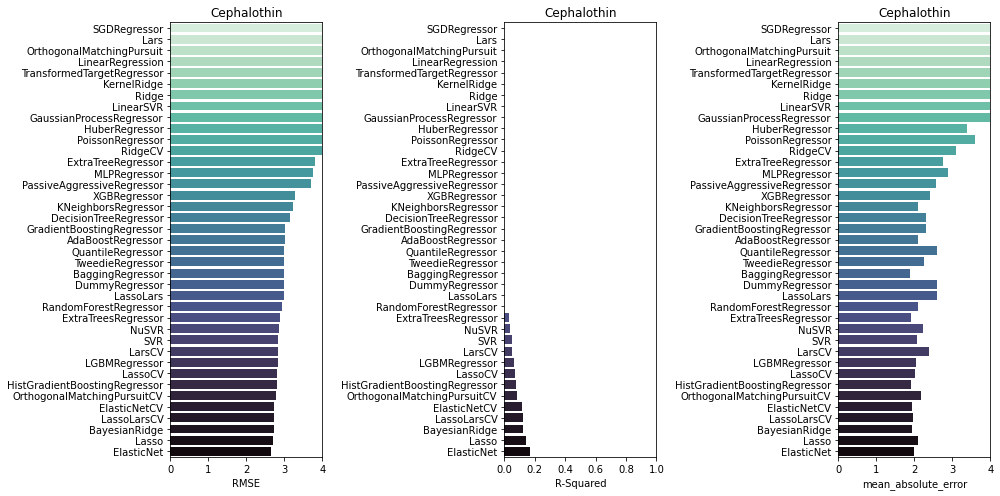

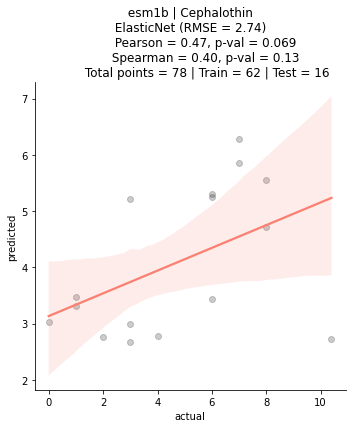

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using esm1b
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:09<00:00,  1.67s/it]


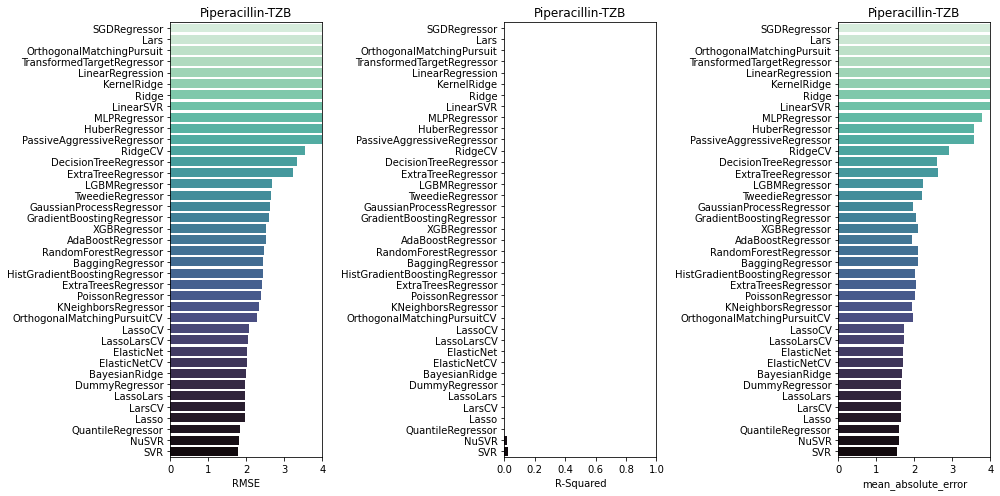

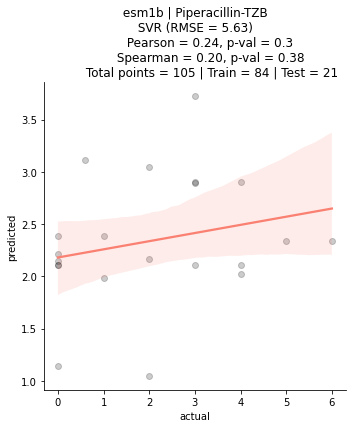

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using esm1b
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.00it/s]


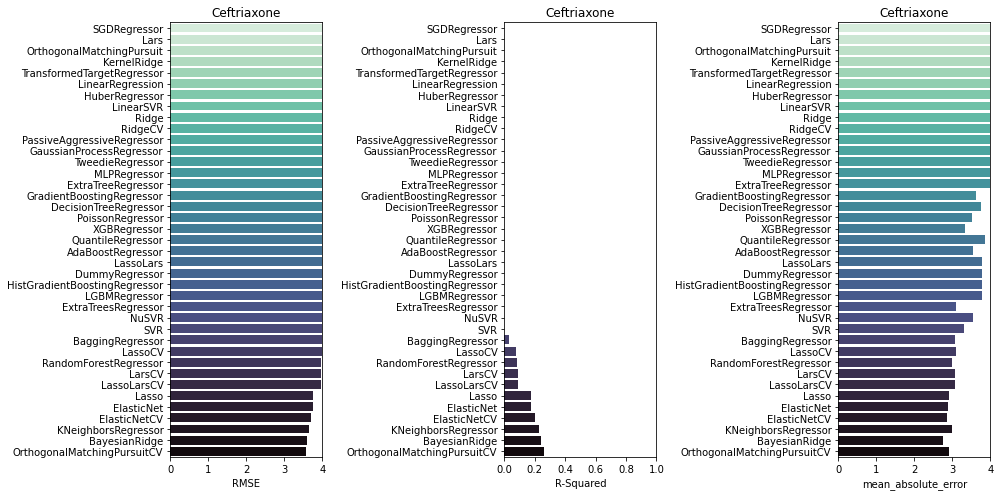

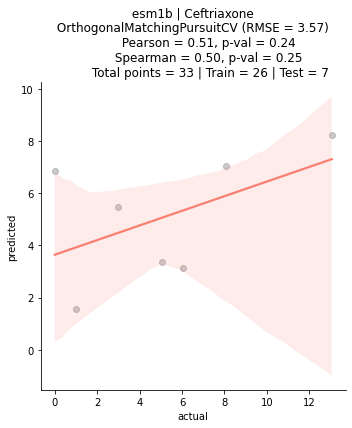

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using esm1b
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:57<00:00,  1.37s/it]


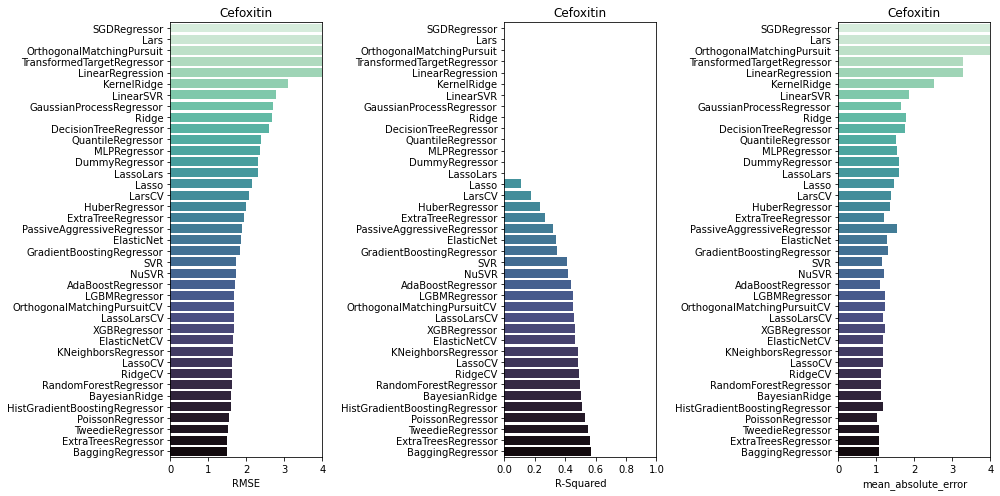

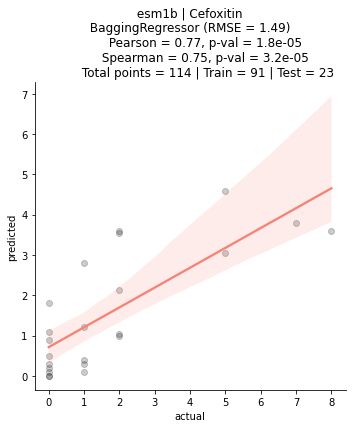

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using esm1b
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:46<00:00,  1.11s/it]


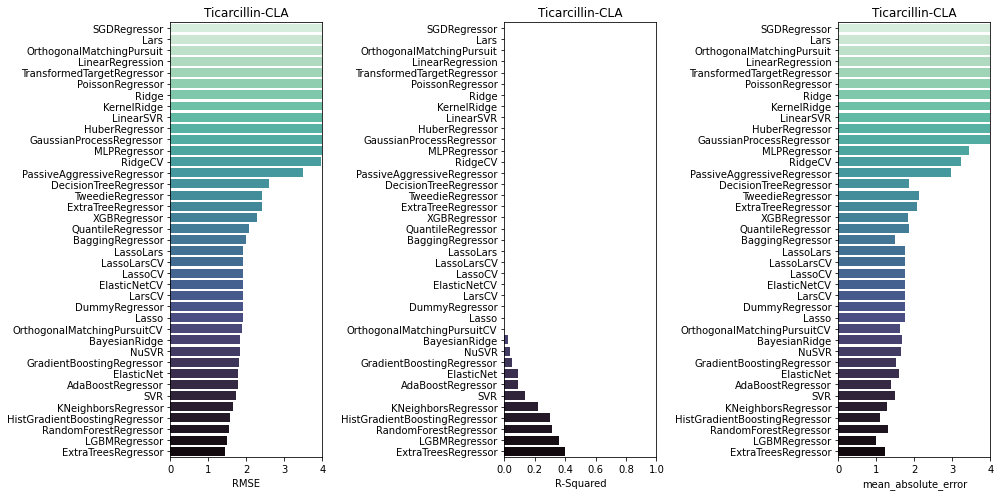

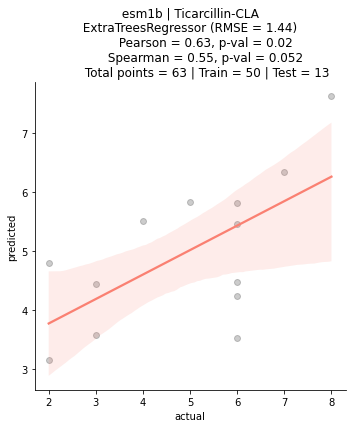

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using esm1b
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.52s/it]


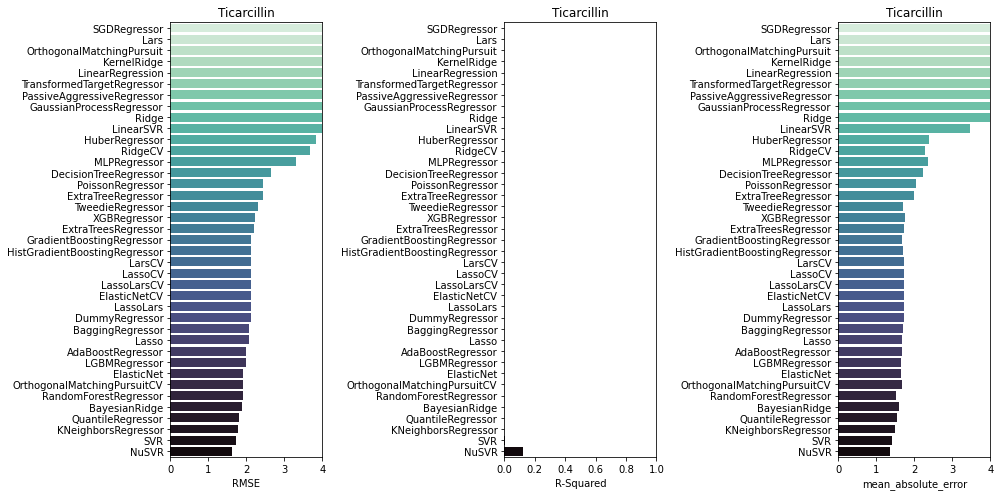

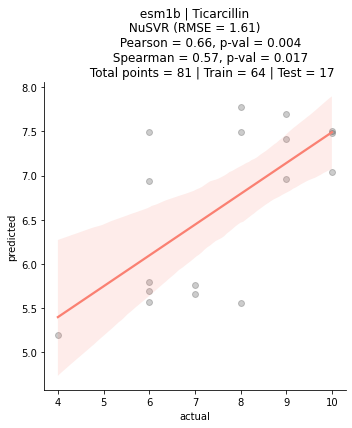

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using esm1b
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:36<00:00,  1.15it/s]


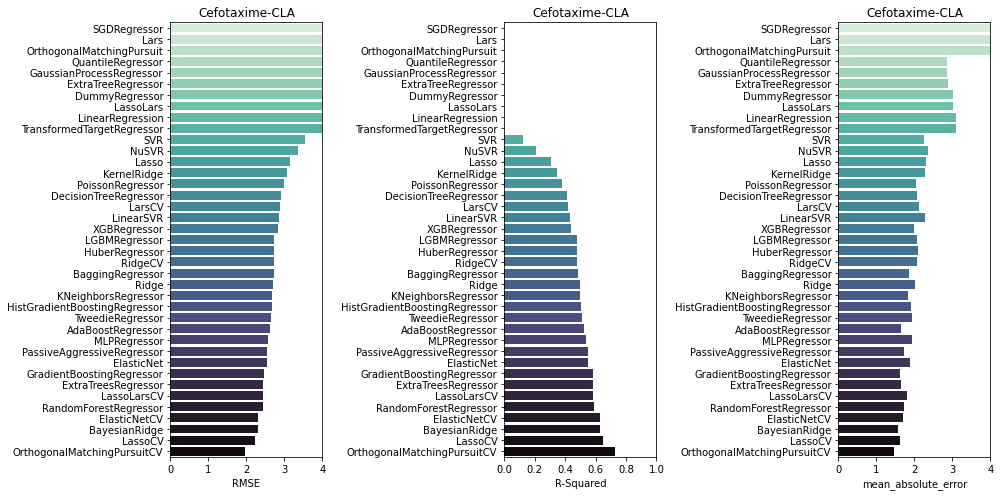

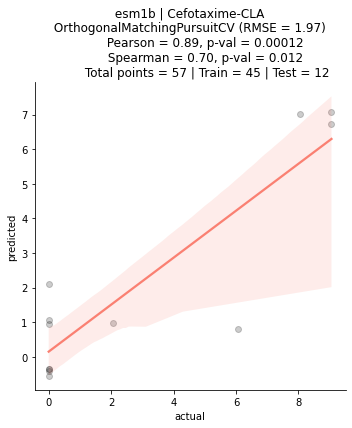

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using esm1b
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:46<00:00,  1.11s/it]


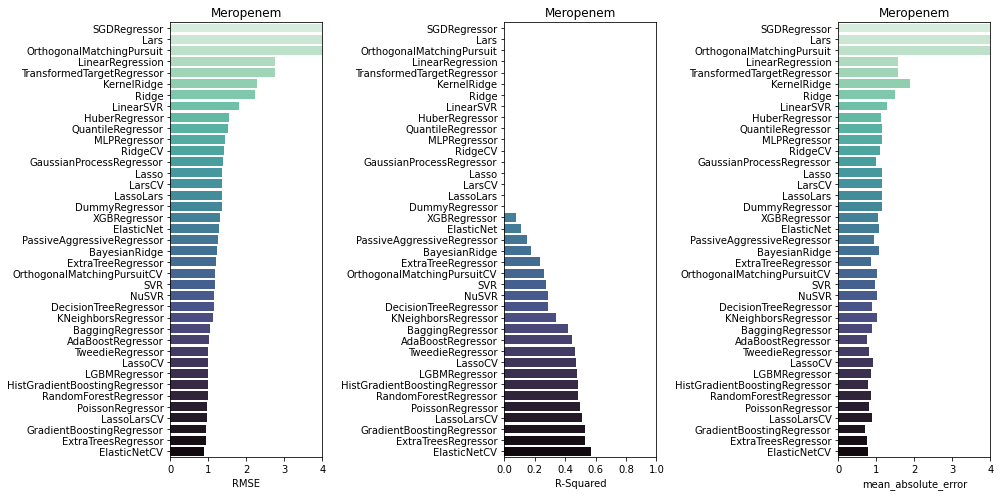

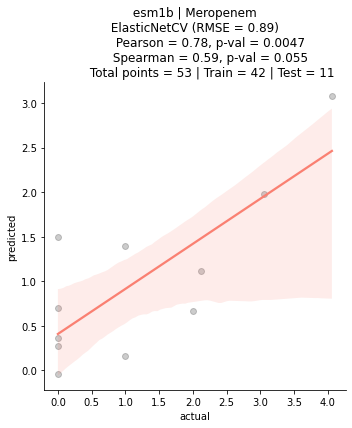

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using esm1b
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.21s/it]


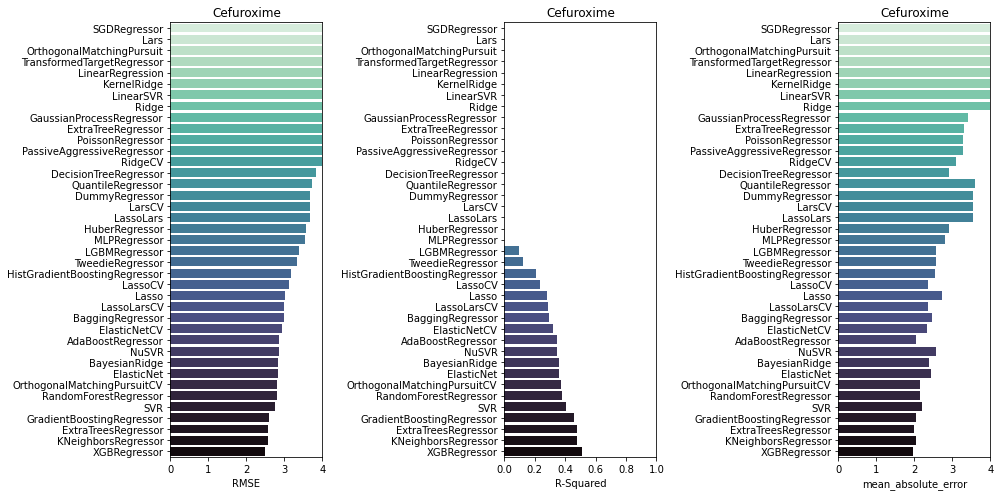

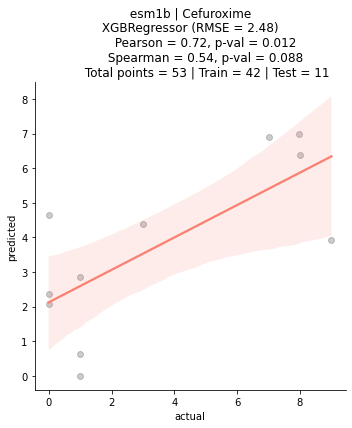

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using esm1b
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:45<00:00,  1.08s/it]


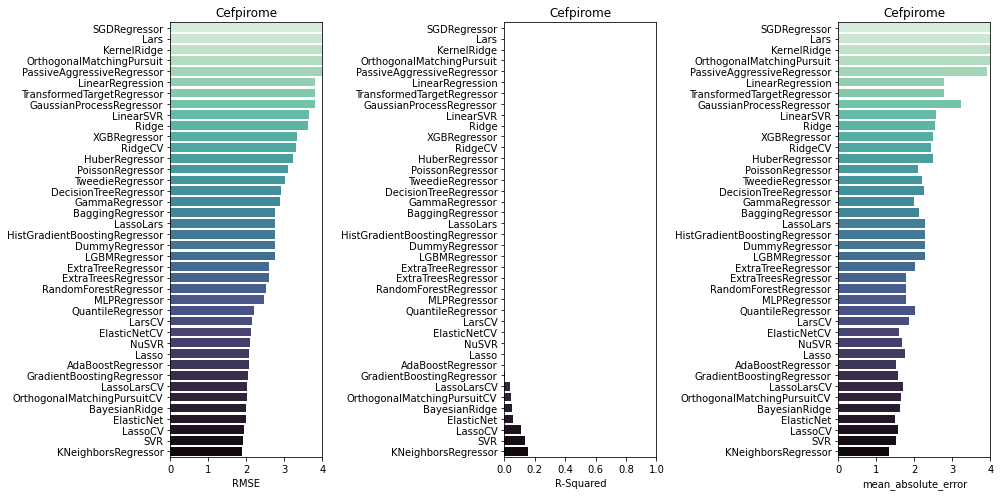

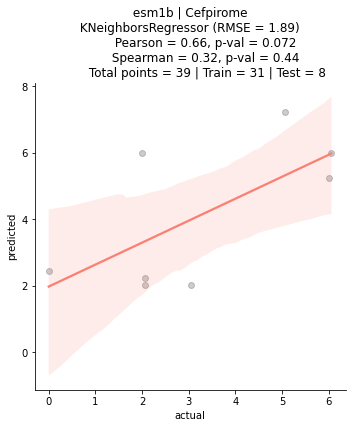

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using esm1b
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:37<00:00,  1.13it/s]


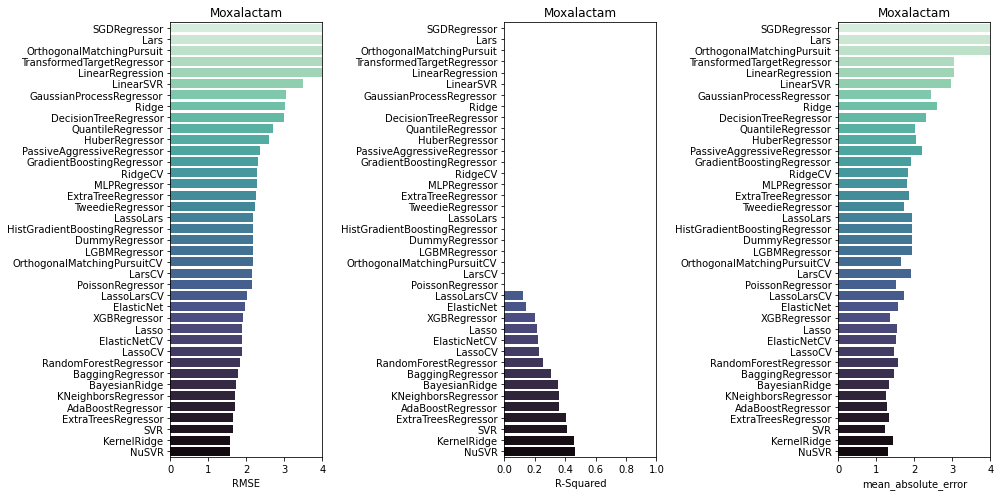

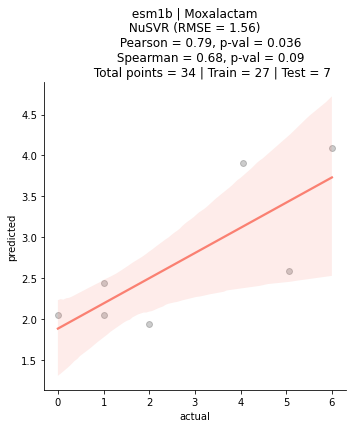

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using esm1b
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:07<00:00,  1.60s/it]


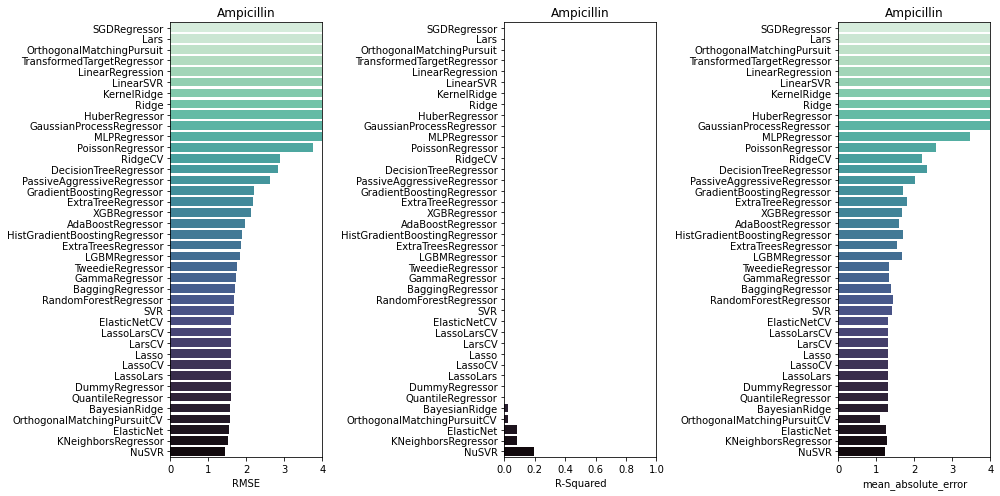

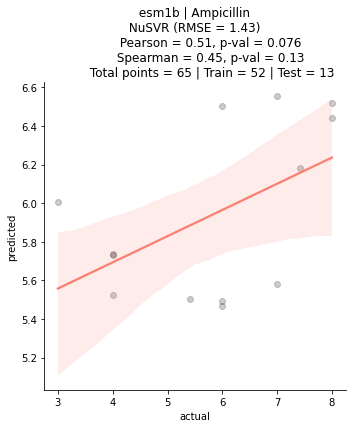

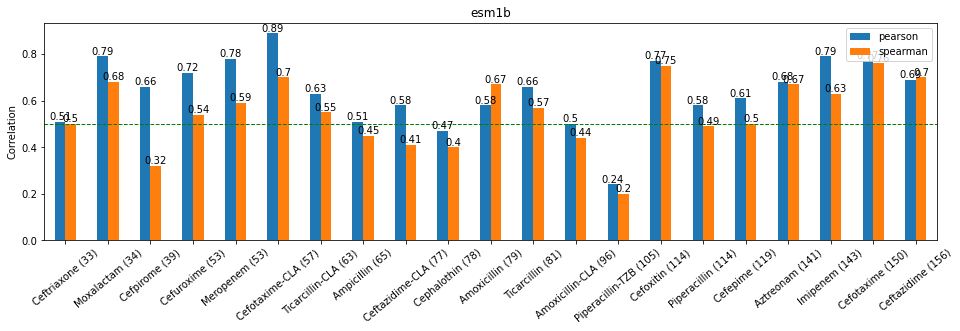

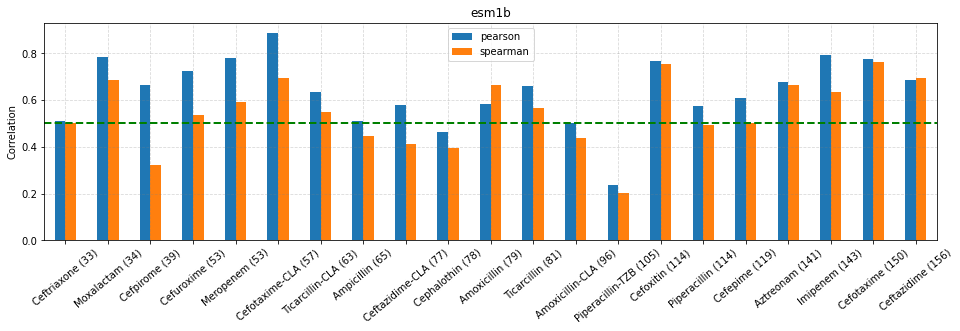

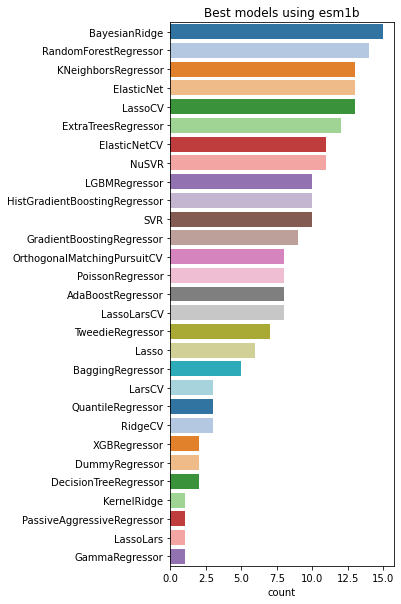

In [10]:
# set plm model
model = "esm1b"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select the antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split 20:80
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # add data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_esm1b = pd.DataFrame()
df_metrics_esm1b["anti"]         = anti_lst  
df_metrics_esm1b["best_model"]   = model_lst  
df_metrics_esm1b["rmse"]         = rmse_lst 
df_metrics_esm1b["mae"]          = mae_lst
df_metrics_esm1b["r2"]           = r_lst 
df_metrics_esm1b["pearson"]      = pear_lst 
df_metrics_esm1b["pearson_p"]    = pearp_lst 
df_metrics_esm1b["spearman"]     = spear_lst 
df_metrics_esm1b["spearman_p"]   = spearp_lst 
df_metrics_esm1b["data_size"]    = data_size_lst 
df_metrics_esm1b["train_size"]   = train_size_lst 
df_metrics_esm1b["test_size"]    = test_size_lst 
df_metrics_esm1b["top10_models"] = top10_models_lst
df_metrics_esm1b["anti_lab"]     = df_metrics_esm1b["anti"] + " " + "(" + df_metrics_esm1b["data_size"].astype(str) + ")"
df_metrics_esm1b = df_metrics_esm1b.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_esm1b.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_esm1b.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_esm1b.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_esm1b.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## T5-XL U50

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using t5xlu50
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:51<00:00,  1.22s/it]


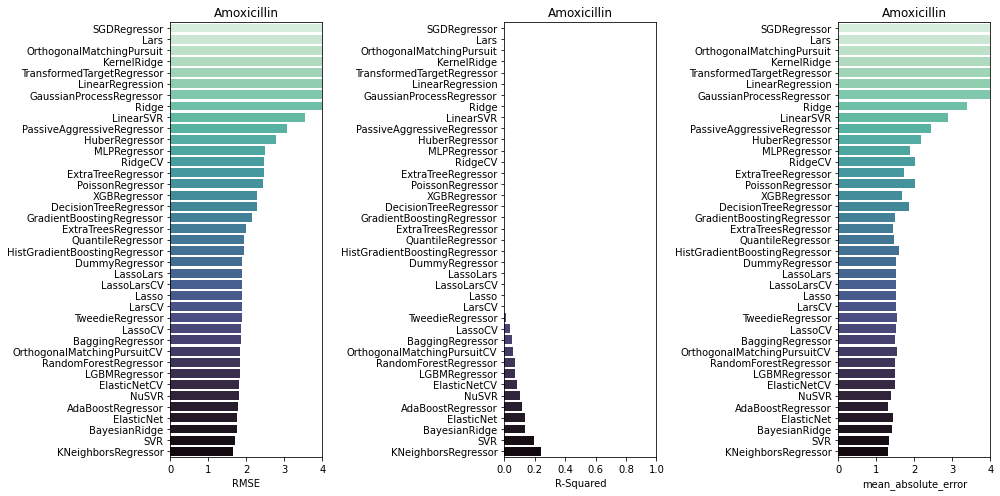

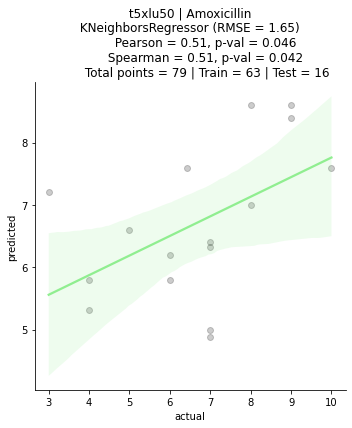

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using t5xlu50
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:56<00:00,  1.36s/it]


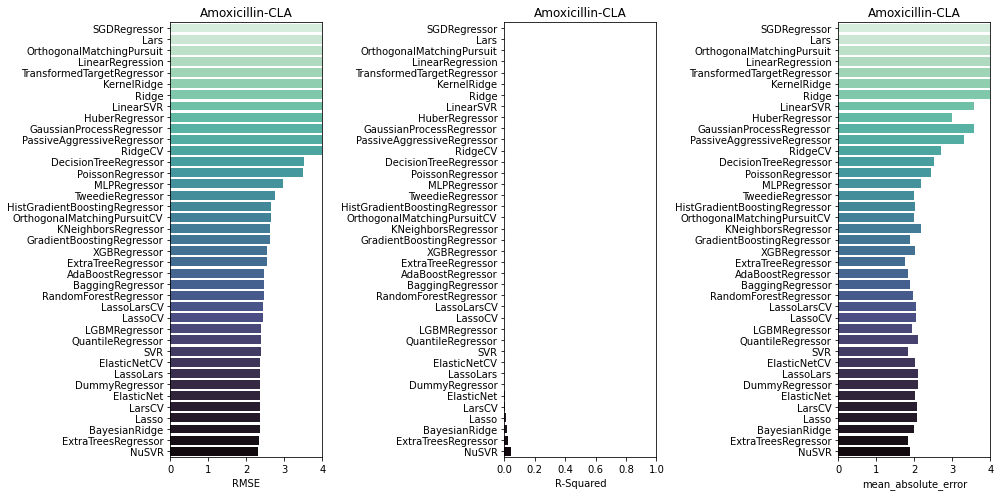

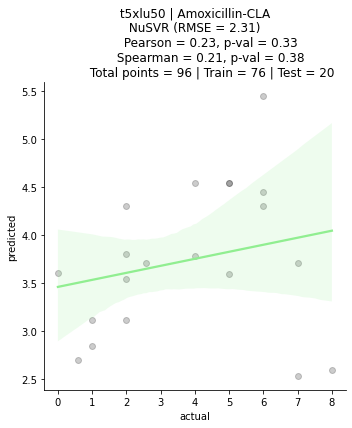

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using t5xlu50
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:06<00:00,  1.58s/it]


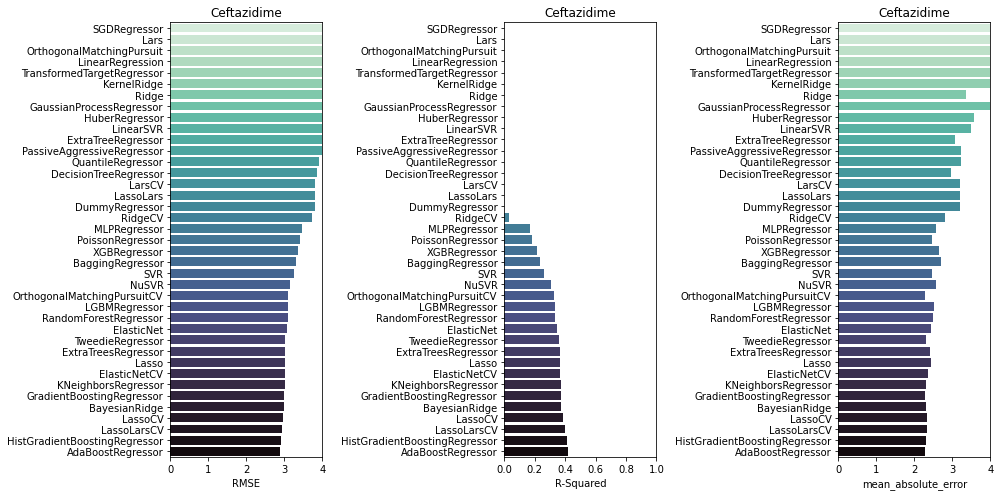

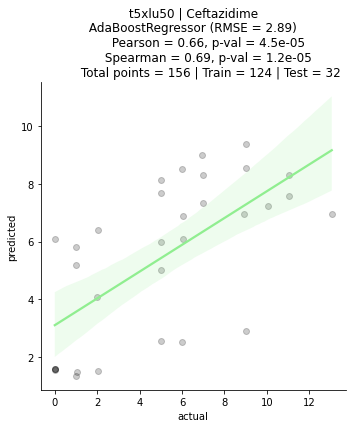

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using t5xlu50
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:00<00:00,  1.44s/it]


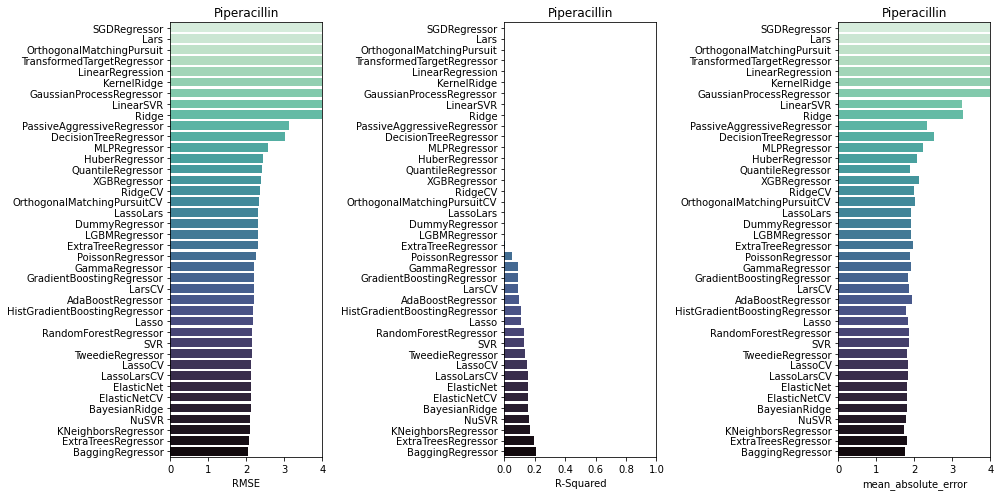

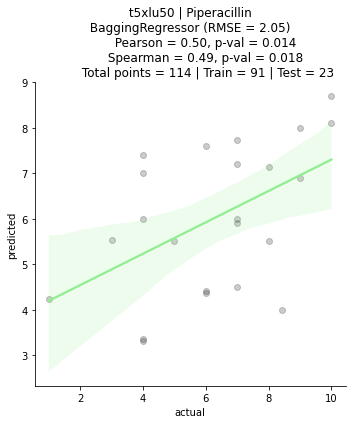

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using t5xlu50
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.39s/it]


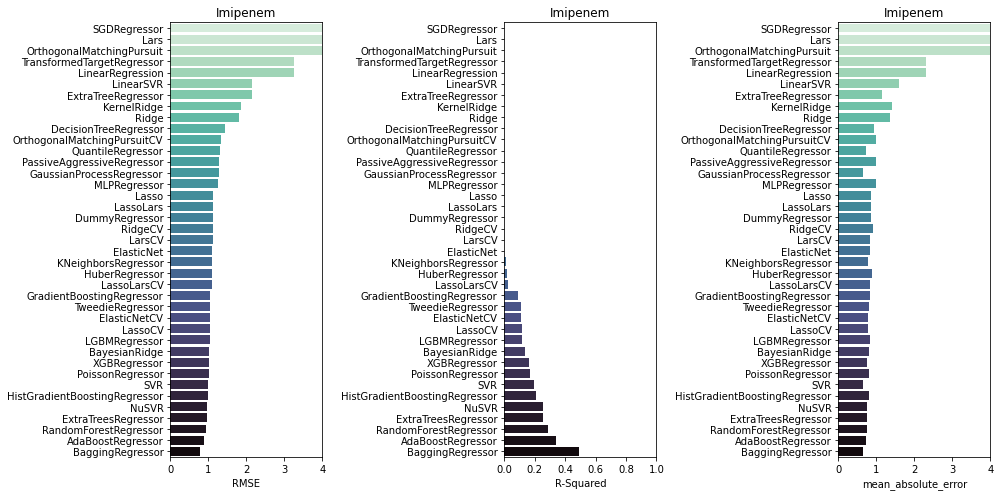

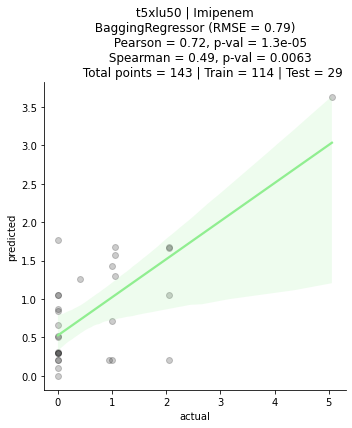

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using t5xlu50
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:45<00:00,  1.08s/it]


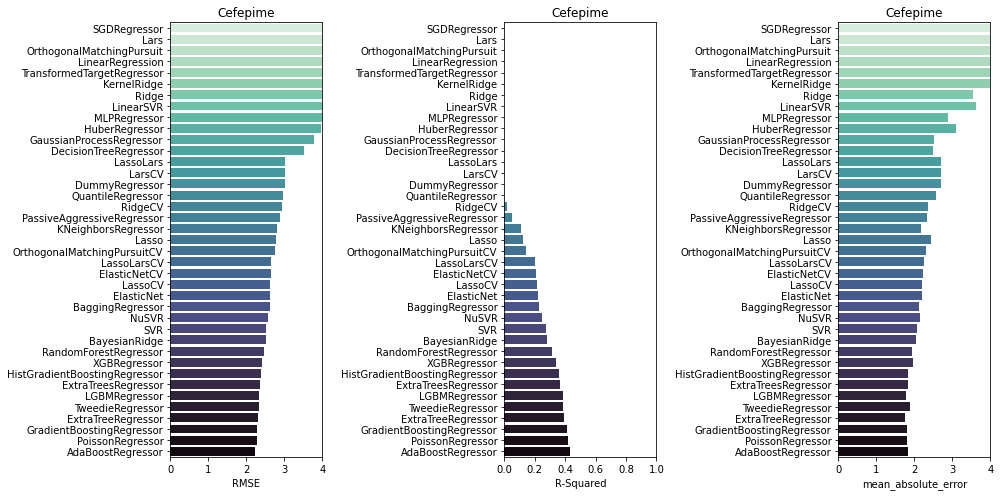

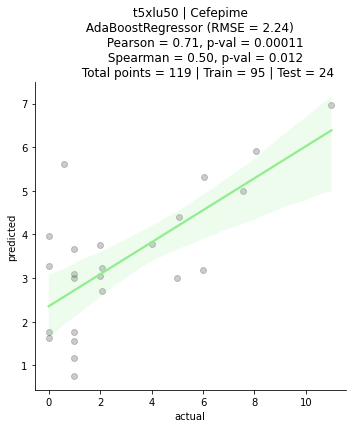

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using t5xlu50
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:04<00:00,  1.53s/it]


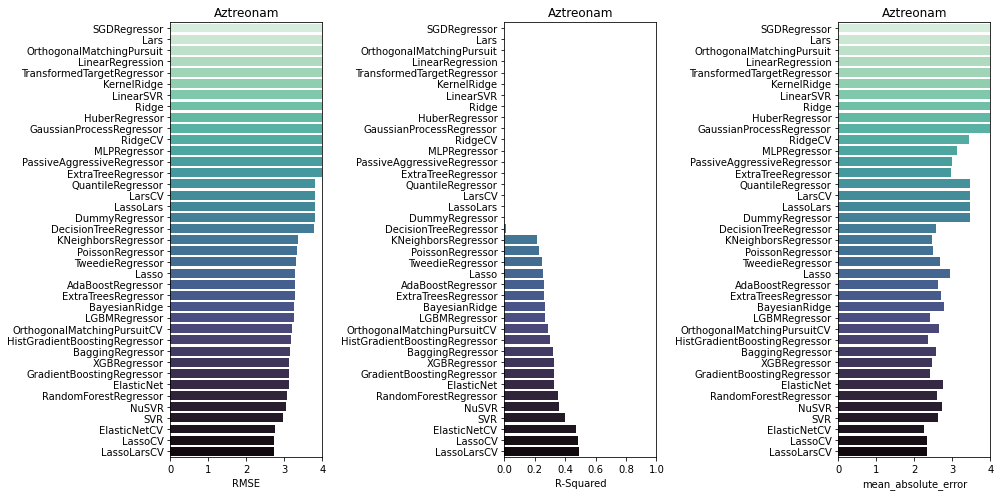

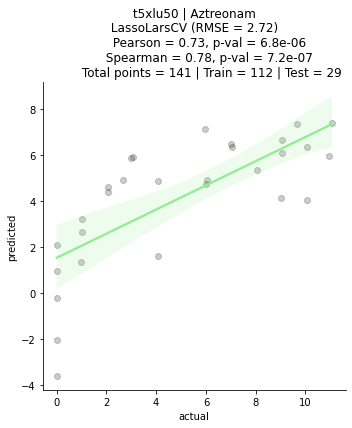

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using t5xlu50
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.13s/it]


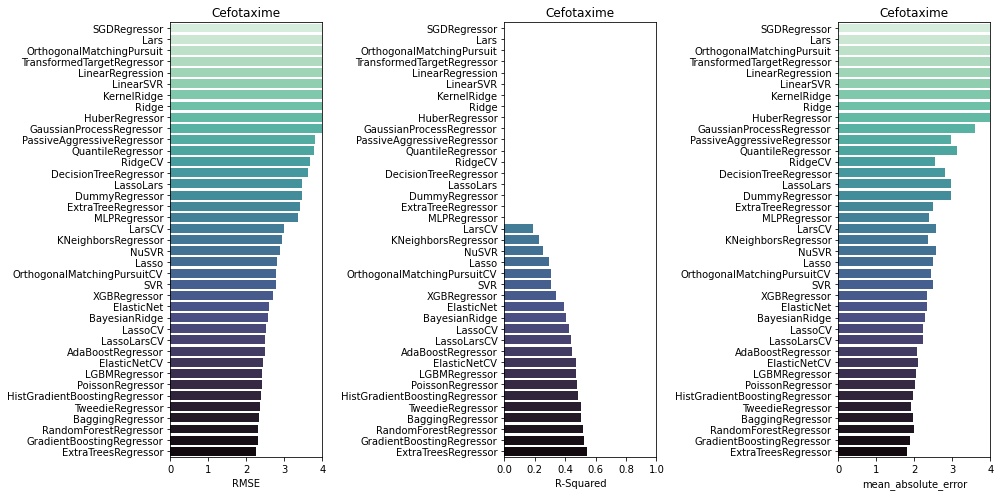

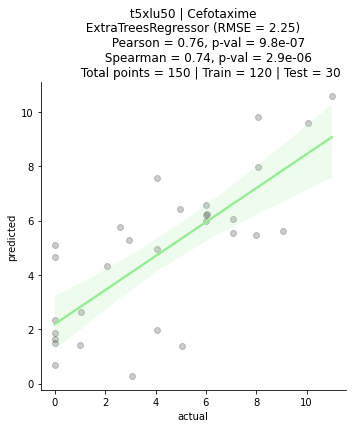

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using t5xlu50
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.14s/it]


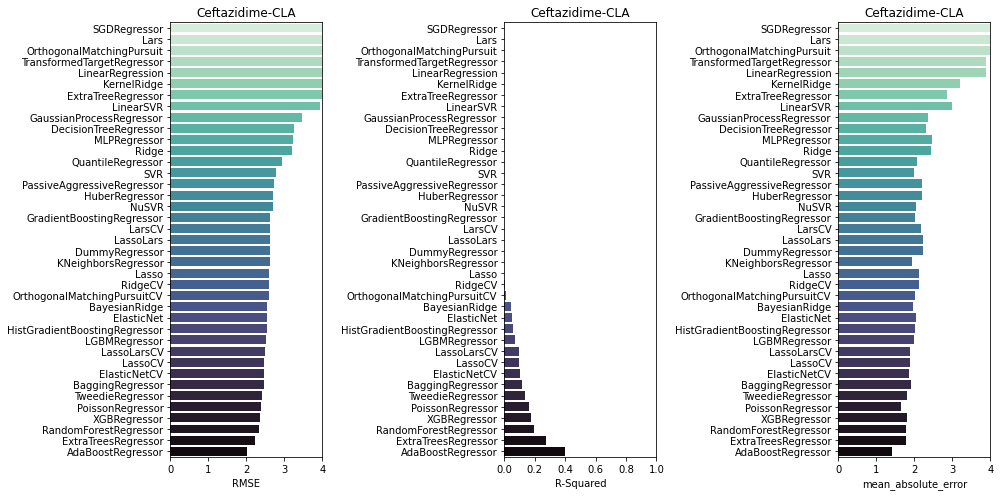

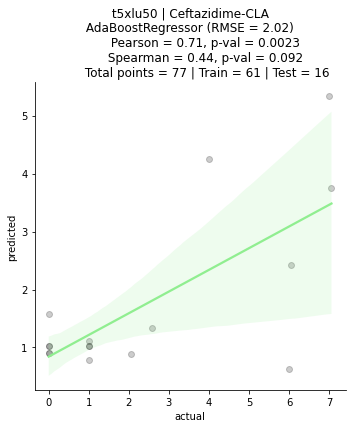

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using t5xlu50
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.14s/it]


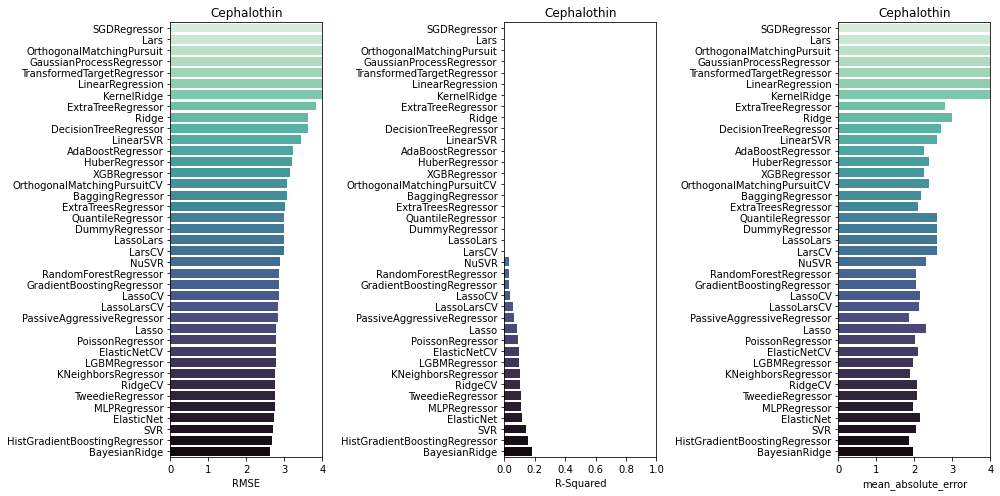

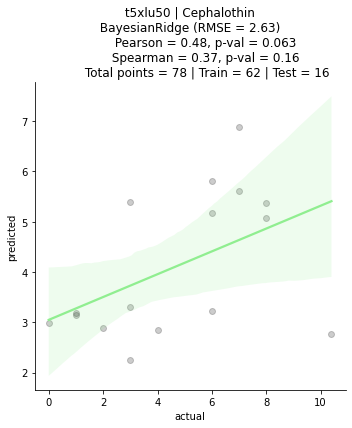

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using t5xlu50
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:57<00:00,  1.38s/it]


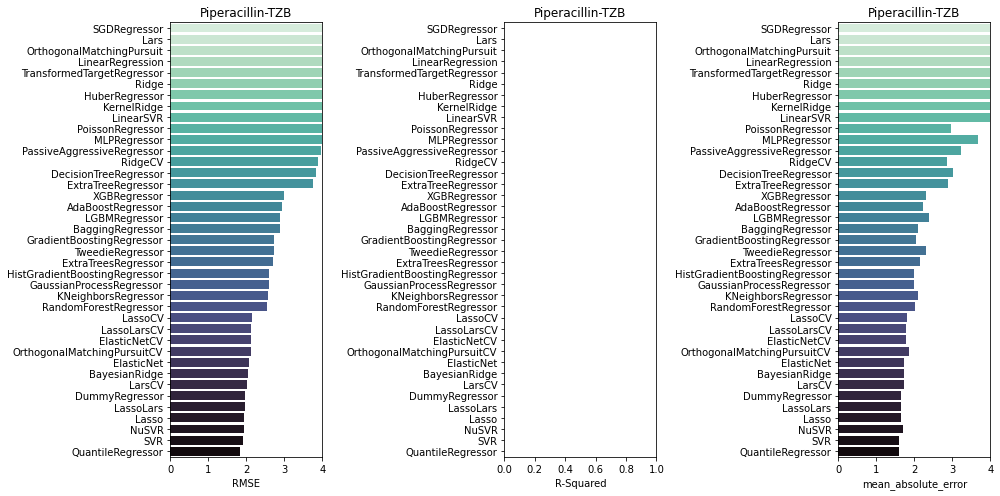

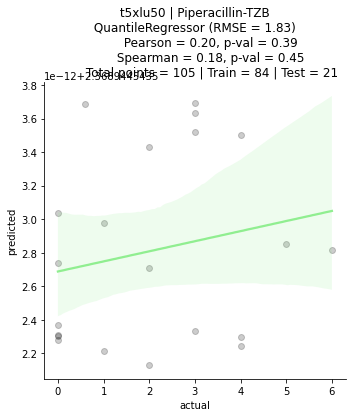

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using t5xlu50
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:38<00:00,  1.10it/s]


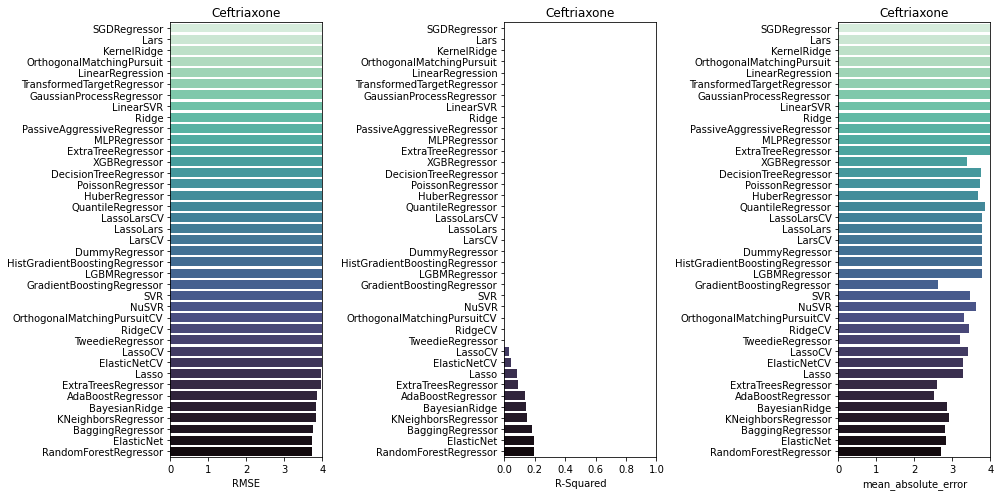

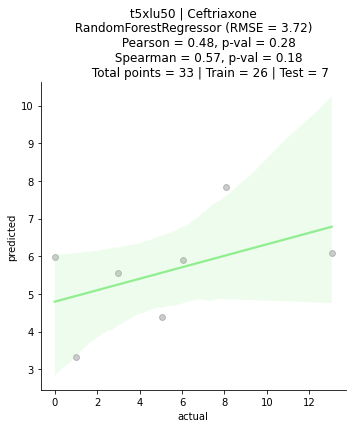

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using t5xlu50
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.21s/it]


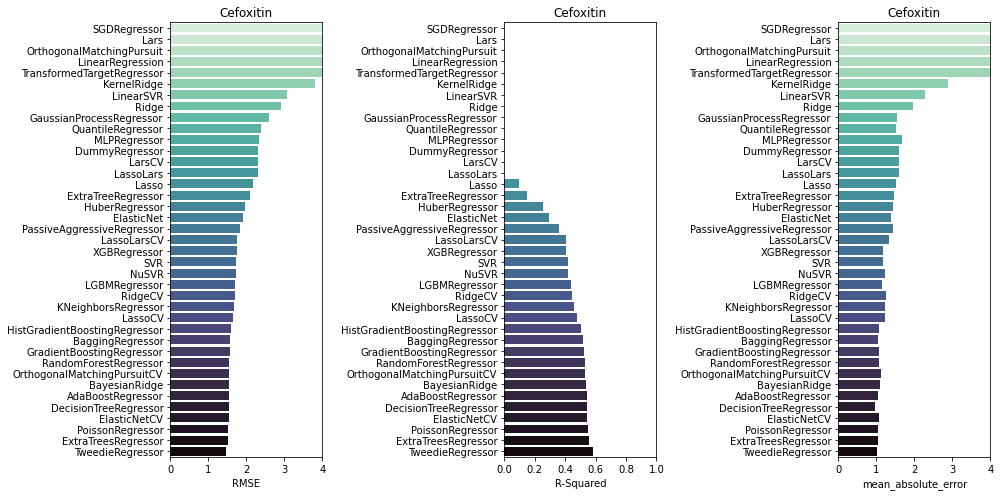

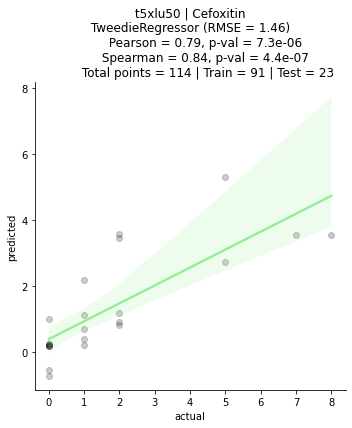

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using t5xlu50
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.00it/s]


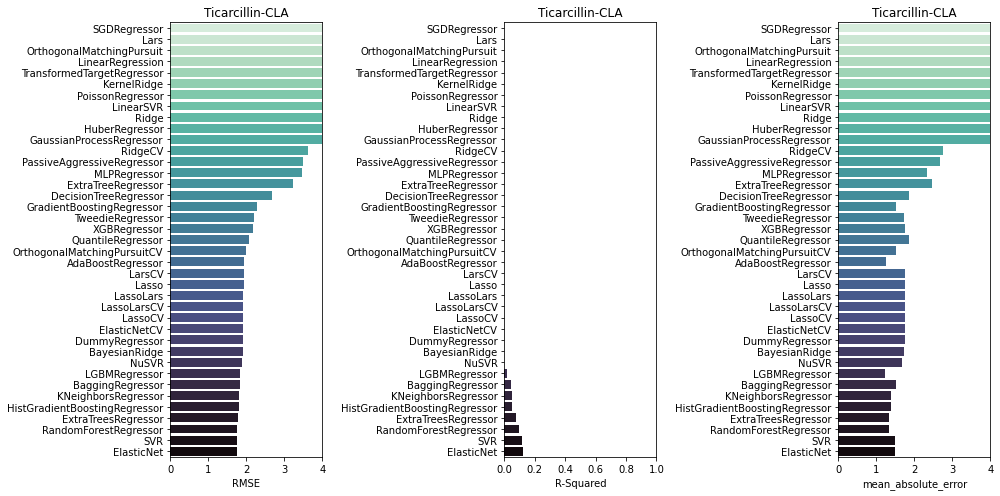

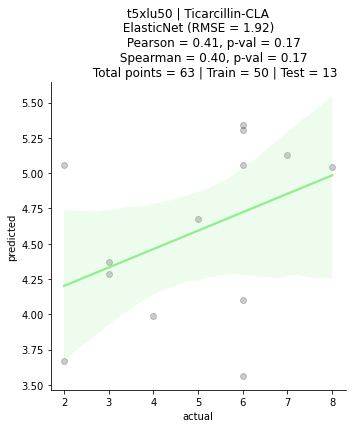

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using t5xlu50
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.32s/it]


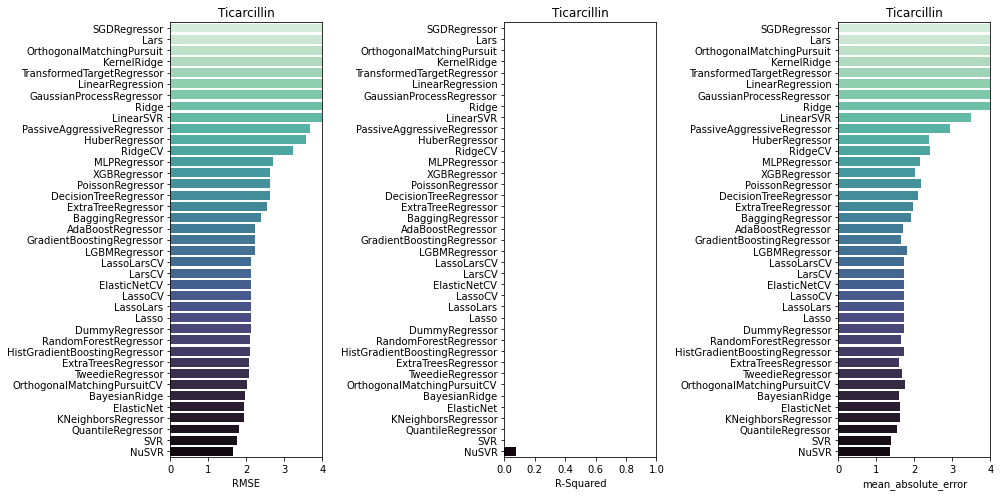

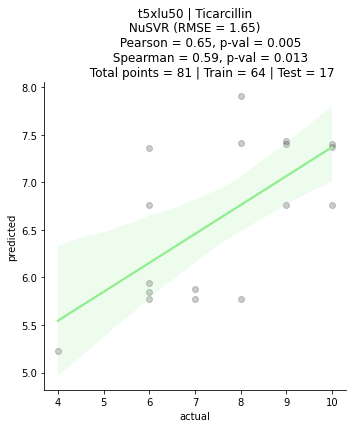

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using t5xlu50
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:31<00:00,  1.35it/s]


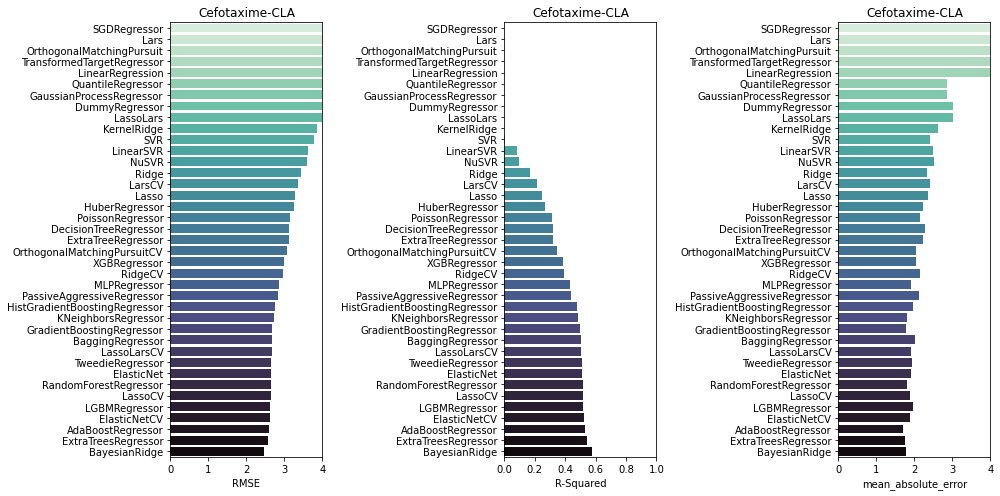

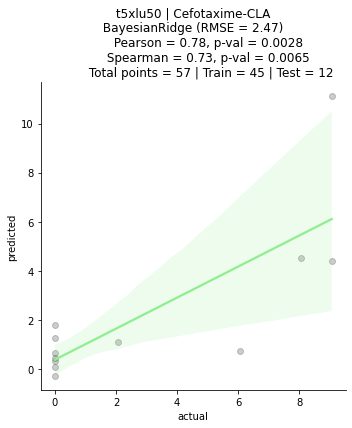

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using t5xlu50
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:38<00:00,  1.10it/s]


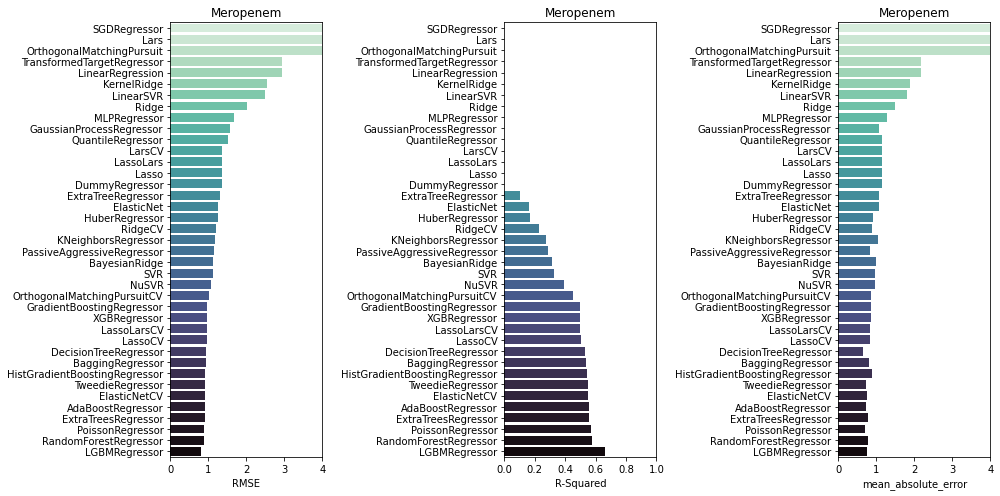

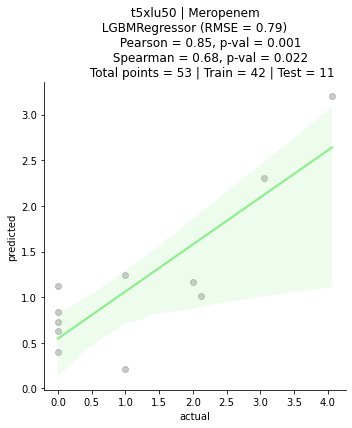

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using t5xlu50
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.02it/s]


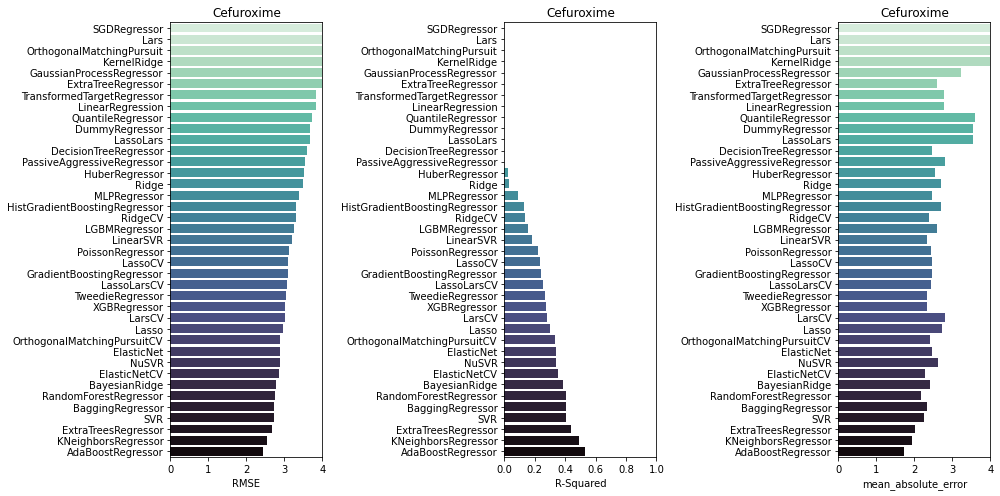

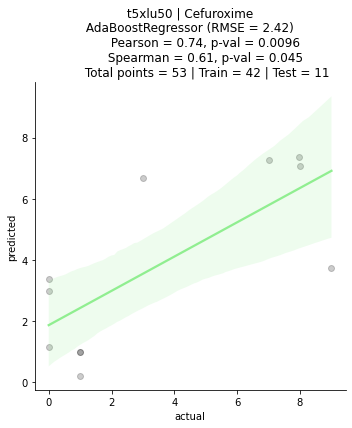

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using t5xlu50
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:38<00:00,  1.10it/s]


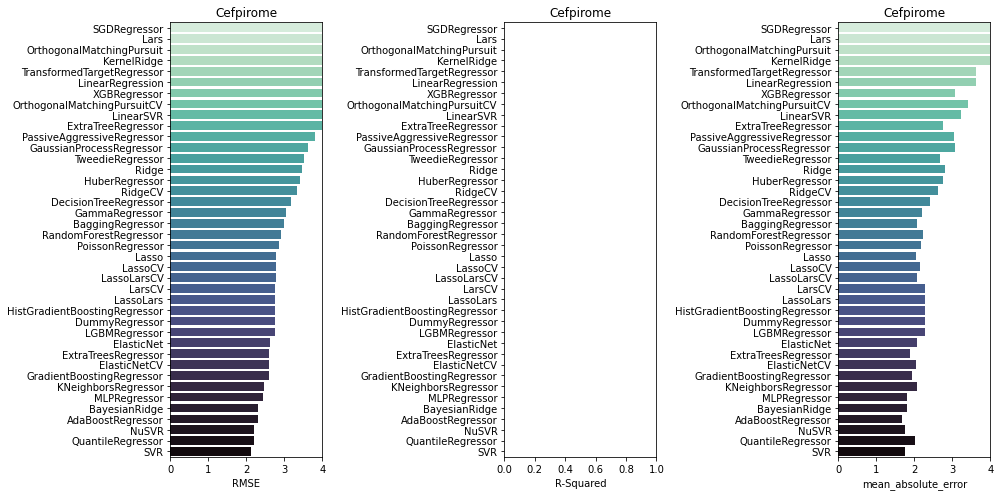

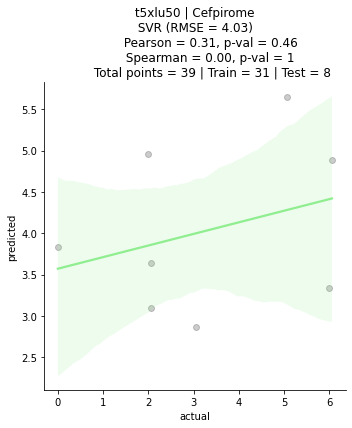

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using t5xlu50
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:30<00:00,  1.40it/s]


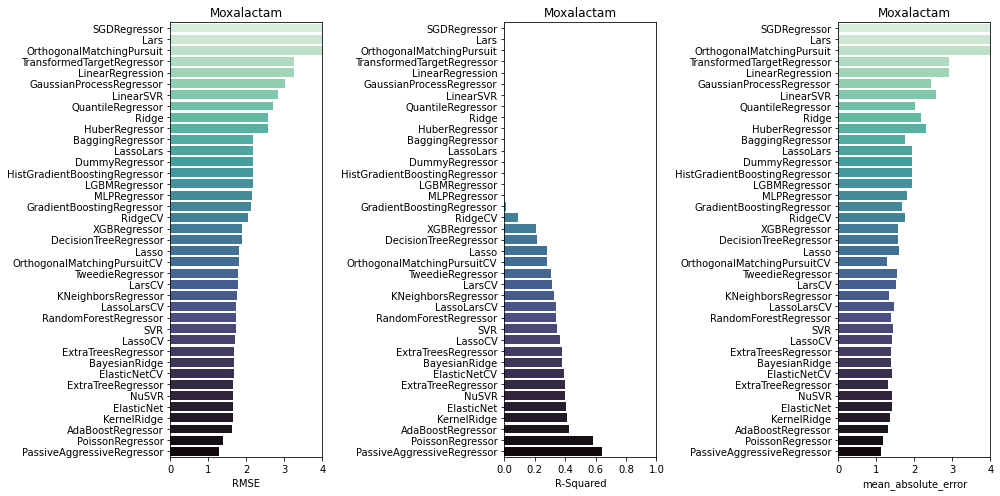

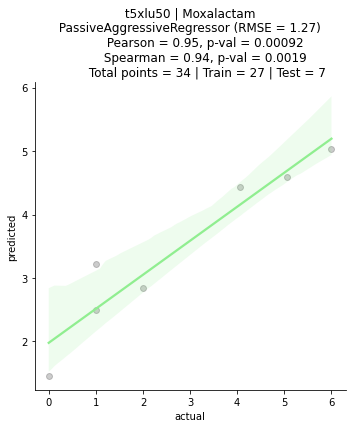

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using t5xlu50
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:56<00:00,  1.35s/it]


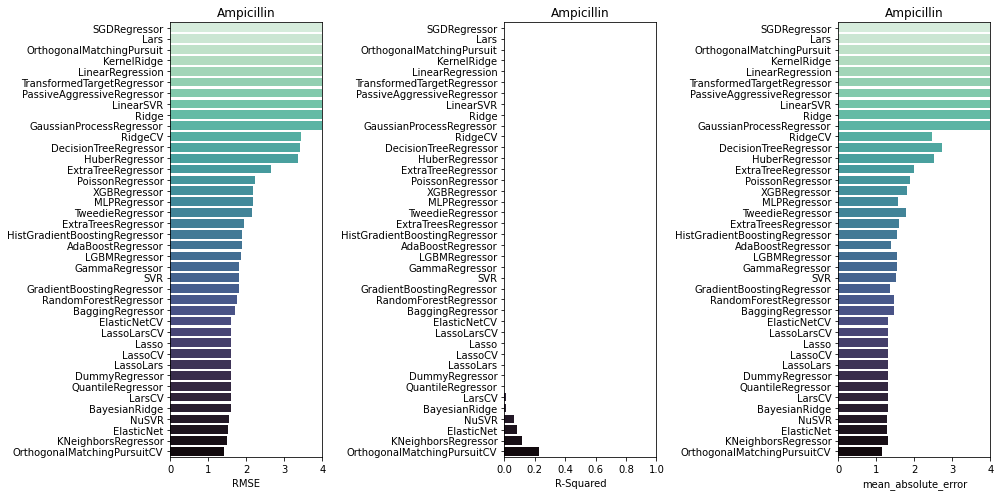

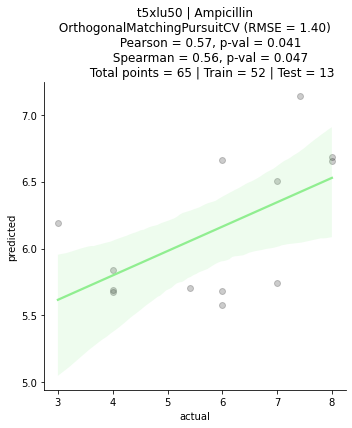

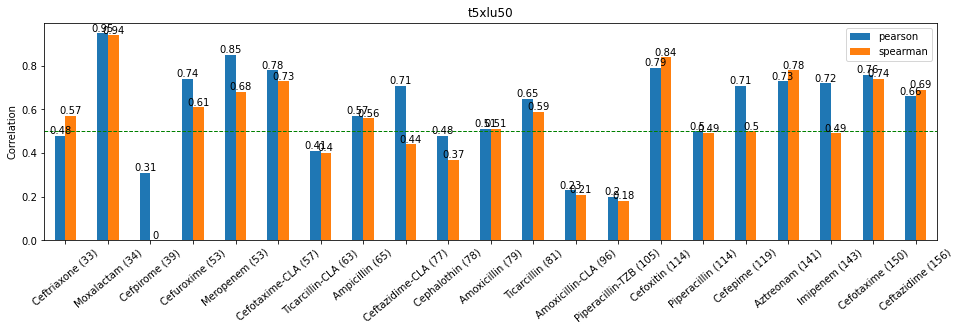

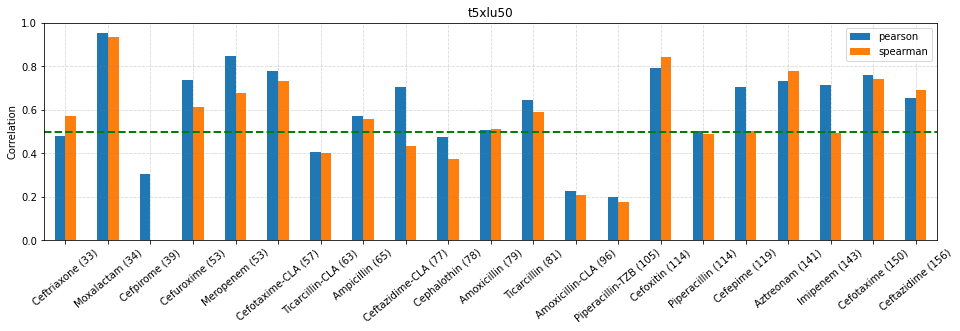

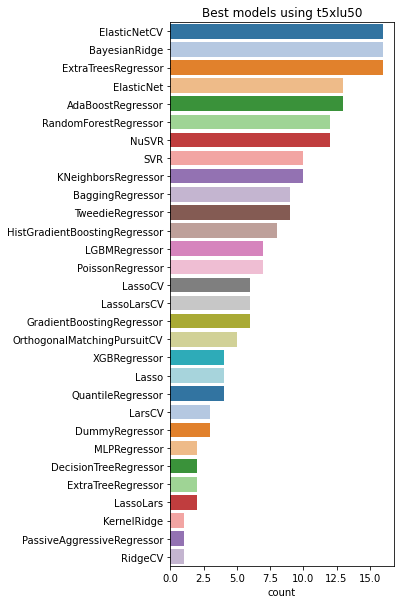

In [11]:
# set plm model
model = "t5xlu50" 

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "lightgreen"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_t5 = pd.DataFrame()
df_metrics_t5["anti"]         = anti_lst  
df_metrics_t5["best_model"]   = model_lst  
df_metrics_t5["rmse"]         = rmse_lst 
df_metrics_t5["mae"]          = mae_lst
df_metrics_t5["r2"]           = r_lst 
df_metrics_t5["pearson"]      = pear_lst 
df_metrics_t5["pearson_p"]    = pearp_lst 
df_metrics_t5["spearman"]     = spear_lst 
df_metrics_t5["spearman_p"]   = spearp_lst 
df_metrics_t5["data_size"]    = data_size_lst 
df_metrics_t5["train_size"]   = train_size_lst 
df_metrics_t5["test_size"]    = test_size_lst 
df_metrics_t5["top10_models"] = top10_models_lst
df_metrics_t5["anti_lab"]     = df_metrics_t5["anti"] + " " + "(" + df_metrics_t5["data_size"].astype(str) + ")"
df_metrics_t5 = df_metrics_t5.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_t5.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_t5.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_t5.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_t5.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## PCA-ESM1b

Explained variance ratio: 
 [0.36342363 0.26880652 0.08175439 0.0593056  0.05437254 0.02702438
 0.02041077 0.01751934 0.01464088 0.01260529 0.00941019 0.00897369
 0.00702316 0.00546116 0.00507276 0.00362258 0.00356877 0.00327796
 0.00290018 0.00276005 0.00229817 0.00214181 0.00199674 0.00184671
 0.00176397 0.00145263 0.00144802 0.00127134 0.001165   0.00110526
 0.00099761 0.00092539]


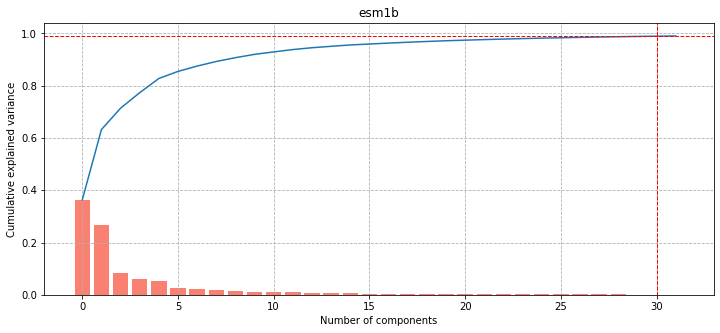

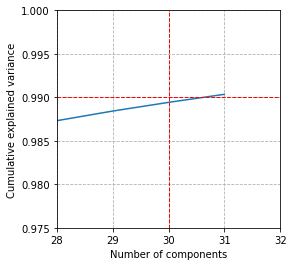

In [12]:
# take all components that explain 99% of the variance
pca = PCA(n_components=32)
principal_components = pca.fit_transform(df.esm1b.to_list())

print(f"Explained variance ratio: \n {pca.explained_variance_ratio_}")
plt.figure(figsize=(12,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.bar(range(0,32), pca.explained_variance_ratio_, color='salmon')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.axvline(30, color='red', linestyle='dashed', linewidth=1)
plt.axhline(0.99, color='red', linestyle='dashed', linewidth=1)
plt.grid(linestyle = "--")
plt.title("esm1b")
plt.show()

plt.figure(figsize=(4,4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.bar(range(0,32), pca.explained_variance_ratio_, color='salmon')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.xlim(28,32)
plt.ylim(0.975,1)
plt.axvline(30, color='red', linestyle='dashed', linewidth=1)
plt.axhline(0.99, color='red', linestyle='dashed', linewidth=1)
plt.grid(linestyle = "--")
plt.show()

In [13]:
df["pca_esm1b"] = principal_components.tolist()

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using pca_esm1b
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:06<00:00,  6.47it/s]


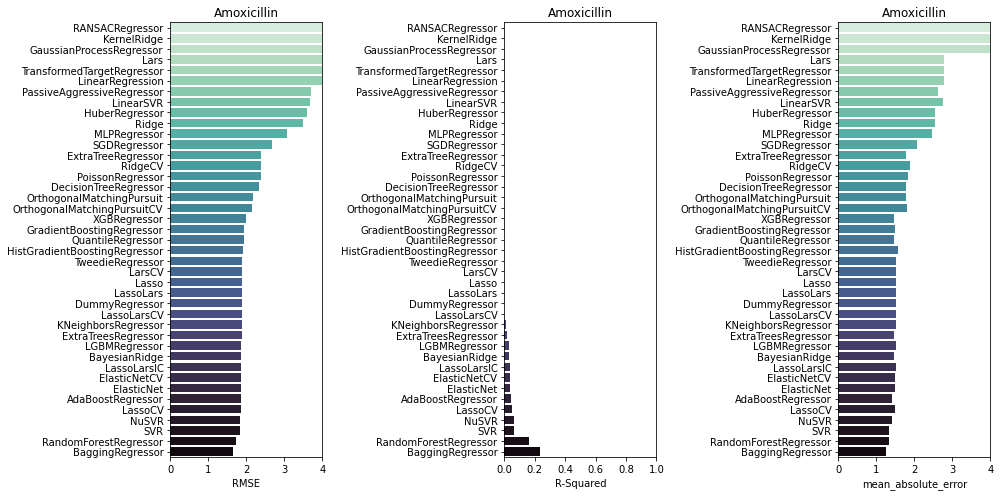

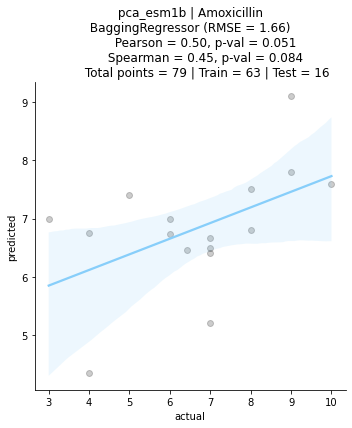

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using pca_esm1b
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.93it/s]


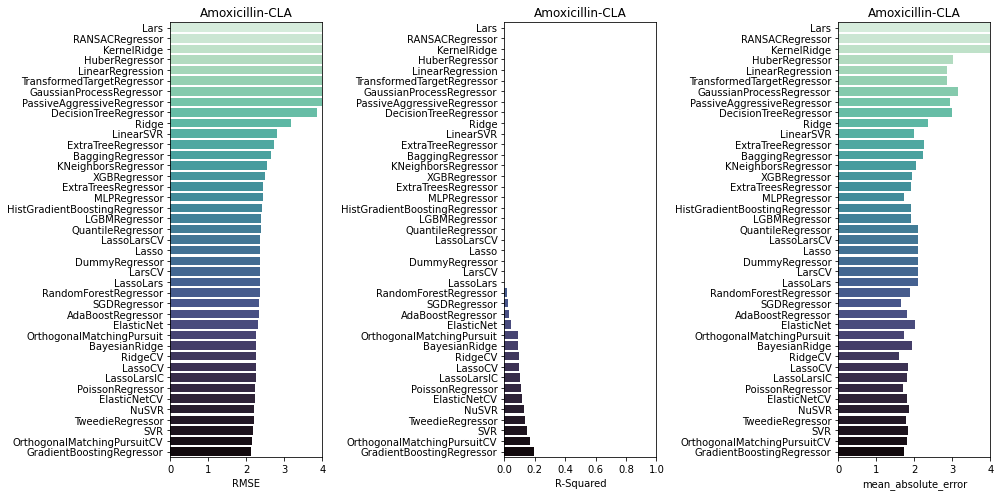

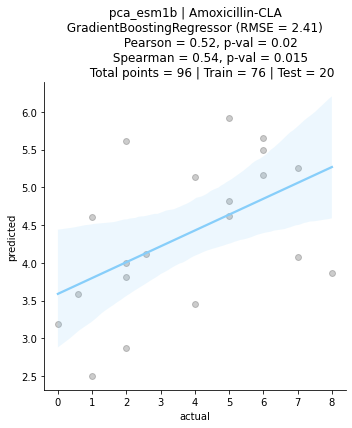

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using pca_esm1b
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.83it/s]


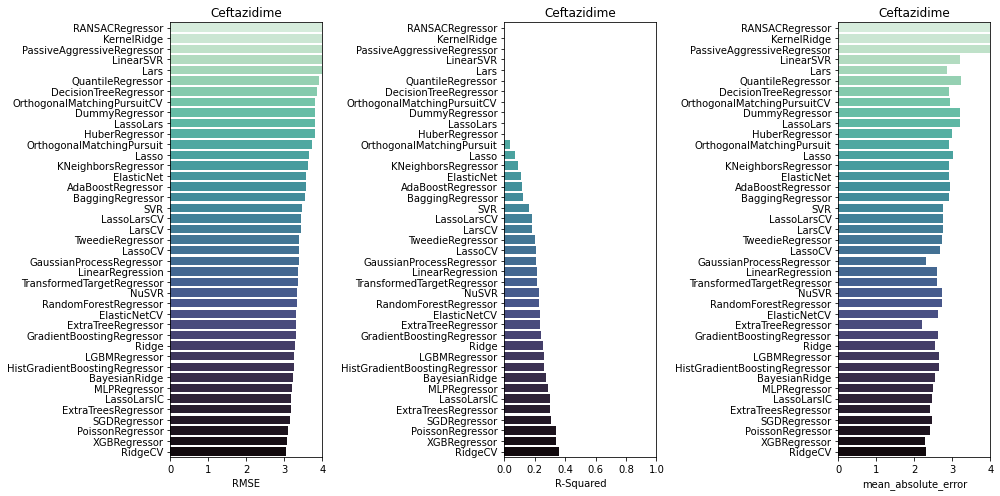

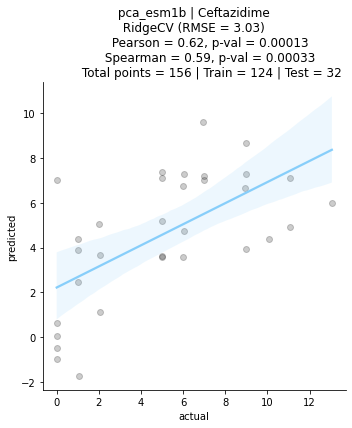

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using pca_esm1b
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.27it/s]


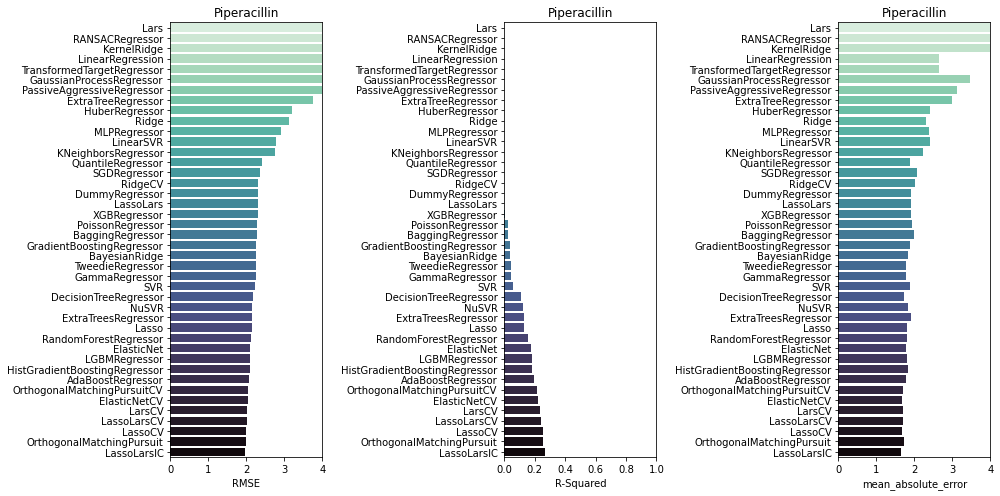

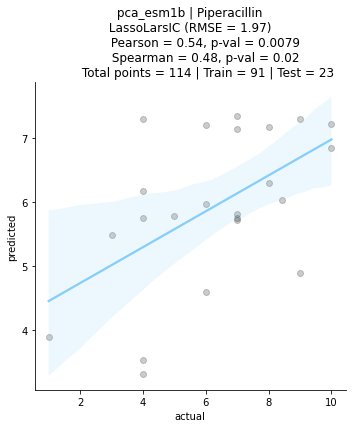

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using pca_esm1b
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.30it/s]


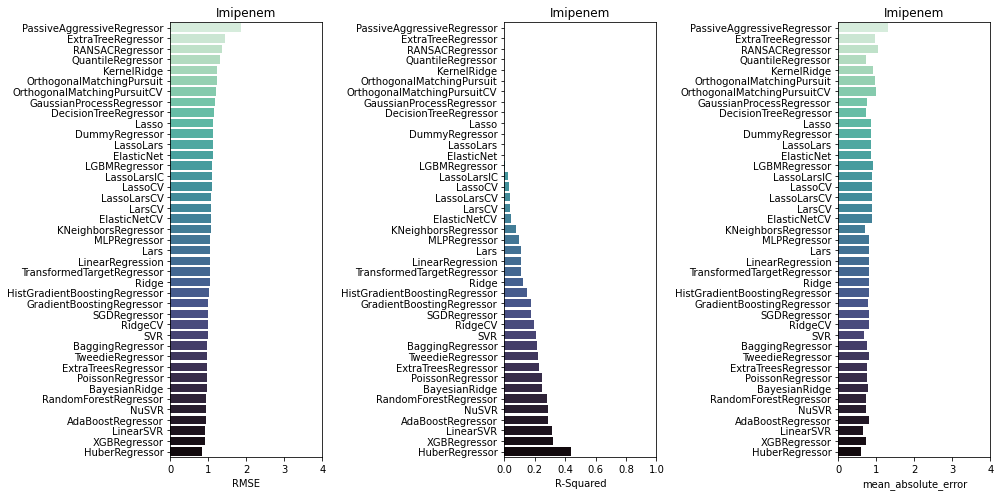

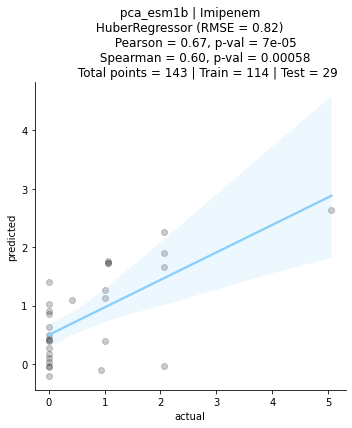

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using pca_esm1b
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.17it/s]


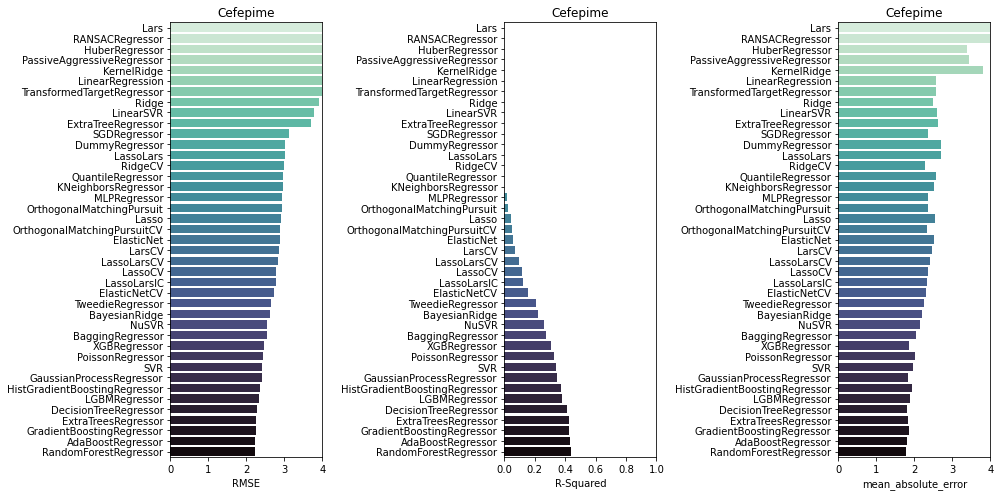

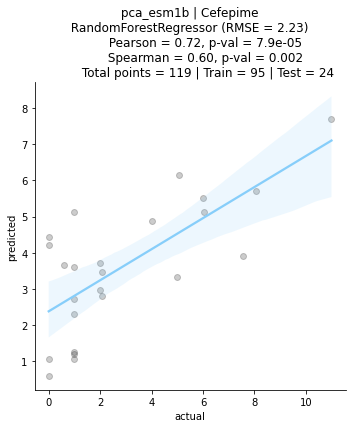

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using pca_esm1b
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.15it/s]


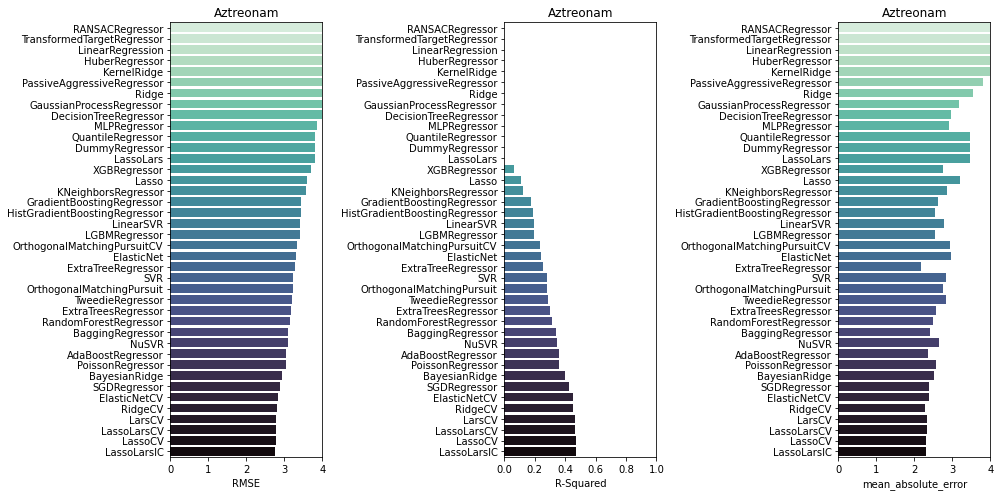

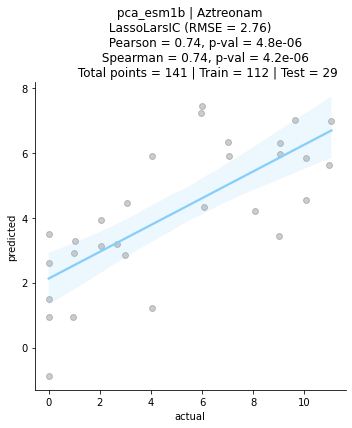

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using pca_esm1b
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.15it/s]


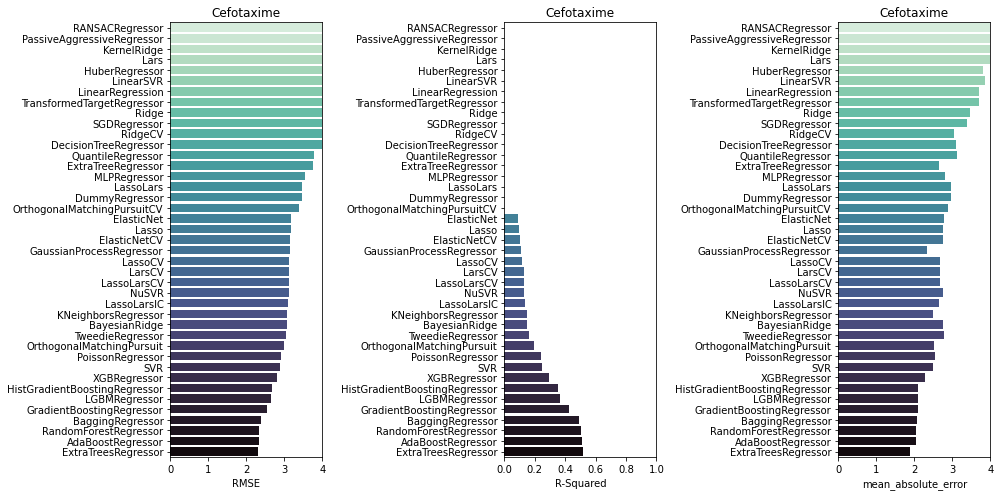

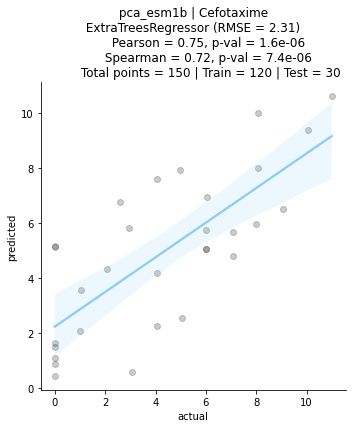

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using pca_esm1b
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.73it/s]


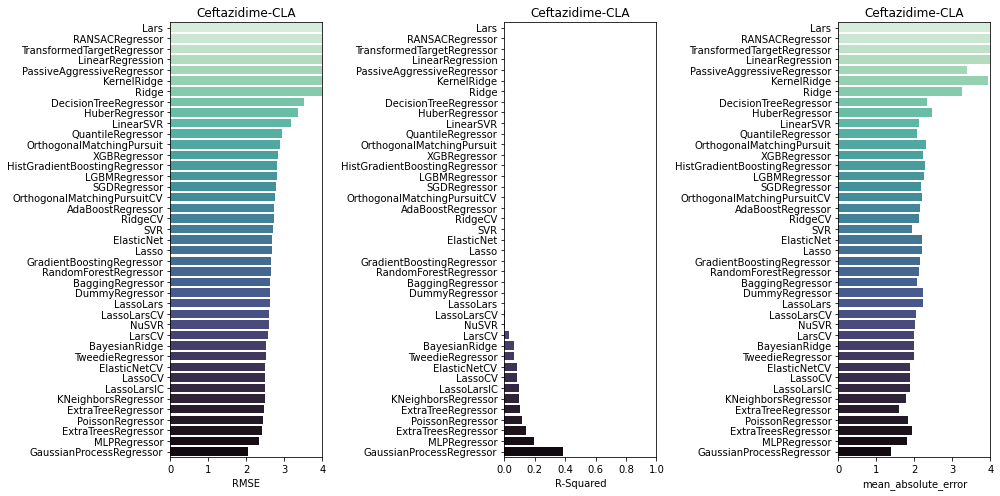

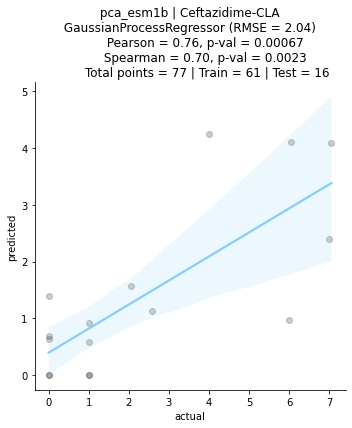

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using pca_esm1b
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.80it/s]


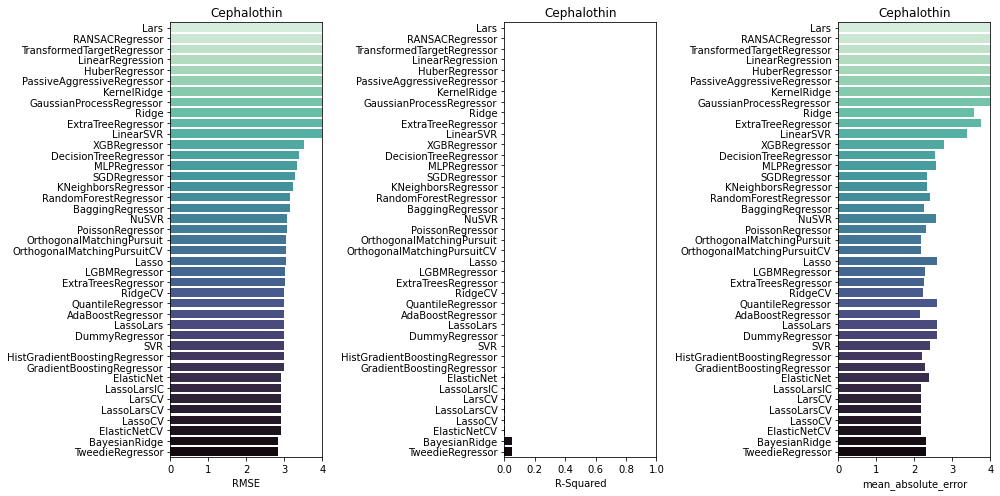

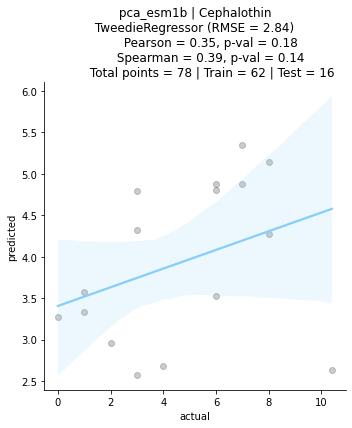

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using pca_esm1b
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.60it/s]


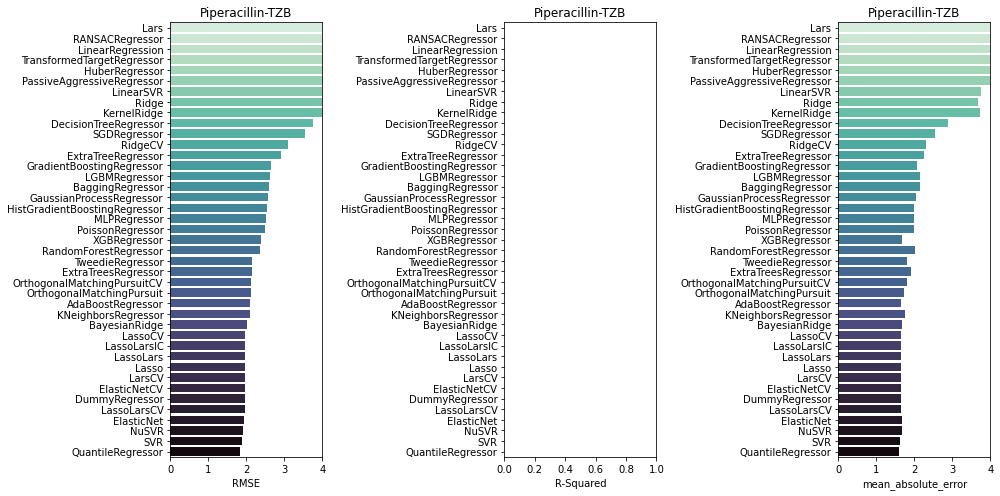

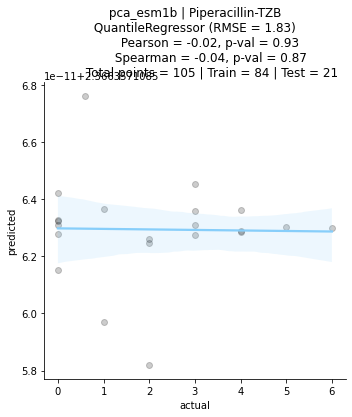

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using pca_esm1b
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.45it/s]


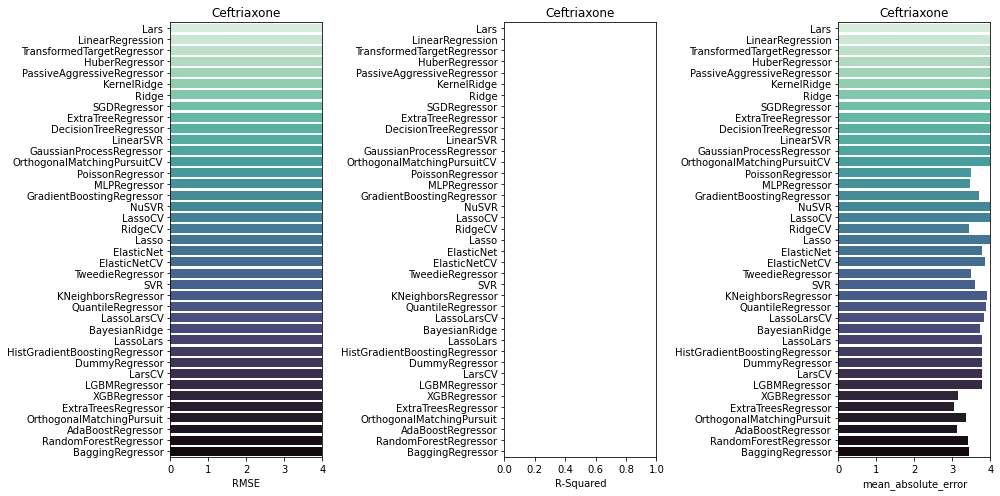

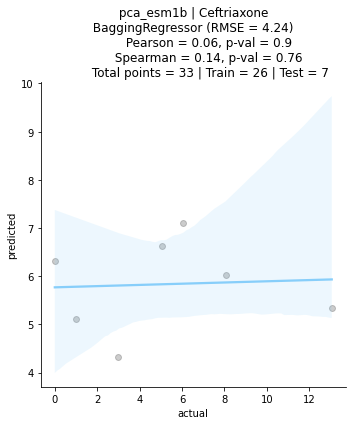

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using pca_esm1b
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.83it/s]


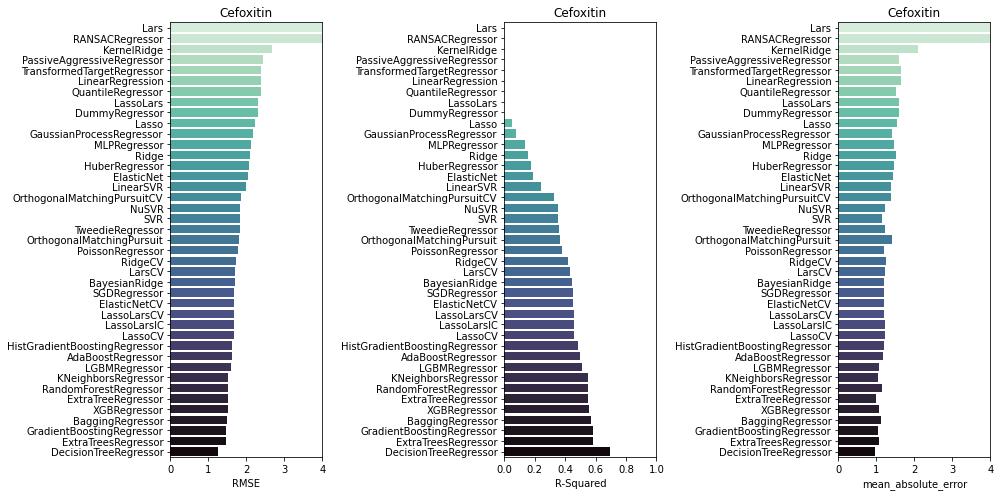

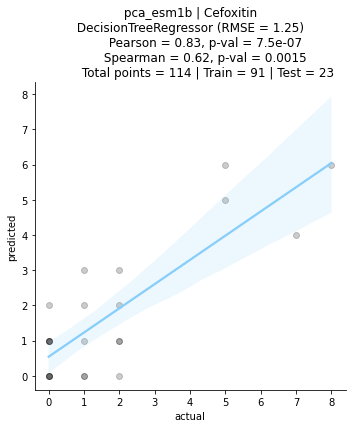

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using pca_esm1b
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.32it/s]


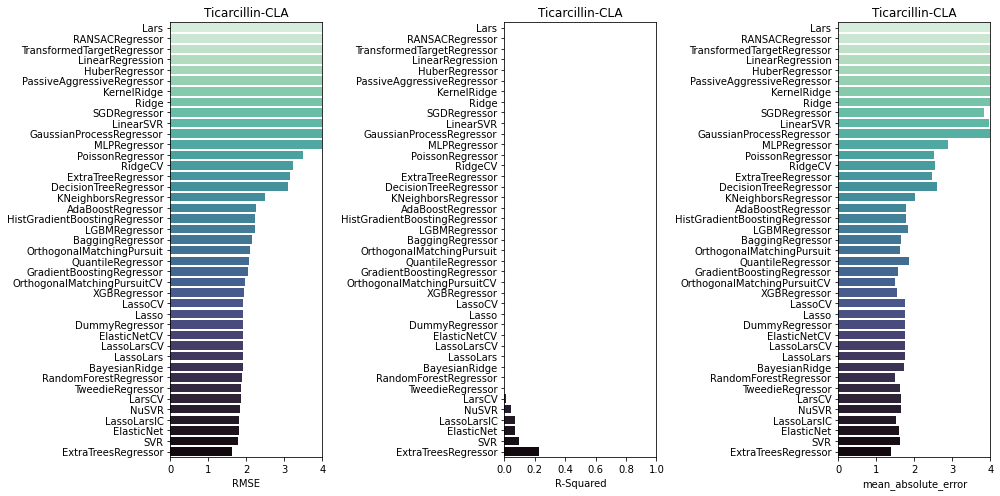

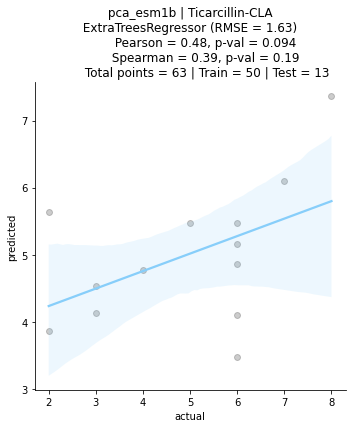

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using pca_esm1b
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.27it/s]


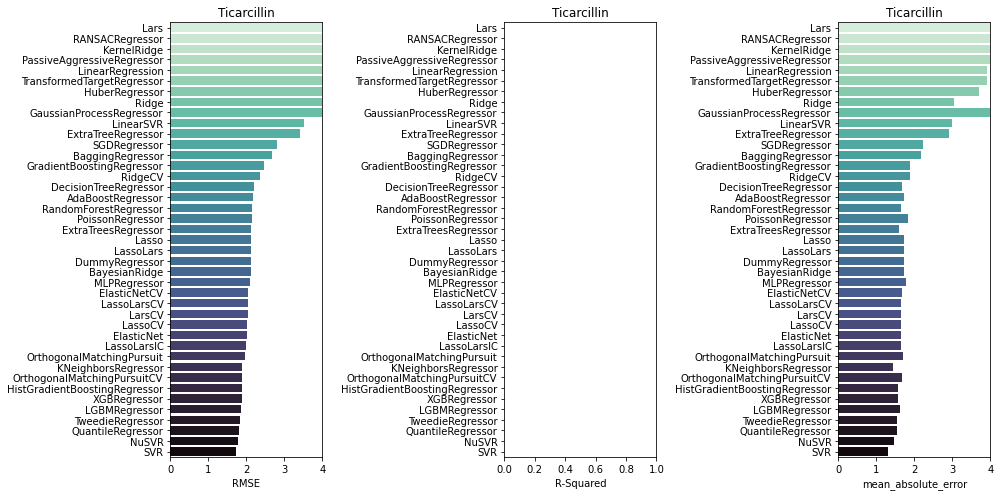

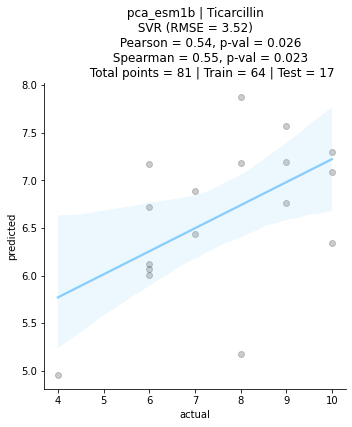

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using pca_esm1b
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.76it/s]


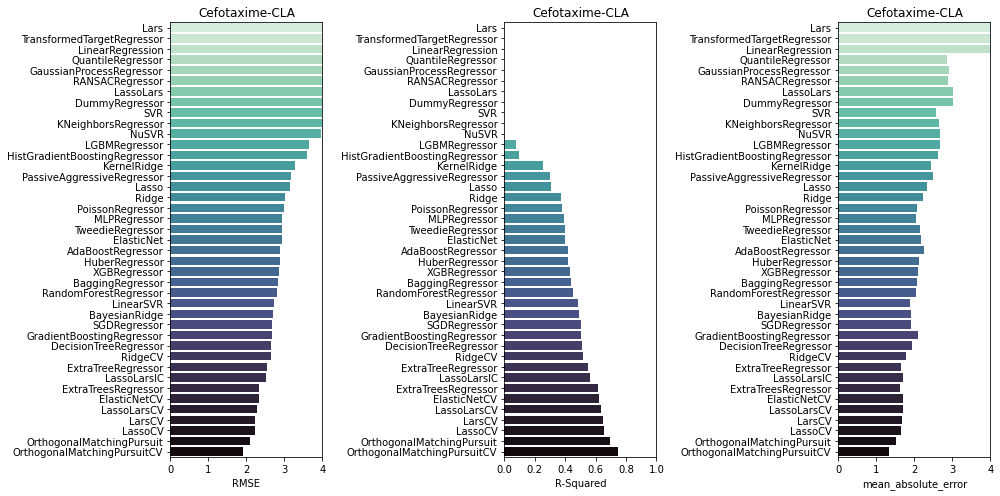

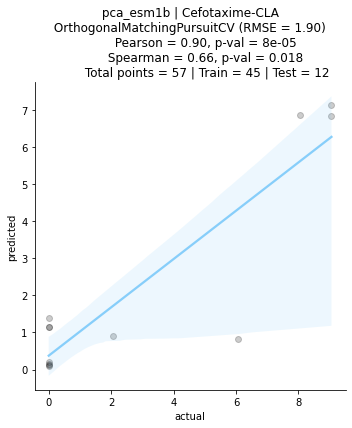

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using pca_esm1b
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.41it/s]


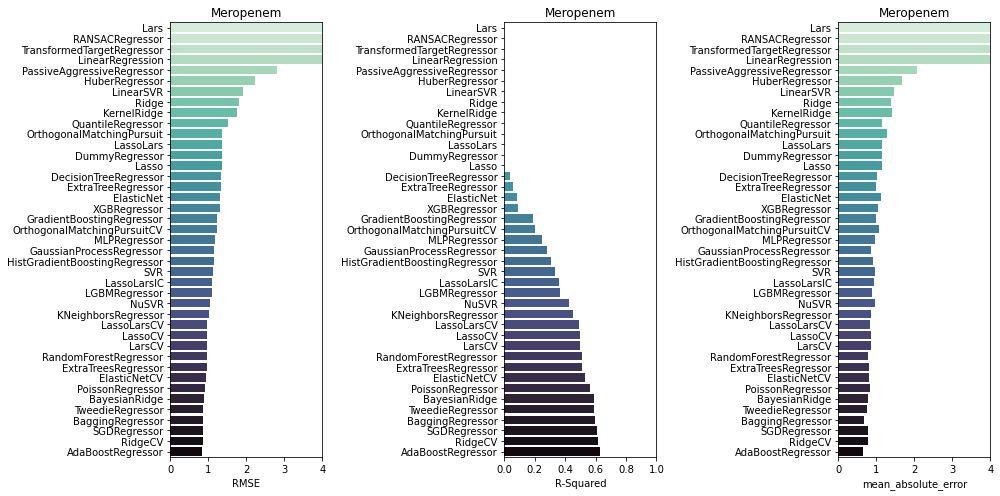

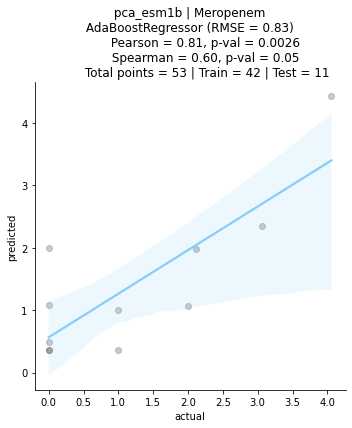

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using pca_esm1b
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.78it/s]


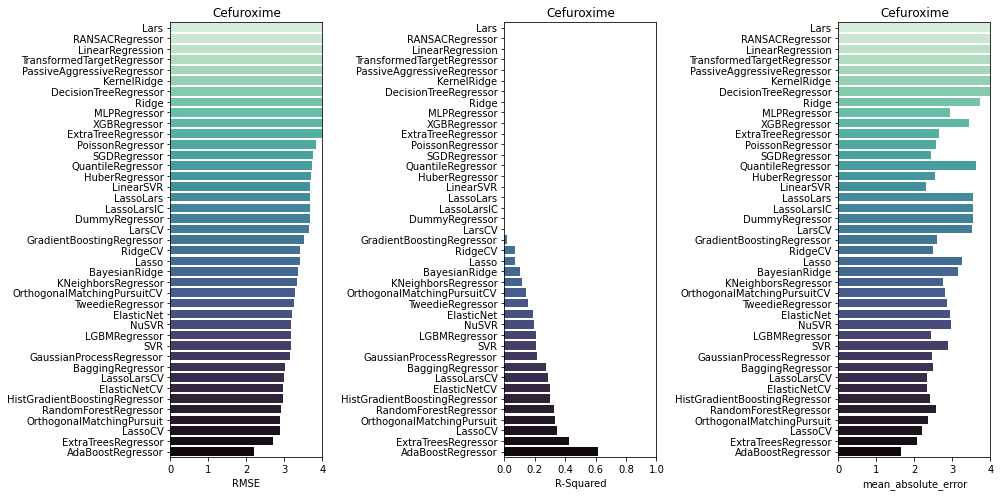

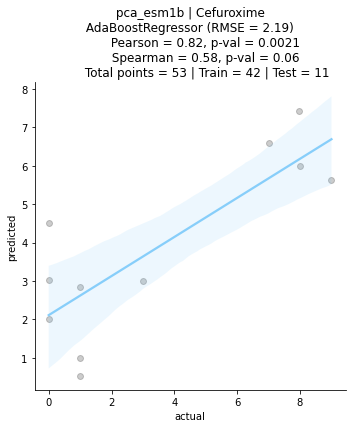

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using pca_esm1b
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.84it/s]


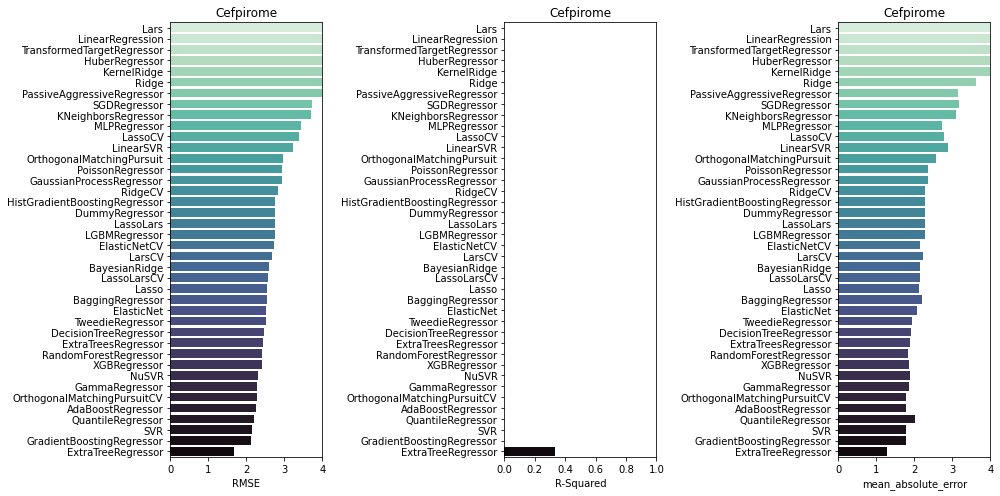

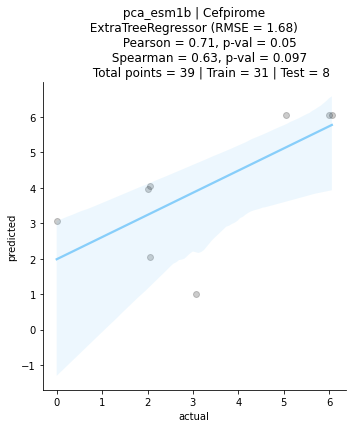

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using pca_esm1b
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.80it/s]


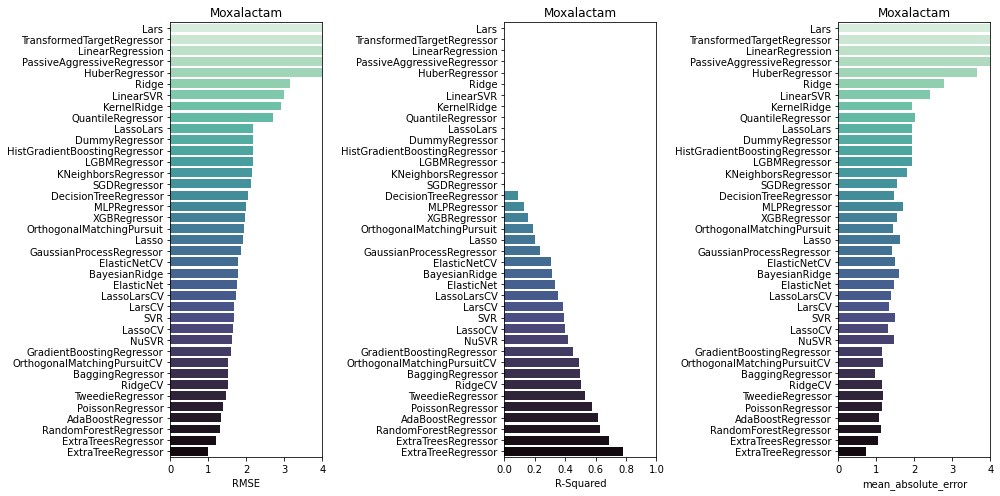

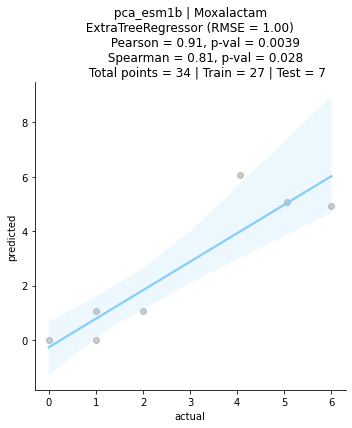

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using pca_esm1b
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.21it/s]


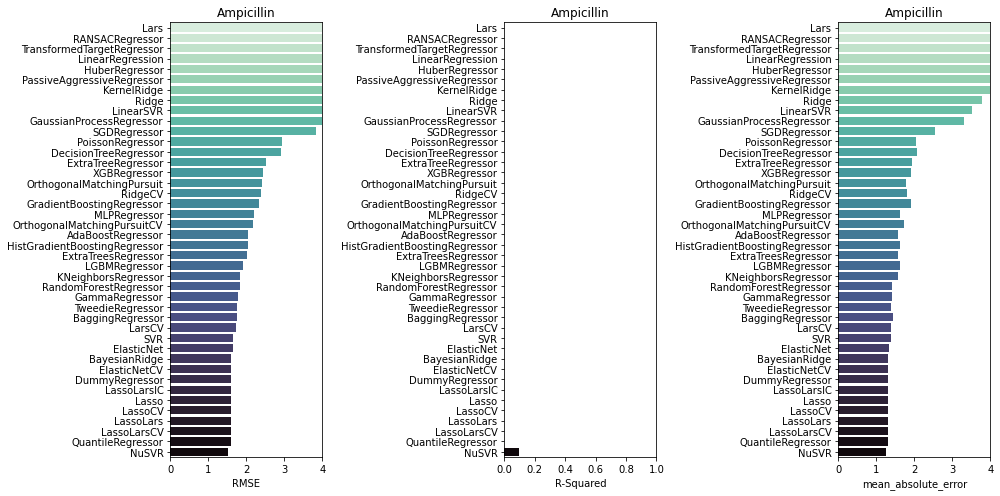

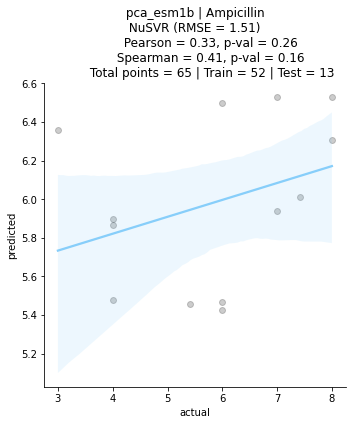

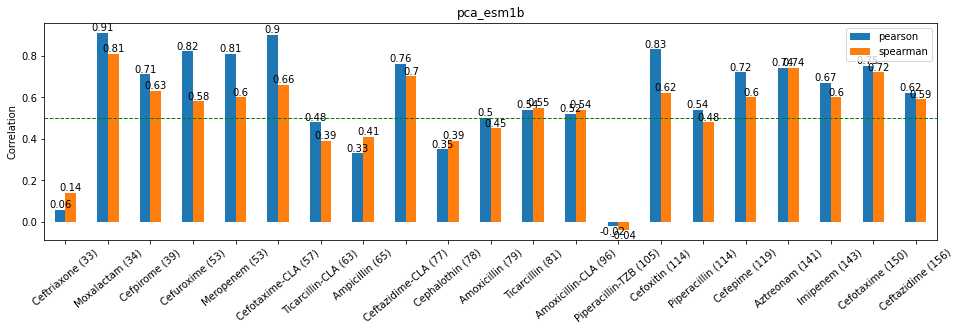

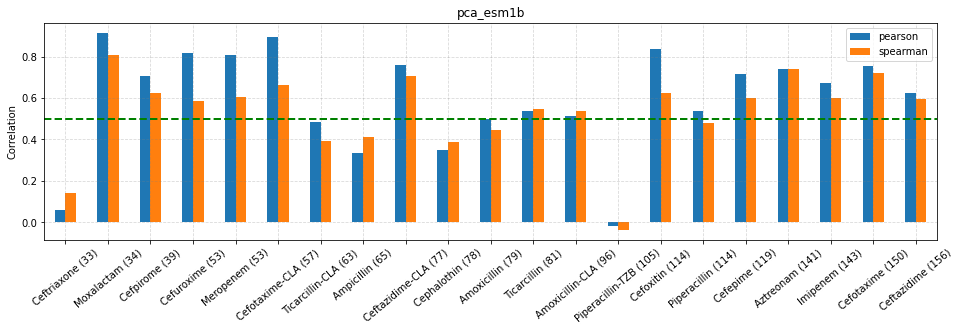

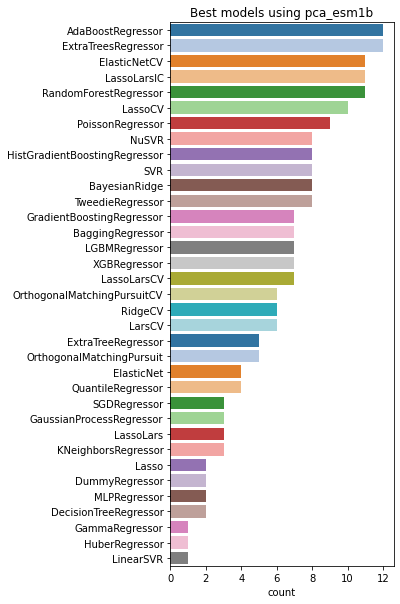

In [14]:
# set plm model
model = "pca_esm1b"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "lightskyblue"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_esm1b_pca = pd.DataFrame()
df_metrics_esm1b_pca["anti"]         = anti_lst  
df_metrics_esm1b_pca["best_model"]   = model_lst  
df_metrics_esm1b_pca["rmse"]         = rmse_lst 
df_metrics_esm1b_pca["mae"]          = mae_lst
df_metrics_esm1b_pca["r2"]           = r_lst 
df_metrics_esm1b_pca["pearson"]      = pear_lst 
df_metrics_esm1b_pca["pearson_p"]    = pearp_lst 
df_metrics_esm1b_pca["spearman"]     = spear_lst 
df_metrics_esm1b_pca["spearman_p"]   = spearp_lst 
df_metrics_esm1b_pca["data_size"]    = data_size_lst 
df_metrics_esm1b_pca["train_size"]   = train_size_lst 
df_metrics_esm1b_pca["test_size"]    = test_size_lst 
df_metrics_esm1b_pca["top10_models"] = top10_models_lst
df_metrics_esm1b_pca["anti_lab"]     = df_metrics_esm1b_pca["anti"] + " " + "(" + df_metrics_esm1b_pca["data_size"].astype(str) + ")"
df_metrics_esm1b_pca = df_metrics_esm1b_pca.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_esm1b_pca.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_esm1b_pca.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_esm1b_pca.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_esm1b_pca.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## PCA/T5XLU50

Explained variance ratio: 
 [0.49341436 0.14034757 0.08469601 0.05725974 0.03205175 0.02724211
 0.02253528 0.01858131 0.01592525 0.01115538 0.00993101 0.00884319
 0.00791789 0.00678456 0.00573521 0.00487949 0.00432373 0.00398975
 0.0035819  0.00327885 0.00281351 0.00278961 0.00239598 0.00236985
 0.00225896 0.00201196 0.00169922 0.00161391 0.00145478 0.00143686
 0.00130207 0.00124931 0.0011172  0.00105042 0.00096805 0.00080435
 0.00079235]


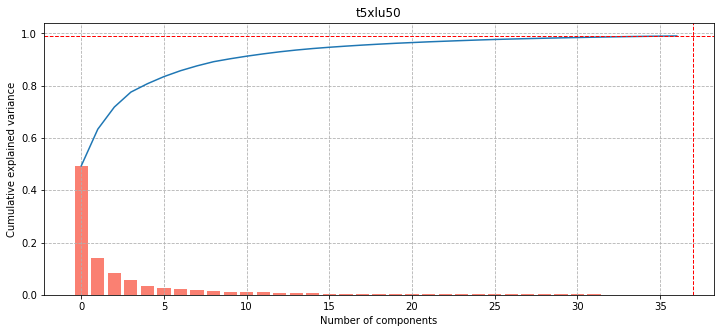

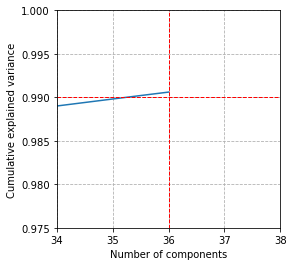

In [15]:
# take all components that explain 99% of the variance
pca = PCA(n_components=37)
principal_components = pca.fit_transform(df.t5xlu50.to_list())

print(f"Explained variance ratio: \n {pca.explained_variance_ratio_}")
plt.figure(figsize=(12,5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.bar(range(0,37), pca.explained_variance_ratio_, color='salmon')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.axvline(37, color='red', linestyle='dashed', linewidth=1)
plt.axhline(0.99, color='red', linestyle='dashed', linewidth=1)
plt.grid(linestyle = "--")
plt.title("t5xlu50")
plt.show()

plt.figure(figsize=(4,4))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.bar(range(0,37), pca.explained_variance_ratio_, color='salmon')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.xlim(34,38)
plt.ylim(0.975,1)
plt.axvline(36, color='red', linestyle='dashed', linewidth=1)
plt.axhline(0.99, color='red', linestyle='dashed', linewidth=1)
plt.grid(linestyle = "--")
plt.show()

In [16]:
np.sum(pca.explained_variance_ratio_)

0.9906027212315469

In [17]:
df["pca_t5xlu50"] = principal_components.tolist()

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using pca_t5xlu50
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.15it/s]


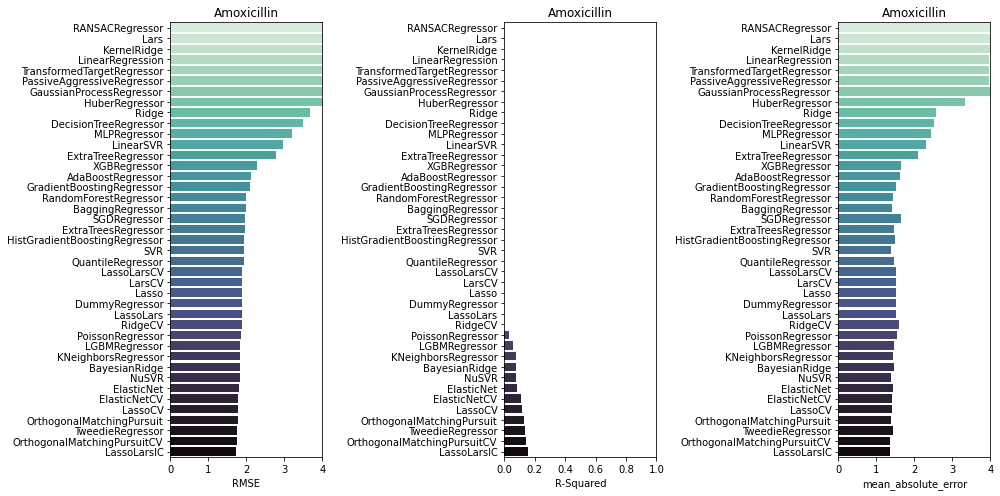

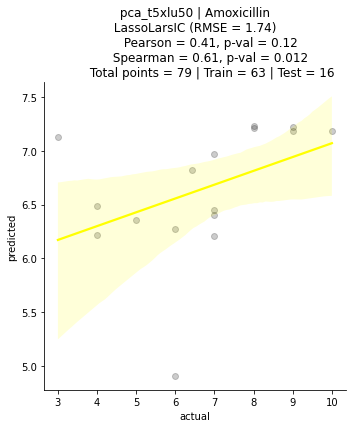

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using pca_t5xlu50
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.49it/s]


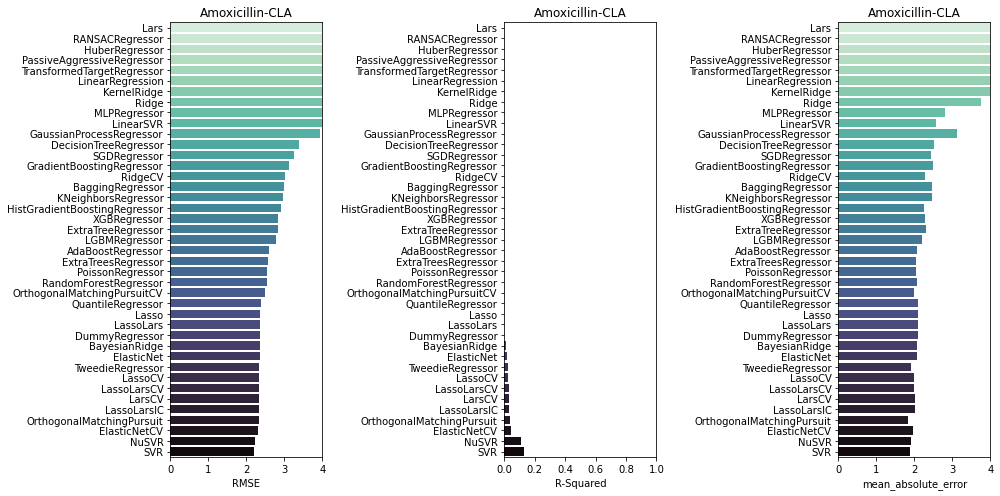

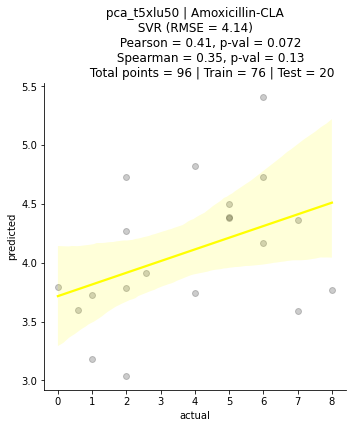

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using pca_t5xlu50
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.70it/s]


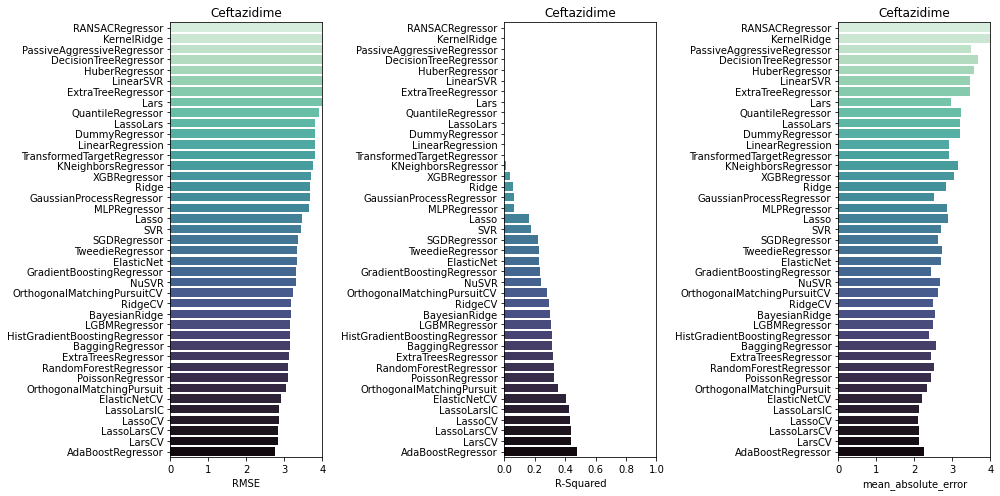

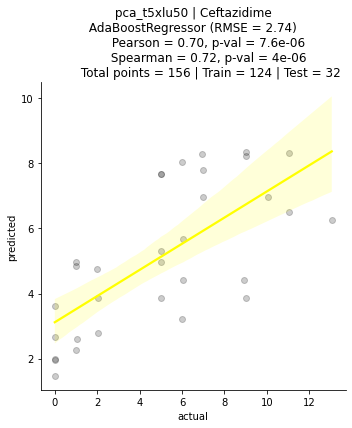

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using pca_t5xlu50
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.30it/s]


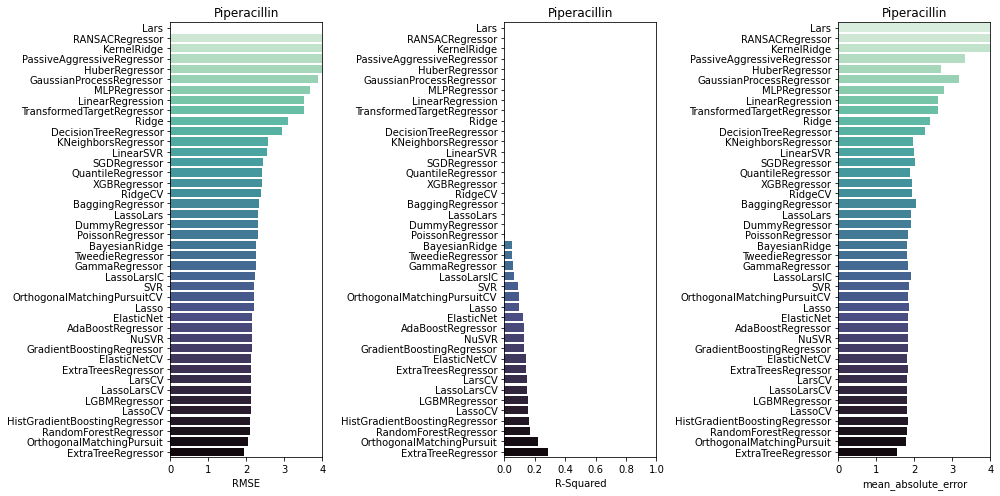

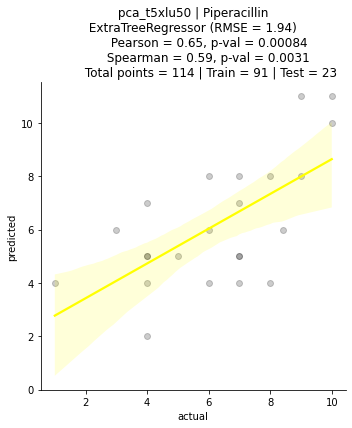

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using pca_t5xlu50
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.12it/s]


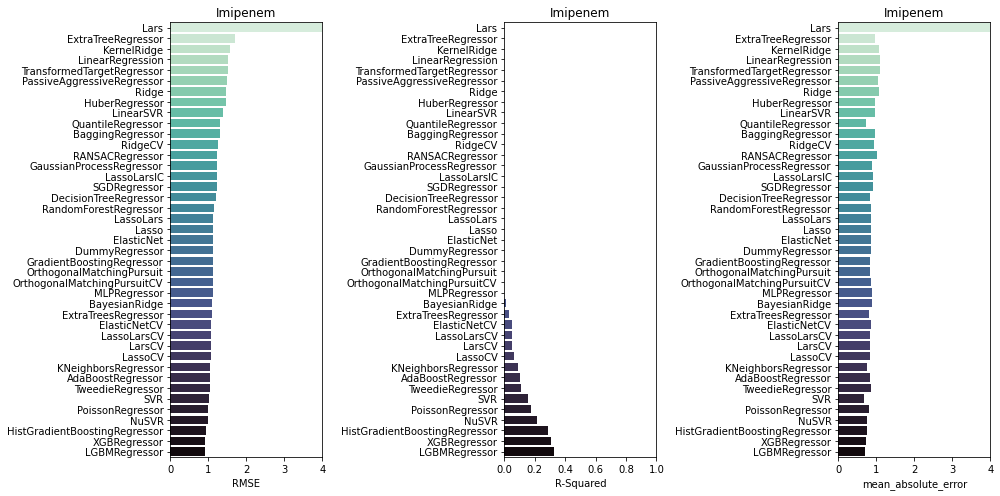

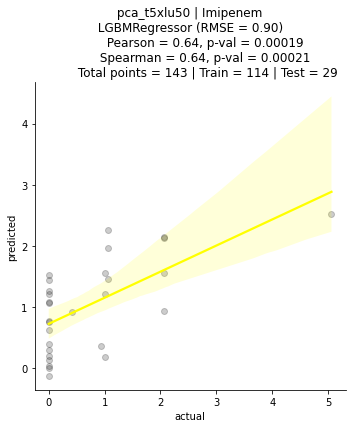

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using pca_t5xlu50
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.46it/s]


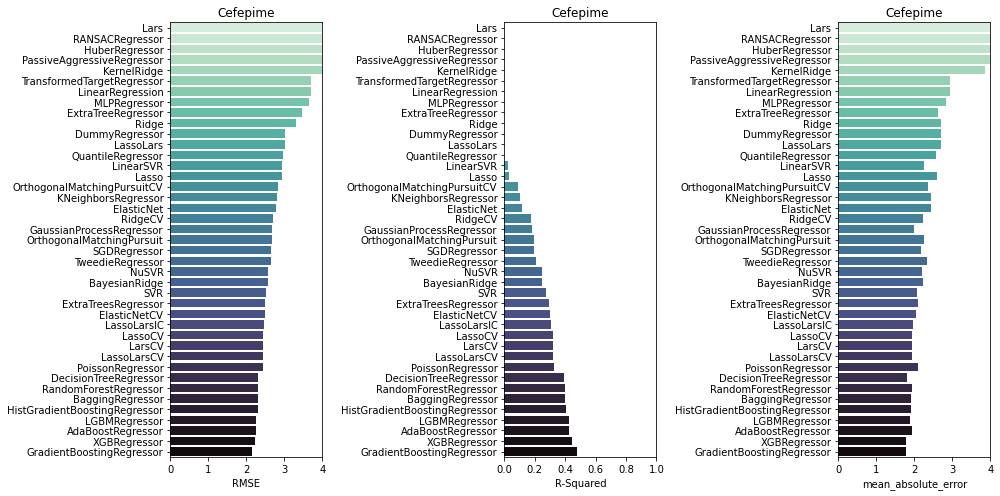

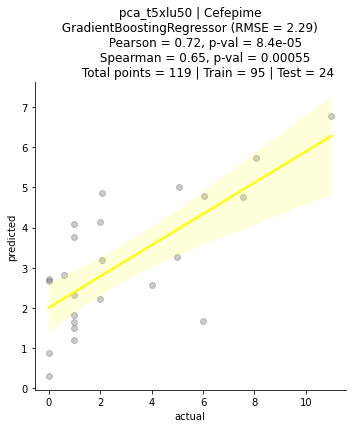

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using pca_t5xlu50
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.16it/s]


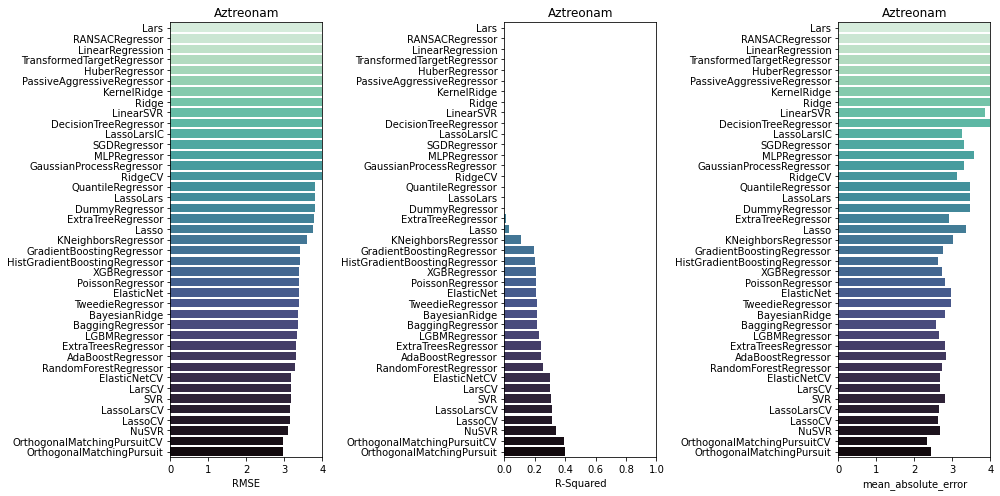

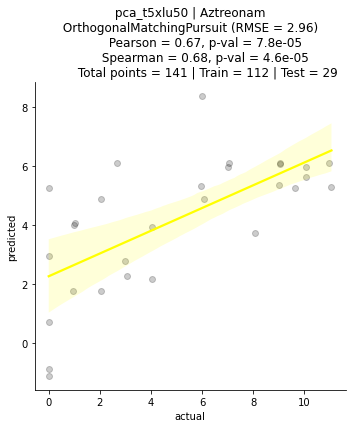

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using pca_t5xlu50
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.74it/s]


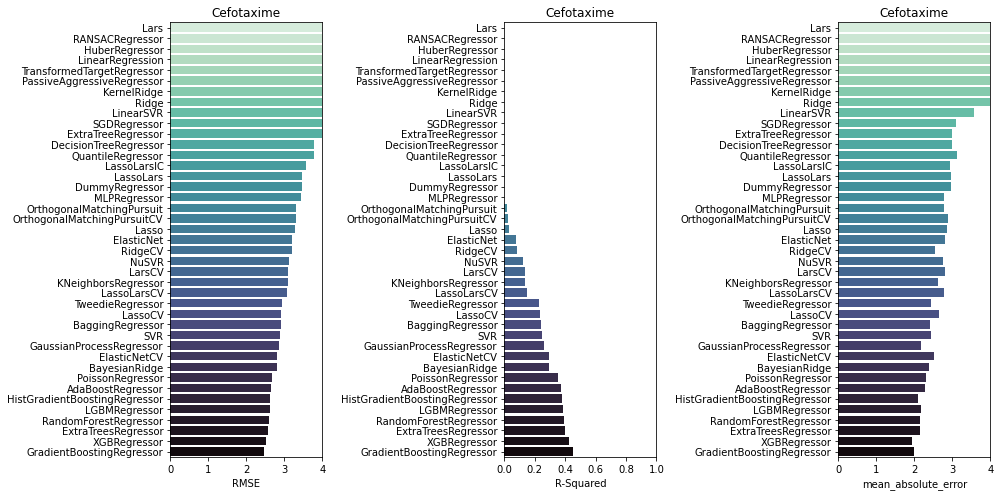

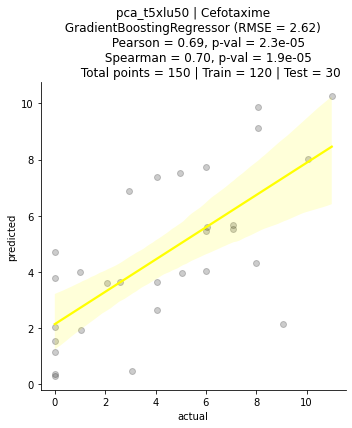

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using pca_t5xlu50
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.59it/s]


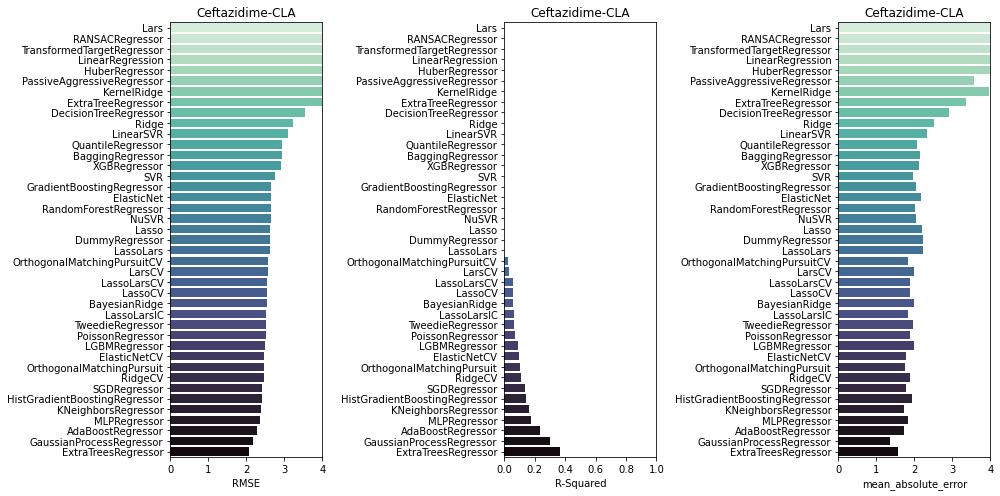

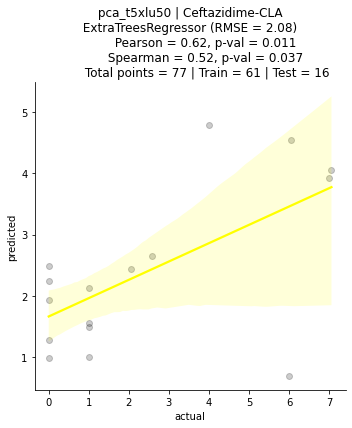

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using pca_t5xlu50
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.14it/s]


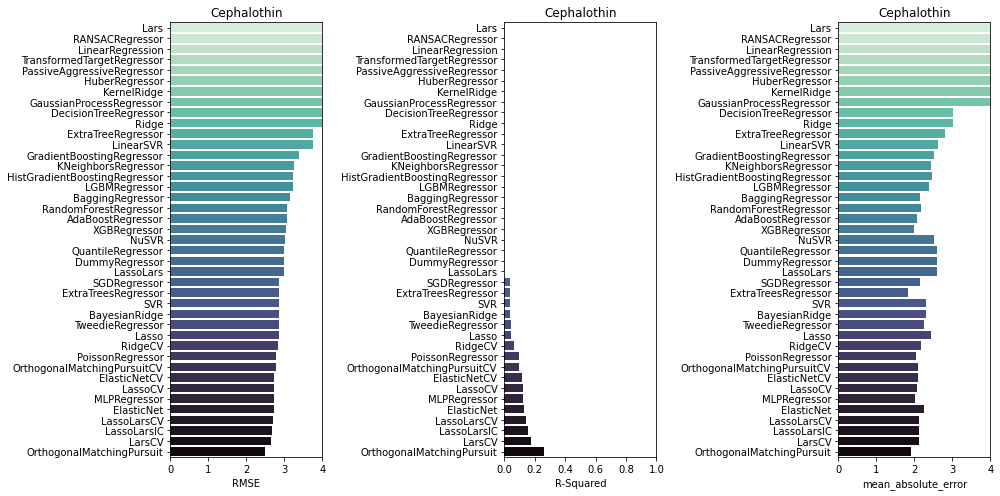

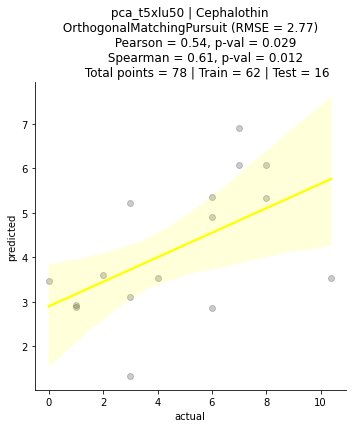

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using pca_t5xlu50
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.35it/s]


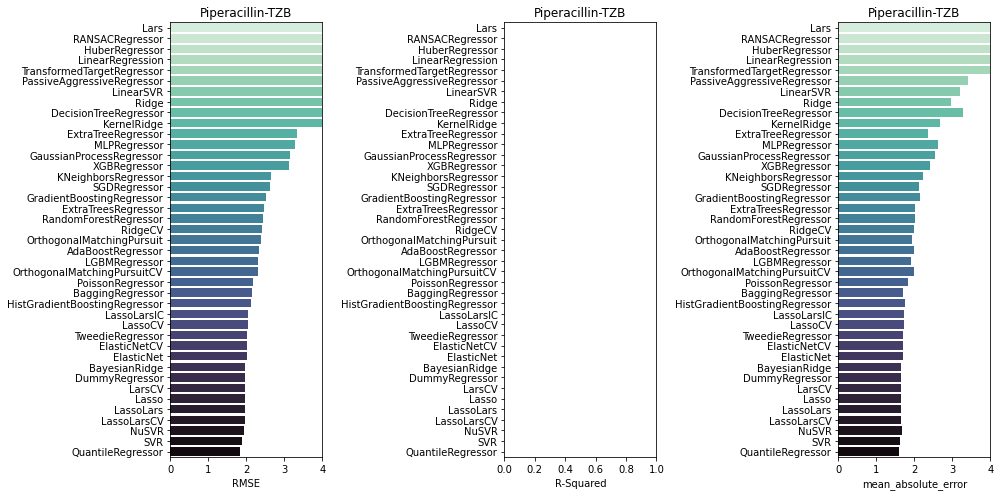

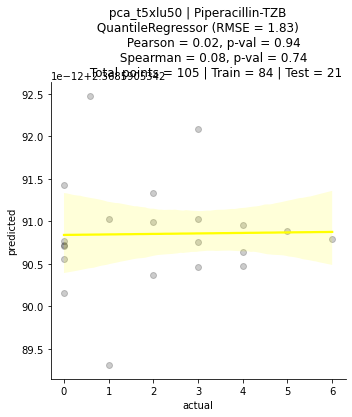

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using pca_t5xlu50
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.58it/s]


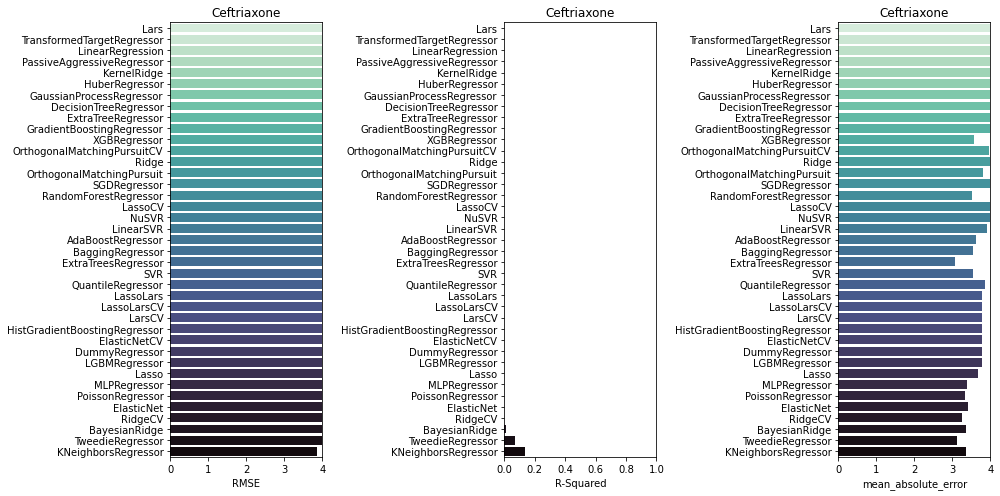

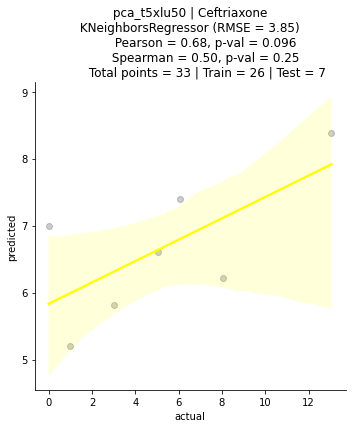

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using pca_t5xlu50
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.78it/s]


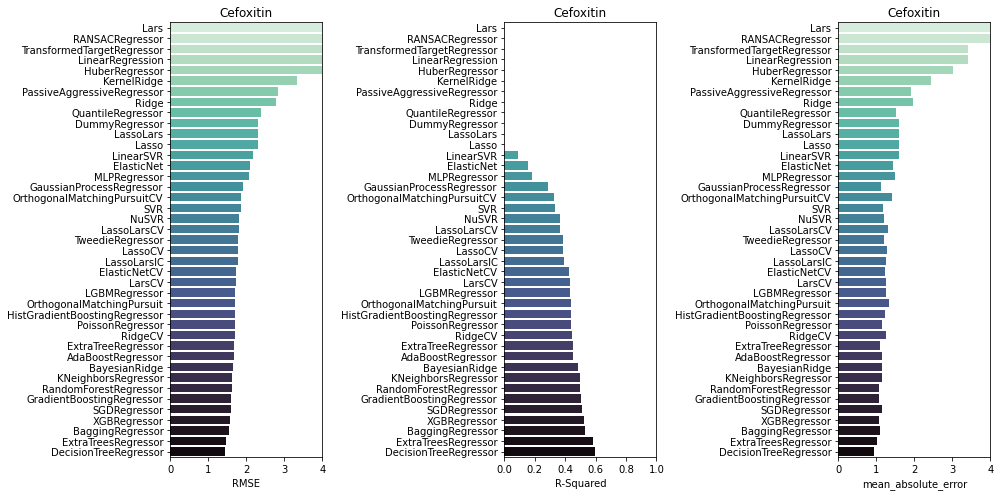

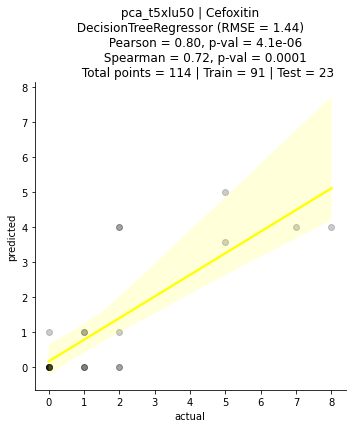

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using pca_t5xlu50
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.29it/s]


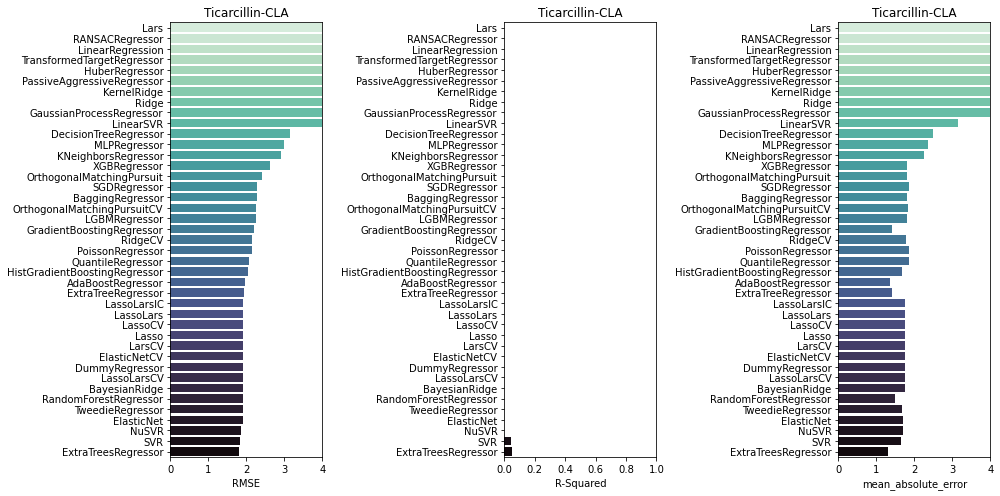

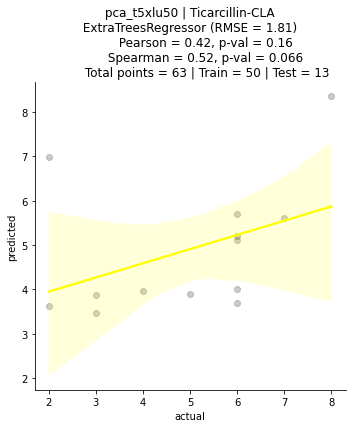

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using pca_t5xlu50
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.14it/s]


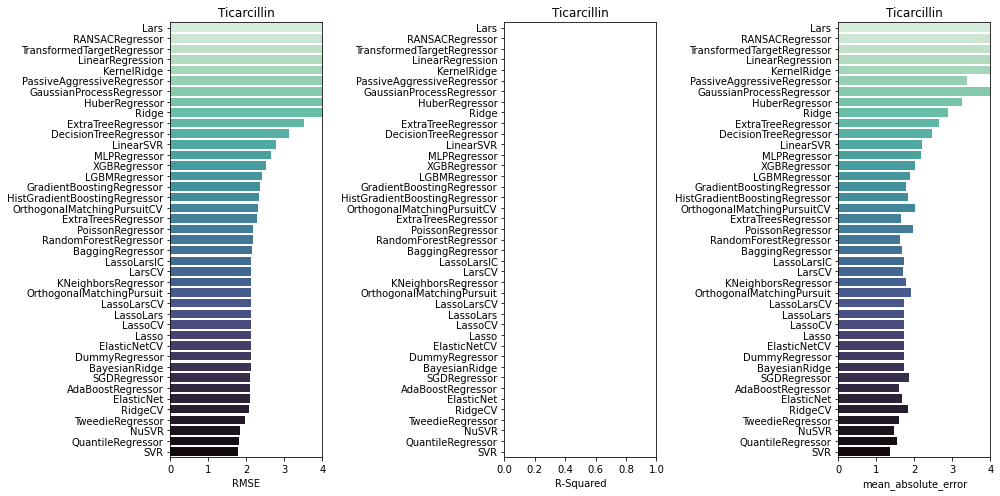

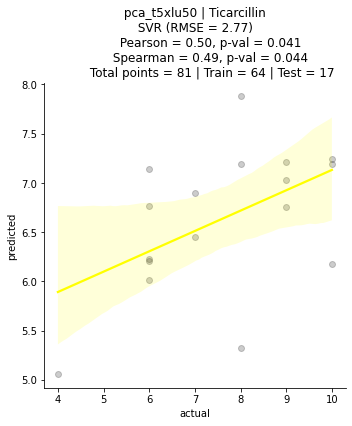

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using pca_t5xlu50
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.48it/s]


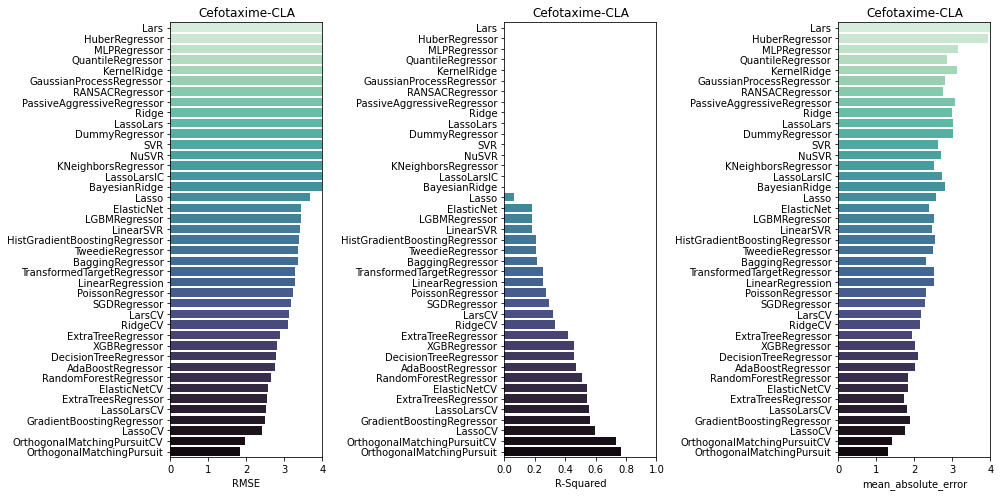

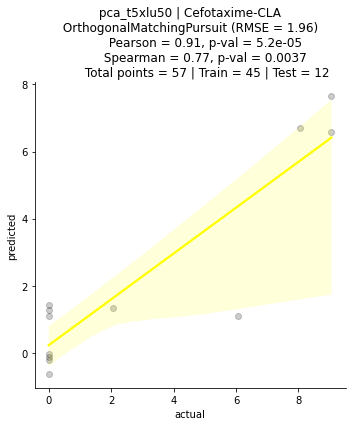

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using pca_t5xlu50
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.65it/s]


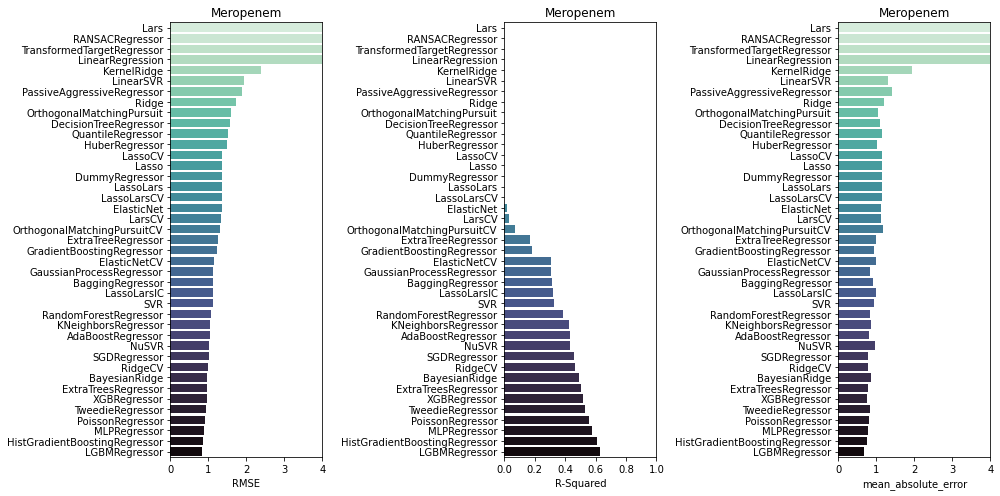

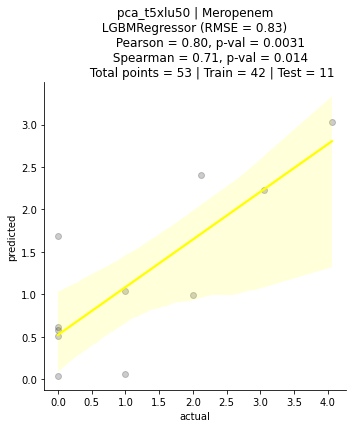

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using pca_t5xlu50
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.32it/s]


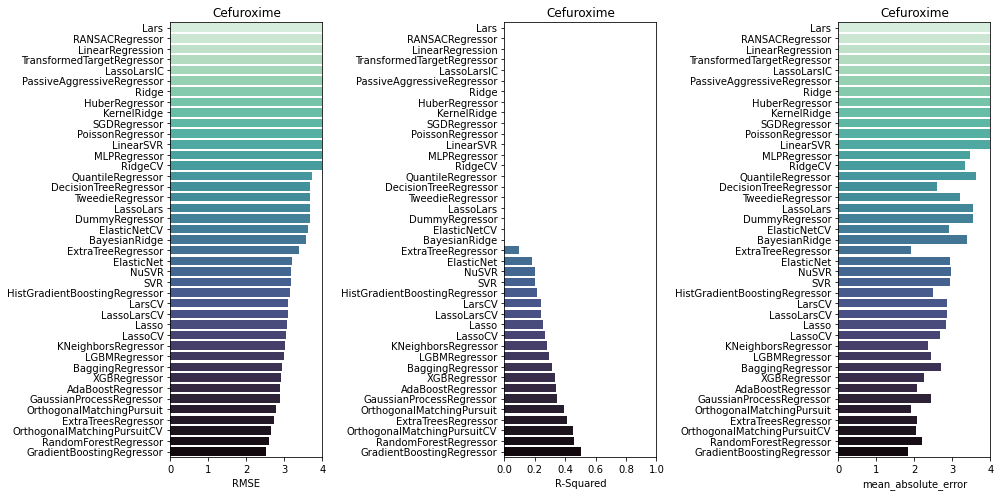

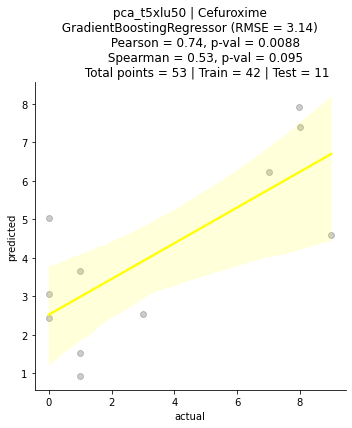

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using pca_t5xlu50
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.21it/s]


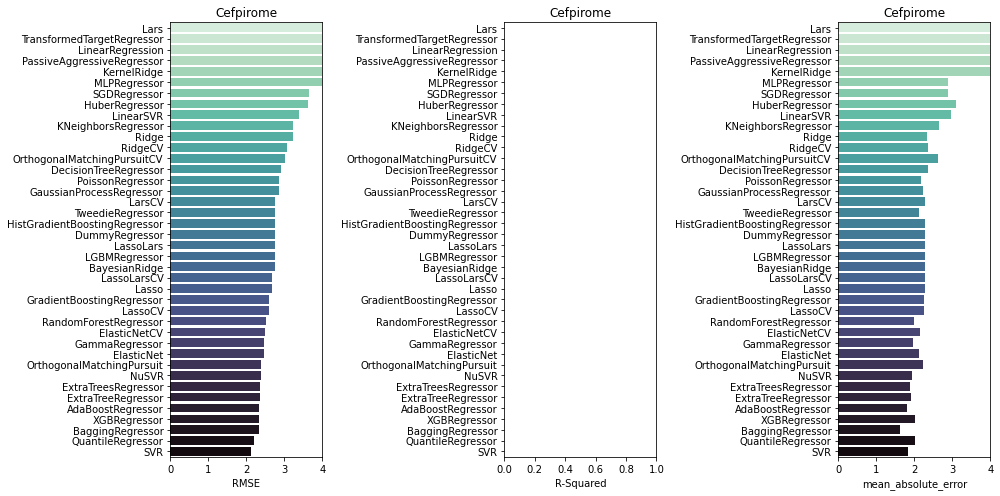

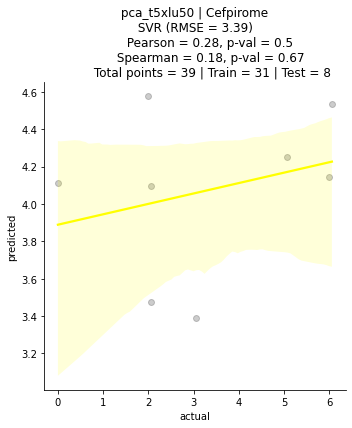

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using pca_t5xlu50
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.43it/s]


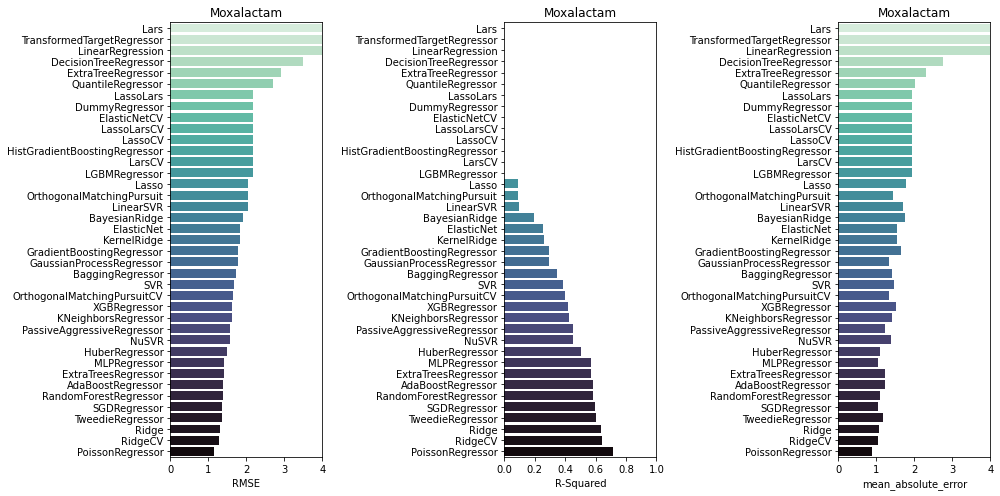

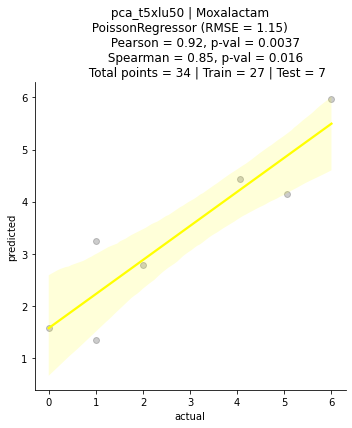

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using pca_t5xlu50
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.13it/s]


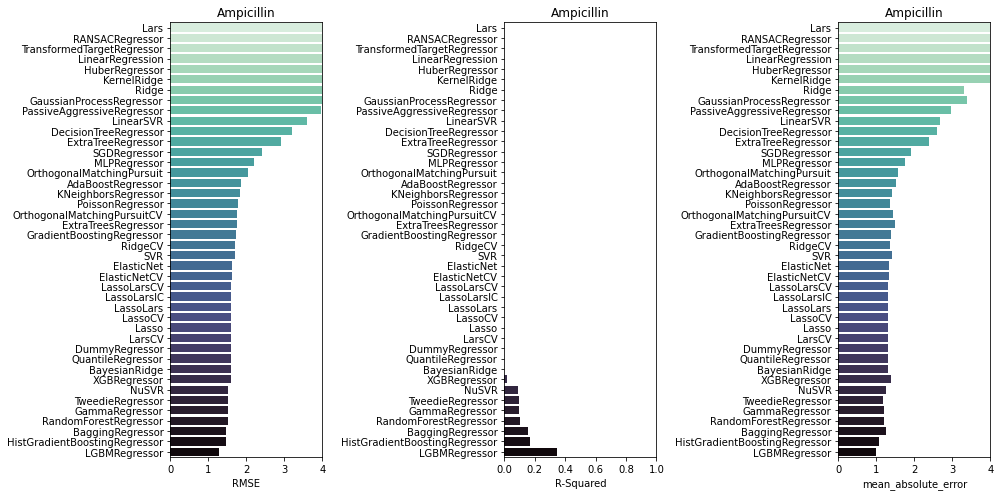

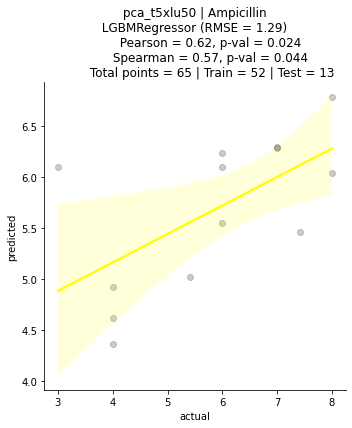

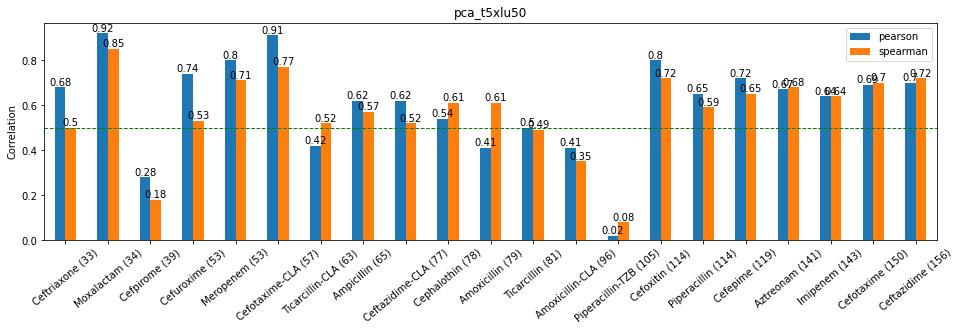

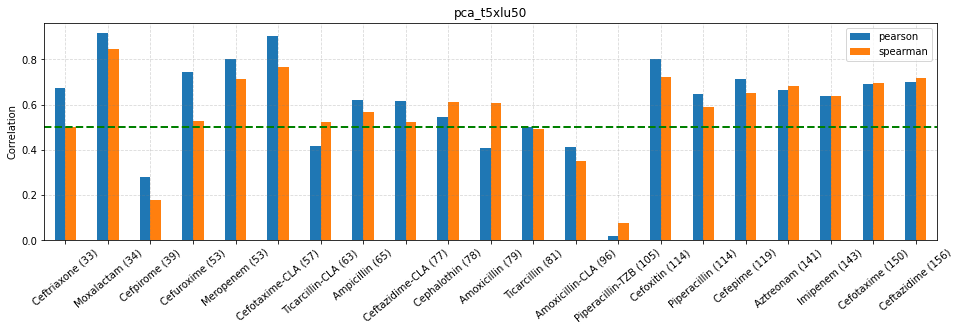

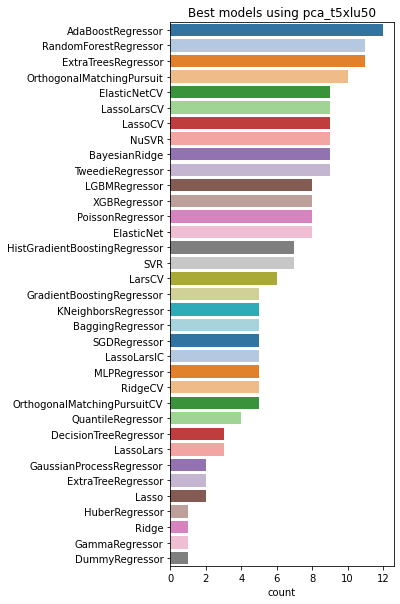

In [18]:
# set plm model
model = "pca_t5xlu50"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "yellow"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_t5_pca = pd.DataFrame()
df_metrics_t5_pca["anti"]         = anti_lst  
df_metrics_t5_pca["best_model"]   = model_lst  
df_metrics_t5_pca["rmse"]         = rmse_lst 
df_metrics_t5_pca["mae"]          = mae_lst
df_metrics_t5_pca["r2"]           = r_lst 
df_metrics_t5_pca["pearson"]      = pear_lst 
df_metrics_t5_pca["pearson_p"]    = pearp_lst 
df_metrics_t5_pca["spearman"]     = spear_lst 
df_metrics_t5_pca["spearman_p"]   = spearp_lst 
df_metrics_t5_pca["data_size"]    = data_size_lst 
df_metrics_t5_pca["train_size"]   = train_size_lst 
df_metrics_t5_pca["test_size"]    = test_size_lst 
df_metrics_t5_pca["top10_models"] = top10_models_lst
df_metrics_t5_pca["anti_lab"]     = df_metrics_t5_pca["anti"] + " " + "(" + df_metrics_t5_pca["data_size"].astype(str) + ")"
df_metrics_t5_pca = df_metrics_t5_pca.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_t5_pca.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_t5_pca.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_t5_pca.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_t5_pca.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## esm 

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using esm
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:02<00:00,  1.49s/it]


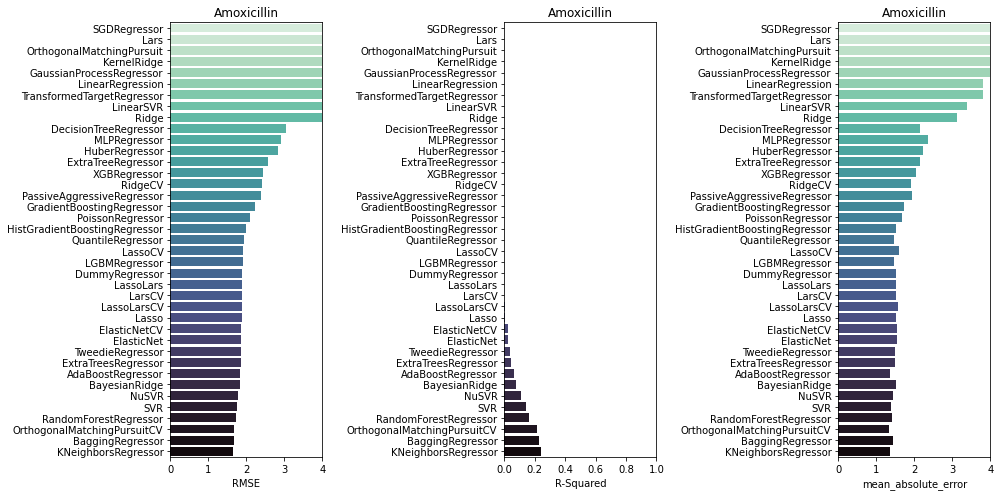

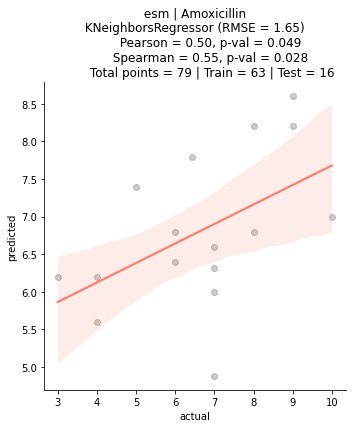

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using esm
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:06<00:00,  1.58s/it]


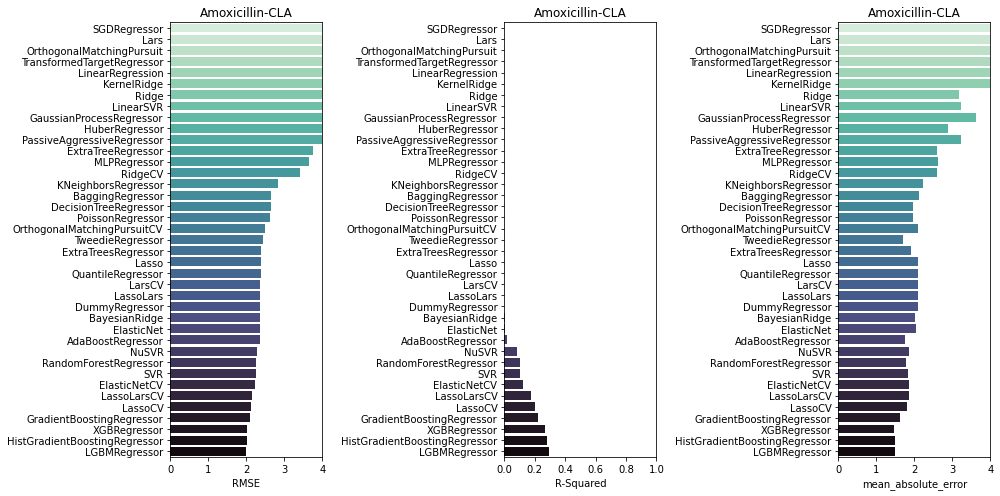

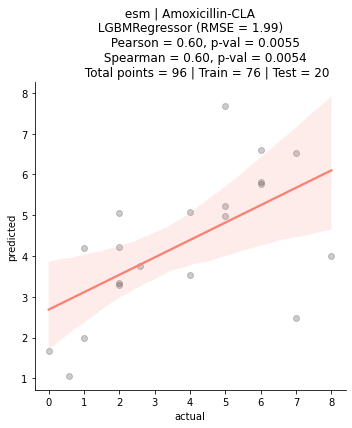

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using esm
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:22<00:00,  1.96s/it]


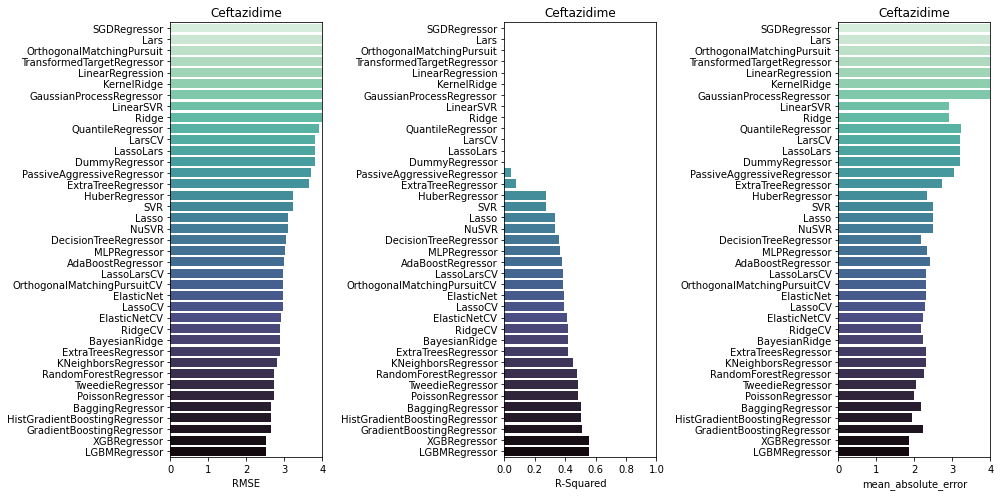

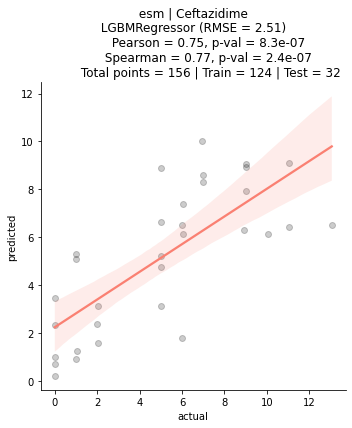

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using esm
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:10<00:00,  1.69s/it]


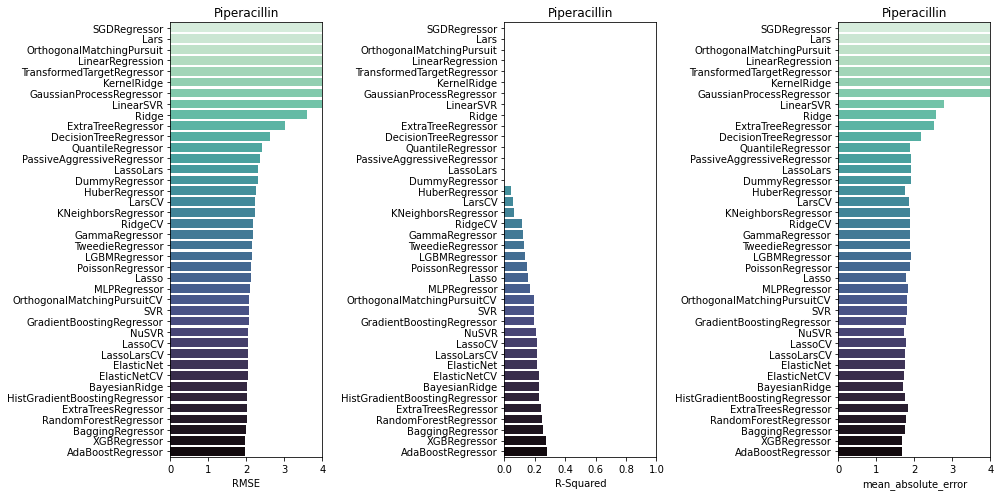

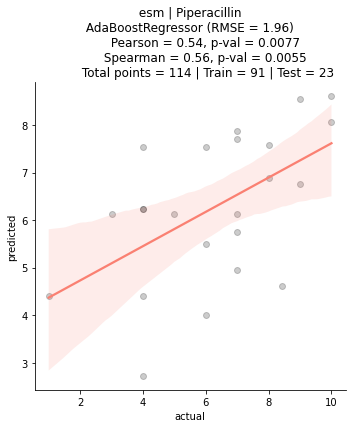

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using esm
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:15<00:00,  1.80s/it]


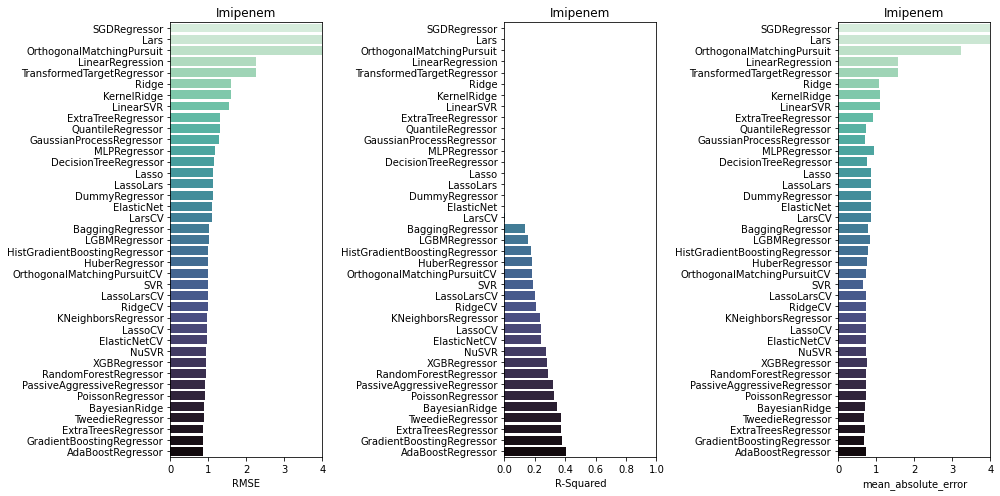

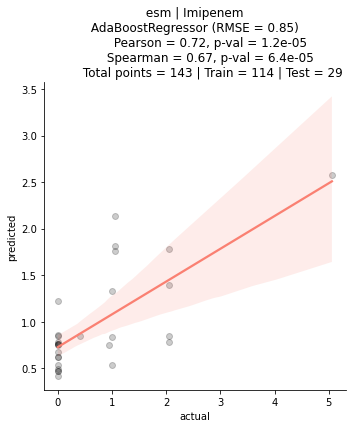

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using esm
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:49<00:00,  1.19s/it]


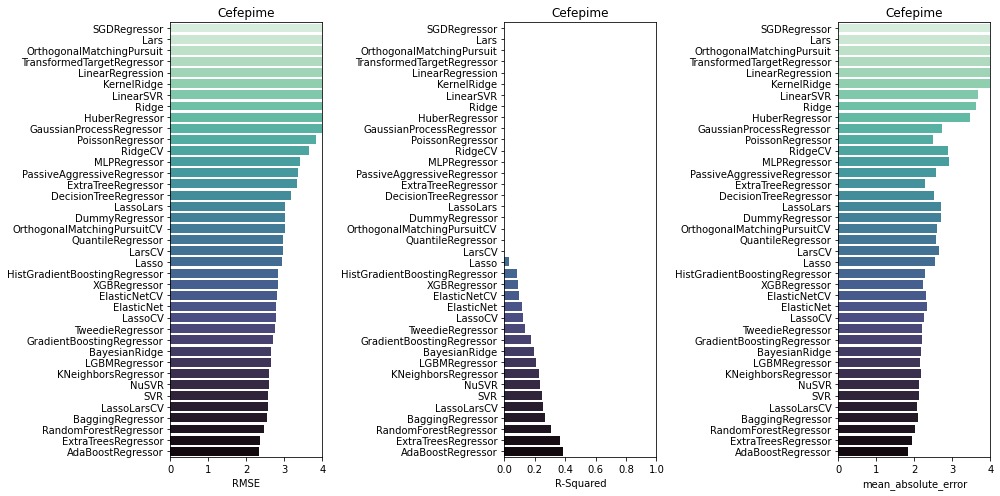

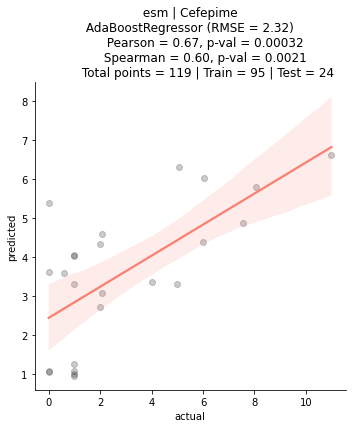

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using esm
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:13<00:00,  1.75s/it]


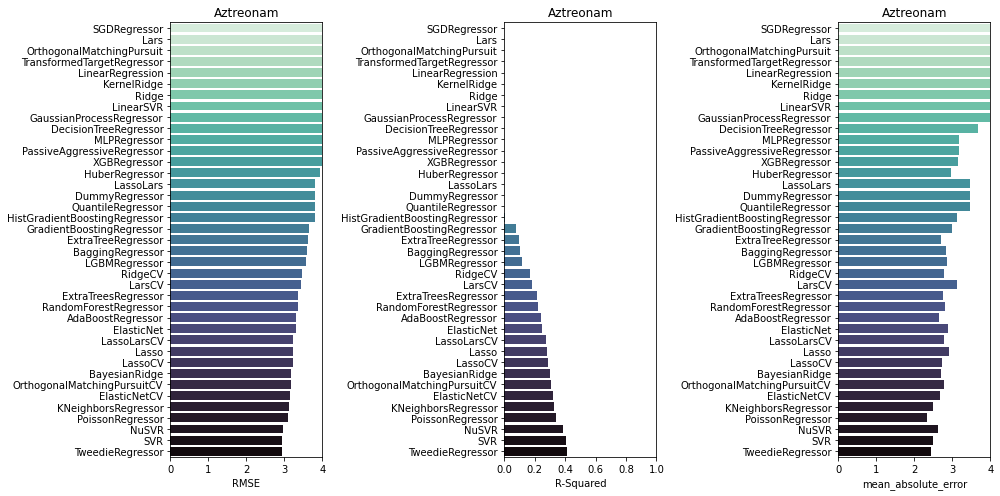

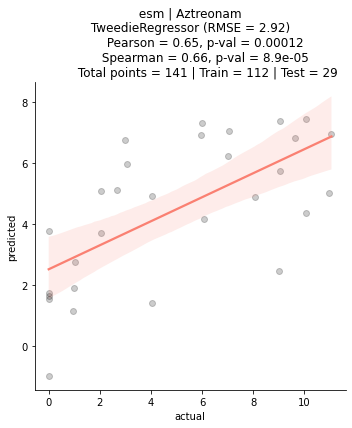

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using esm
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:54<00:00,  1.30s/it]


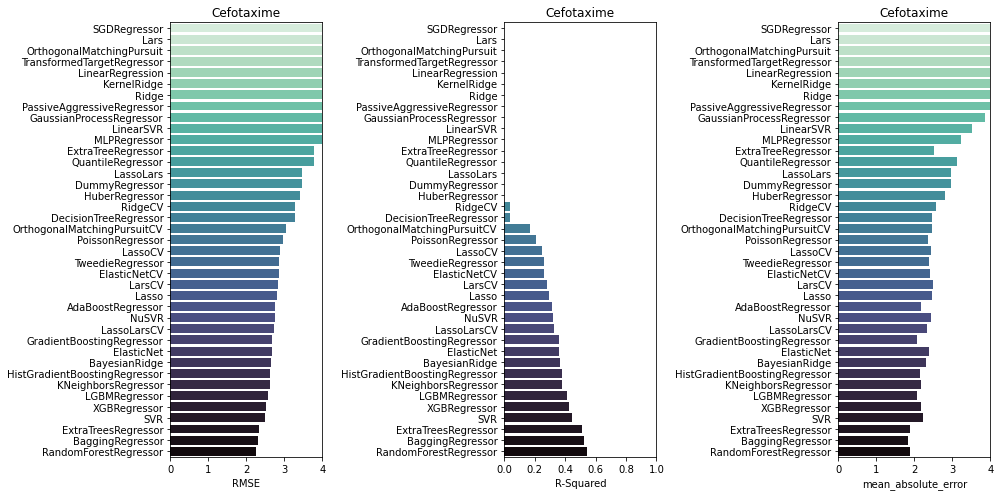

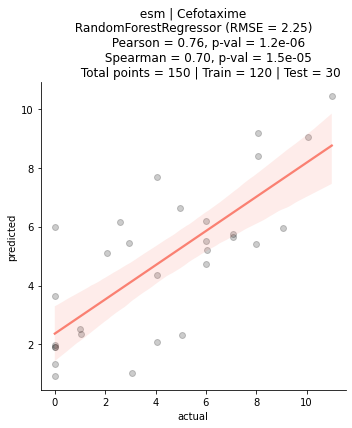

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using esm
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.32s/it]


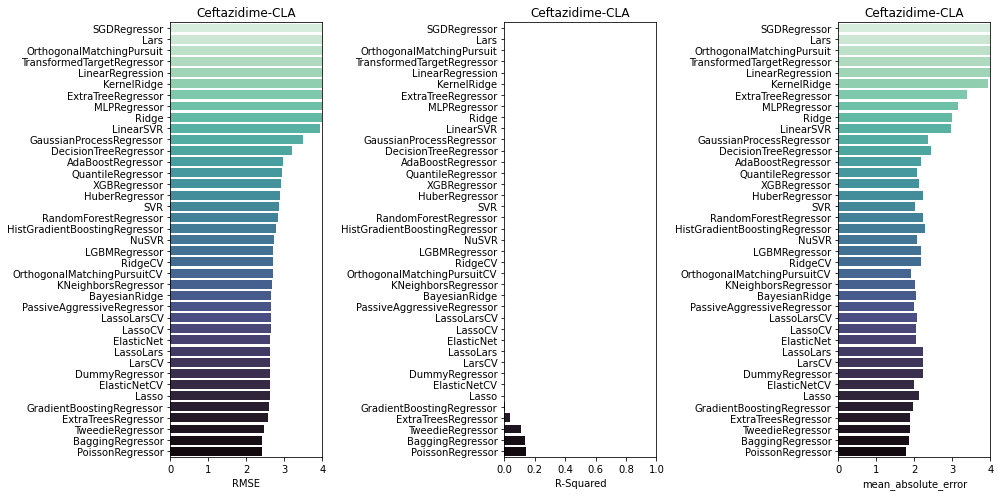

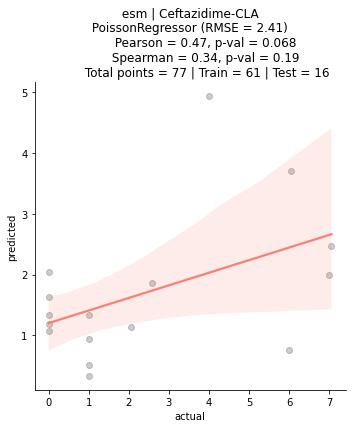

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using esm
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:54<00:00,  1.30s/it]


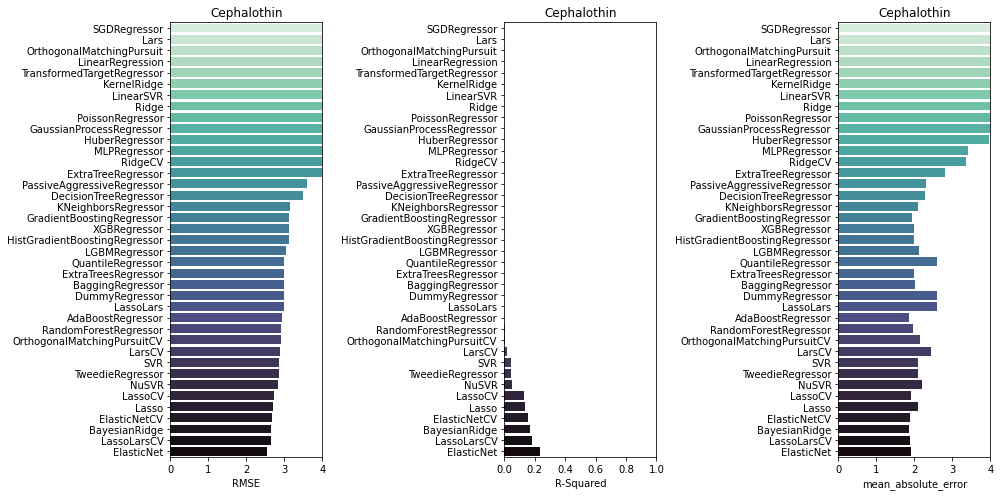

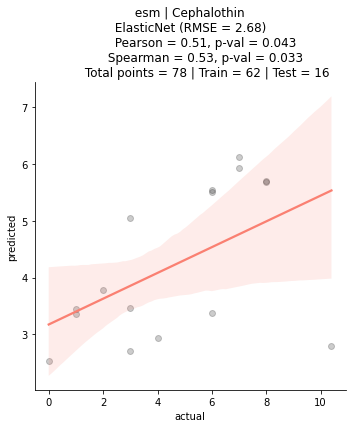

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using esm
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:12<00:00,  1.73s/it]


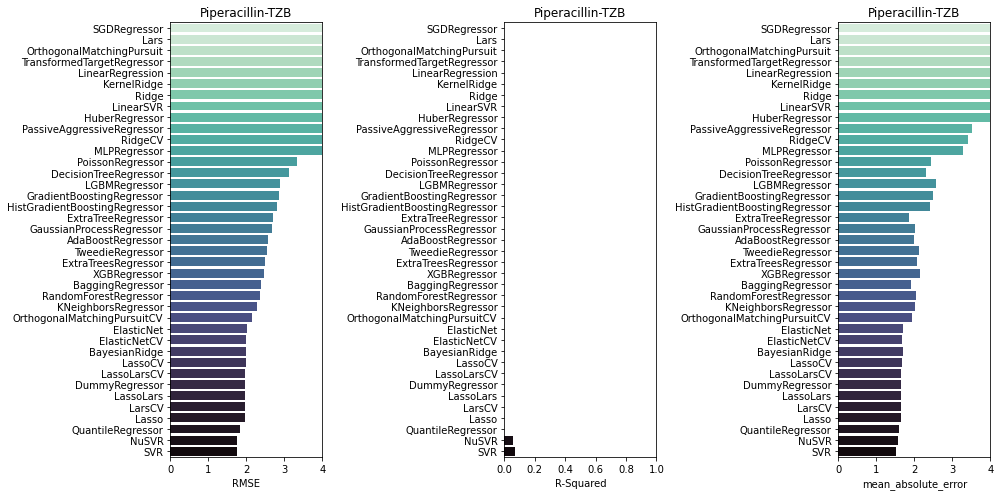

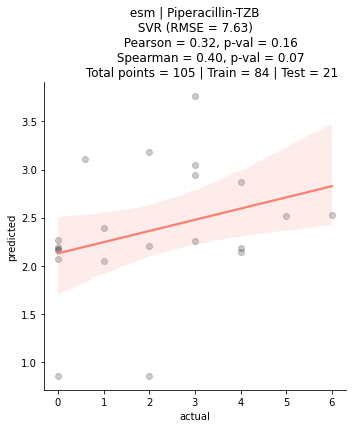

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using esm
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:40<00:00,  1.04it/s]


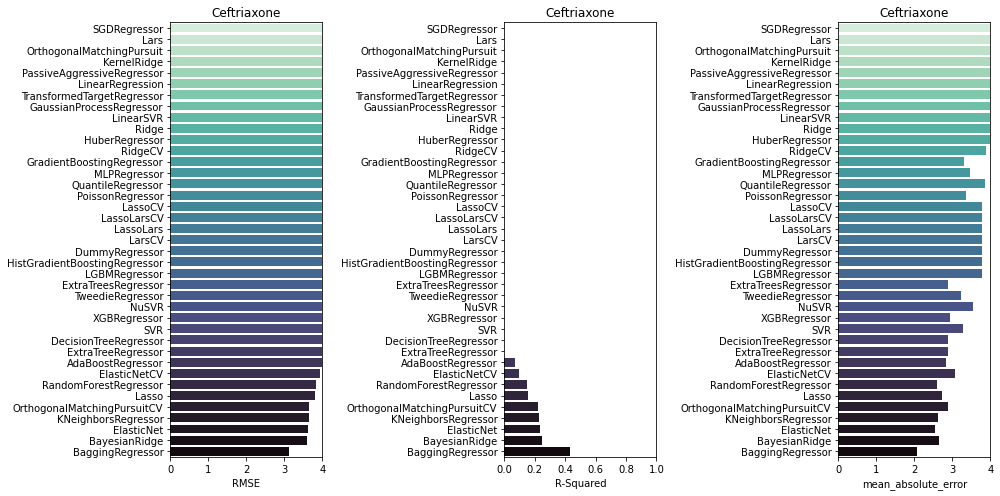

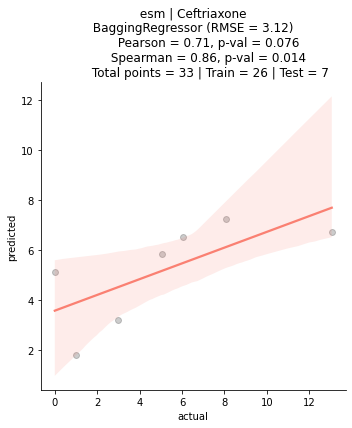

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using esm
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.39s/it]


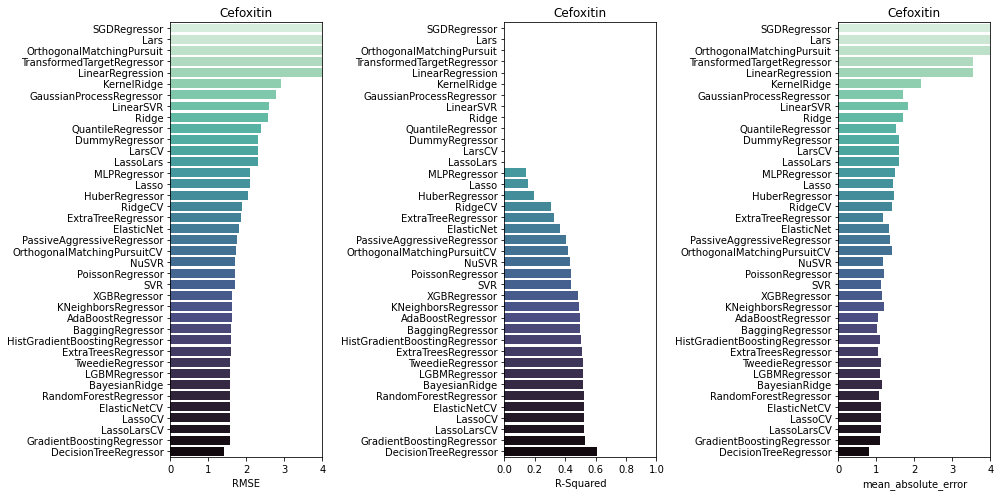

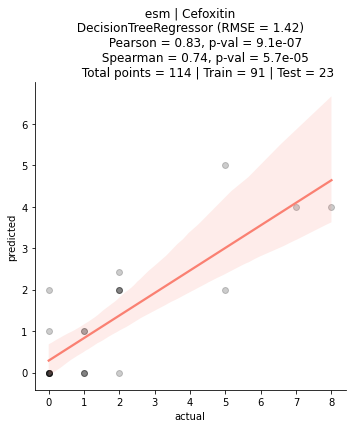

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using esm
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.21s/it]


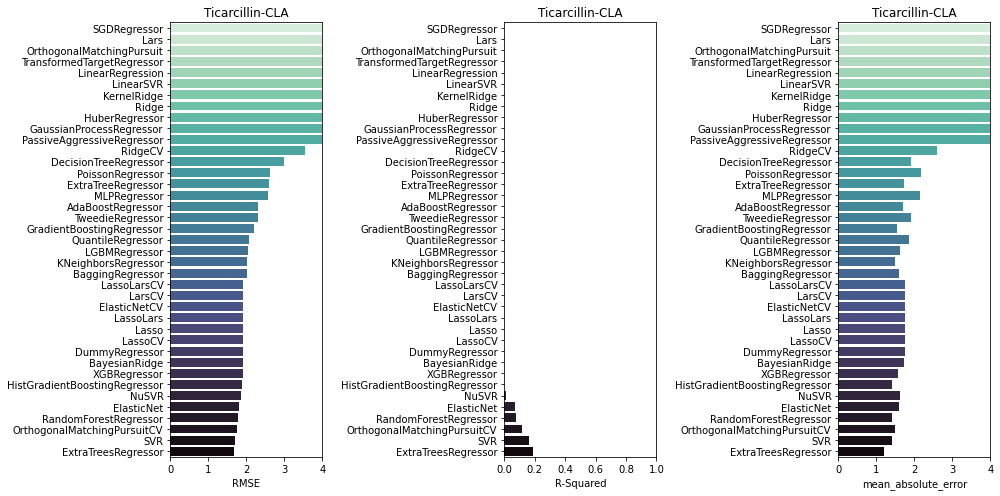

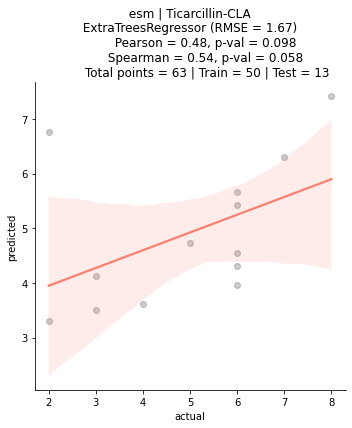

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using esm
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:02<00:00,  1.48s/it]


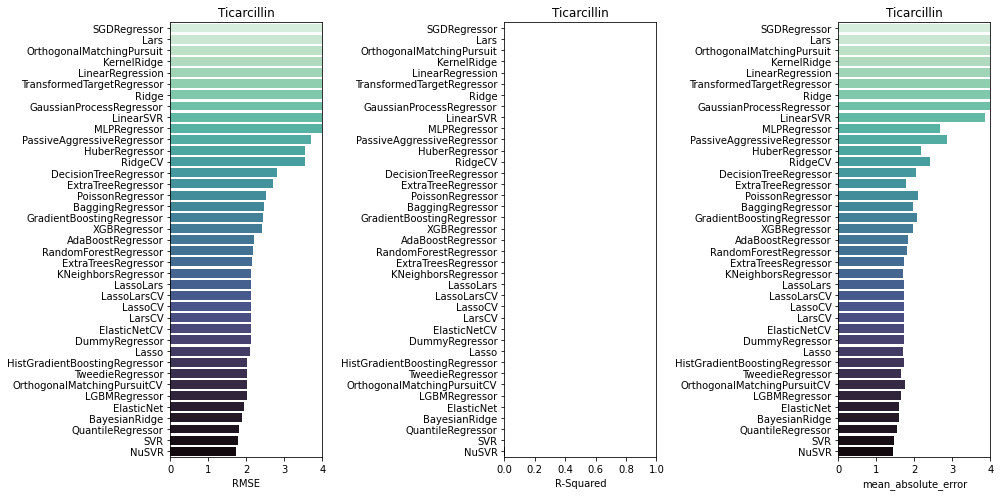

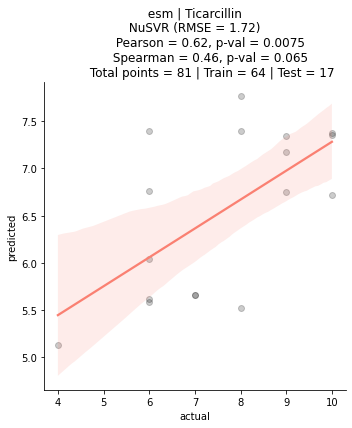

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using esm
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:32<00:00,  1.29it/s]


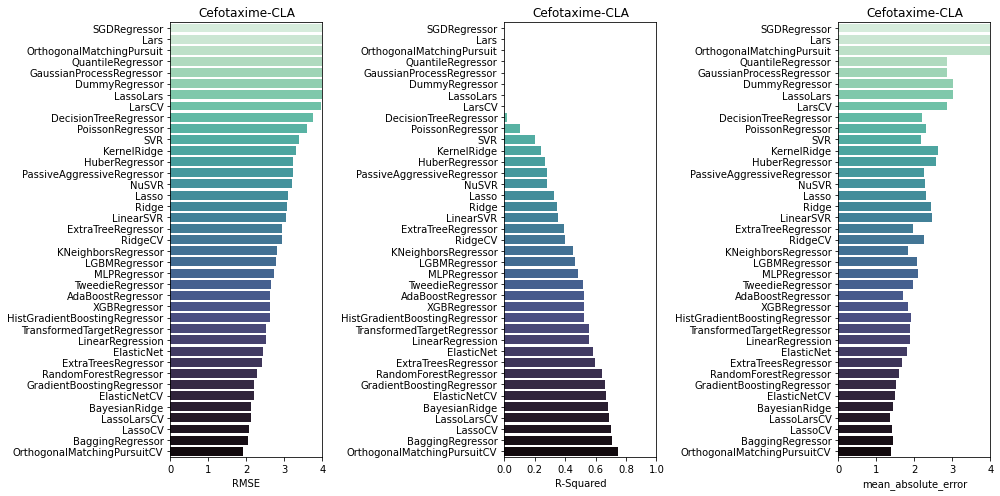

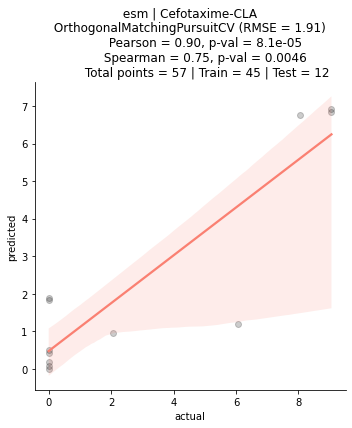

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using esm
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:46<00:00,  1.12s/it]


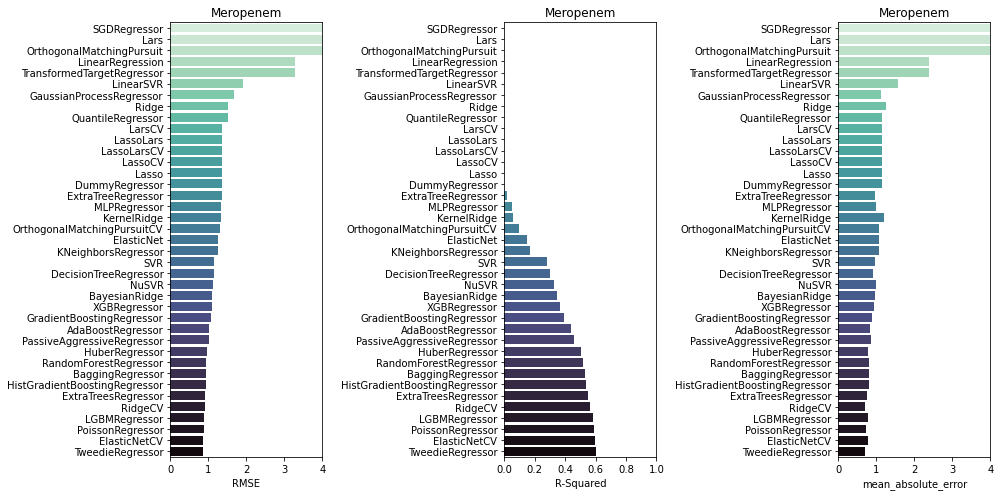

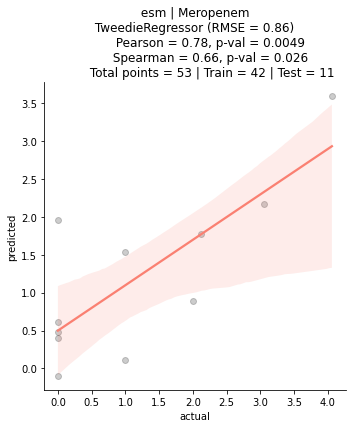

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using esm
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.21s/it]


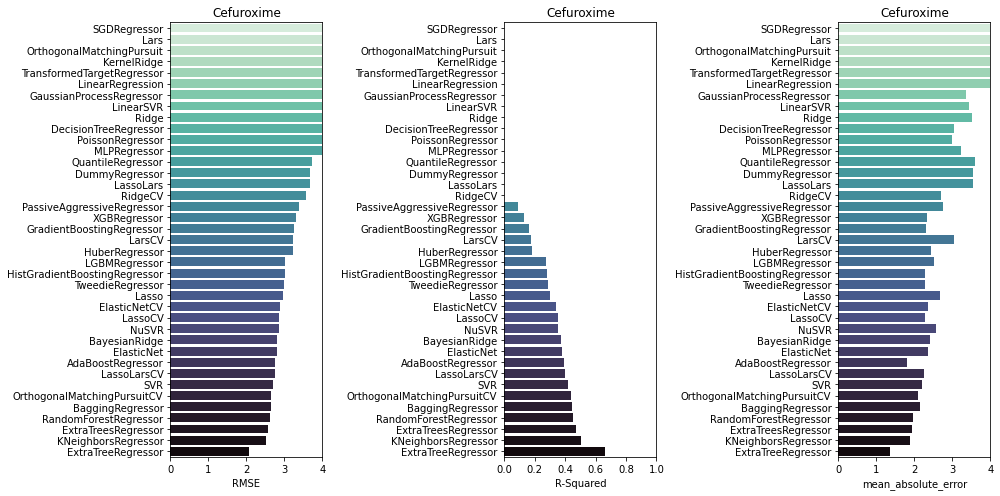

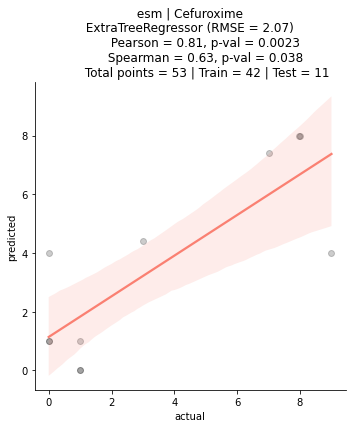

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using esm
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.01it/s]


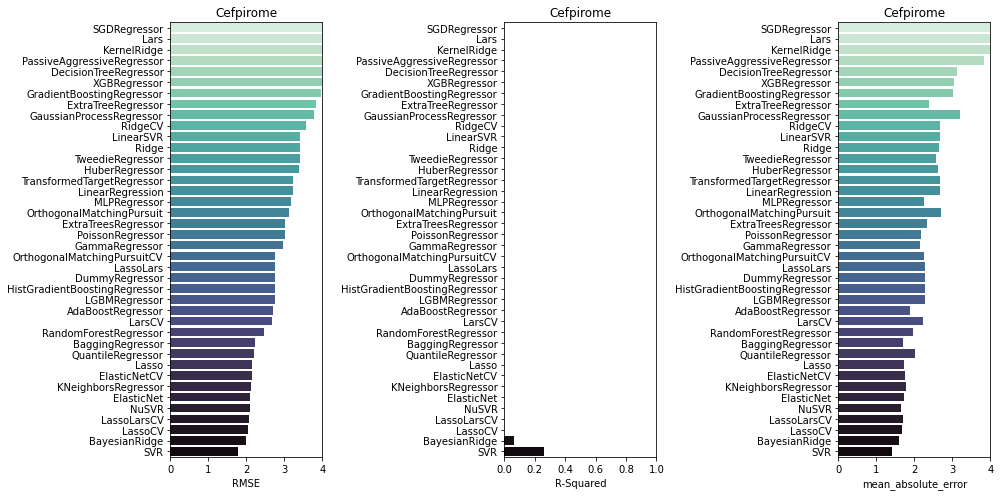

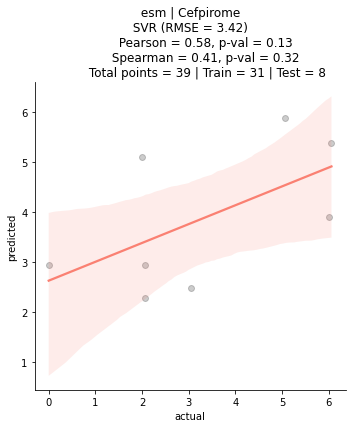

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using esm
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:37<00:00,  1.13it/s]


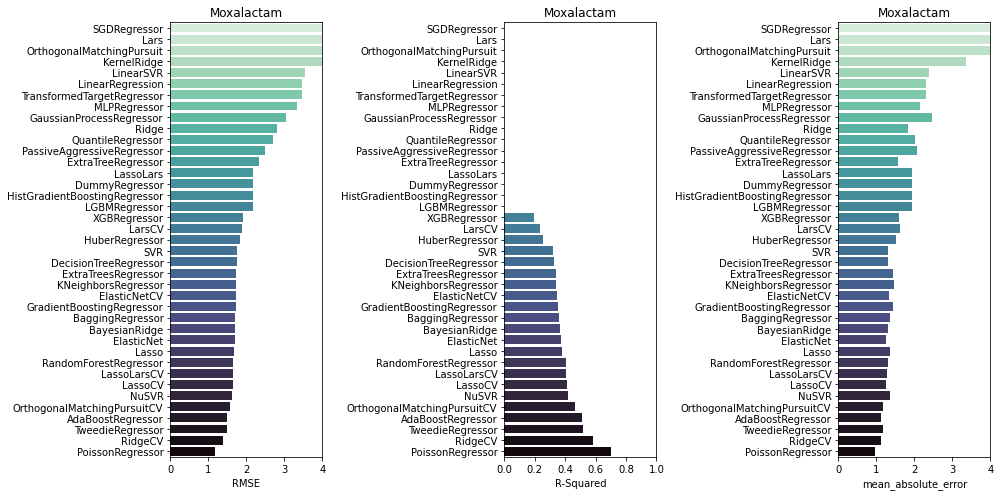

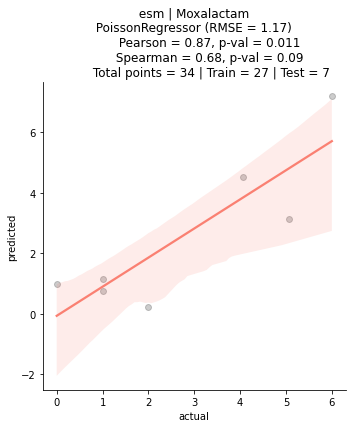

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using esm
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:05<00:00,  1.56s/it]


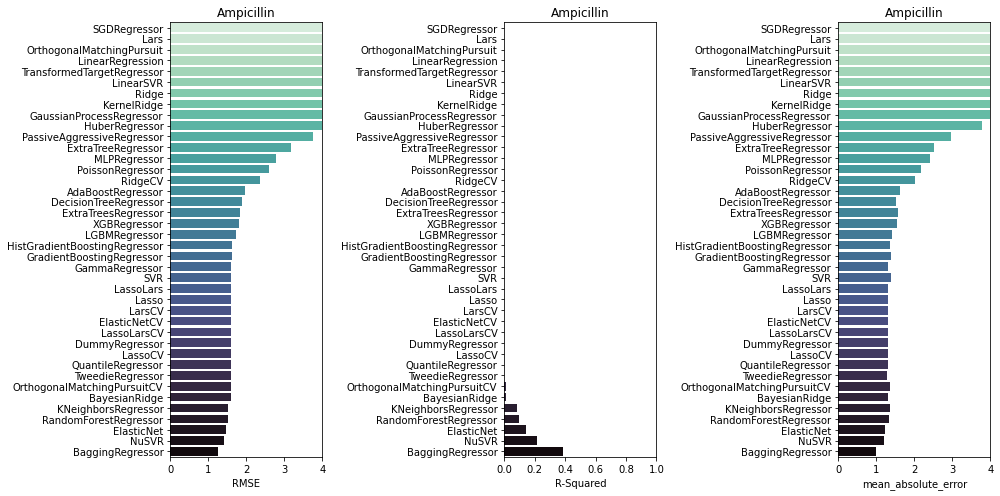

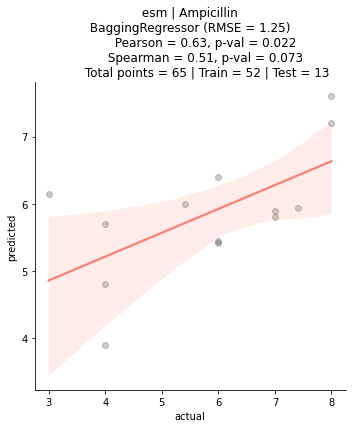

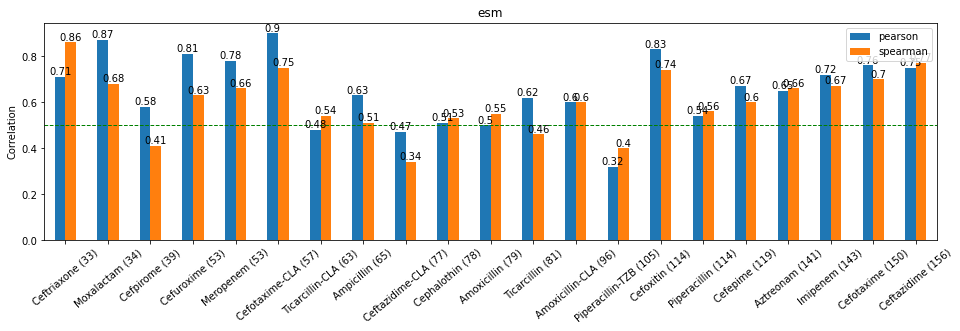

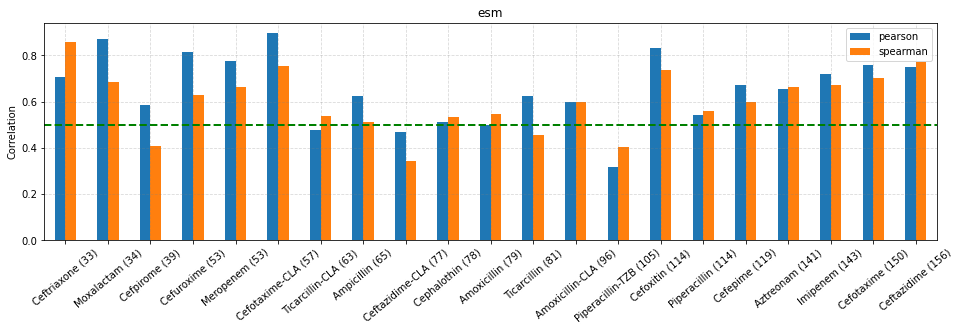

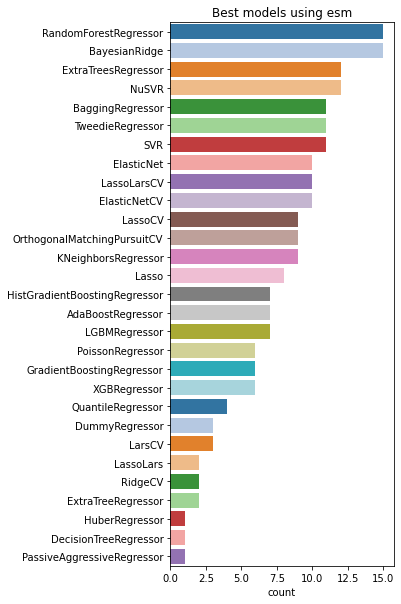

In [19]:
# set plm model
model = "esm"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_esm = pd.DataFrame()
df_metrics_esm["anti"]         = anti_lst  
df_metrics_esm["best_model"]   = model_lst  
df_metrics_esm["rmse"]         = rmse_lst 
df_metrics_esm["mae"]          = mae_lst
df_metrics_esm["r2"]           = r_lst 
df_metrics_esm["pearson"]      = pear_lst 
df_metrics_esm["pearson_p"]    = pearp_lst 
df_metrics_esm["spearman"]     = spear_lst 
df_metrics_esm["spearman_p"]   = spearp_lst 
df_metrics_esm["data_size"]    = data_size_lst 
df_metrics_esm["train_size"]   = train_size_lst 
df_metrics_esm["test_size"]    = test_size_lst 
df_metrics_esm["top10_models"] = top10_models_lst
df_metrics_esm["anti_lab"]     = df_metrics_esm["anti"] + " " + "(" + df_metrics_esm["data_size"].astype(str) + ")"
df_metrics_esm = df_metrics_esm.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_esm.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_esm.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_esm.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_esm.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## aa_composition

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using aa_composition
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.18it/s]


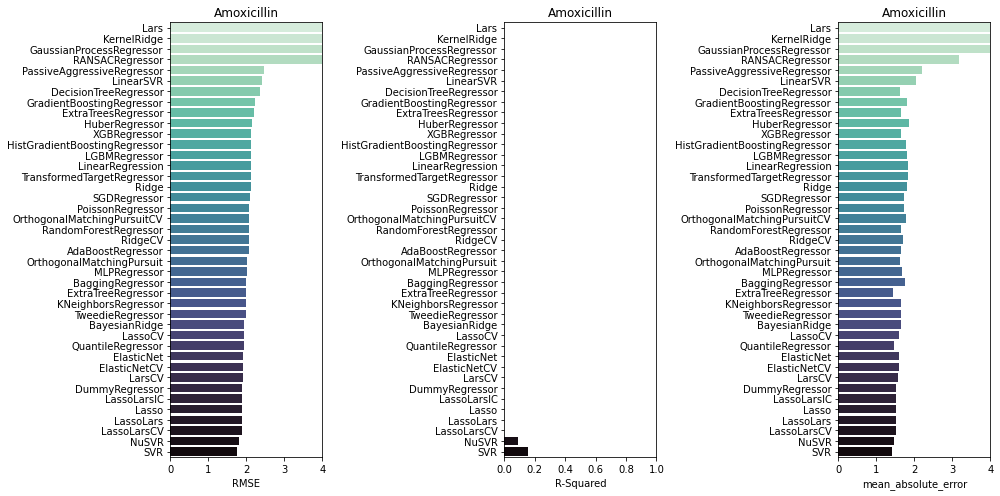

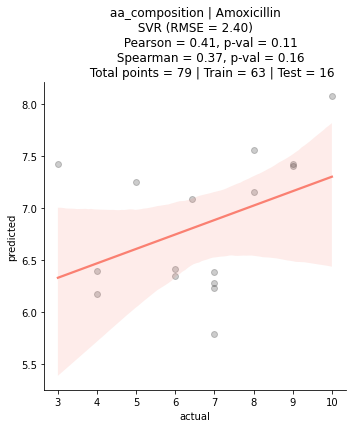

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using aa_composition
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.94it/s]


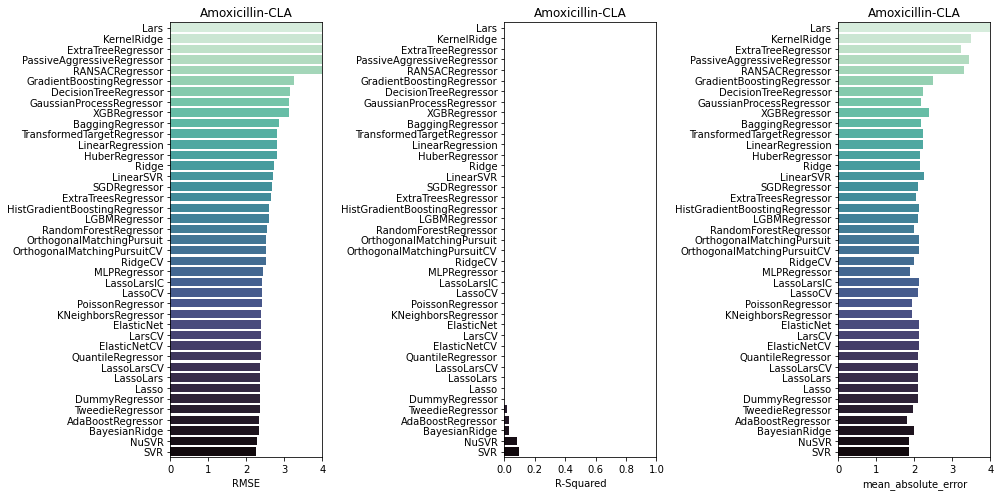

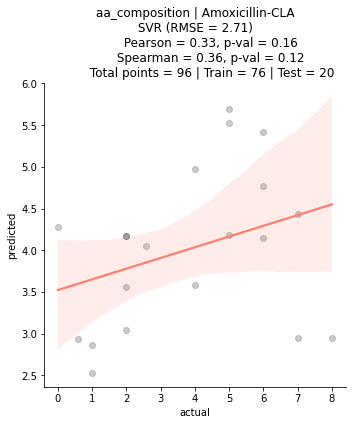

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using aa_composition
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.37it/s]


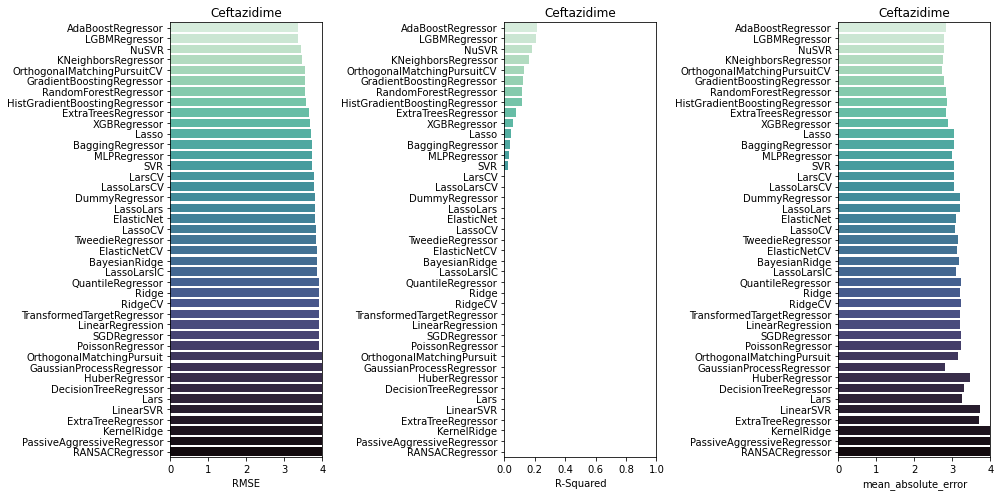

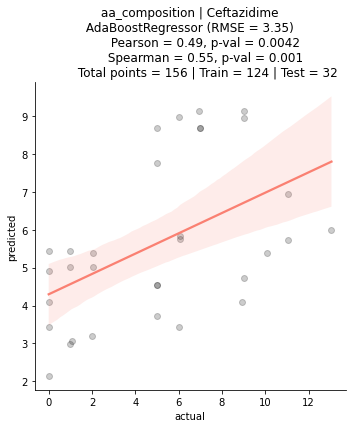

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using aa_composition
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.03it/s]


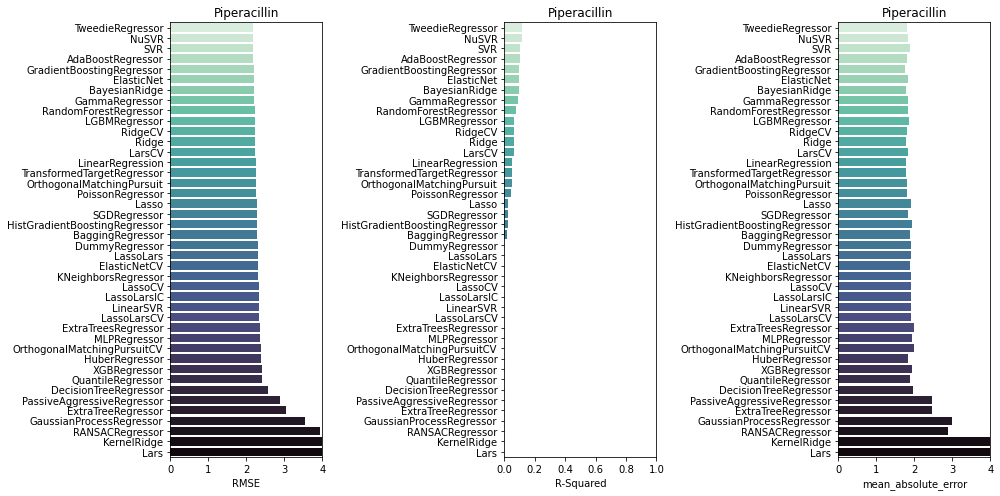

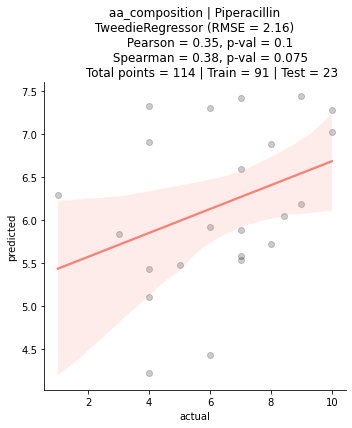

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using aa_composition
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.58it/s]


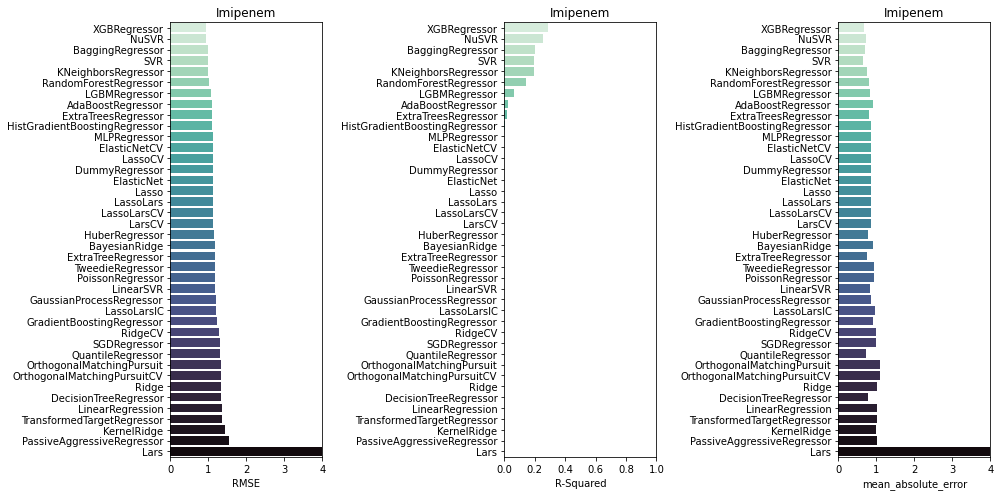

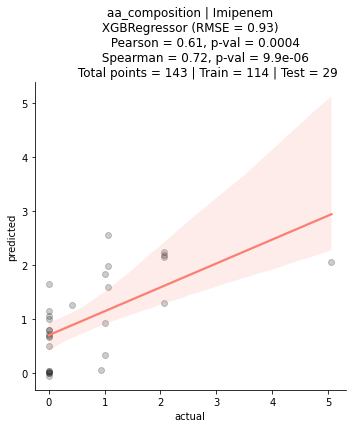

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using aa_composition
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.52it/s]


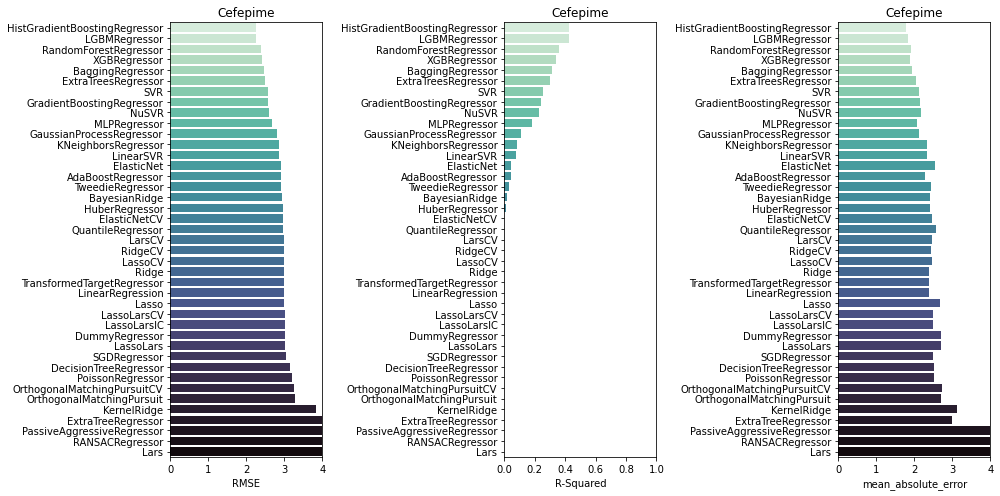

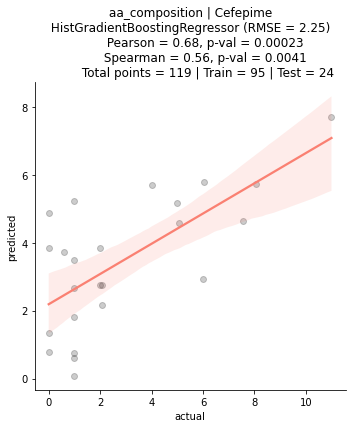

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using aa_composition
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.47it/s]


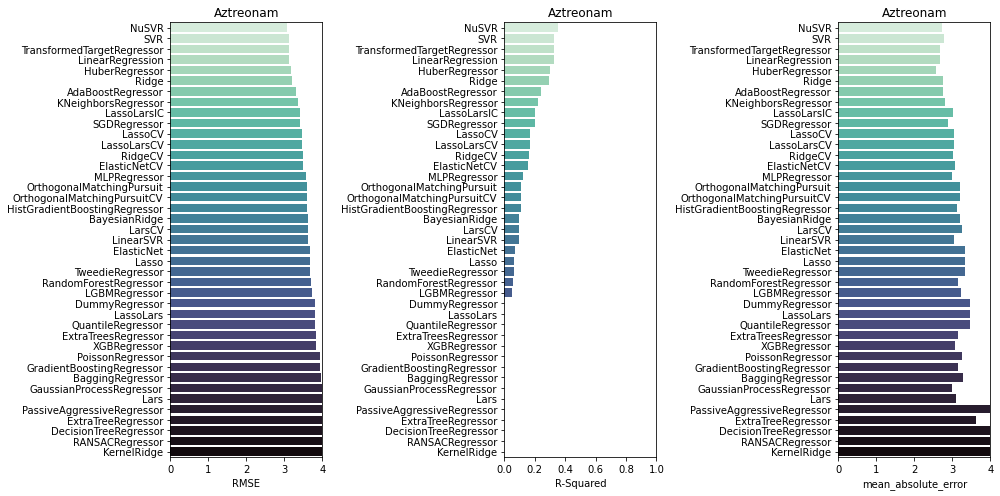

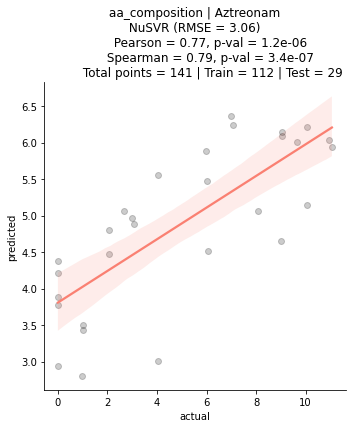

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using aa_composition
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.98it/s]


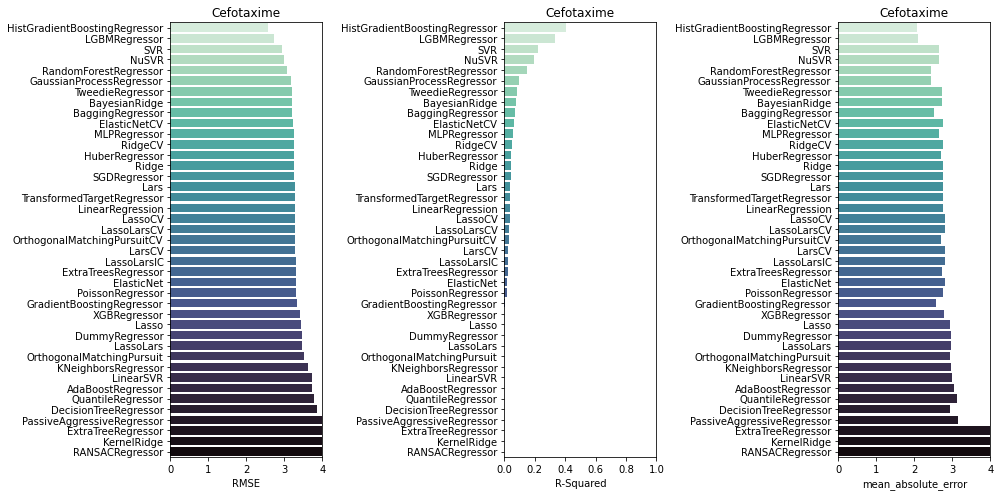

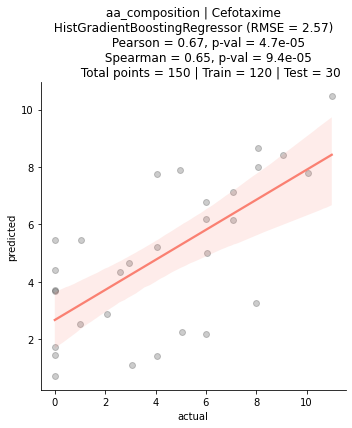

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using aa_composition
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.76it/s]


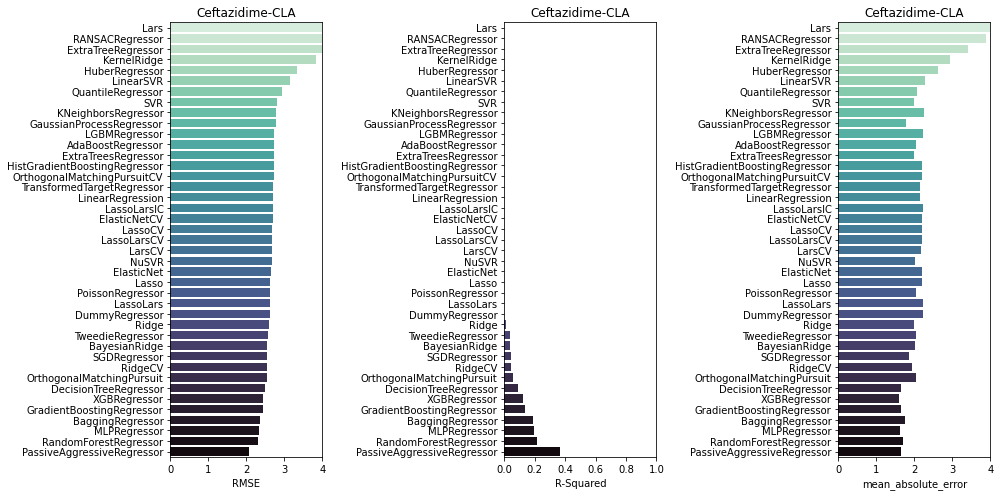

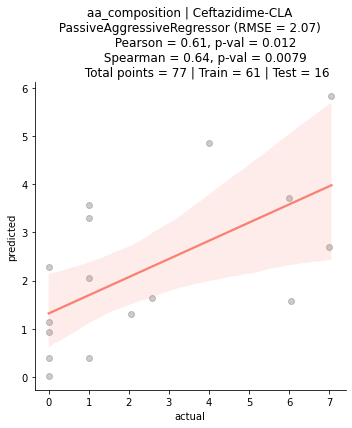

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using aa_composition
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.97it/s]


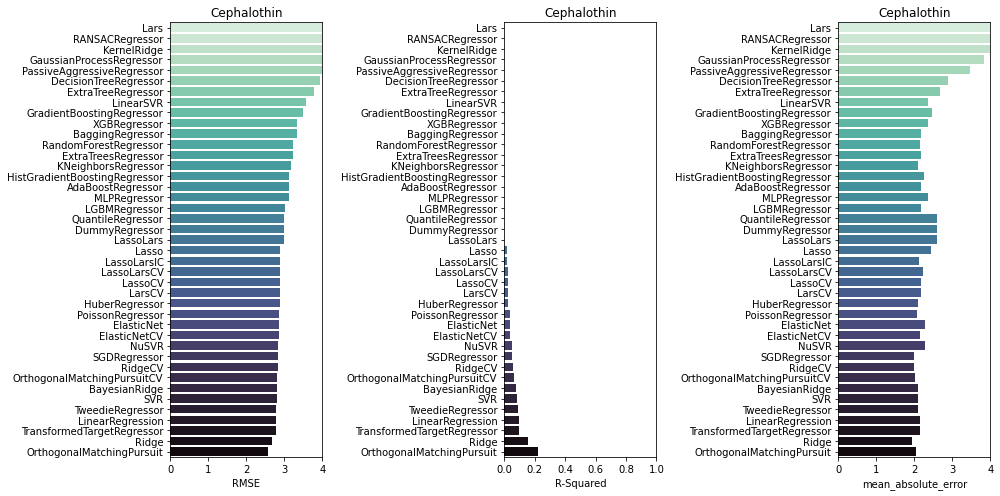

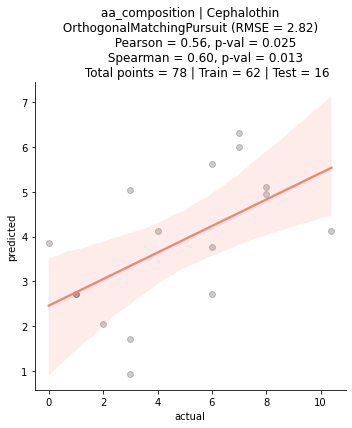

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using aa_composition
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.91it/s]


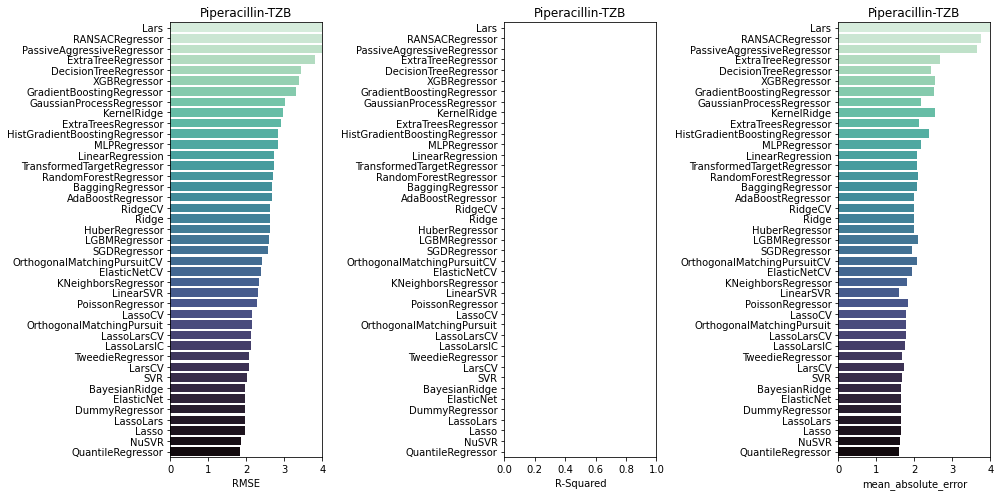

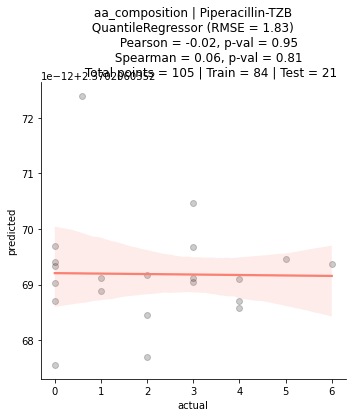

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using aa_composition
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.36it/s]


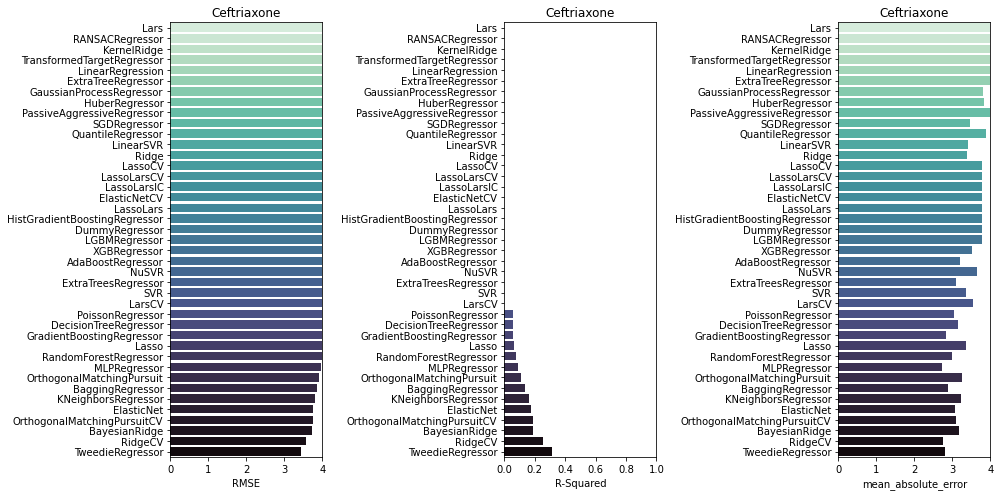

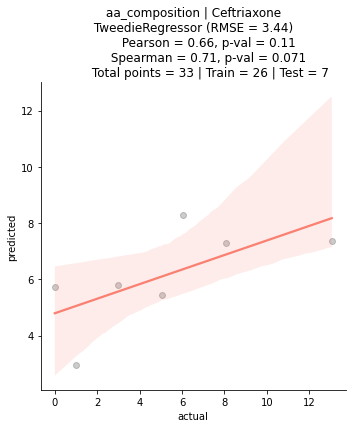

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using aa_composition
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.07it/s]


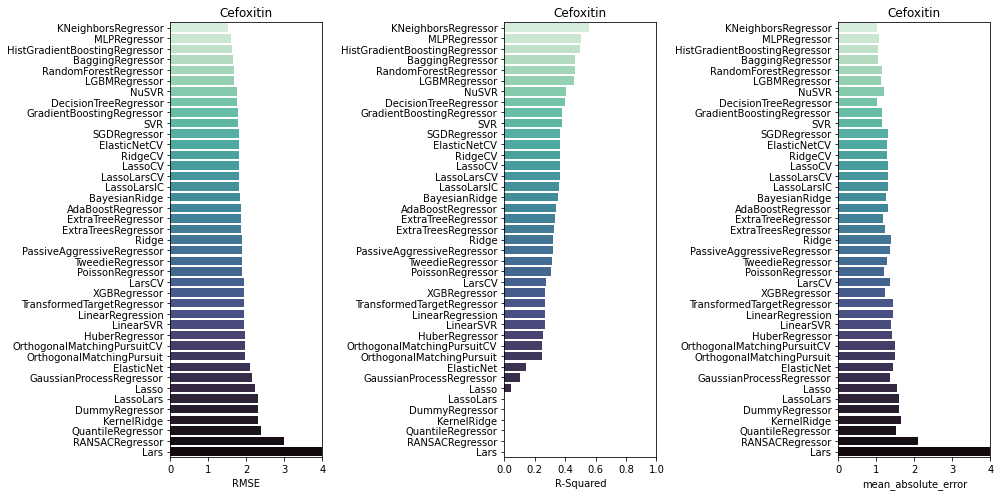

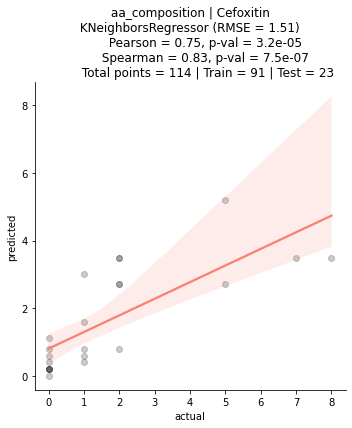

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using aa_composition
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.48it/s]


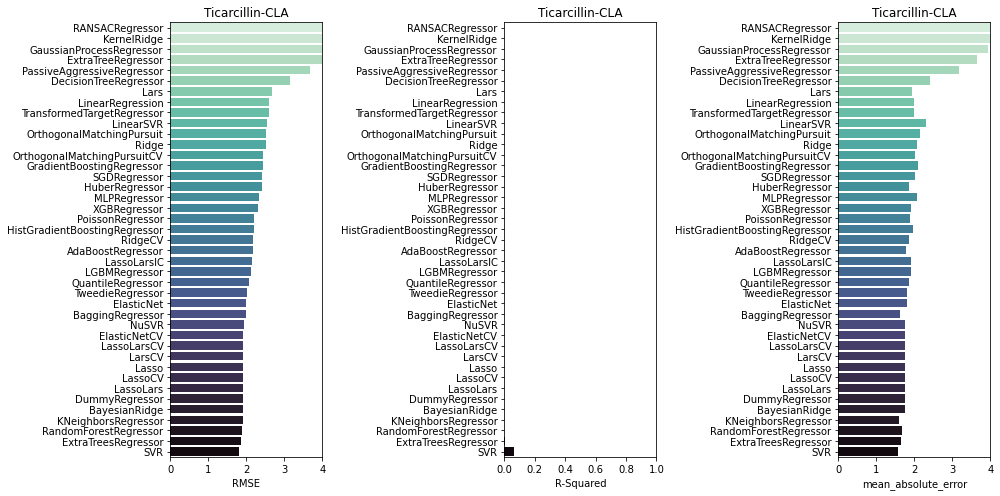

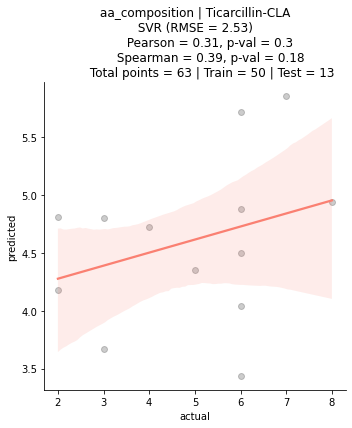

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using aa_composition
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.80it/s]


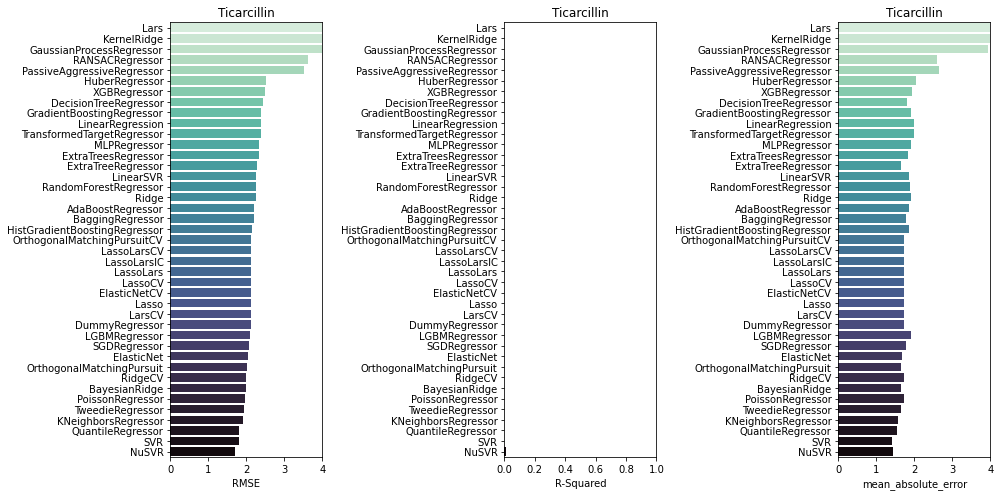

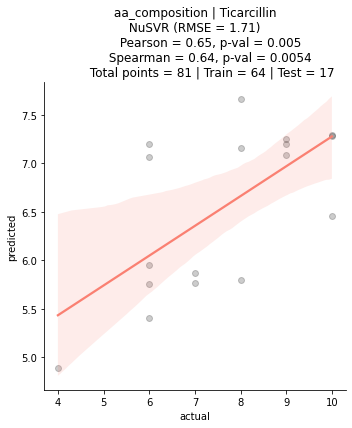

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using aa_composition
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.91it/s]


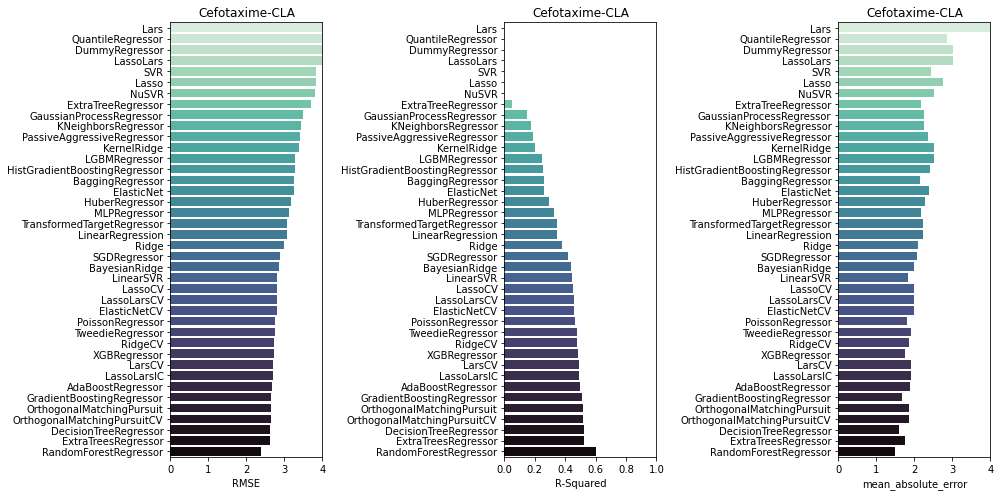

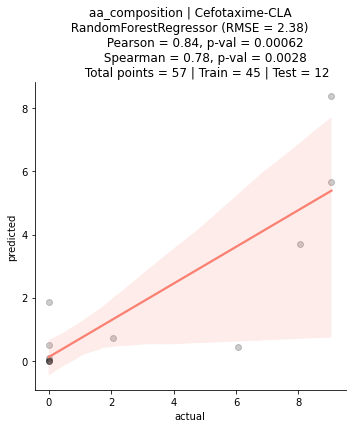

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using aa_composition
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.35it/s]


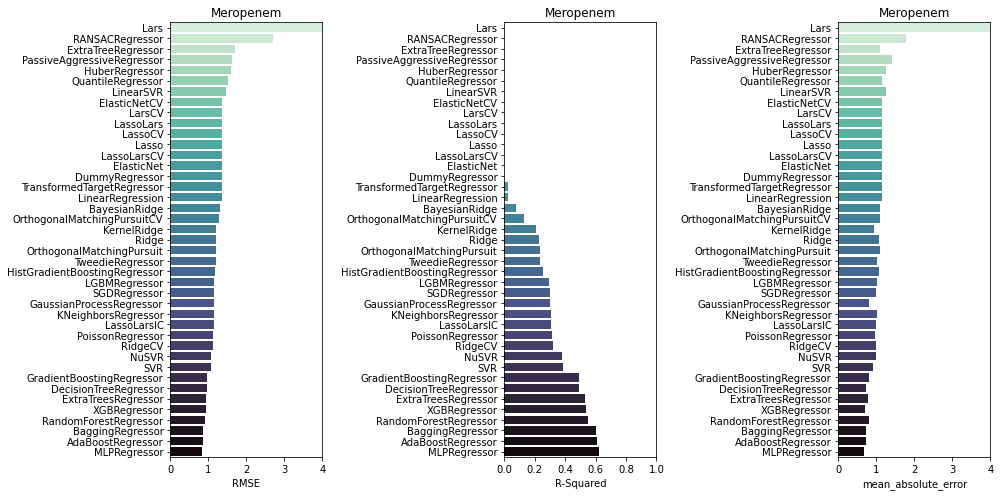

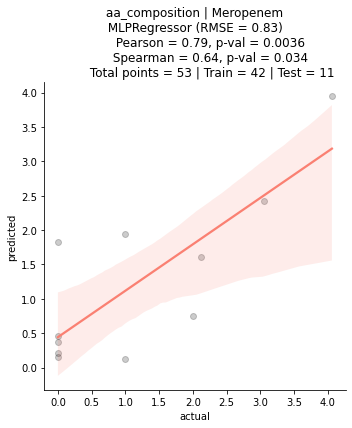

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using aa_composition
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.66it/s]


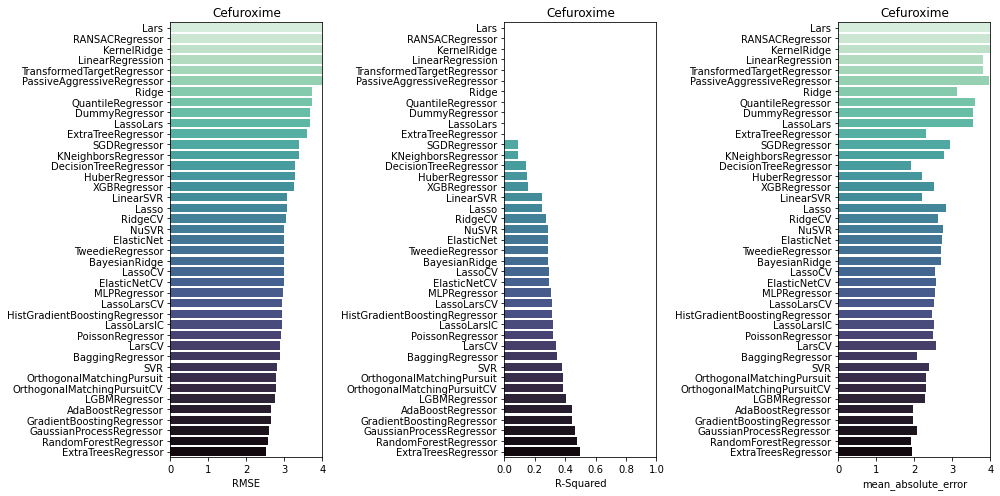

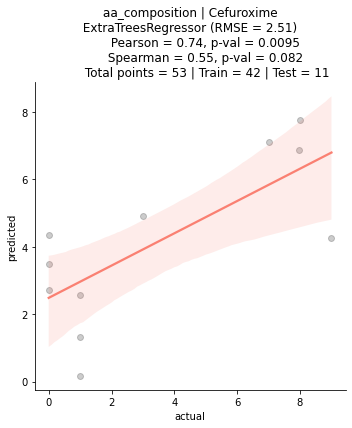

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using aa_composition
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.21it/s]


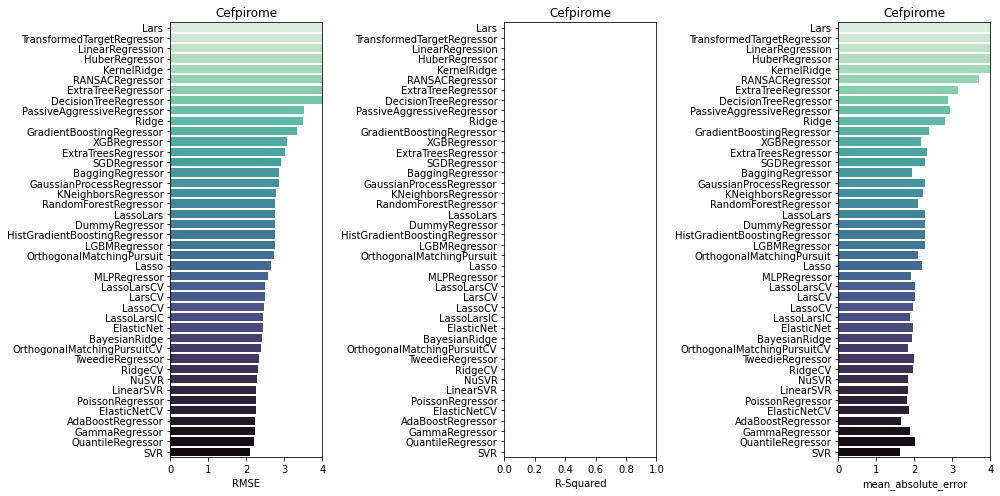

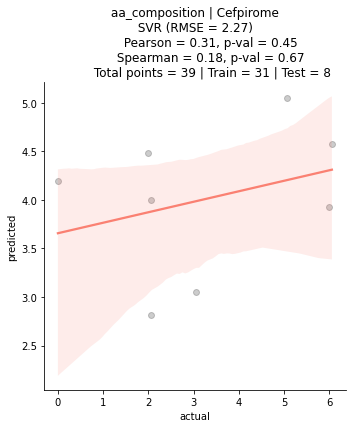

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using aa_composition
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:06<00:00,  6.00it/s]


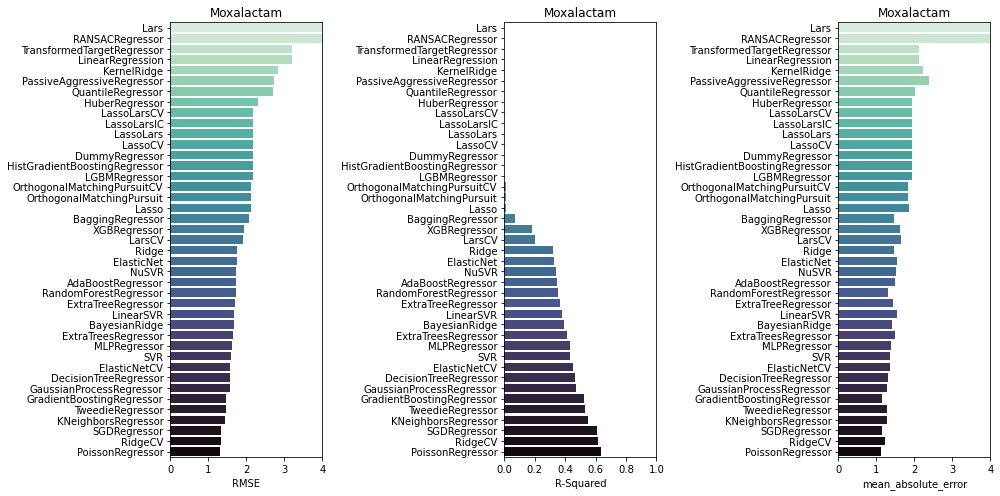

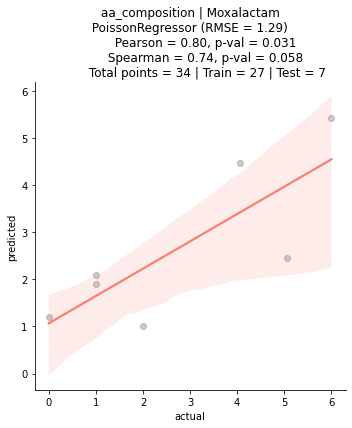

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using aa_composition
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:07<00:00,  5.31it/s]


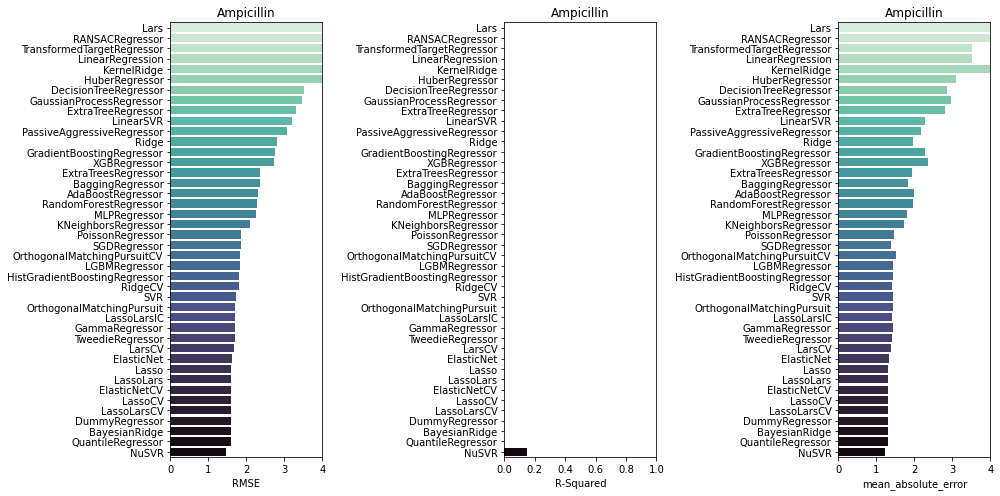

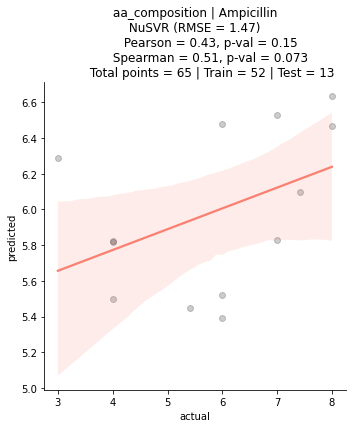

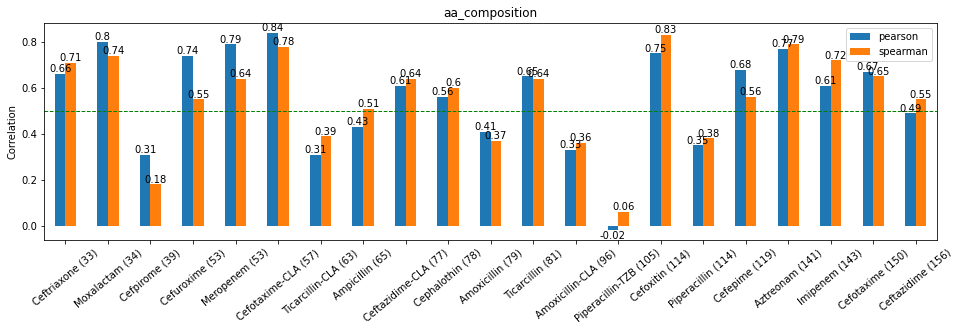

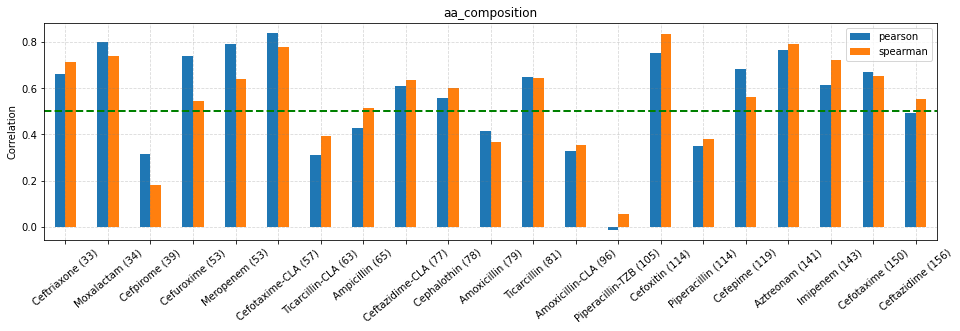

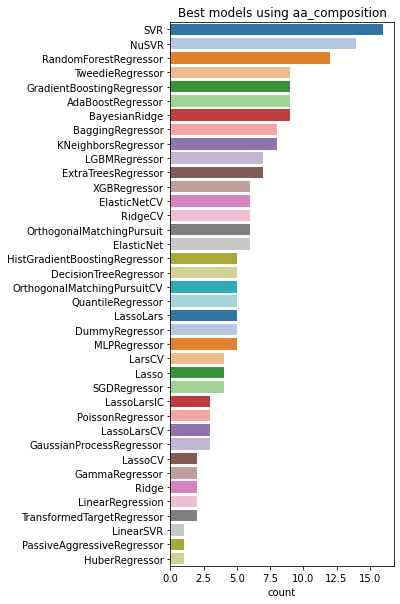

In [20]:
# set plm model
model = "aa_composition"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_aac = pd.DataFrame()
df_metrics_aac["anti"]         = anti_lst  
df_metrics_aac["best_model"]   = model_lst  
df_metrics_aac["rmse"]         = rmse_lst 
df_metrics_aac["mae"]          = mae_lst
df_metrics_aac["r2"]           = r_lst 
df_metrics_aac["pearson"]      = pear_lst 
df_metrics_aac["pearson_p"]    = pearp_lst 
df_metrics_aac["spearman"]     = spear_lst 
df_metrics_aac["spearman_p"]   = spearp_lst 
df_metrics_aac["data_size"]    = data_size_lst 
df_metrics_aac["train_size"]   = train_size_lst 
df_metrics_aac["test_size"]    = test_size_lst 
df_metrics_aac["top10_models"] = top10_models_lst
df_metrics_aac["anti_lab"]     = df_metrics_aac["anti"] + " " + "(" + df_metrics_aac["data_size"].astype(str) + ")"
df_metrics_aac = df_metrics_aac.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_aac.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_aac.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_aac.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_aac.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## t5bfd

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using t5bfd
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:52<00:00,  1.24s/it]


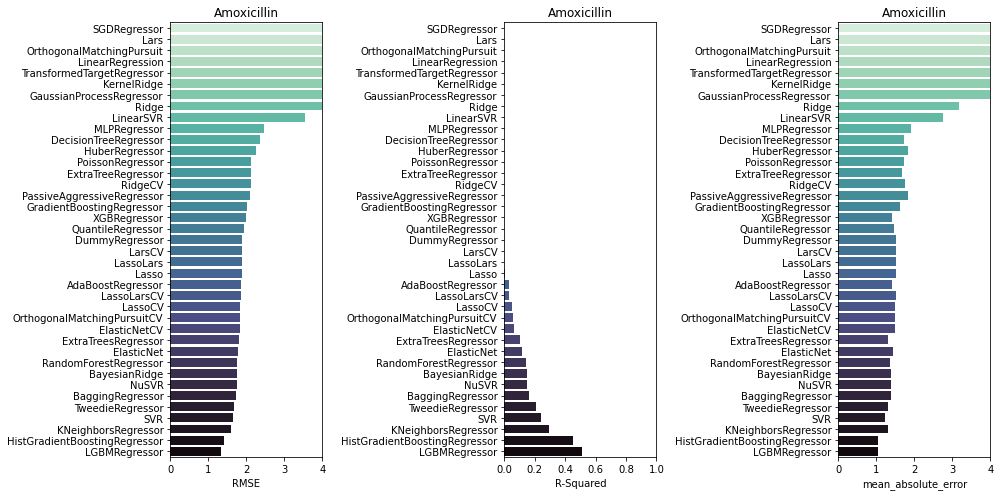

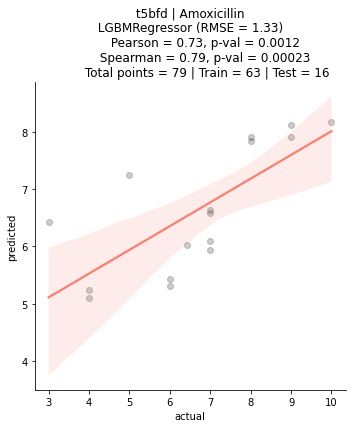

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using t5bfd
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.33s/it]


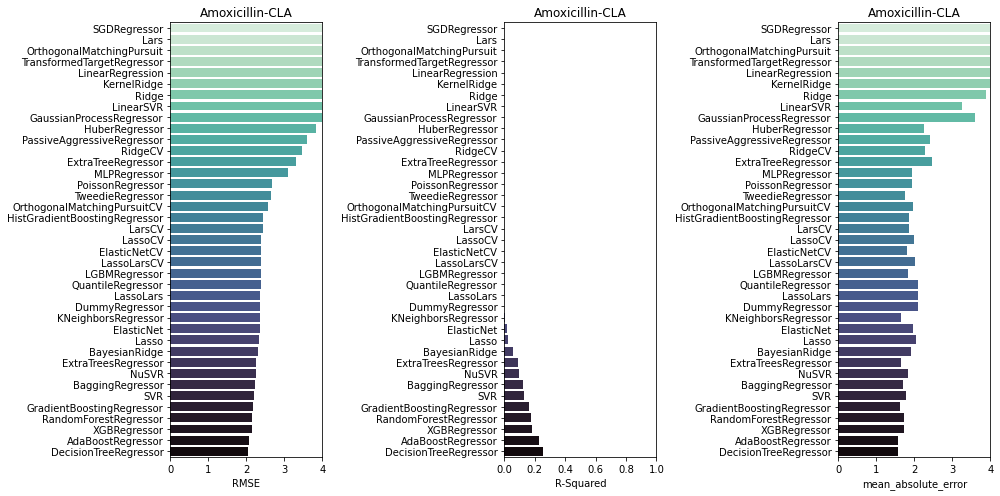

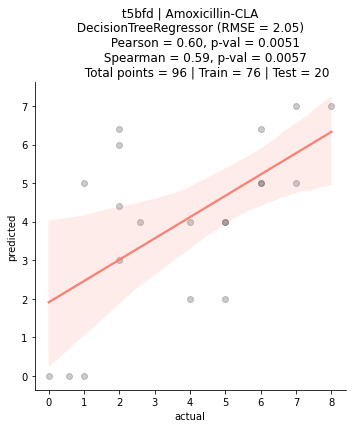

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using t5bfd
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:09<00:00,  1.66s/it]


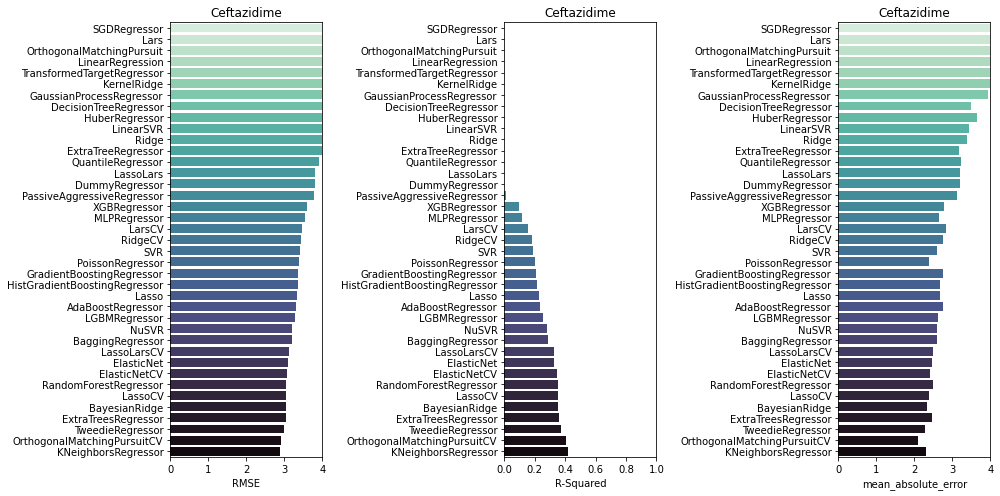

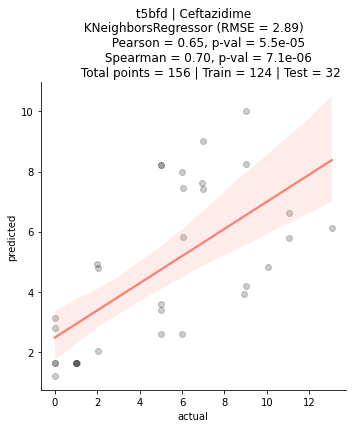

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using t5bfd
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:01<00:00,  1.46s/it]


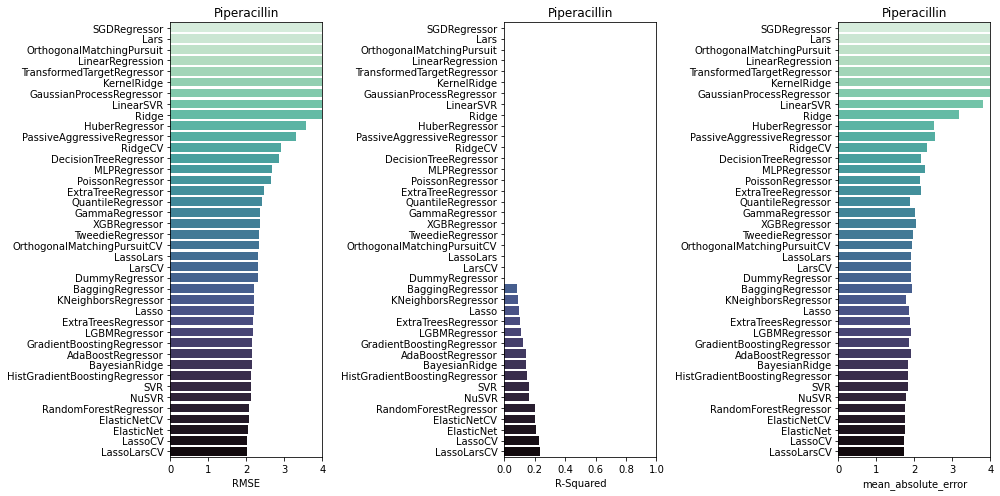

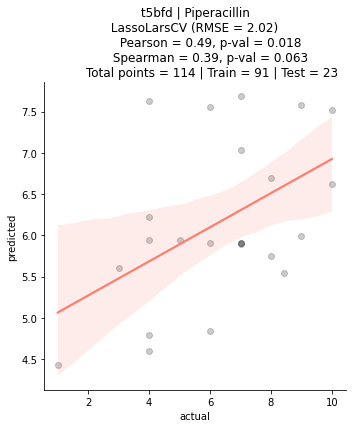

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using t5bfd
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:59<00:00,  1.43s/it]


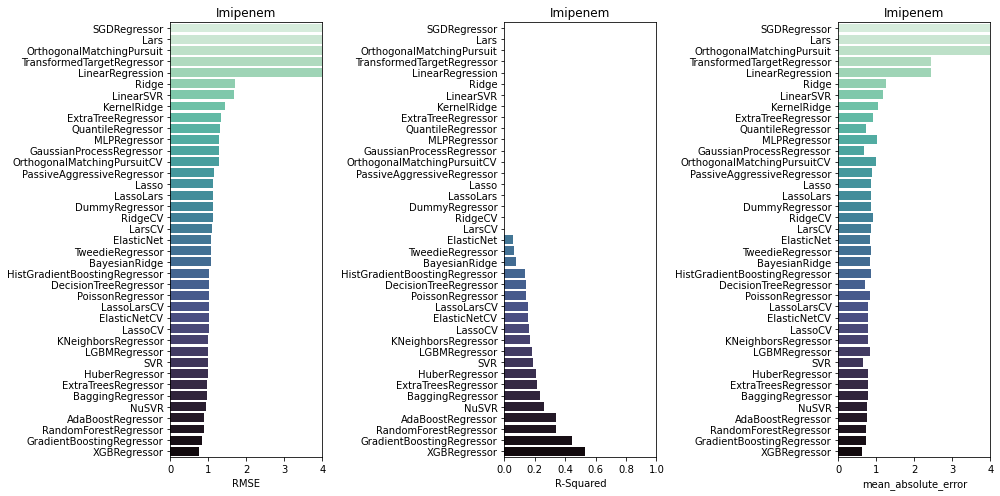

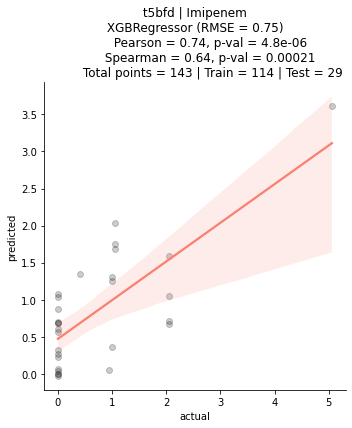

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using t5bfd
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:46<00:00,  1.11s/it]


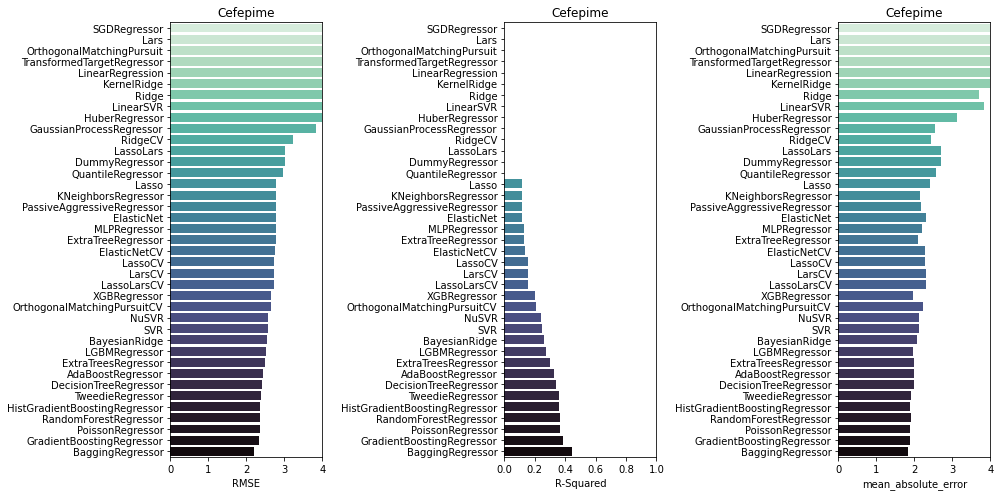

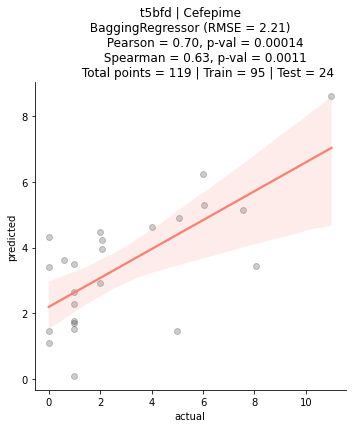

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using t5bfd
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.50s/it]


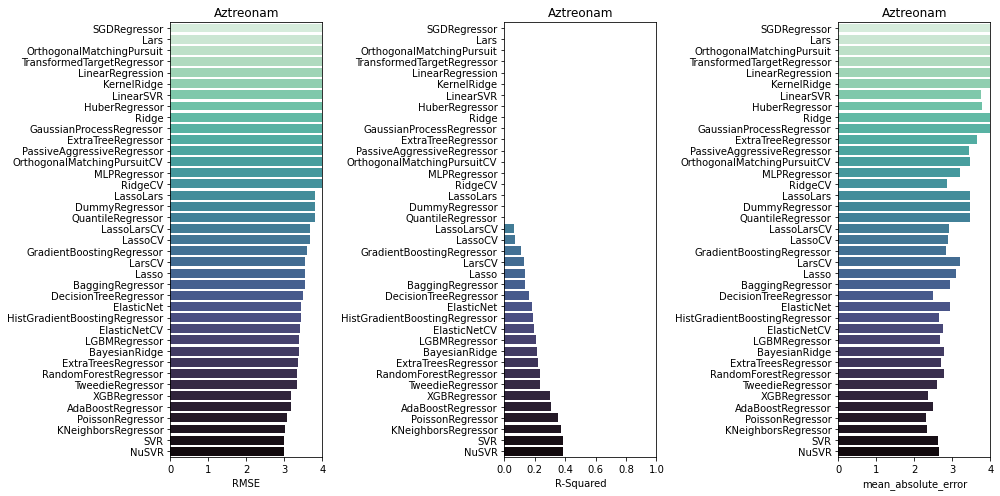

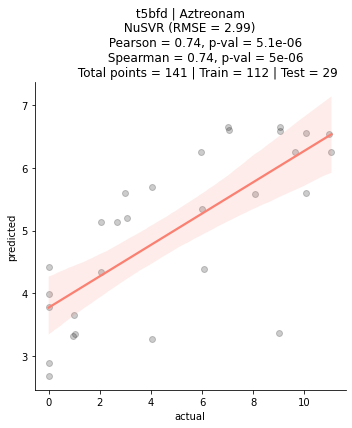

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using t5bfd
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.21s/it]


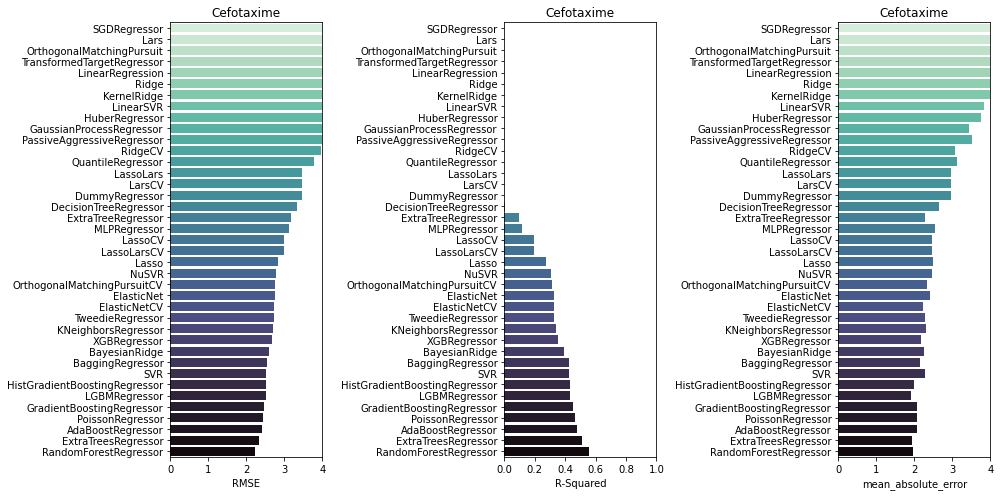

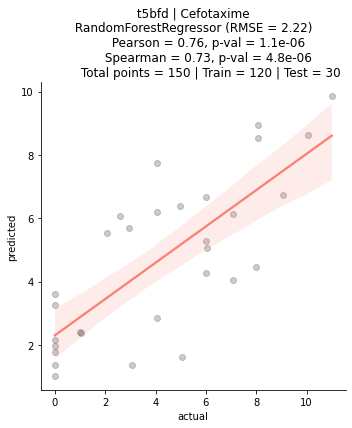

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using t5bfd
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:45<00:00,  1.08s/it]


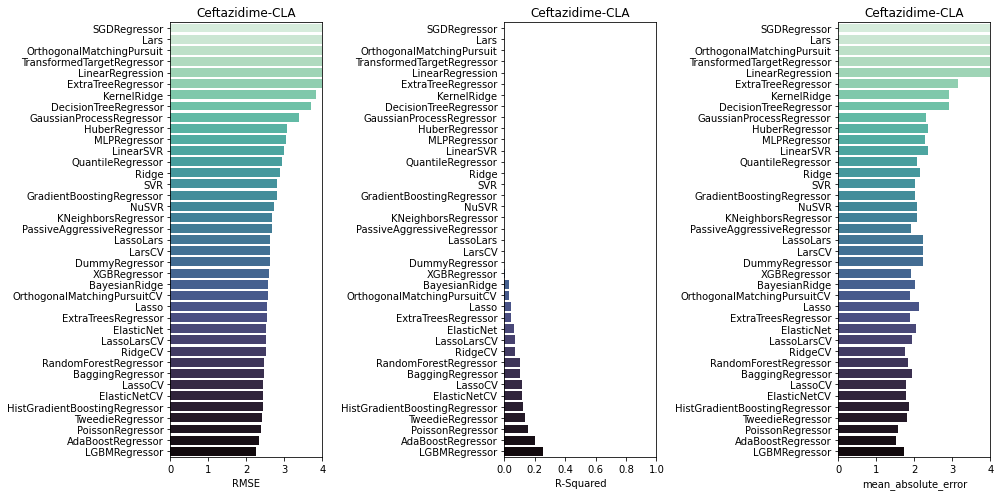

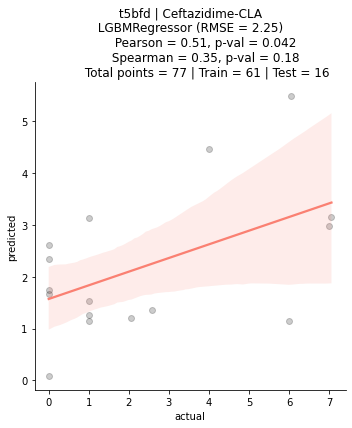

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using t5bfd
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.13s/it]


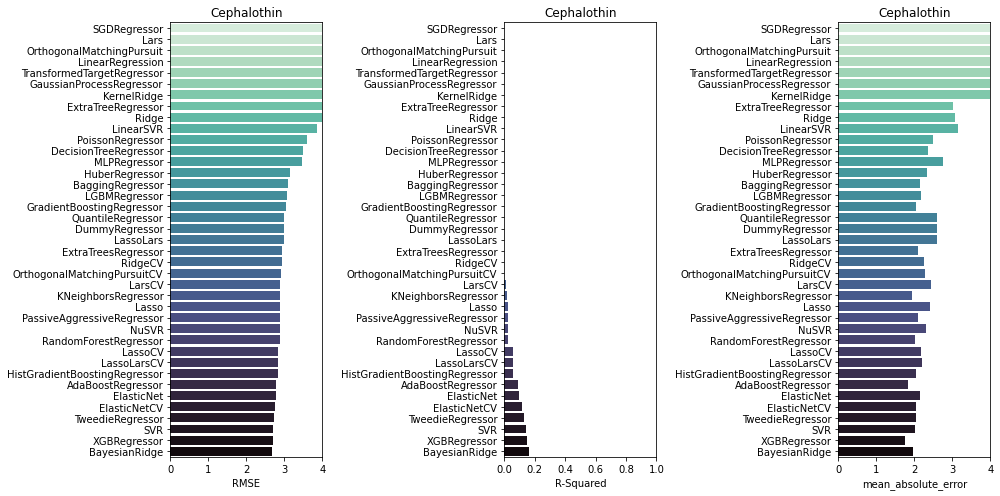

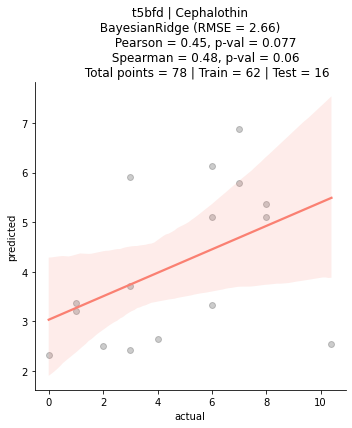

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using t5bfd
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.38s/it]


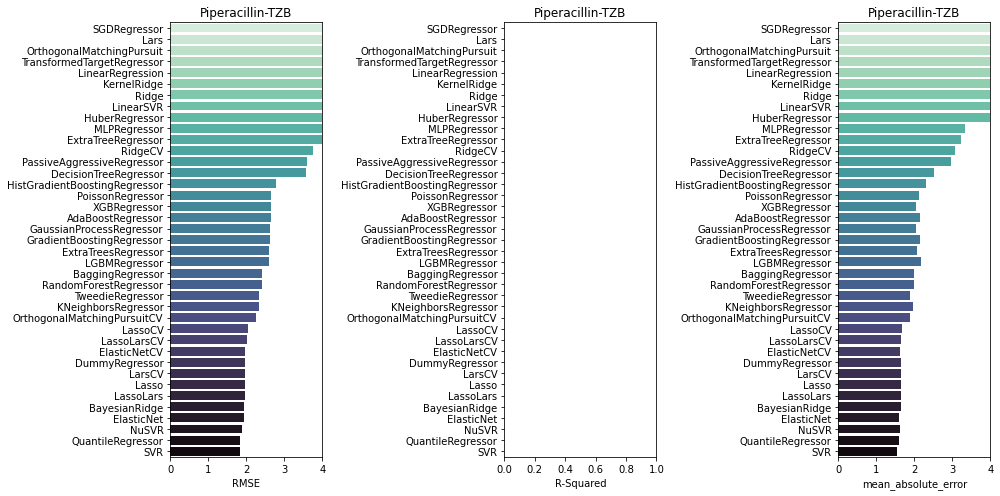

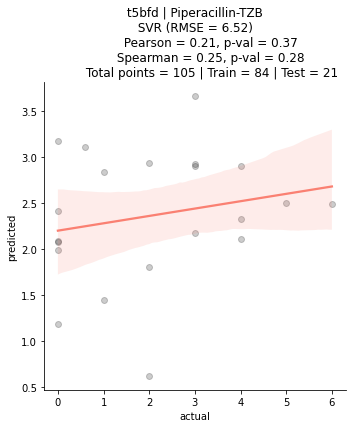

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using t5bfd
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:37<00:00,  1.11it/s]


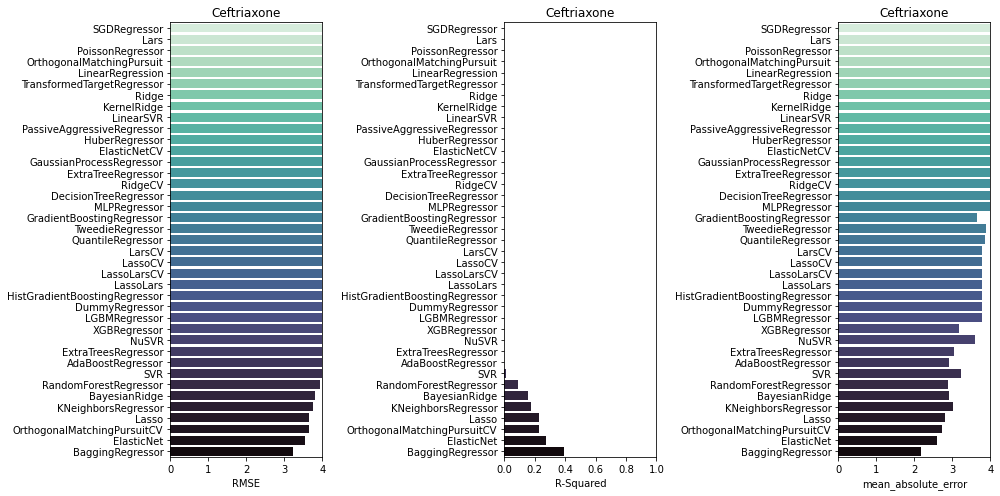

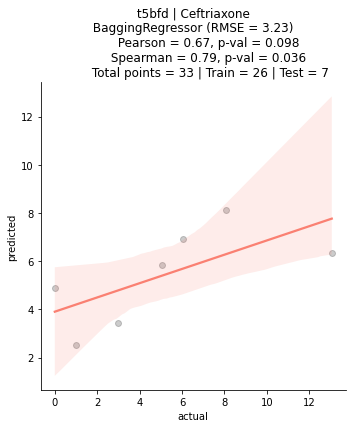

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using t5bfd
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:51<00:00,  1.22s/it]


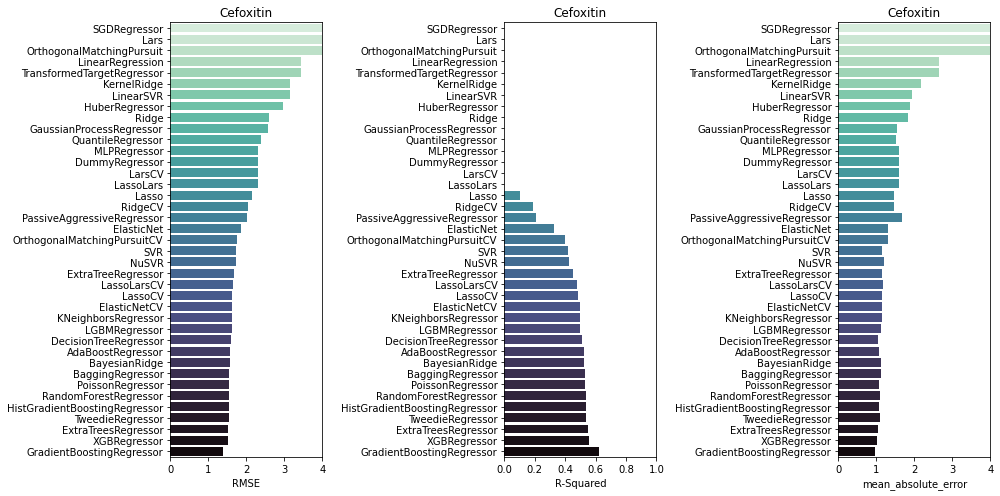

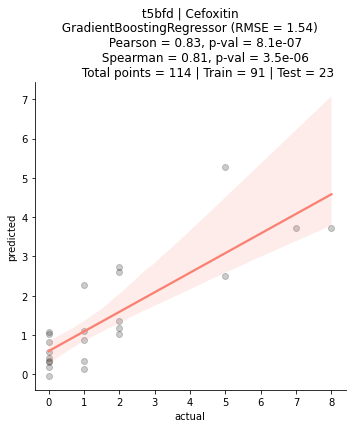

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using t5bfd
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:43<00:00,  1.03s/it]


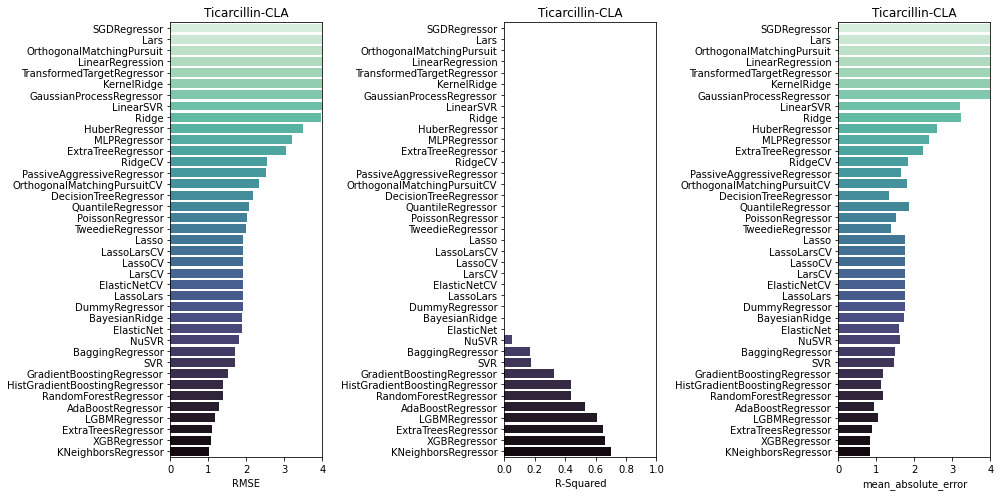

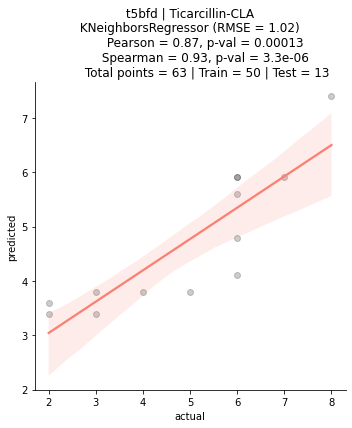

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using t5bfd
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.51s/it]


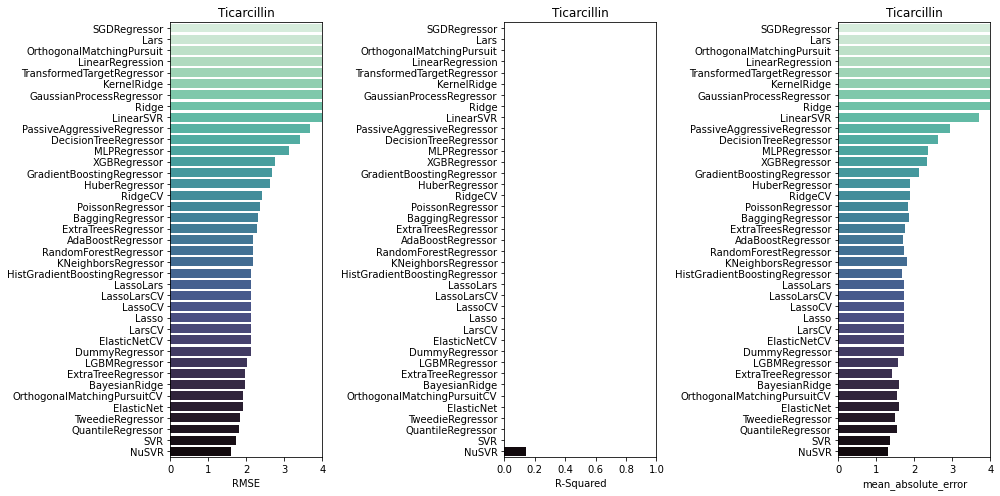

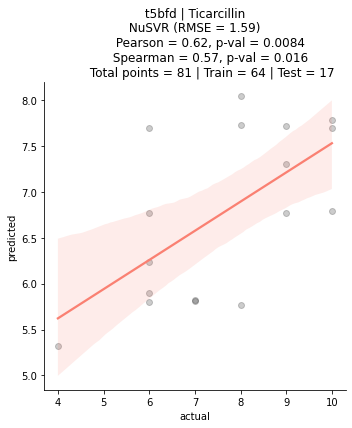

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using t5bfd
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:31<00:00,  1.34it/s]


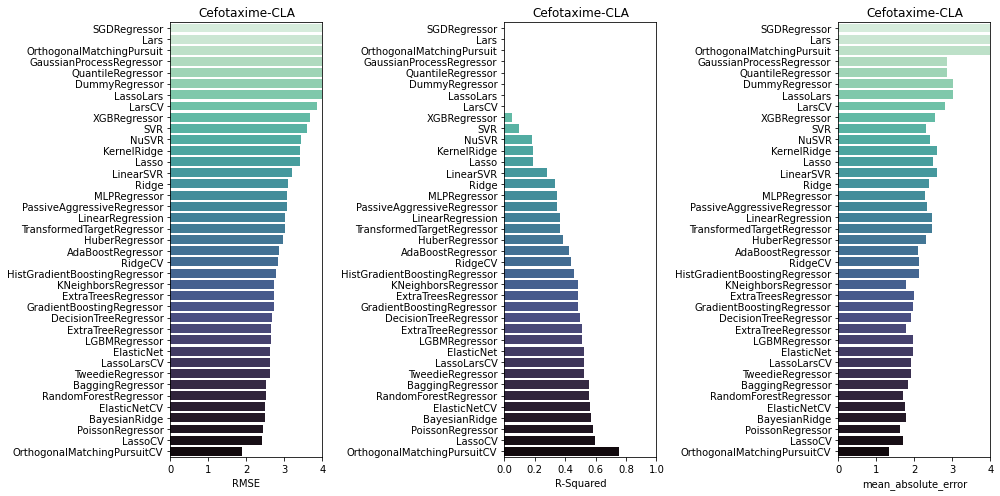

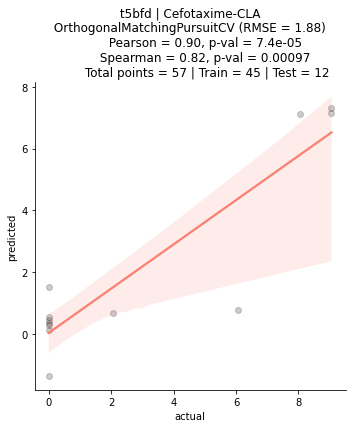

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using t5bfd
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:40<00:00,  1.03it/s]


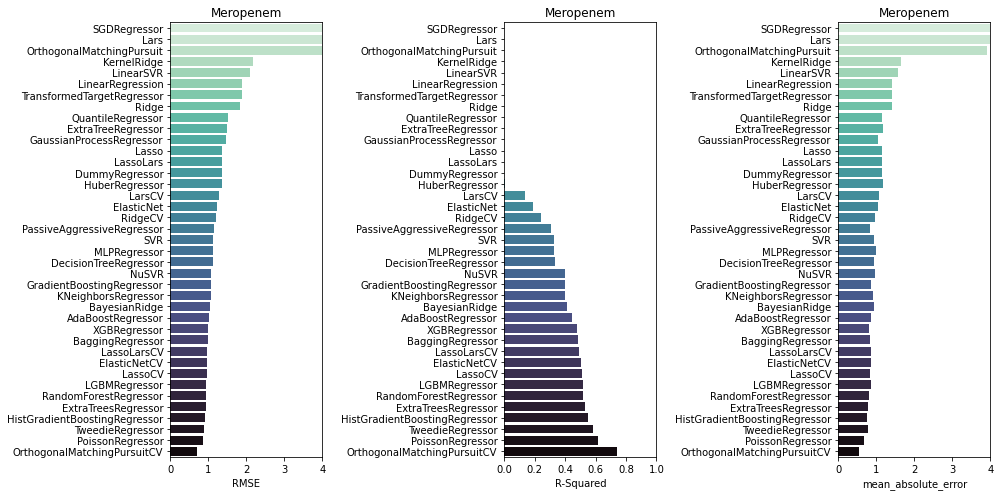

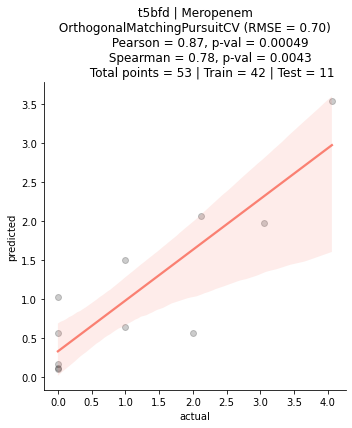

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using t5bfd
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:43<00:00,  1.03s/it]


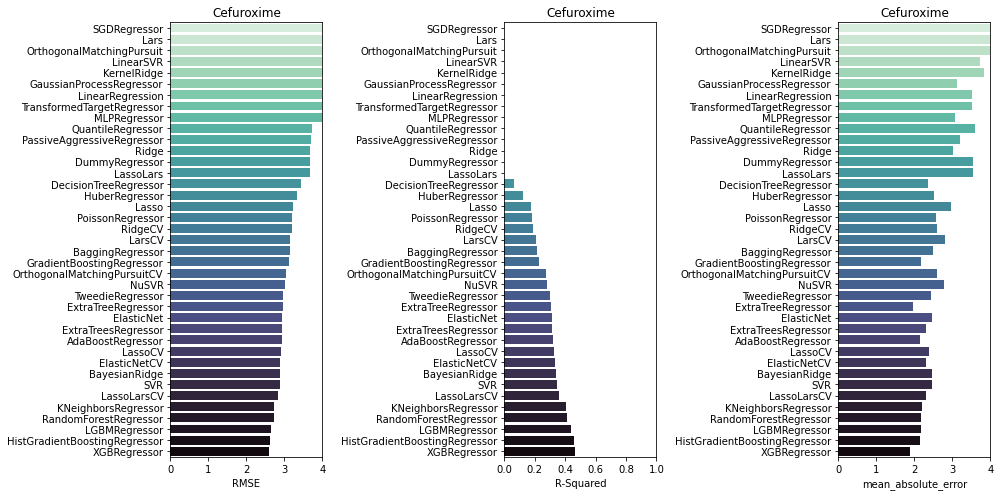

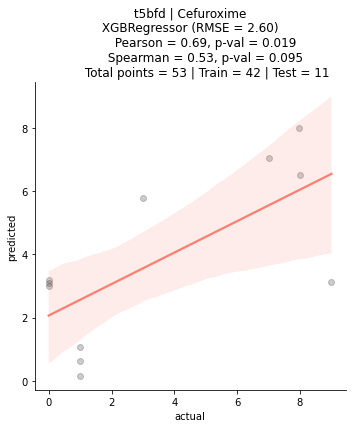

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using t5bfd
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:38<00:00,  1.10it/s]


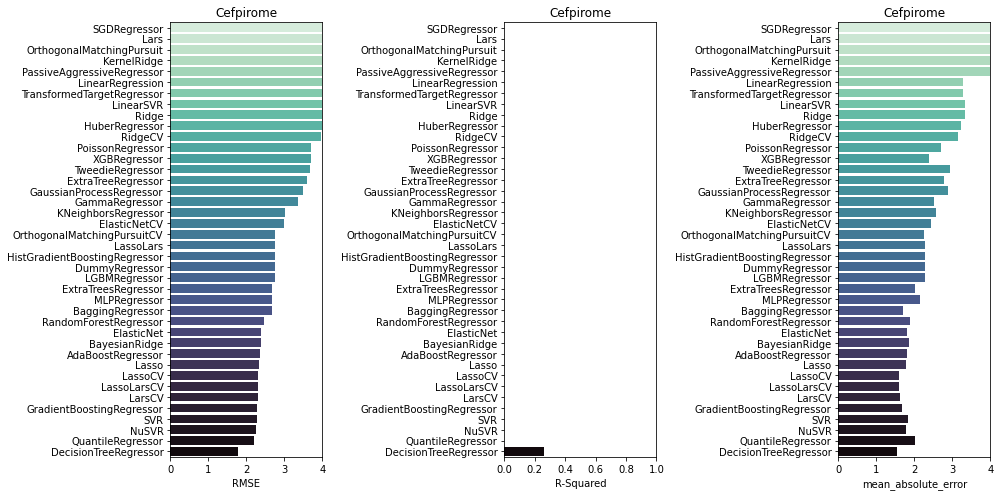

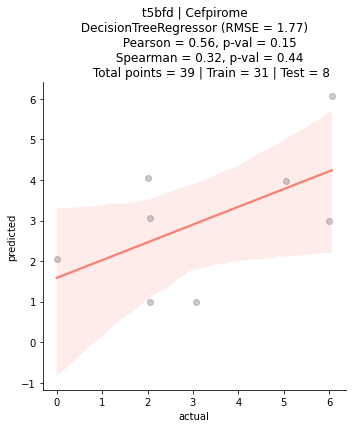

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using t5bfd
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:30<00:00,  1.39it/s]


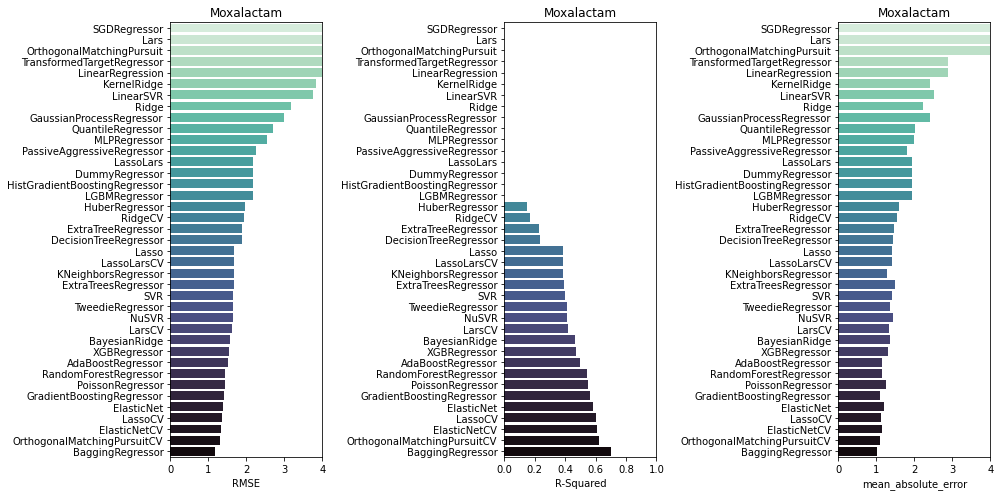

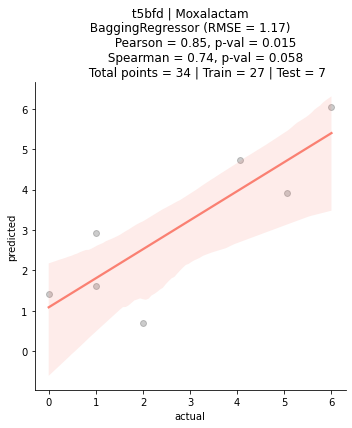

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using t5bfd
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.39s/it]


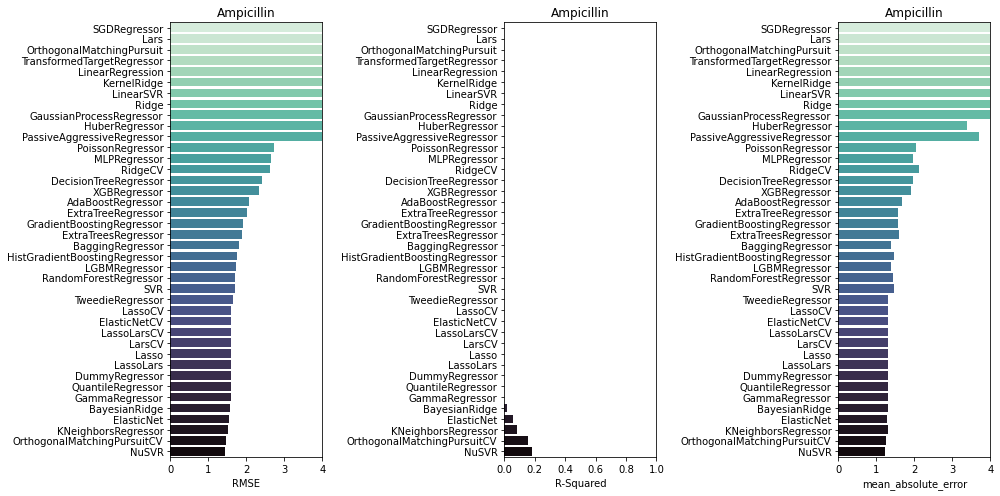

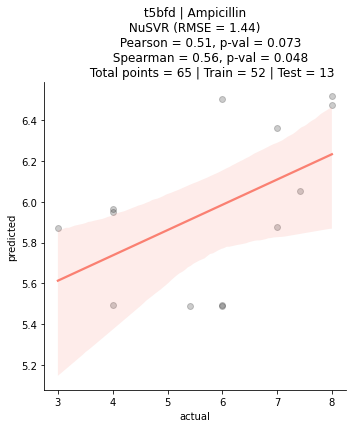

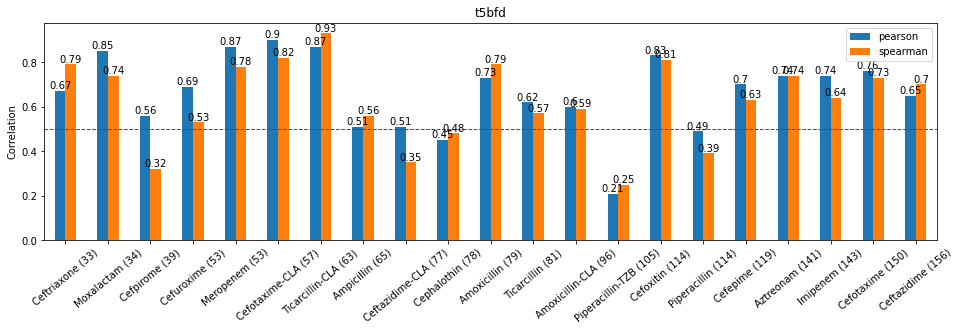

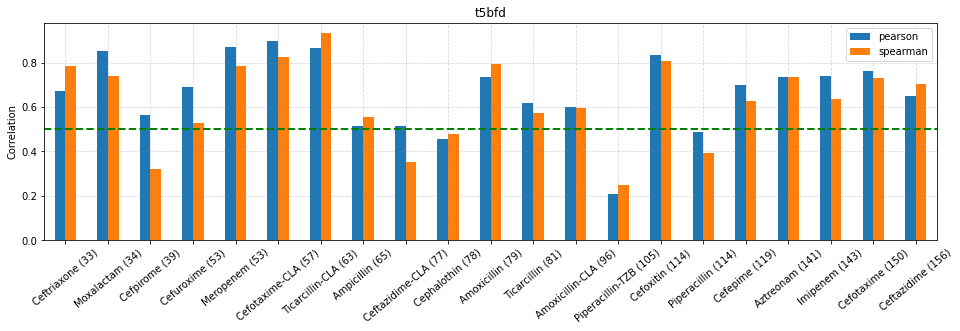

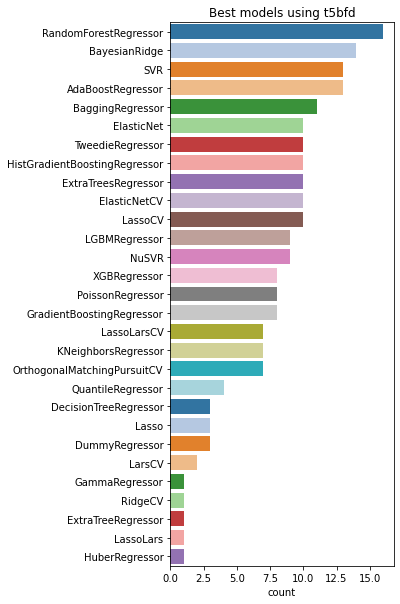

In [21]:
# set plm model
model = "t5bfd"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_t5bfd = pd.DataFrame()
df_metrics_t5bfd["anti"]         = anti_lst  
df_metrics_t5bfd["best_model"]   = model_lst  
df_metrics_t5bfd["rmse"]         = rmse_lst 
df_metrics_t5bfd["mae"]          = mae_lst
df_metrics_t5bfd["r2"]           = r_lst 
df_metrics_t5bfd["pearson"]      = pear_lst 
df_metrics_t5bfd["pearson_p"]    = pearp_lst 
df_metrics_t5bfd["spearman"]     = spear_lst 
df_metrics_t5bfd["spearman_p"]   = spearp_lst 
df_metrics_t5bfd["data_size"]    = data_size_lst 
df_metrics_t5bfd["train_size"]   = train_size_lst 
df_metrics_t5bfd["test_size"]    = test_size_lst 
df_metrics_t5bfd["top10_models"] = top10_models_lst
df_metrics_t5bfd["anti_lab"]     = df_metrics_t5bfd["anti"] + " " + "(" + df_metrics_t5bfd["data_size"].astype(str) + ")"
df_metrics_t5bfd = df_metrics_t5bfd.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_t5bfd.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_t5bfd.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_t5bfd.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_t5bfd.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## xlnet

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using xlnet
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:51<00:00,  1.22s/it]


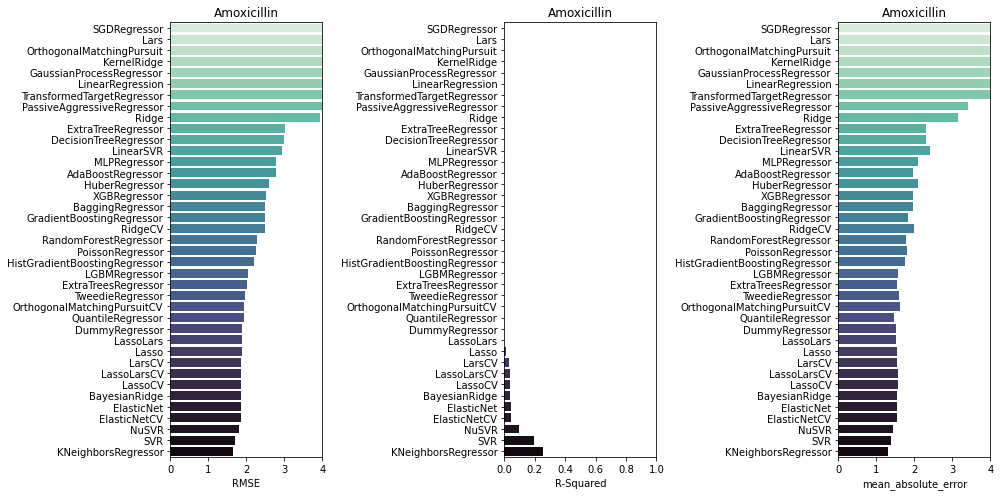

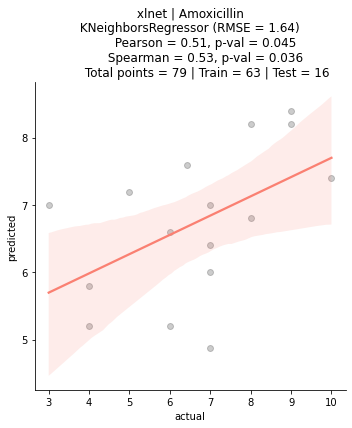

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using xlnet
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:01<00:00,  1.46s/it]


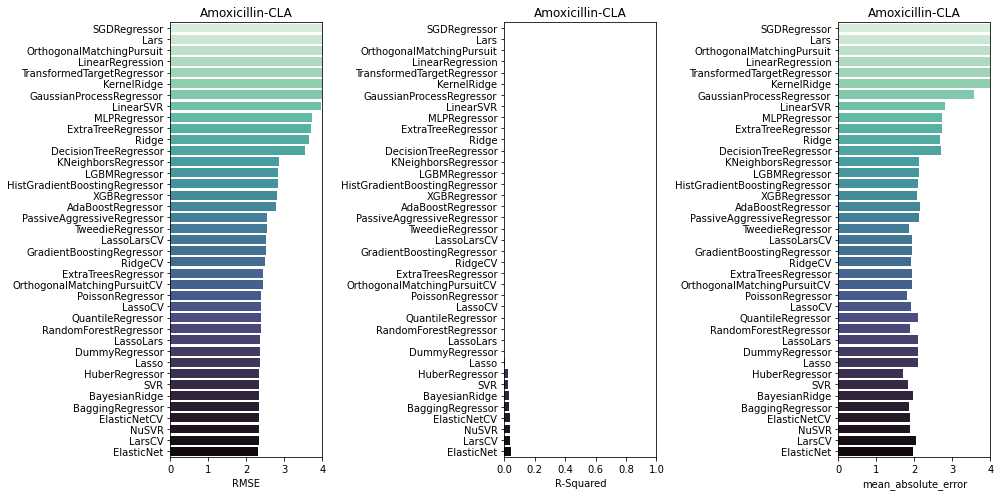

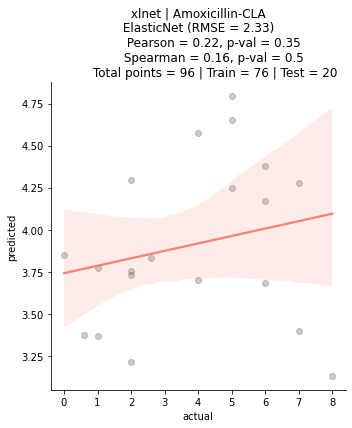

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using xlnet
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:07<00:00,  1.60s/it]


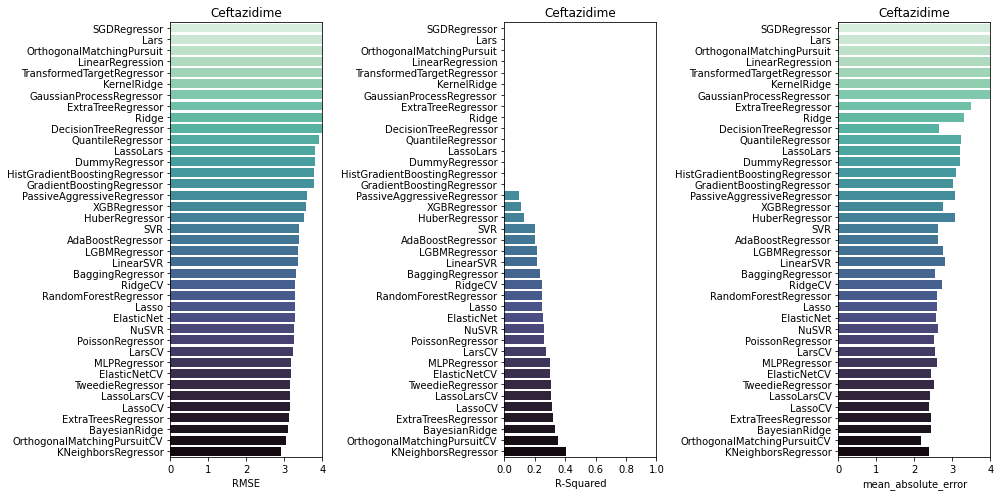

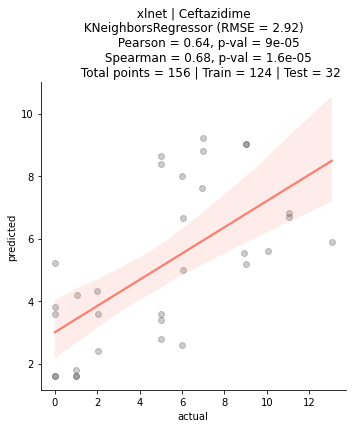

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using xlnet
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:01<00:00,  1.46s/it]


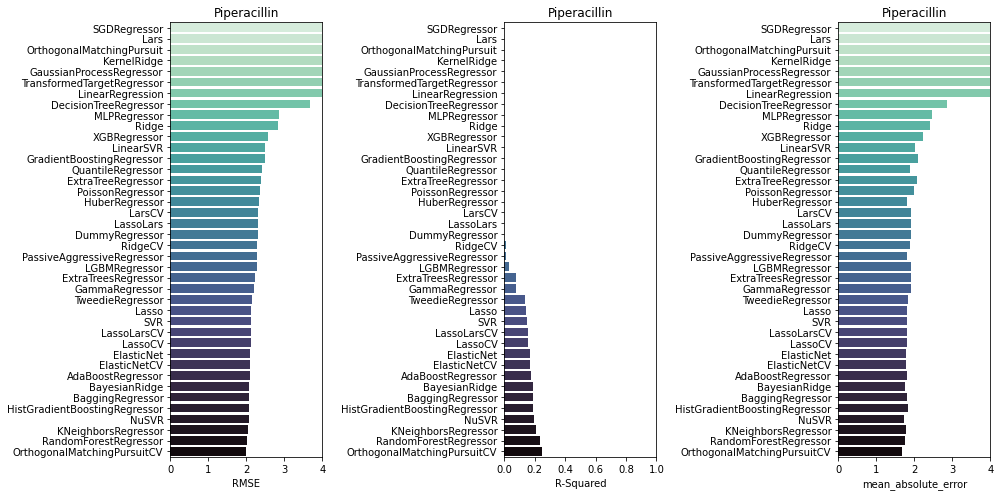

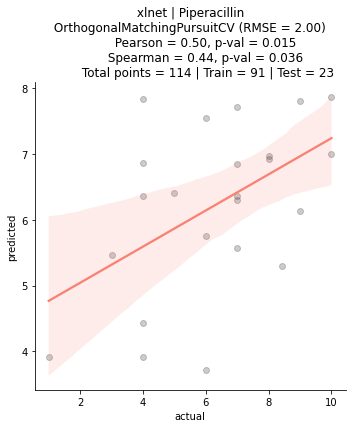

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using xlnet
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:08<00:00,  1.62s/it]


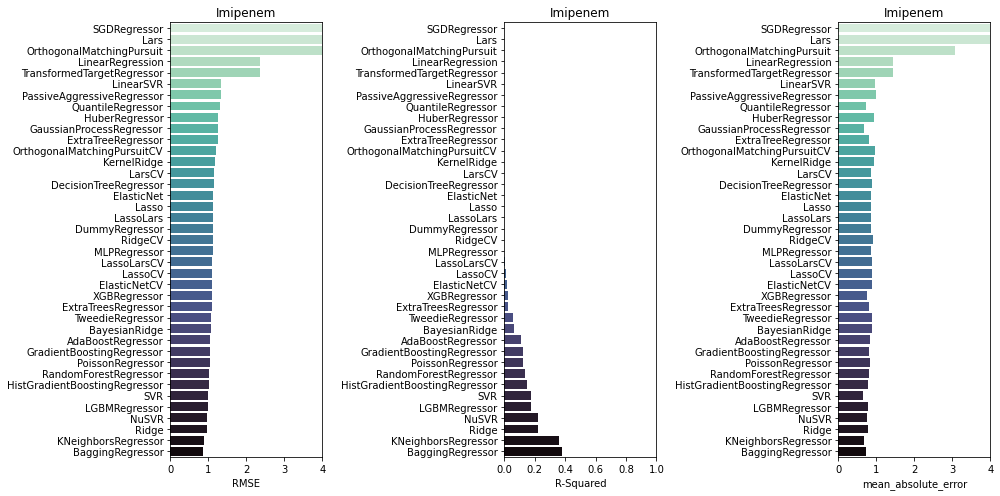

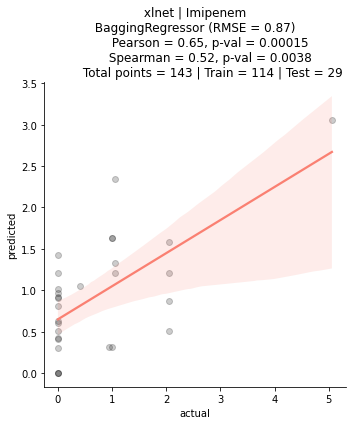

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using xlnet
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:45<00:00,  1.08s/it]


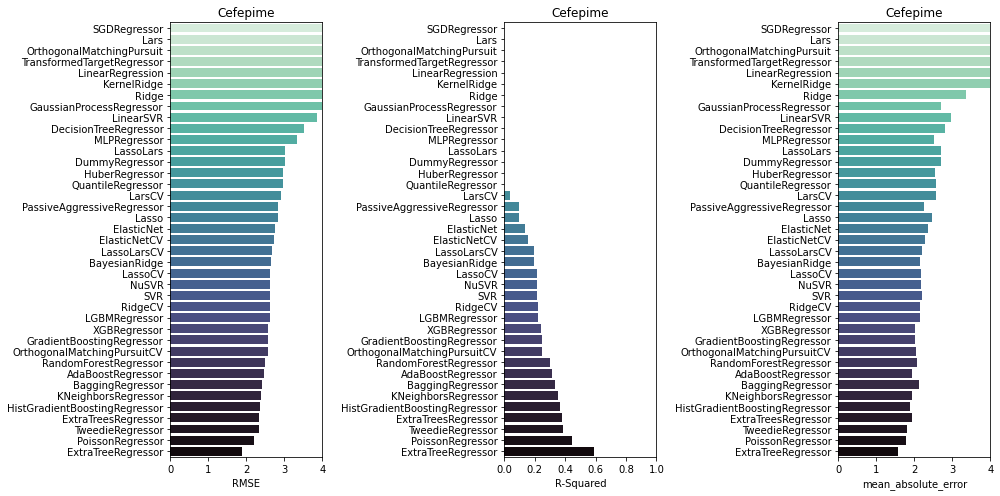

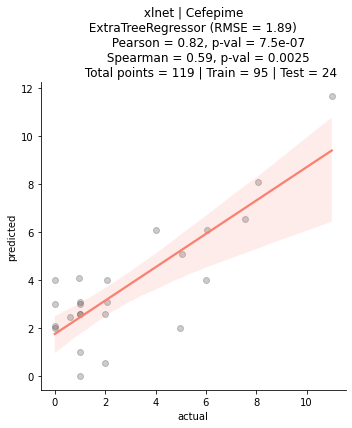

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using xlnet
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.52s/it]


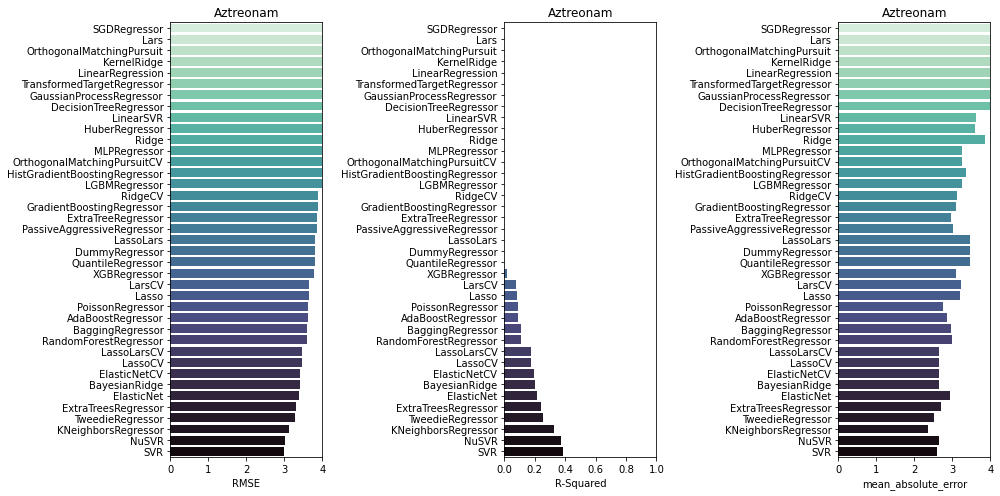

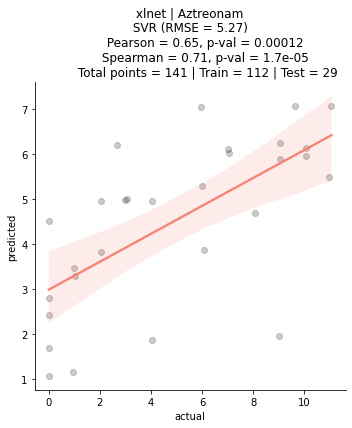

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using xlnet
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:48<00:00,  1.16s/it]


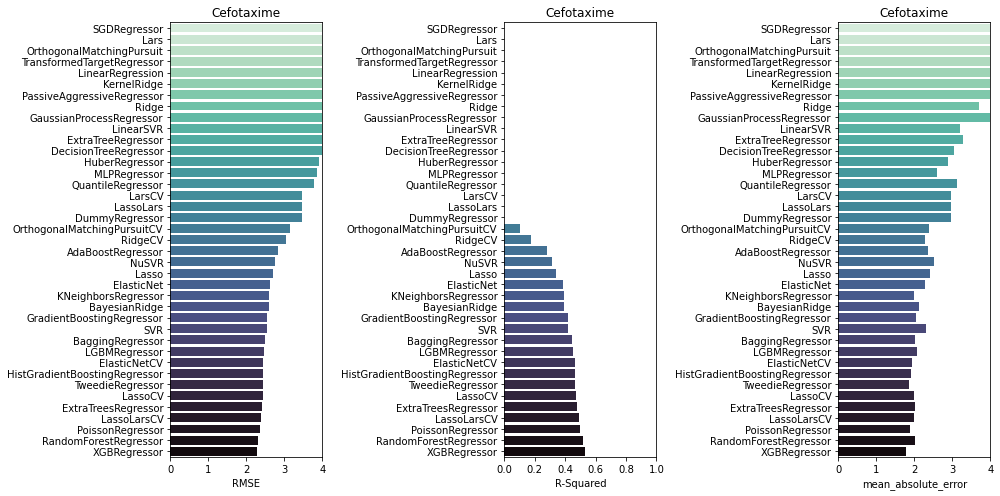

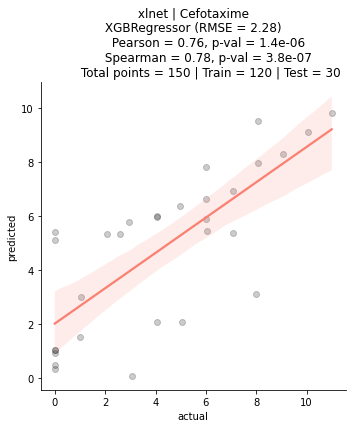

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using xlnet
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:48<00:00,  1.16s/it]


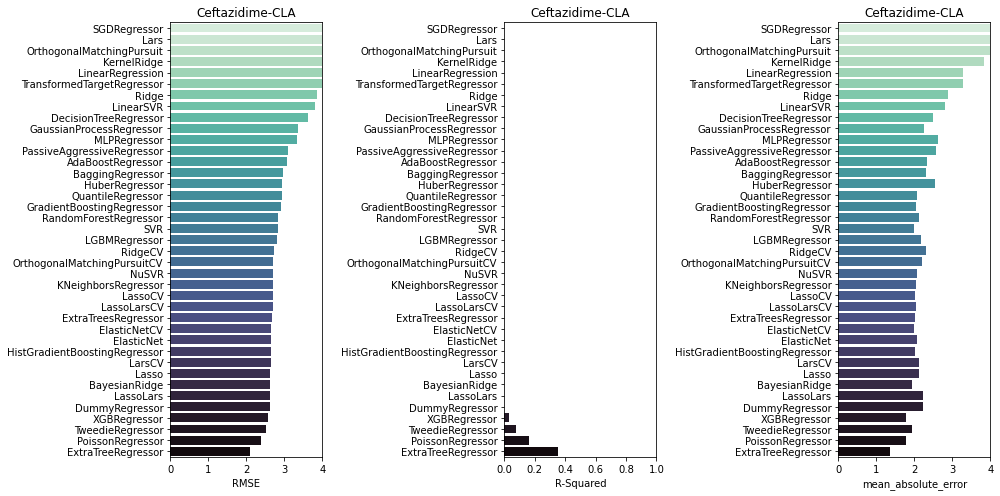

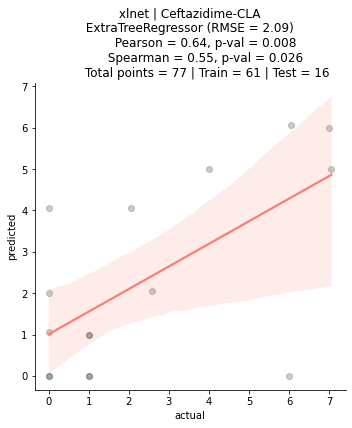

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using xlnet
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.20s/it]


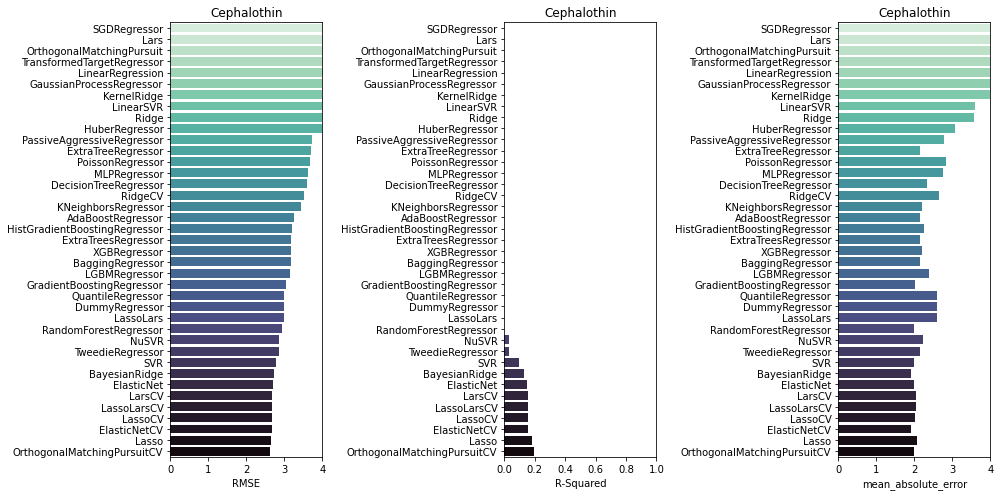

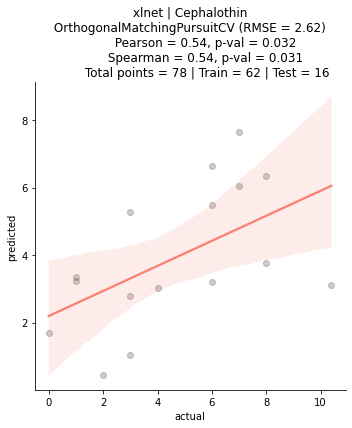

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using xlnet
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:01<00:00,  1.45s/it]


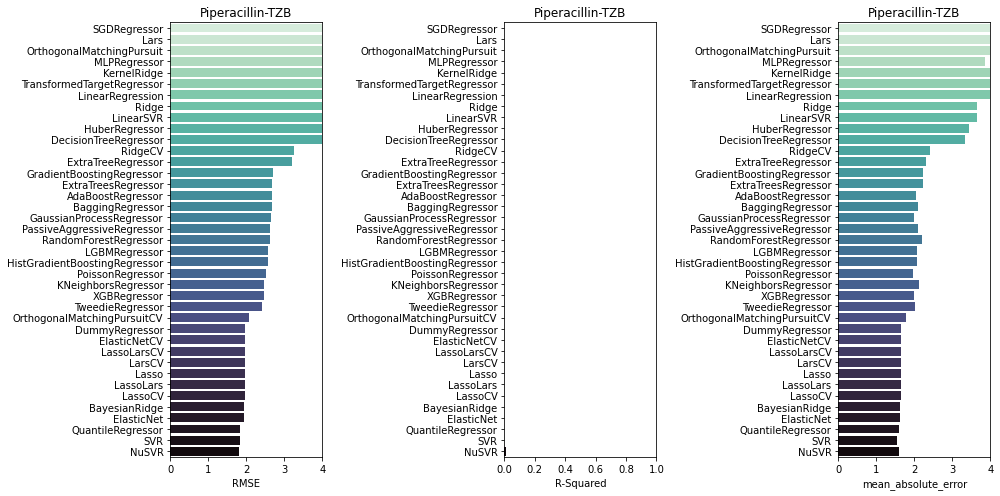

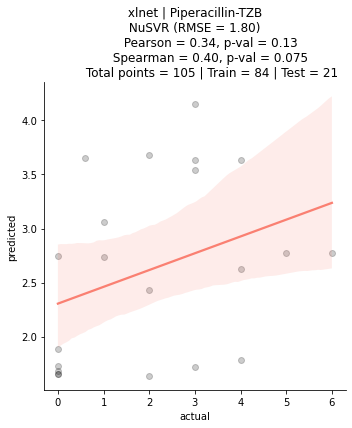

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using xlnet
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:36<00:00,  1.14it/s]


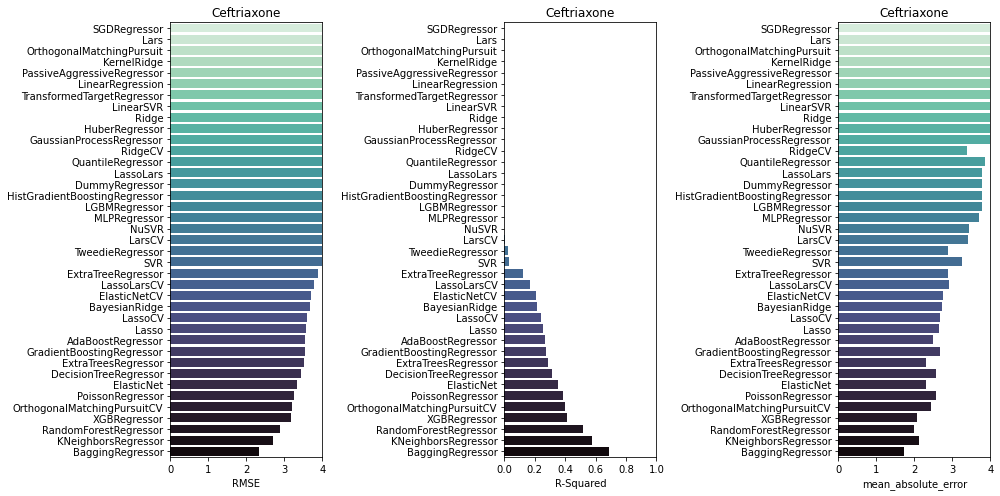

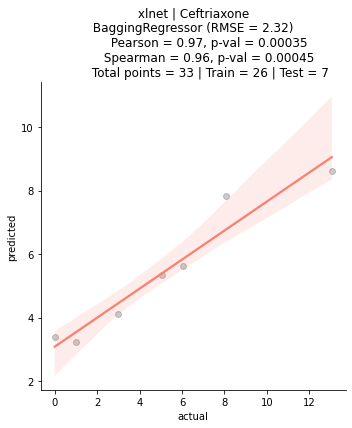

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using xlnet
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.31s/it]


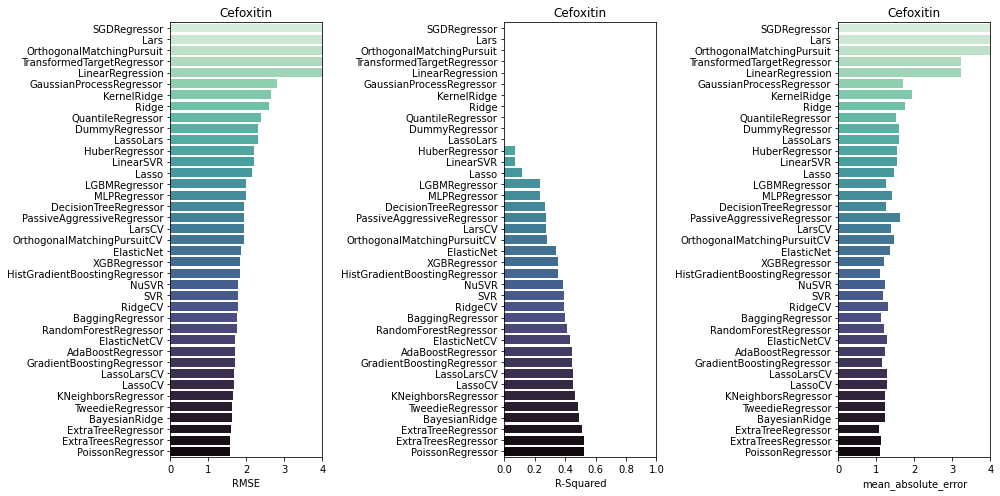

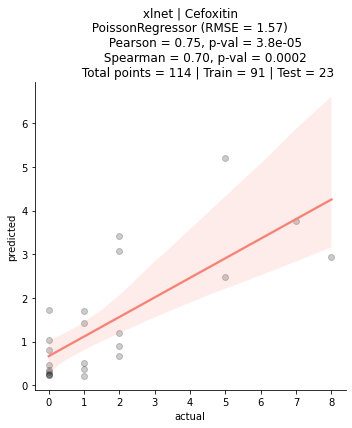

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using xlnet
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.02it/s]


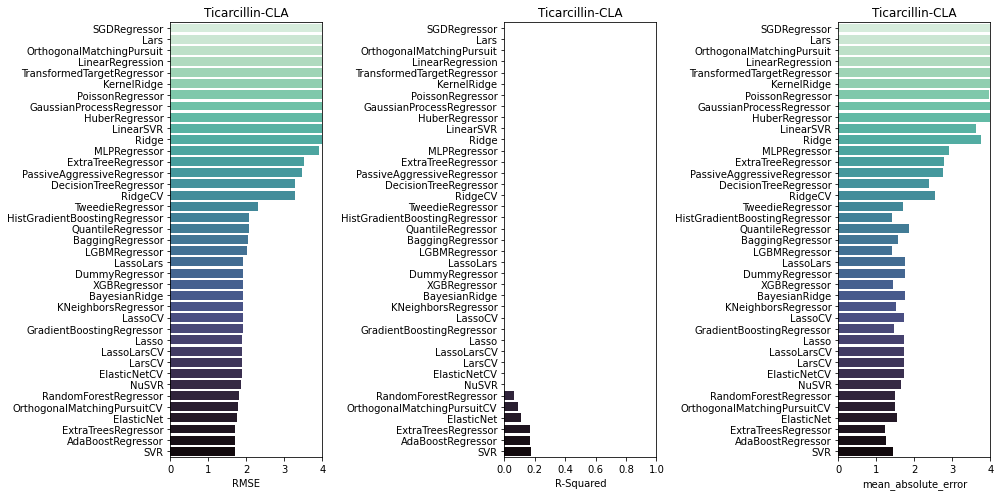

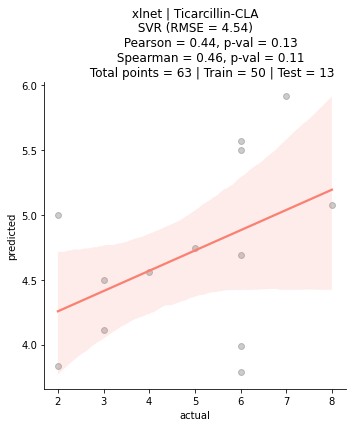

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using xlnet
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.51s/it]


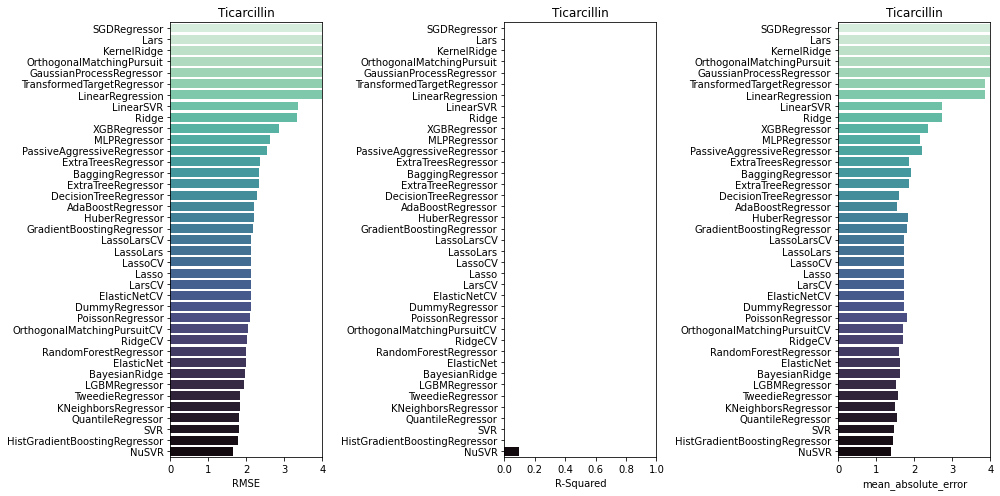

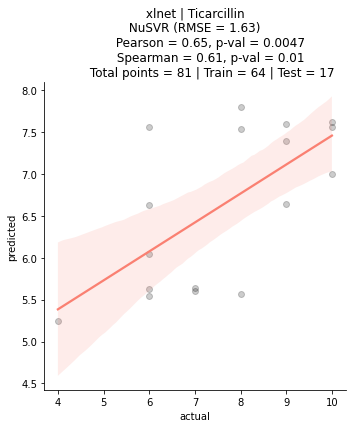

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using xlnet
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:34<00:00,  1.21it/s]


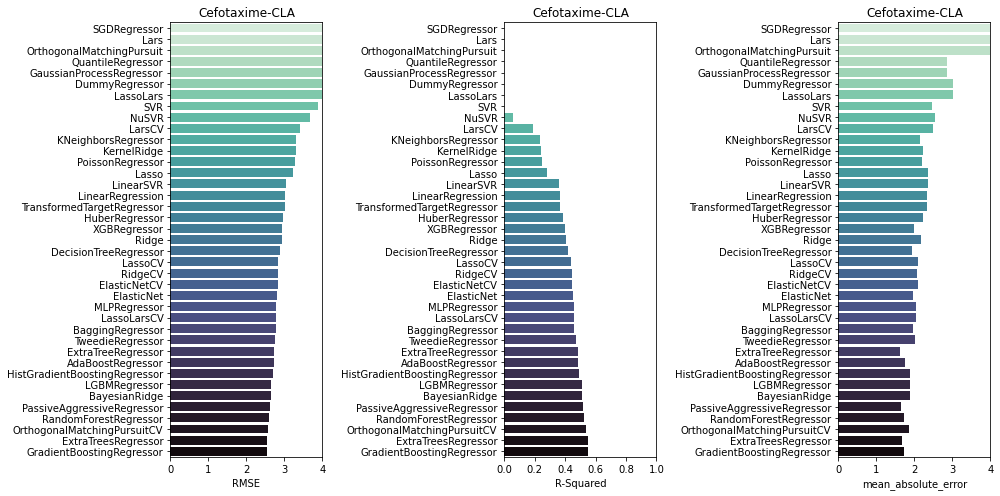

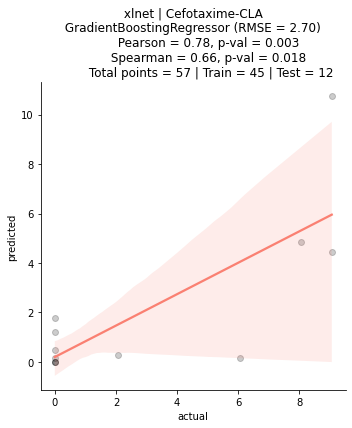

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using xlnet
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.02it/s]


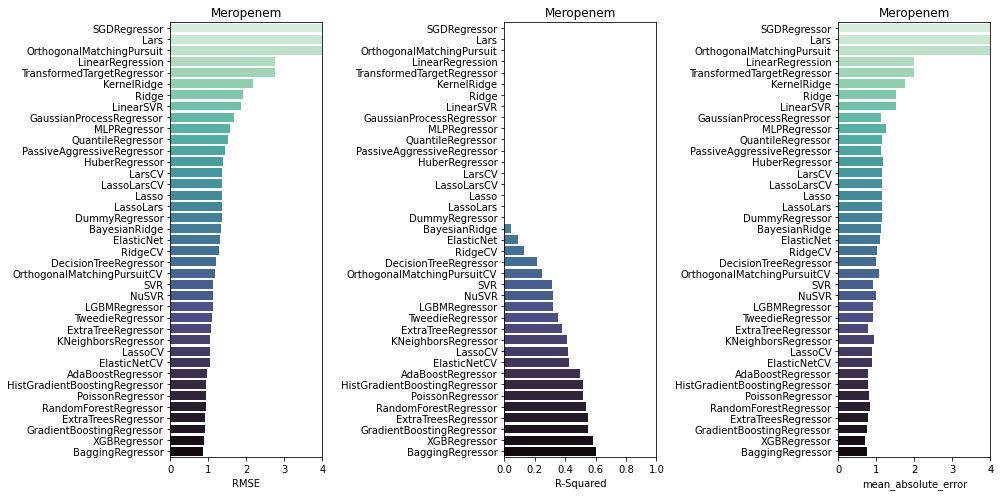

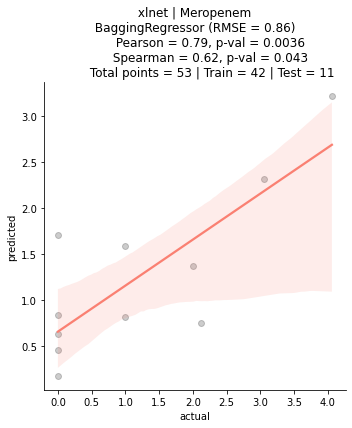

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using xlnet
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:41<00:00,  1.01it/s]


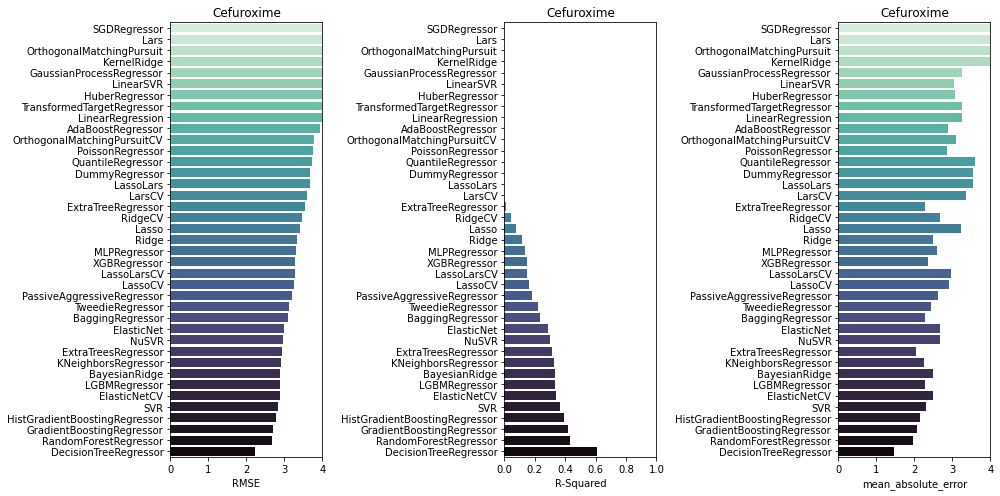

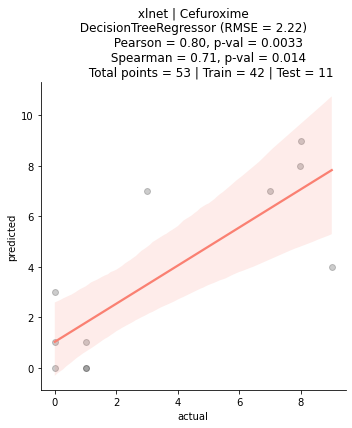

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using xlnet
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:36<00:00,  1.15it/s]


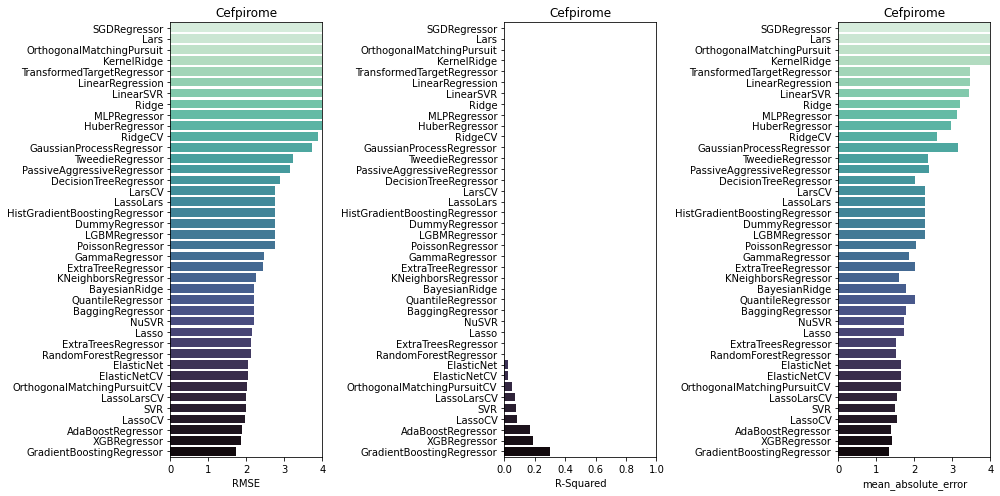

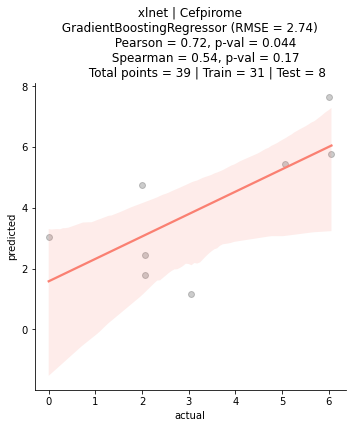

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using xlnet
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:35<00:00,  1.20it/s]


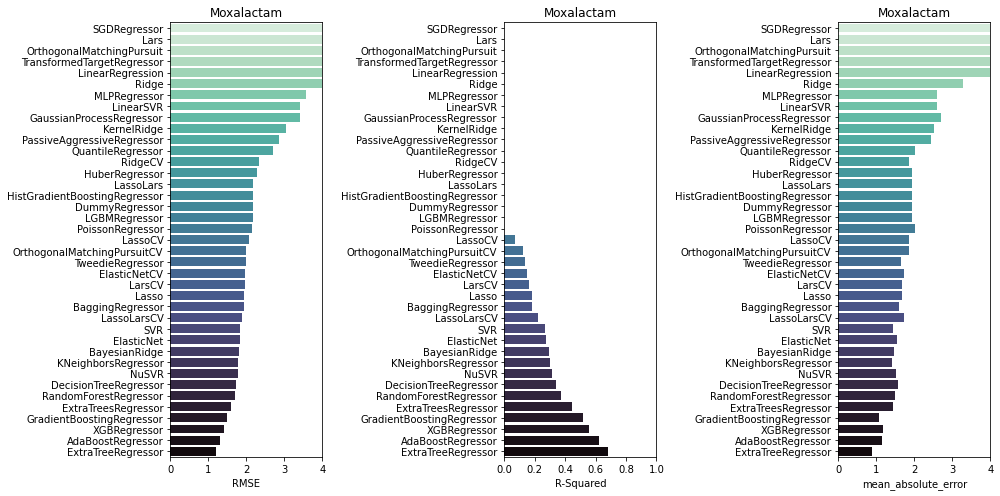

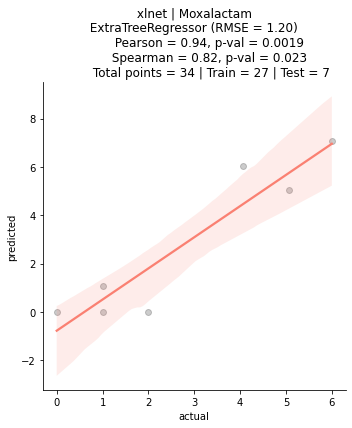

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using xlnet
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:58<00:00,  1.39s/it]


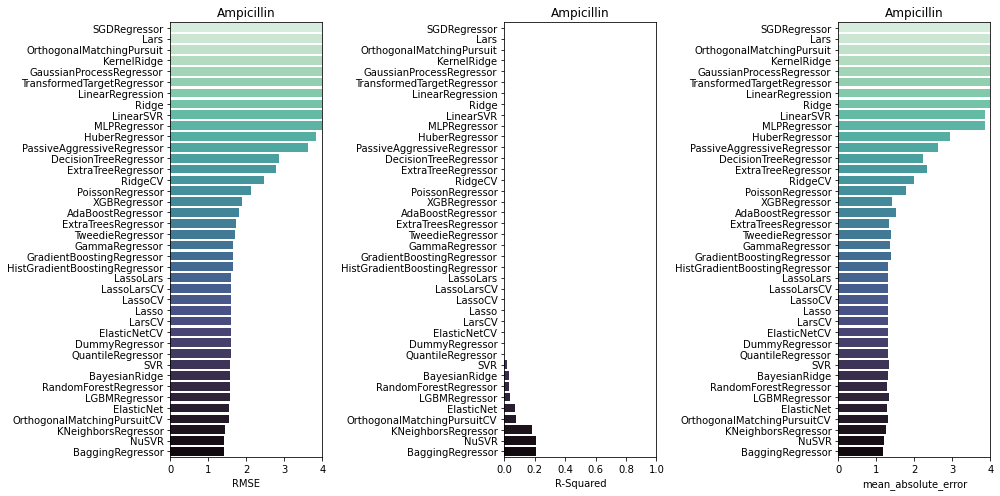

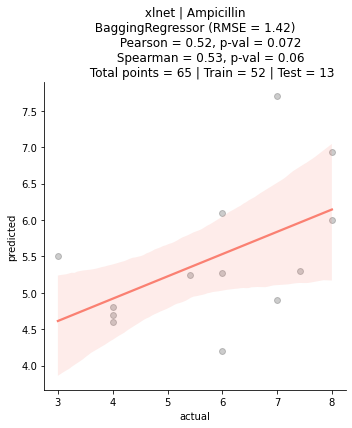

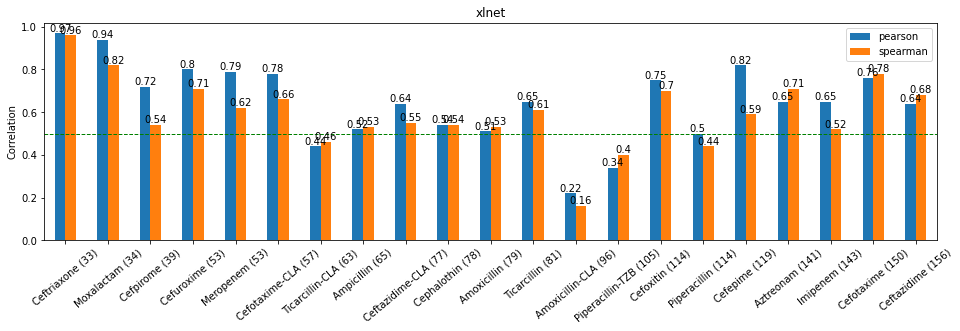

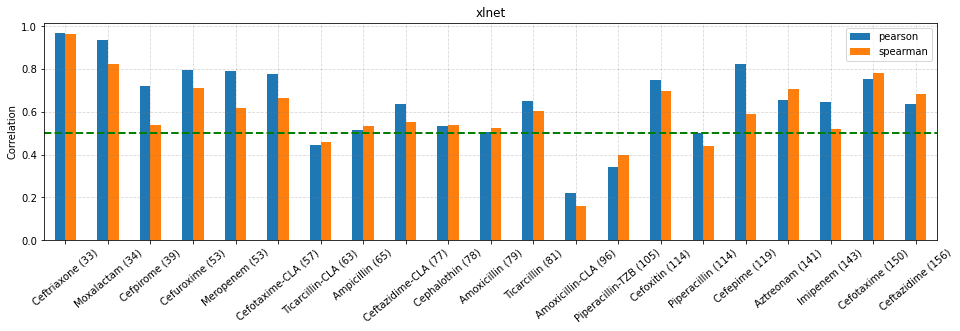

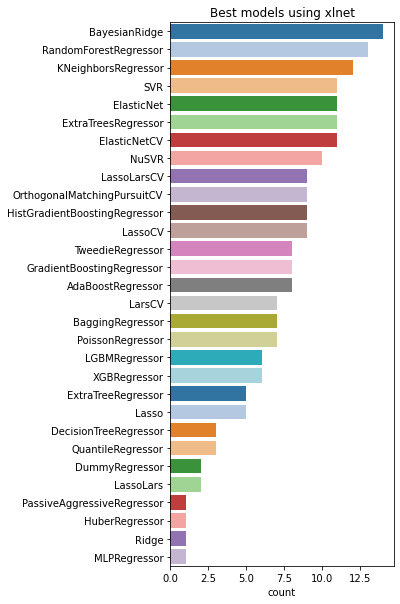

In [22]:
# set plm model
model = "xlnet"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_xlnet = pd.DataFrame()
df_metrics_xlnet["anti"]         = anti_lst  
df_metrics_xlnet["best_model"]   = model_lst  
df_metrics_xlnet["rmse"]         = rmse_lst 
df_metrics_xlnet["mae"]          = mae_lst
df_metrics_xlnet["r2"]           = r_lst 
df_metrics_xlnet["pearson"]      = pear_lst 
df_metrics_xlnet["pearson_p"]    = pearp_lst 
df_metrics_xlnet["spearman"]     = spear_lst 
df_metrics_xlnet["spearman_p"]   = spearp_lst 
df_metrics_xlnet["data_size"]    = data_size_lst 
df_metrics_xlnet["train_size"]   = train_size_lst 
df_metrics_xlnet["test_size"]    = test_size_lst 
df_metrics_xlnet["top10_models"] = top10_models_lst
df_metrics_xlnet["anti_lab"]     = df_metrics_xlnet["anti"] + " " + "(" + df_metrics_xlnet["data_size"].astype(str) + ")"
df_metrics_xlnet = df_metrics_xlnet.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_xlnet.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_xlnet.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_xlnet.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_xlnet.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## bepler

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using bepler
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.62it/s]


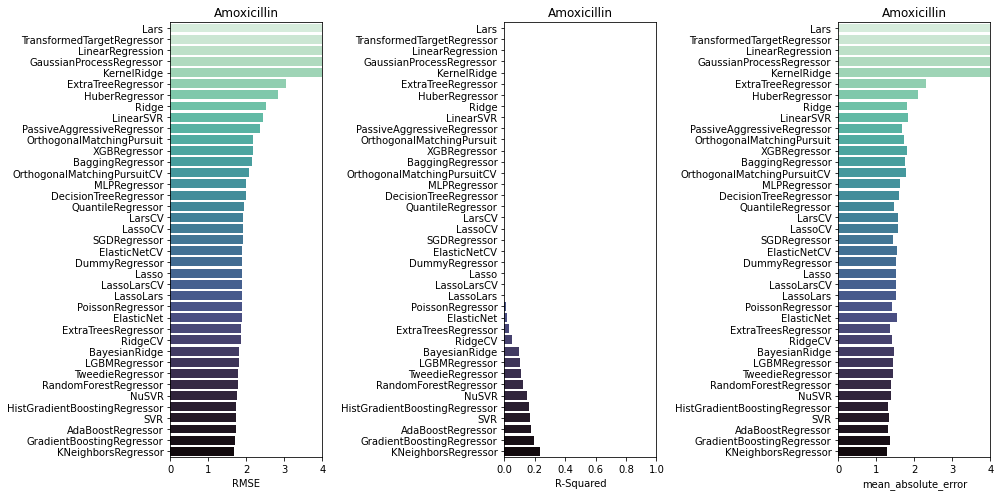

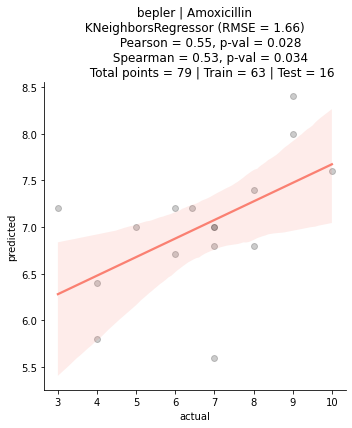

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using bepler
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:13<00:00,  3.07it/s]


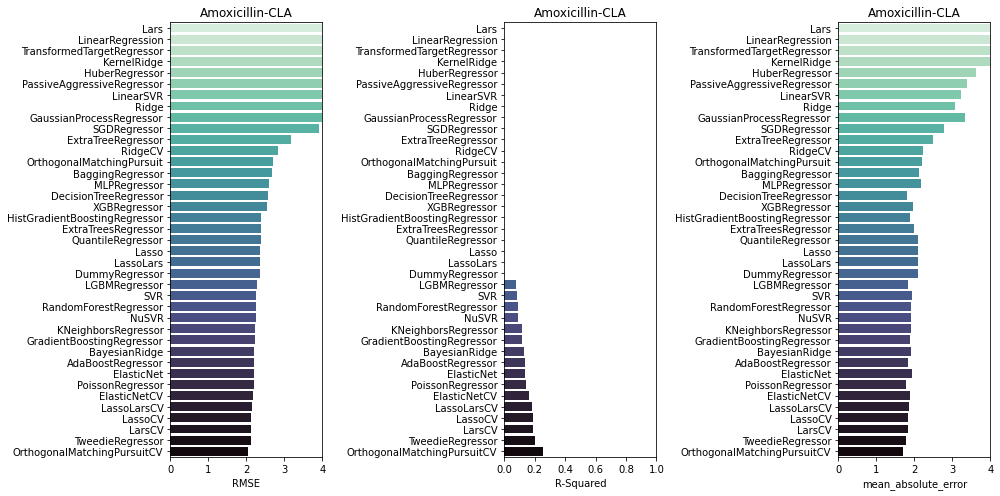

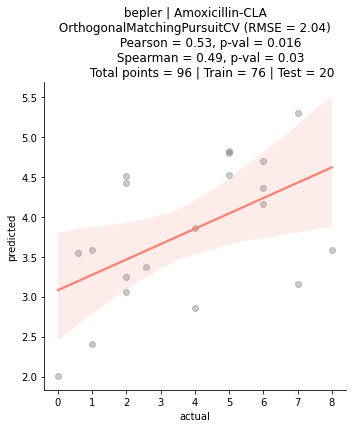

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using bepler
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:20<00:00,  2.04it/s]


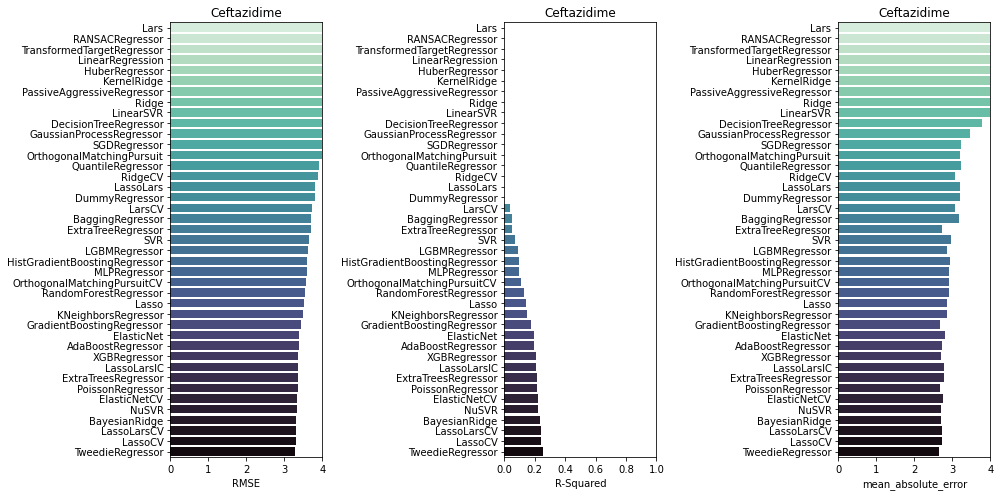

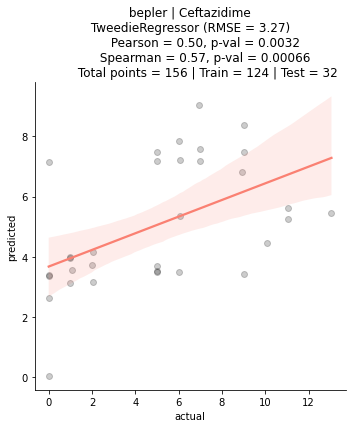

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using bepler
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:17<00:00,  2.46it/s]


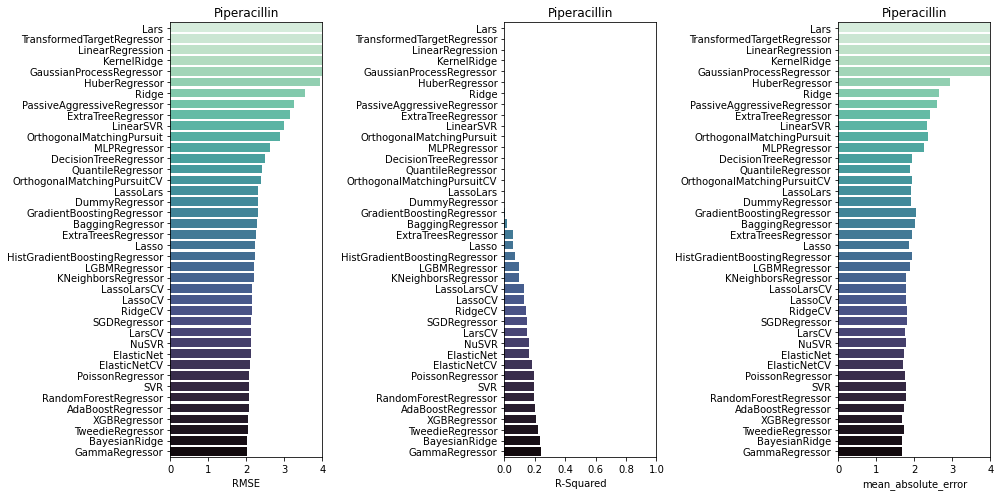

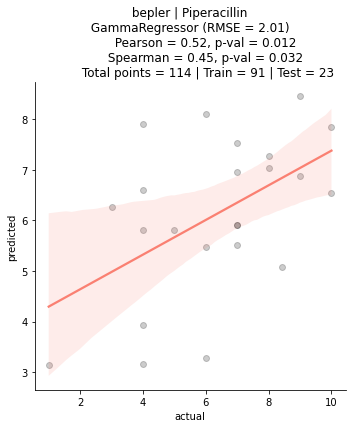

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using bepler
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:16<00:00,  2.58it/s]


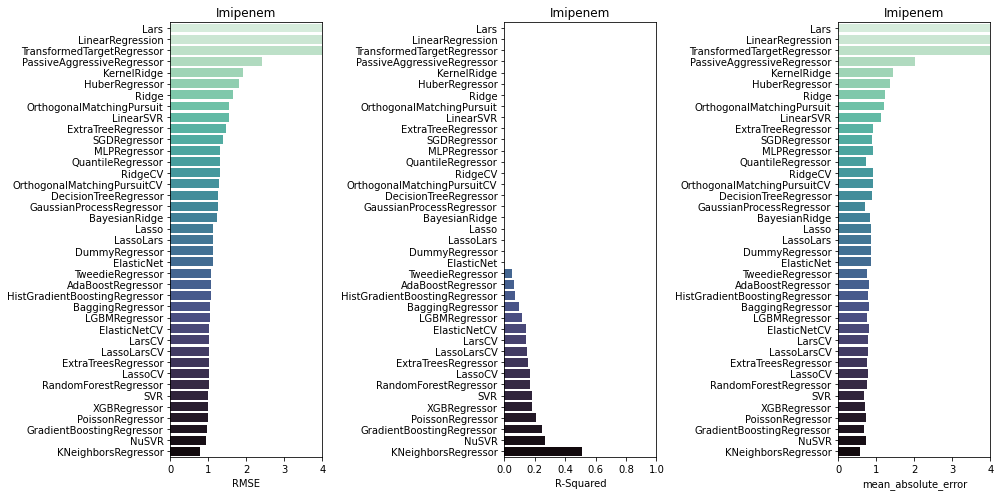

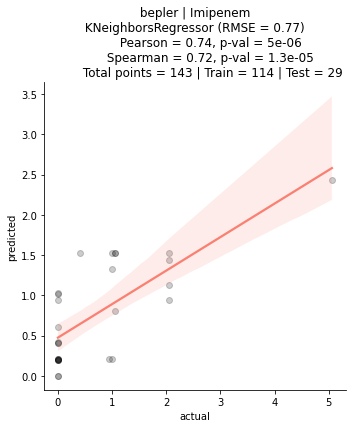

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using bepler
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:13<00:00,  3.05it/s]


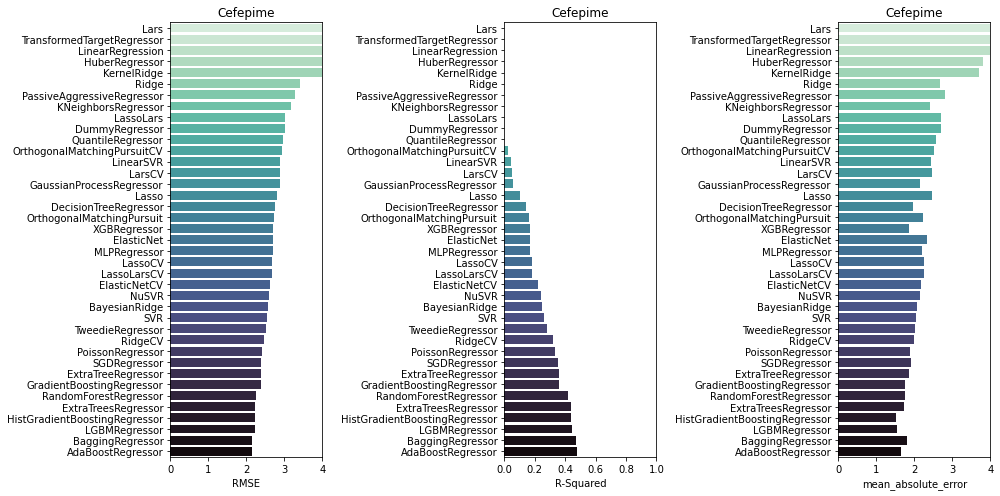

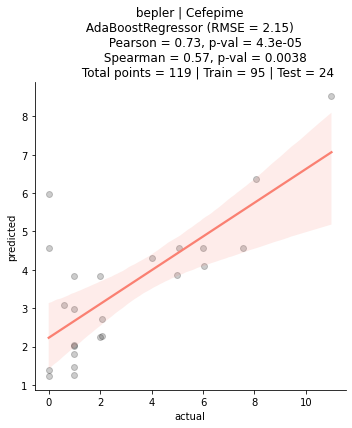

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using bepler
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:16<00:00,  2.59it/s]


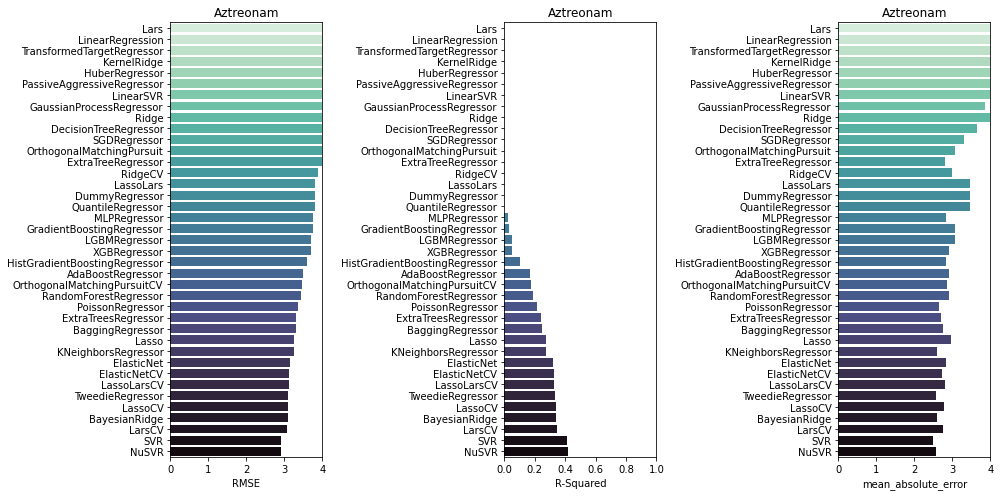

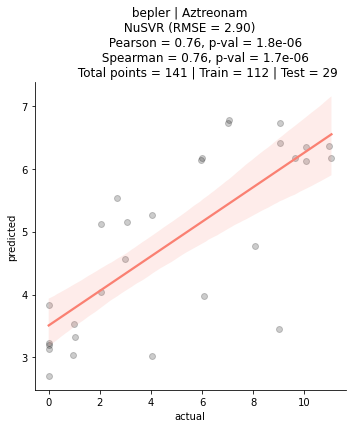

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using bepler
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:15<00:00,  2.67it/s]


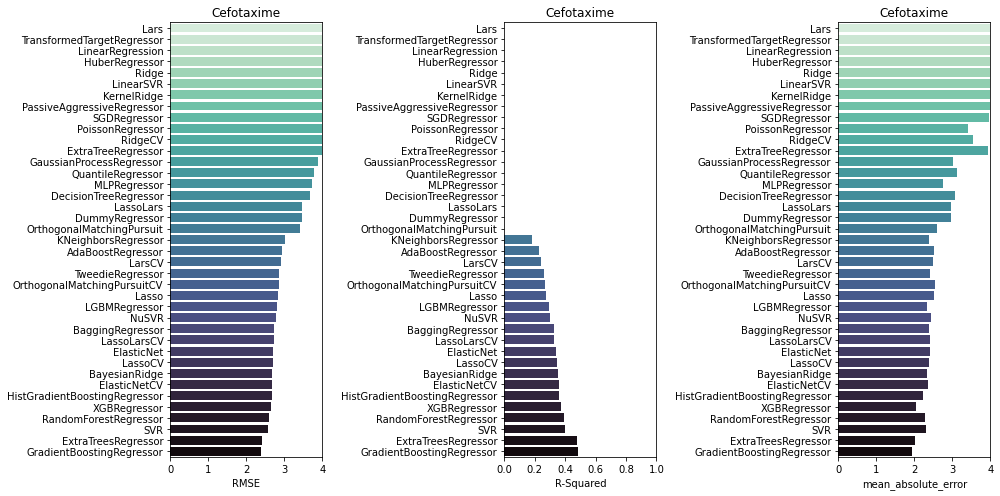

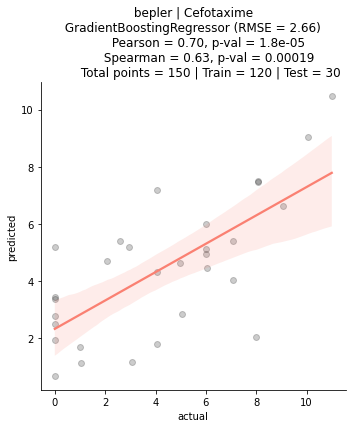

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using bepler
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.71it/s]


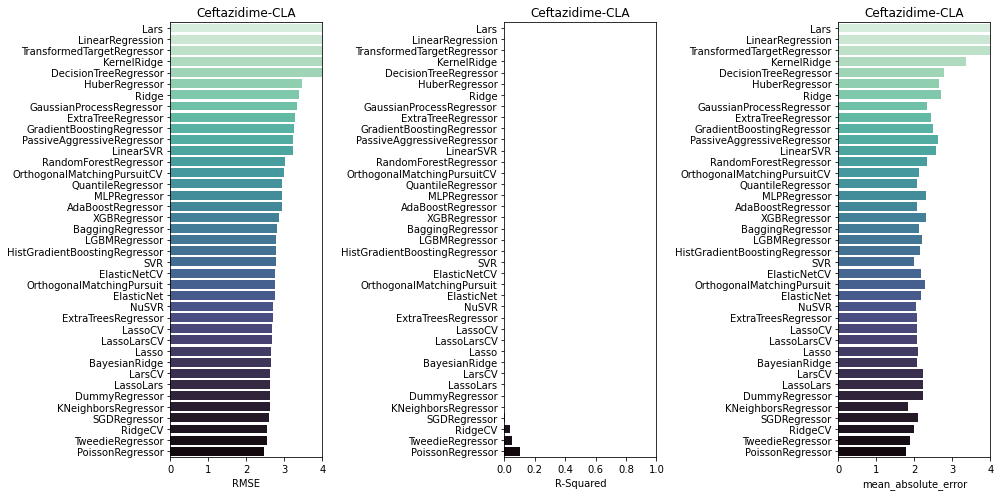

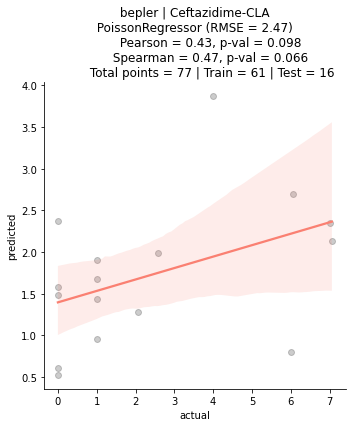

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using bepler
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:12<00:00,  3.47it/s]


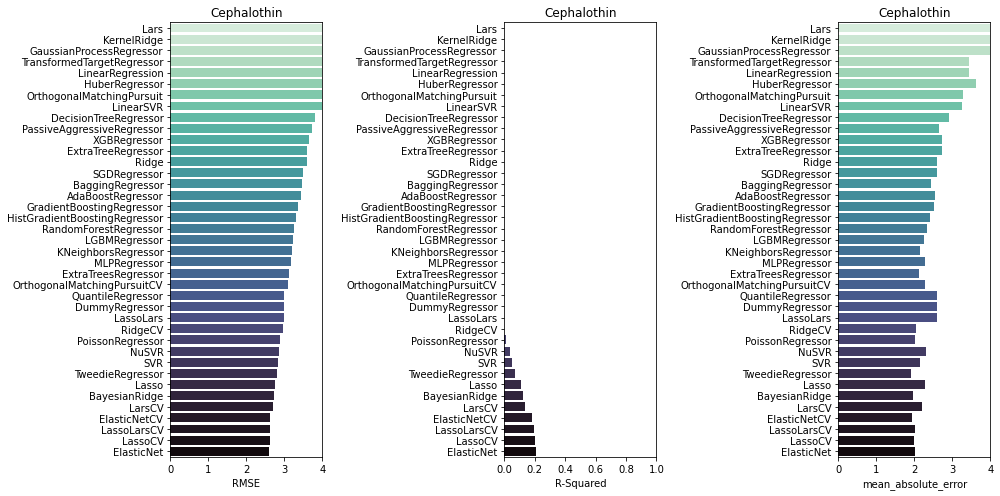

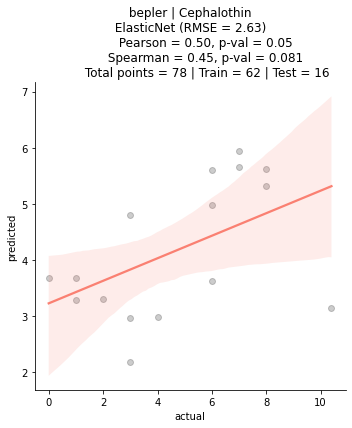

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using bepler
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:18<00:00,  2.26it/s]


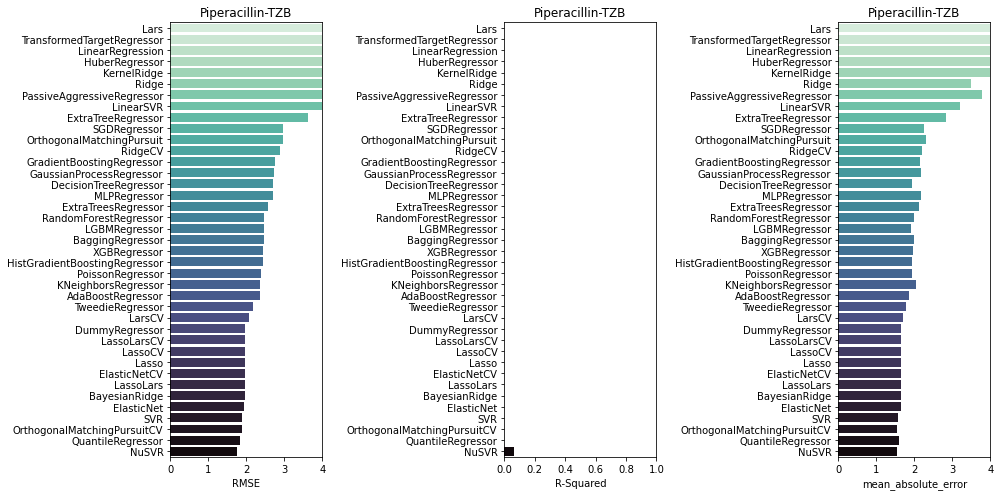

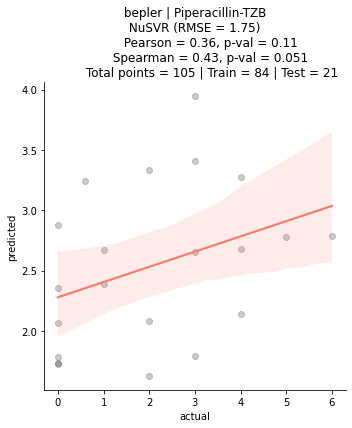

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using bepler
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  4.78it/s]


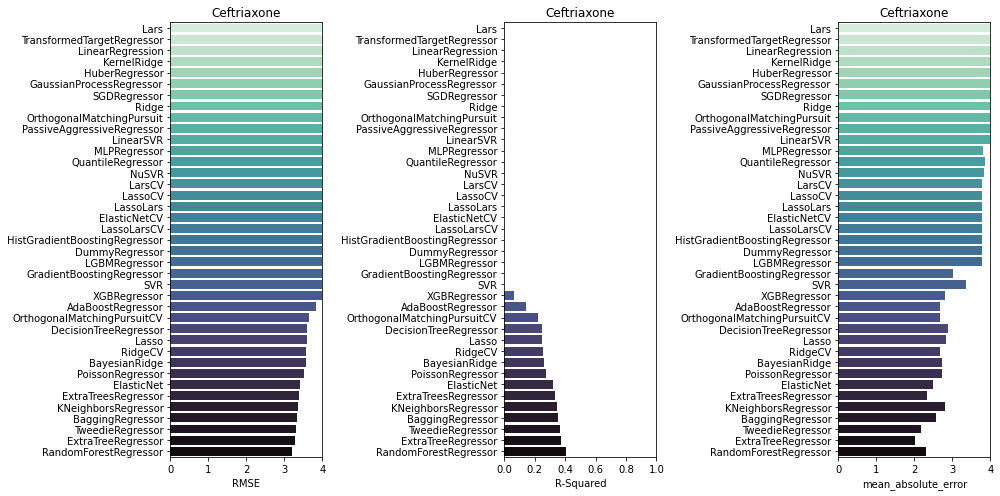

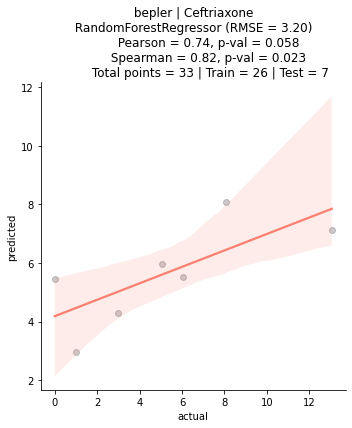

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using bepler
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:16<00:00,  2.56it/s]


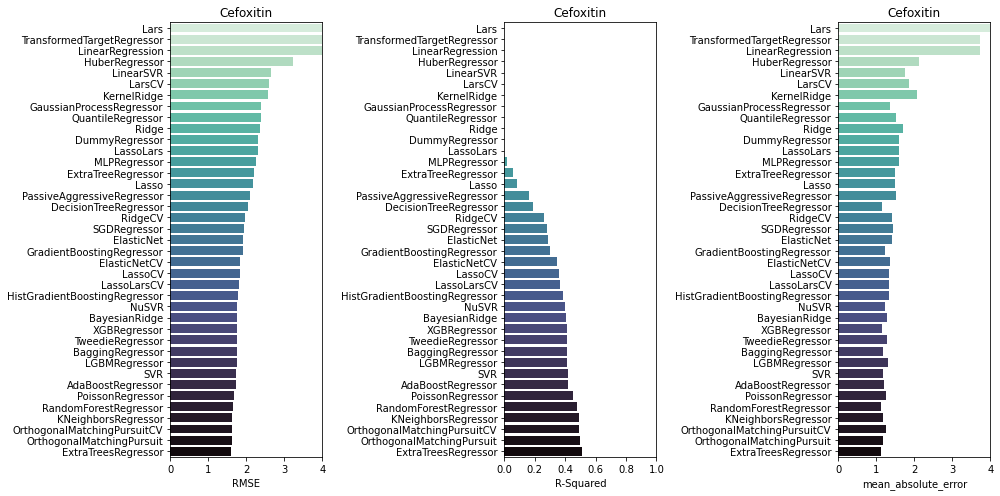

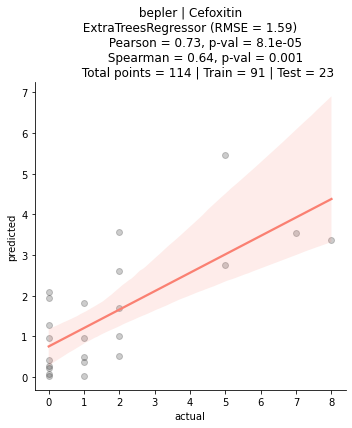

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using bepler
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  3.99it/s]


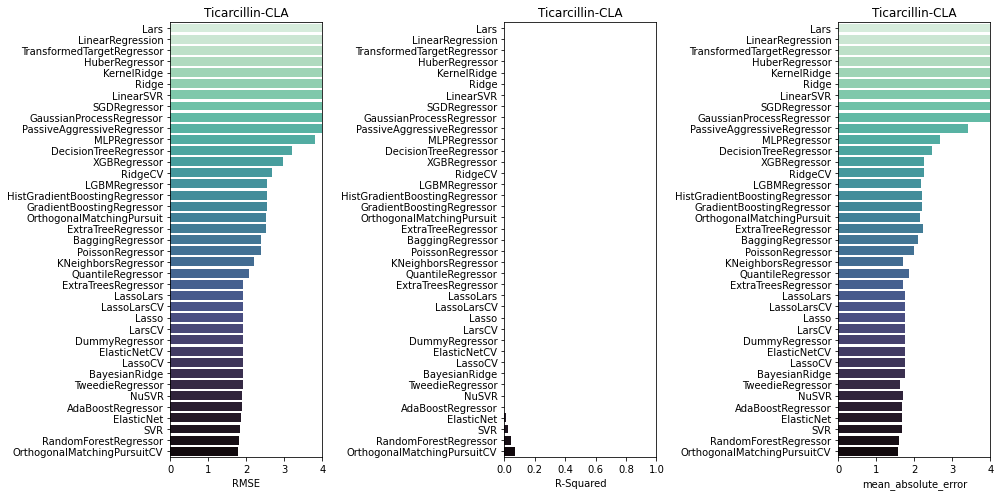

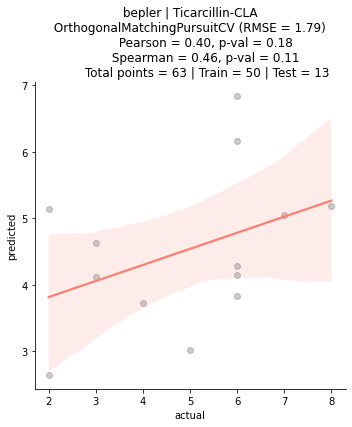

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using bepler
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:12<00:00,  3.45it/s]


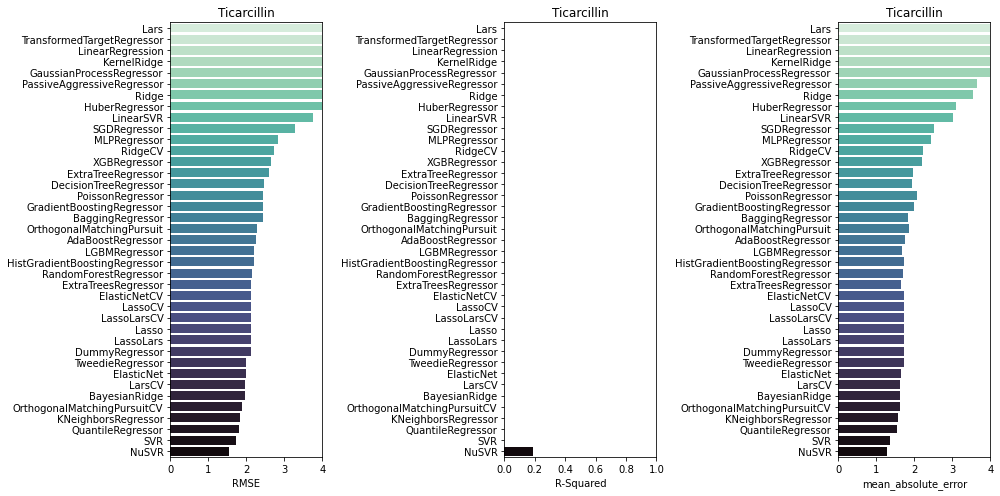

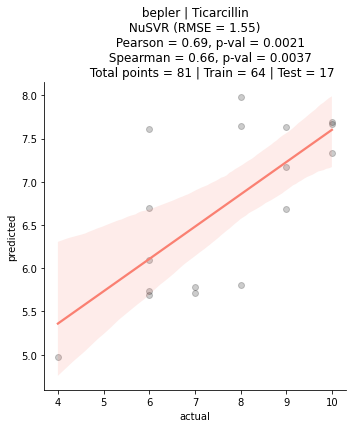

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using bepler
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.64it/s]


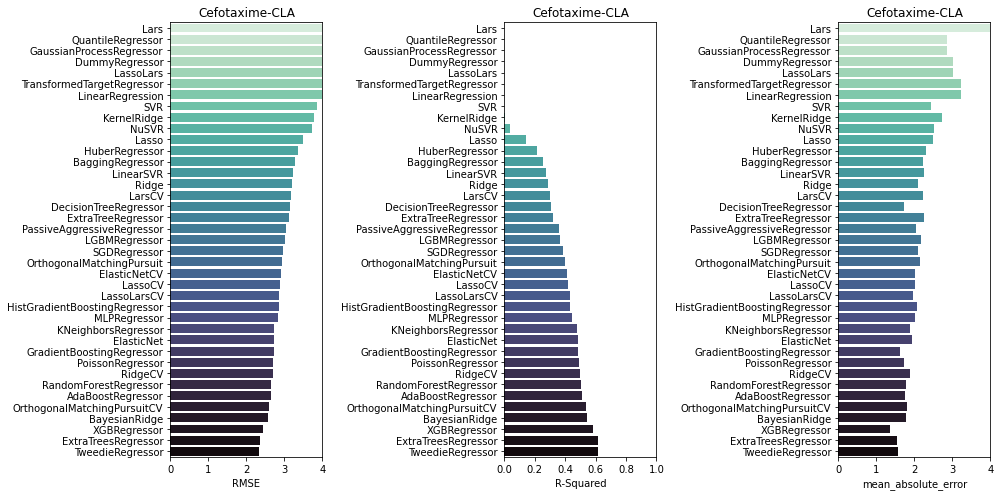

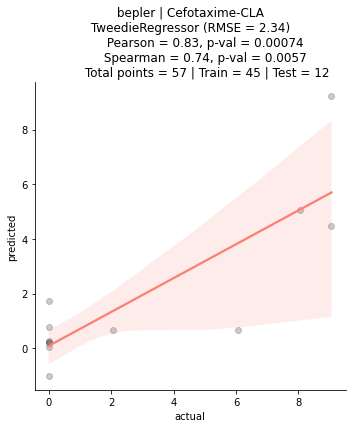

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using bepler
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.72it/s]


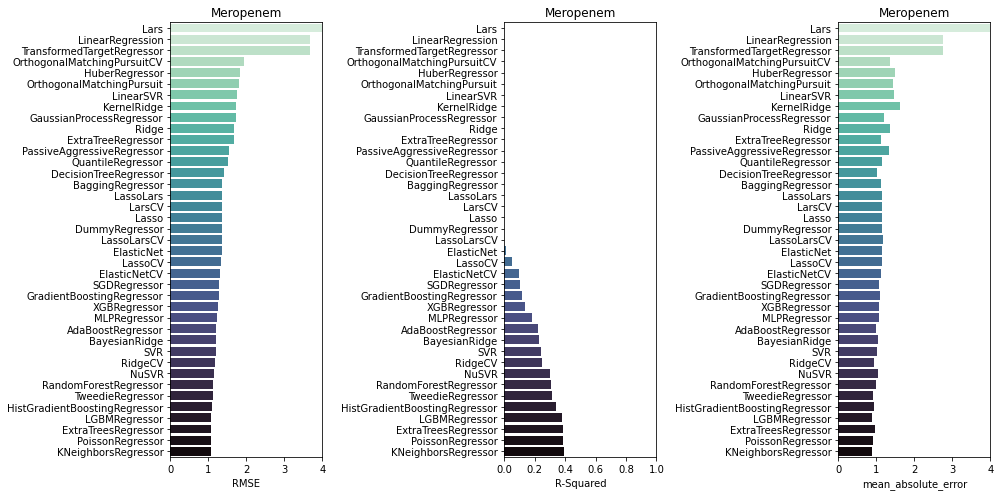

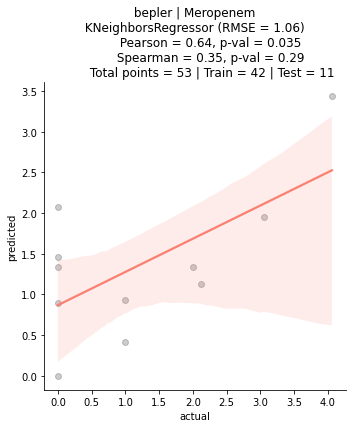

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using bepler
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:10<00:00,  4.16it/s]


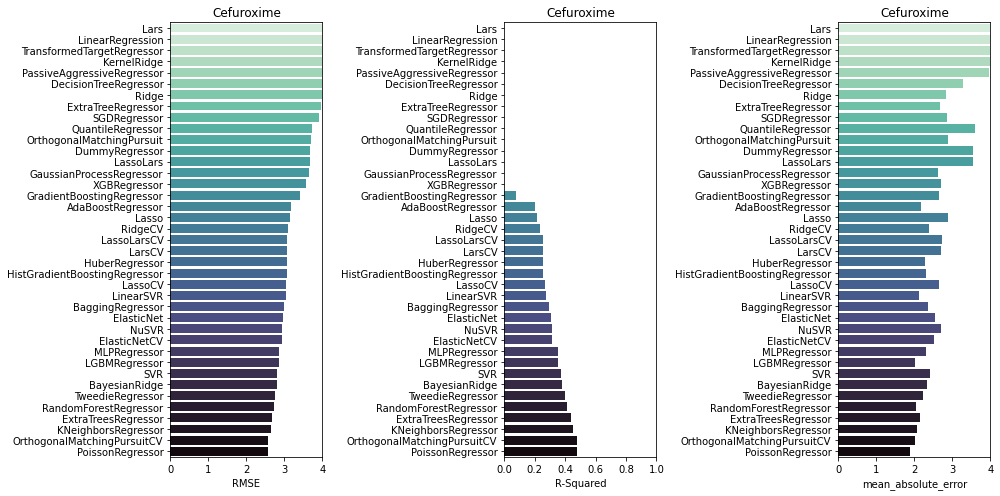

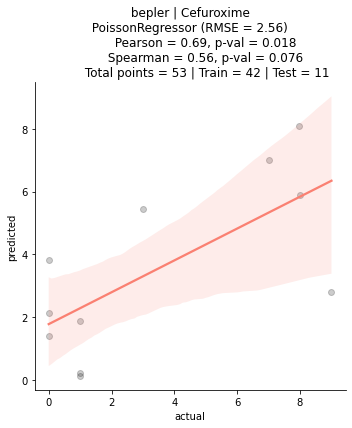

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using bepler
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:09<00:00,  4.56it/s]


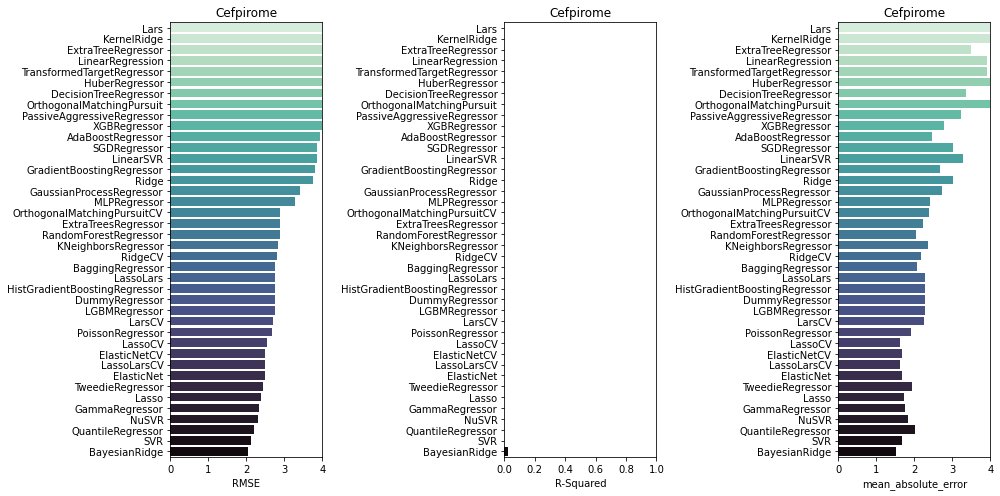

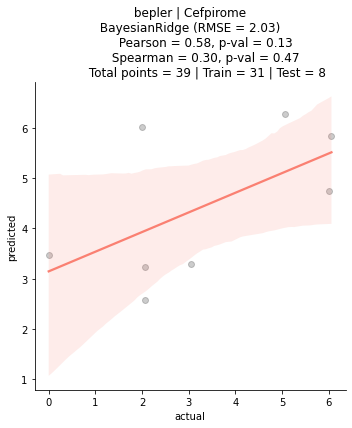

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using bepler
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:08<00:00,  5.18it/s]


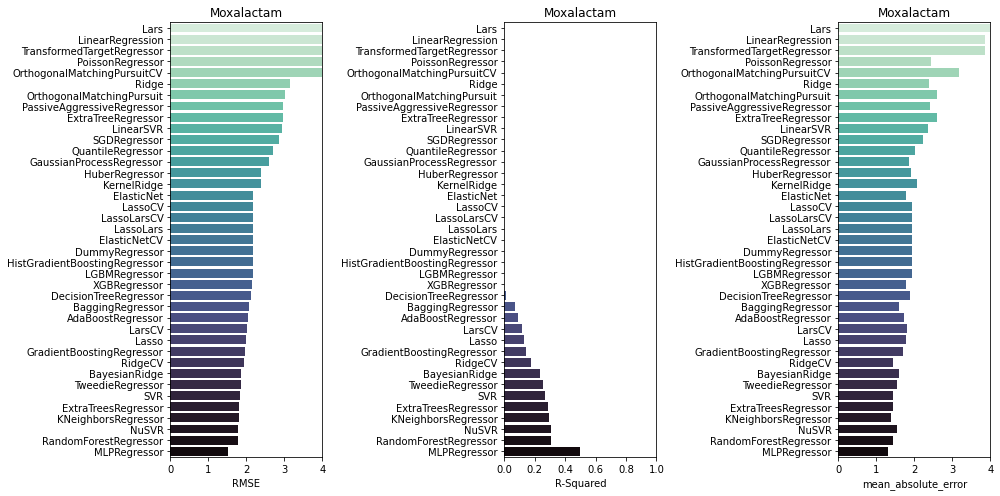

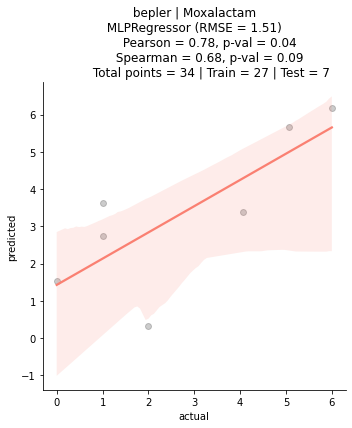

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using bepler
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:11<00:00,  3.76it/s]


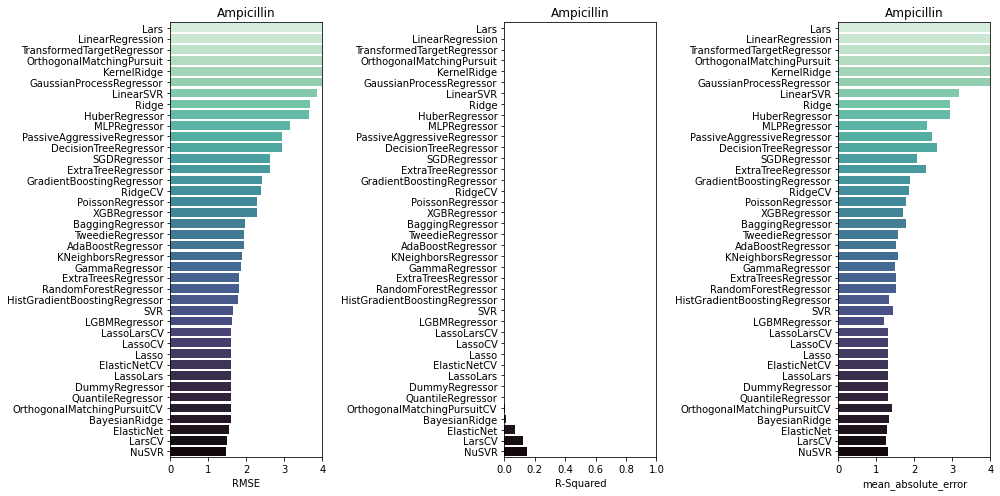

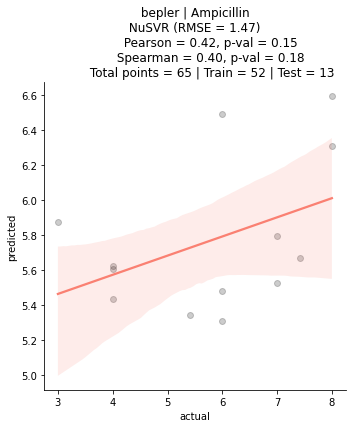

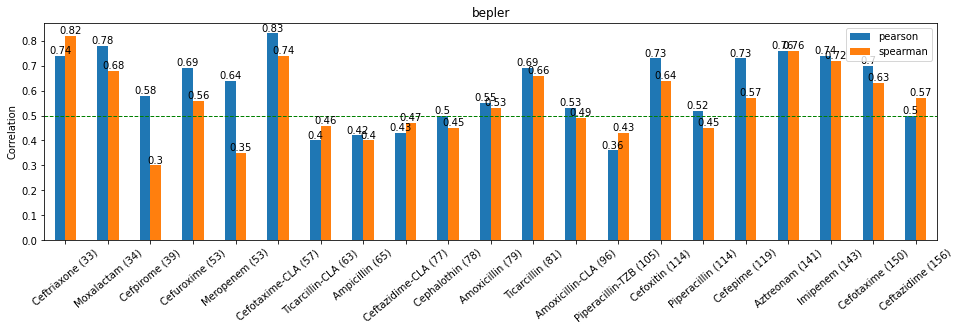

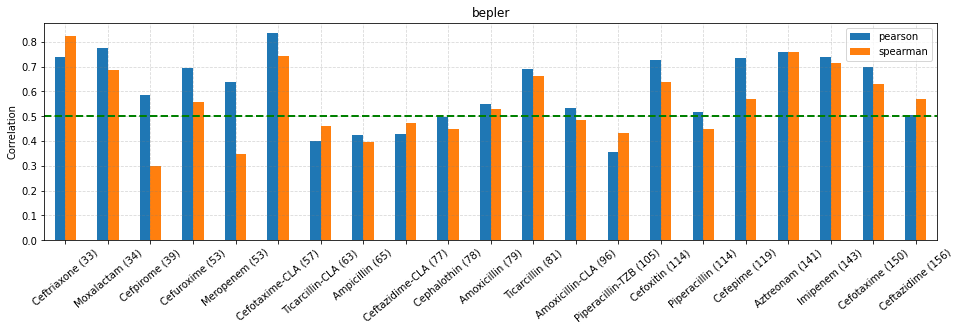

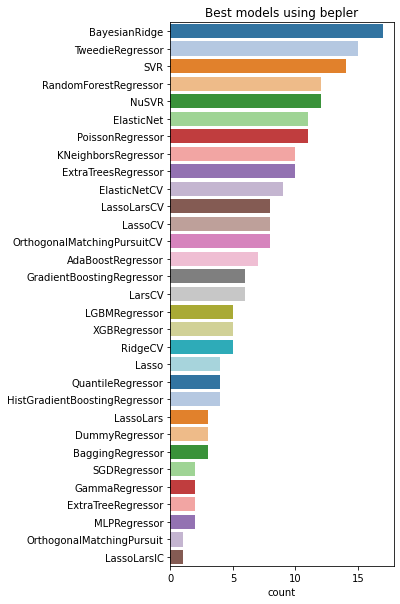

In [23]:
# set plm model
model = "bepler"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_bep = pd.DataFrame()
df_metrics_bep["anti"]         = anti_lst  
df_metrics_bep["best_model"]   = model_lst  
df_metrics_bep["rmse"]         = rmse_lst 
df_metrics_bep["mae"]          = mae_lst
df_metrics_bep["r2"]           = r_lst 
df_metrics_bep["pearson"]      = pear_lst 
df_metrics_bep["pearson_p"]    = pearp_lst 
df_metrics_bep["spearman"]     = spear_lst 
df_metrics_bep["spearman_p"]   = spearp_lst 
df_metrics_bep["data_size"]    = data_size_lst 
df_metrics_bep["train_size"]   = train_size_lst 
df_metrics_bep["test_size"]    = test_size_lst 
df_metrics_bep["top10_models"] = top10_models_lst
df_metrics_bep["anti_lab"]     = df_metrics_bep["anti"] + " " + "(" + df_metrics_bep["data_size"].astype(str) + ")"
df_metrics_bep = df_metrics_bep.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_bep.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_bep.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_bep.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_bep.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

## carp640M

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin using carp640M
         dataset size = 79 | training set = 63 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:59<00:00,  1.41s/it]


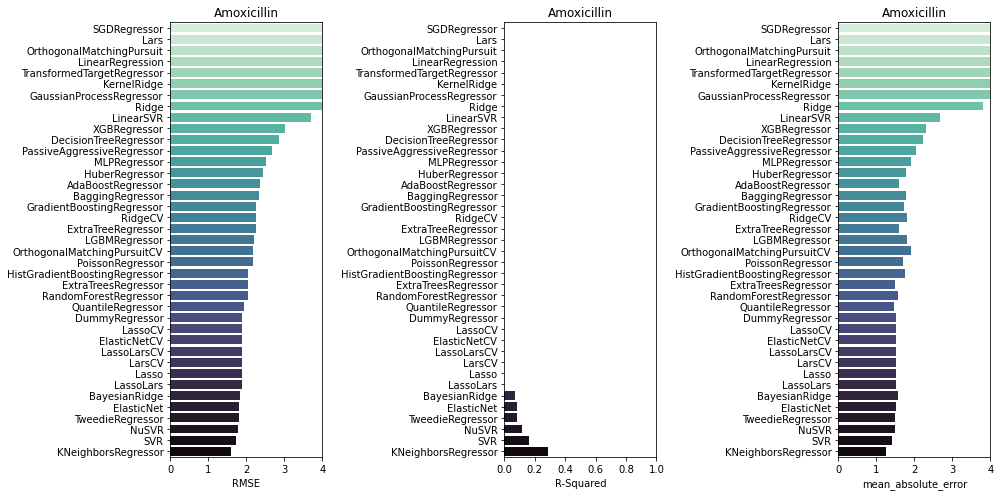

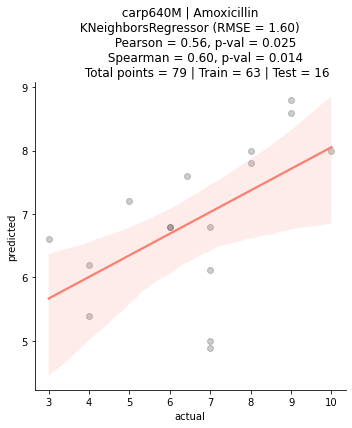

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Amoxicillin-CLA using carp640M
         dataset size = 96 | training set = 76 | testing set = 20
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:06<00:00,  1.57s/it]


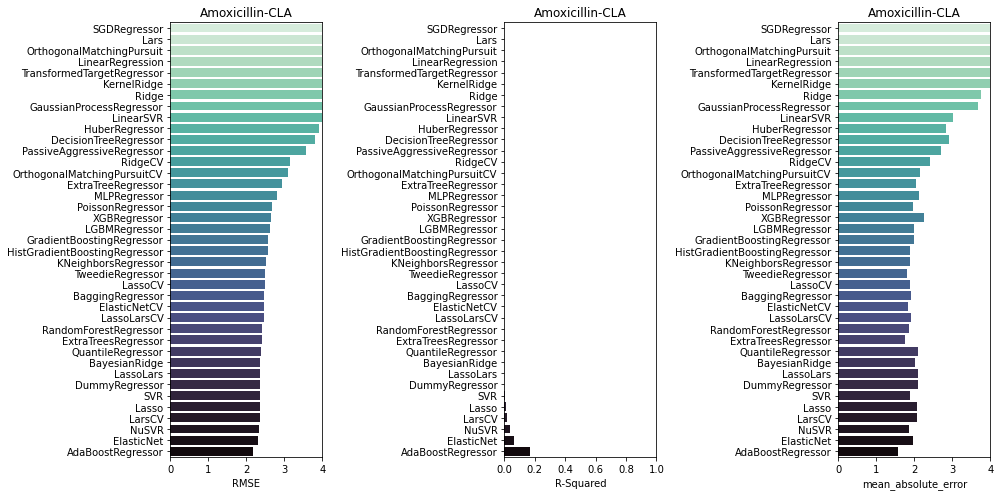

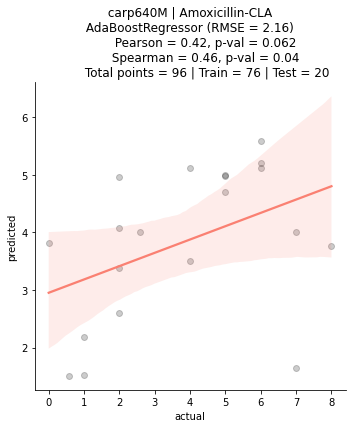

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime using carp640M
         dataset size = 156 | training set = 124 | testing set = 32
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:20<00:00,  1.92s/it]


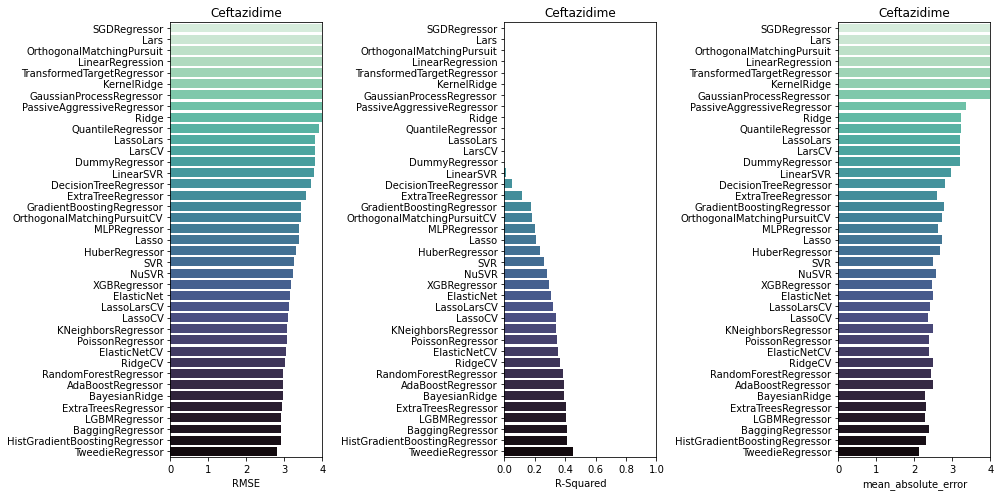

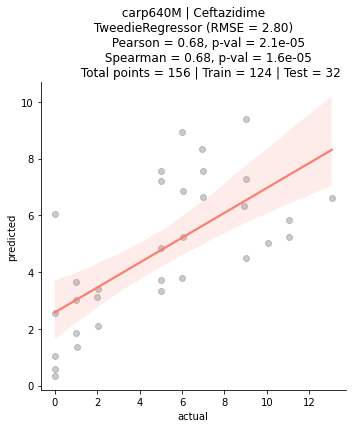

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin using carp640M
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:08<00:00,  1.64s/it]


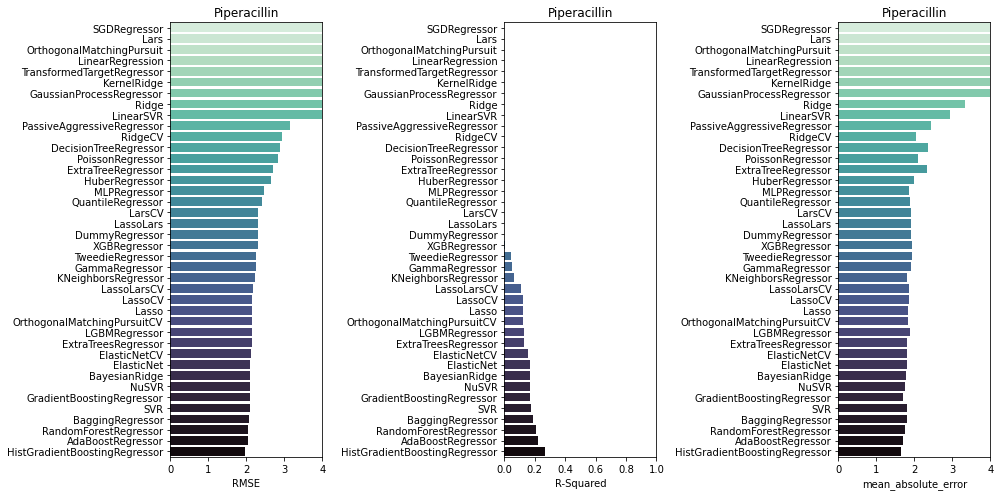

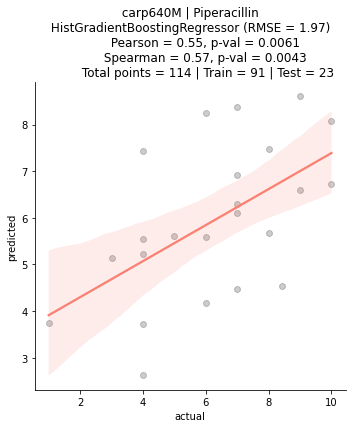

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Imipenem using carp640M
         dataset size = 143 | training set = 114 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:16<00:00,  1.81s/it]


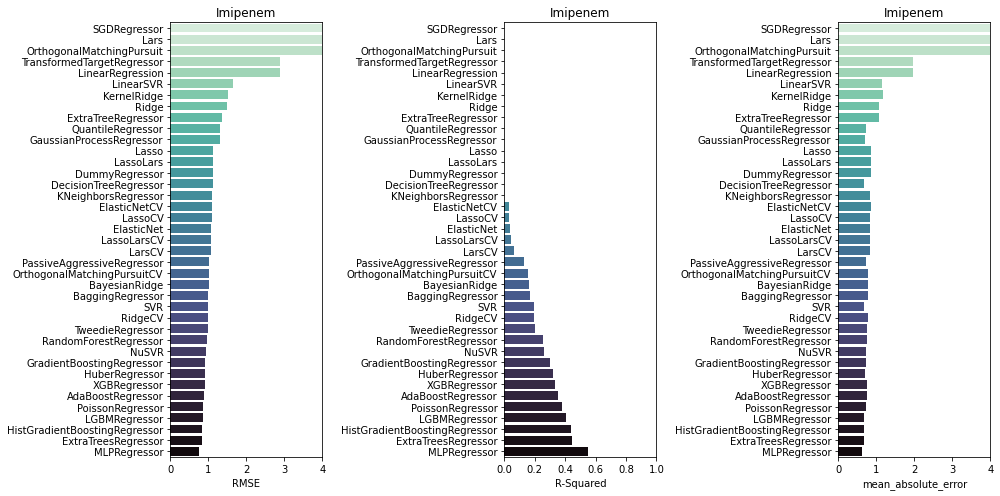

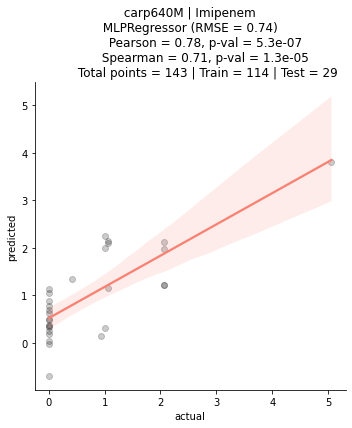

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefepime using carp640M
         dataset size = 119 | training set = 95 | testing set = 24
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:51<00:00,  1.22s/it]


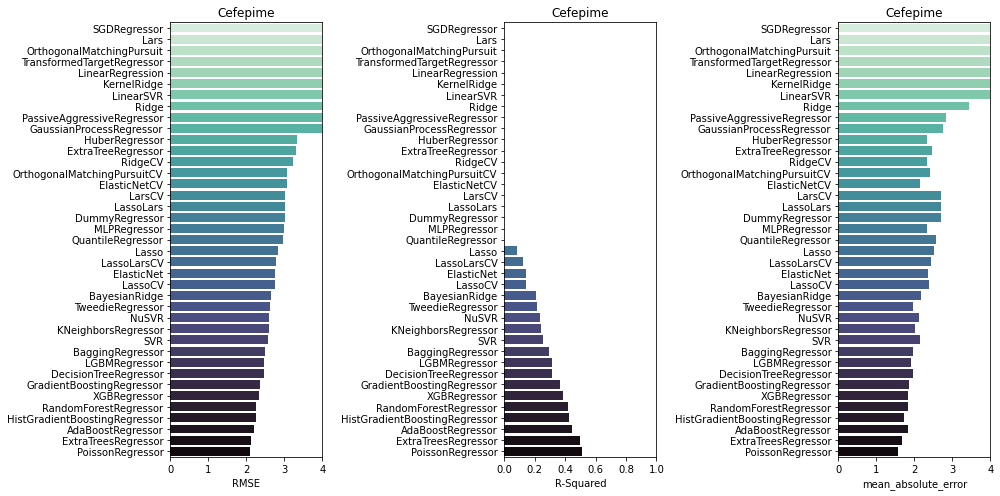

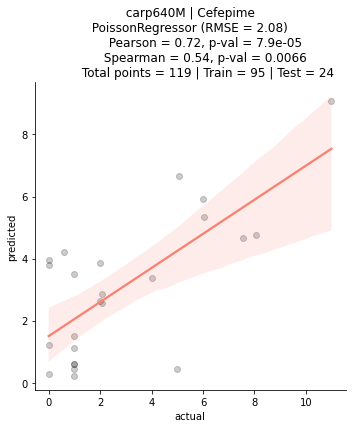

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Aztreonam using carp640M
         dataset size = 141 | training set = 112 | testing set = 29
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:14<00:00,  1.78s/it]


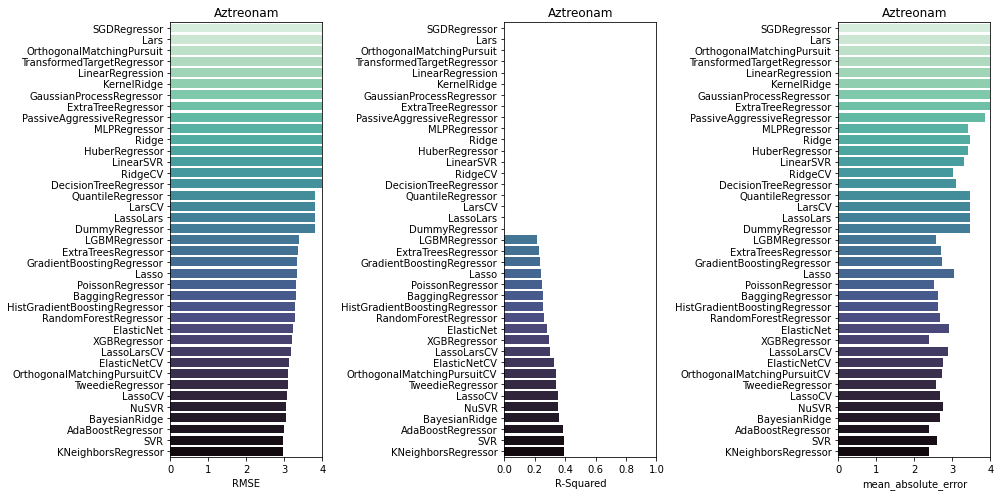

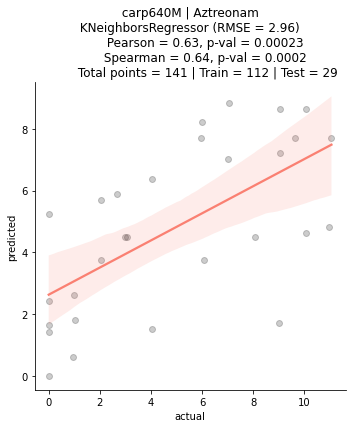

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime using carp640M
         dataset size = 150 | training set = 120 | testing set = 30
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.32s/it]


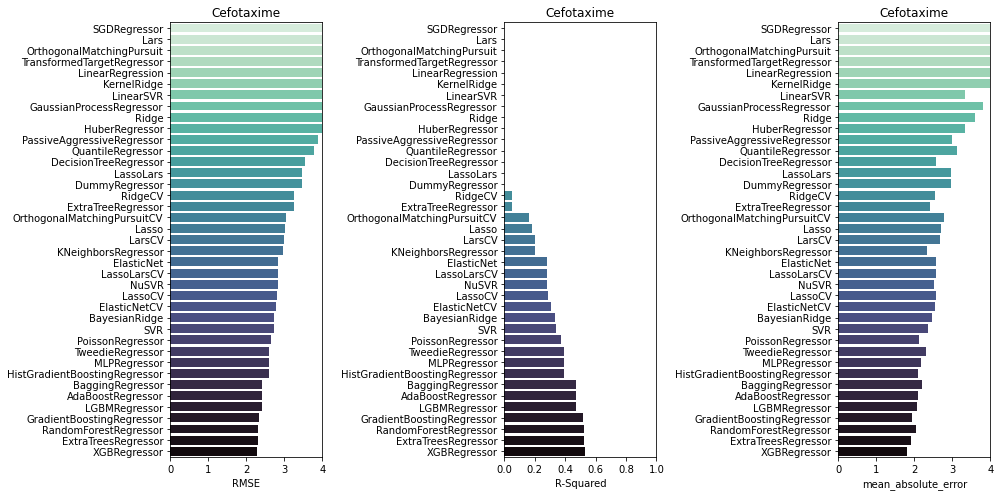

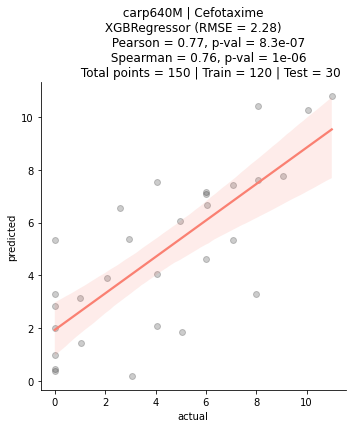

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftazidime-CLA using carp640M
         dataset size = 77 | training set = 61 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:53<00:00,  1.28s/it]


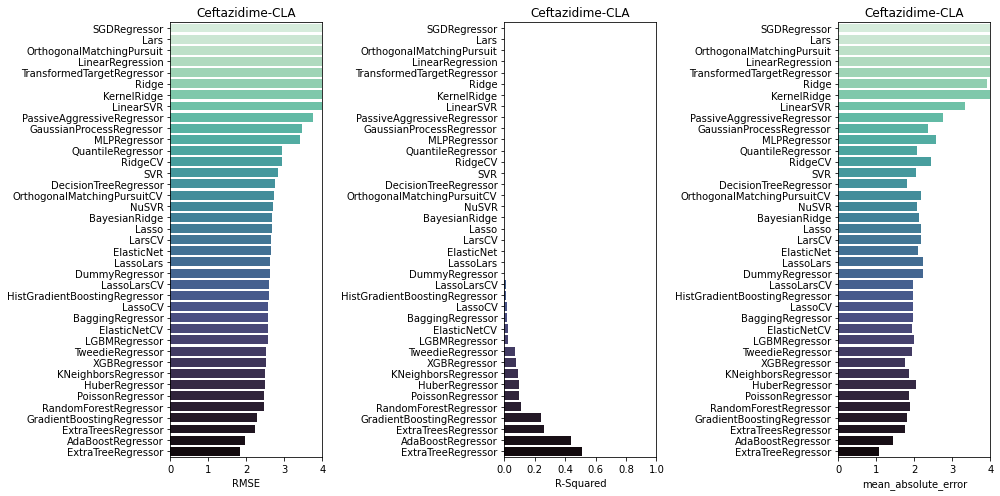

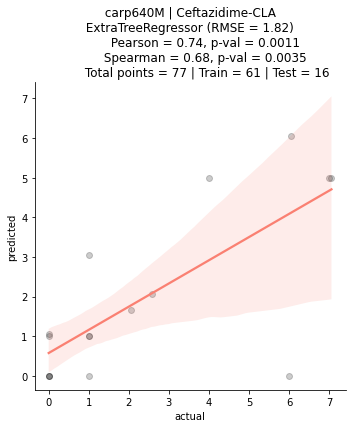

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cephalothin using carp640M
         dataset size = 78 | training set = 62 | testing set = 16
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:55<00:00,  1.32s/it]


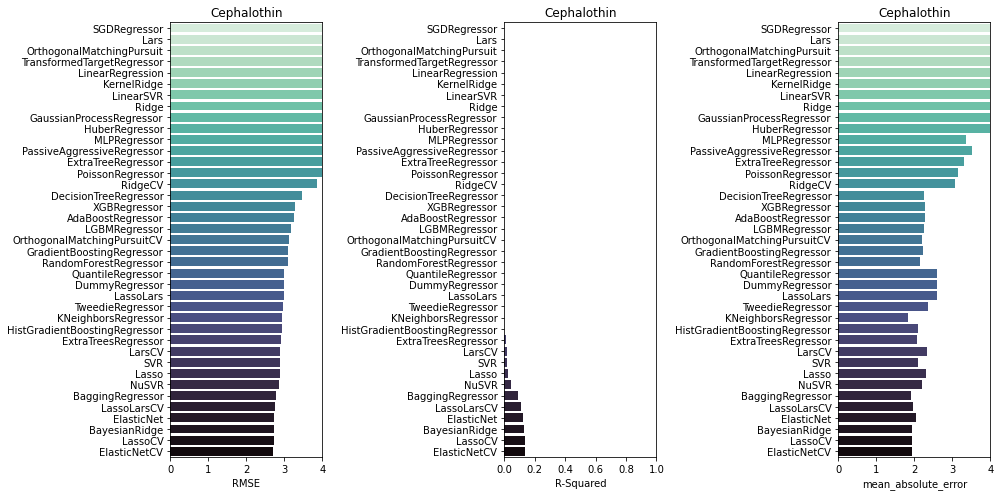

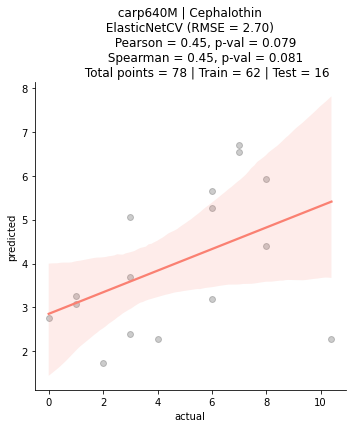

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Piperacillin-TZB using carp640M
         dataset size = 105 | training set = 84 | testing set = 21
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:12<00:00,  1.72s/it]


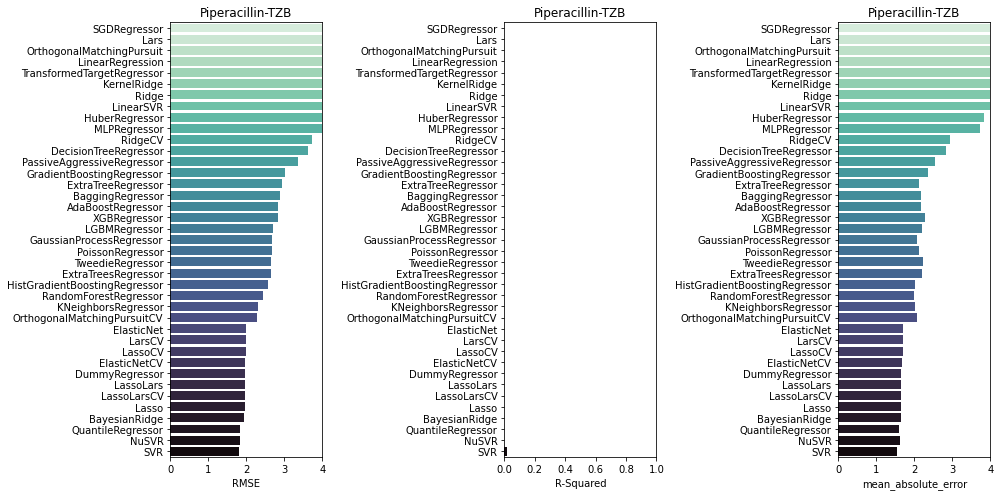

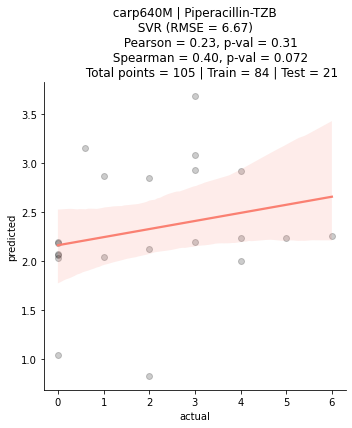

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ceftriaxone using carp640M
         dataset size = 33 | training set = 26 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:43<00:00,  1.03s/it]


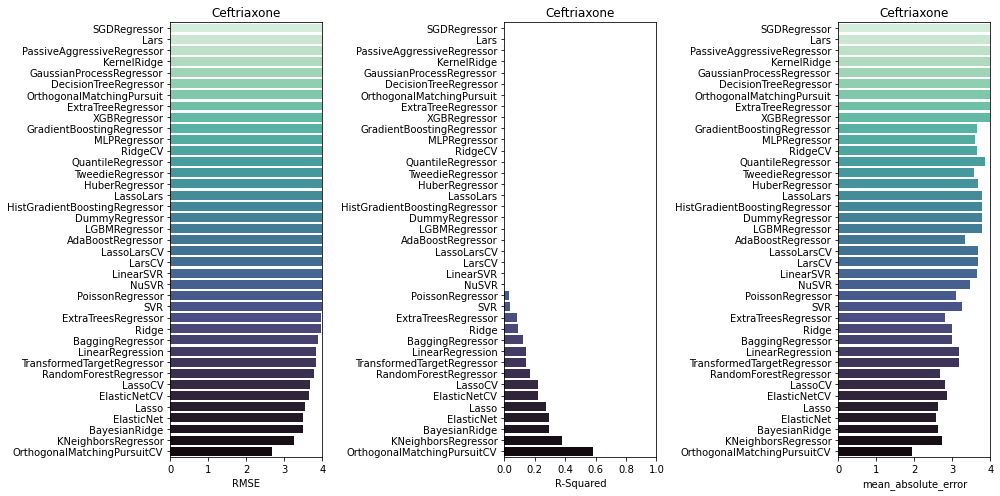

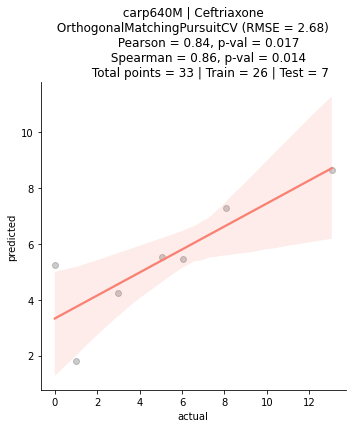

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefoxitin using carp640M
         dataset size = 114 | training set = 91 | testing set = 23
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:56<00:00,  1.34s/it]


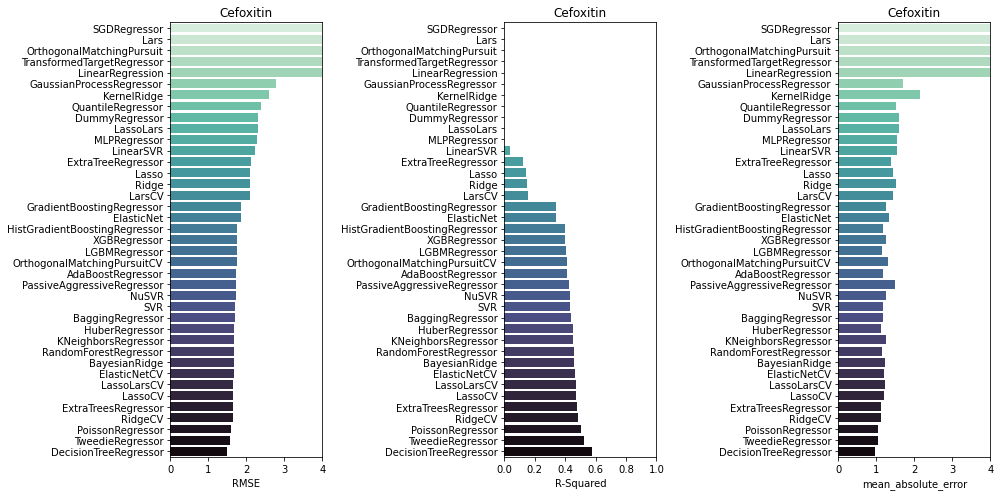

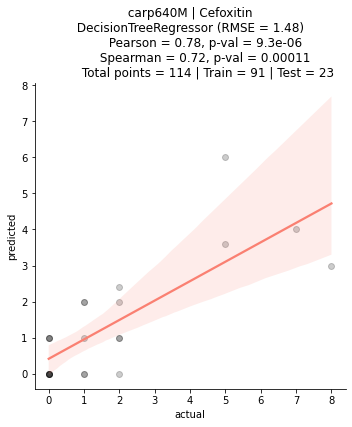

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin-CLA using carp640M
         dataset size = 63 | training set = 50 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.13s/it]


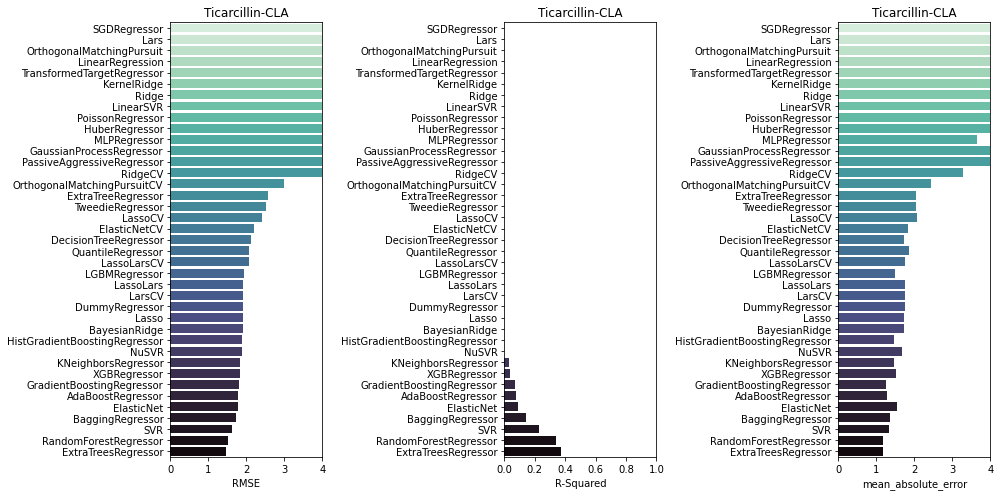

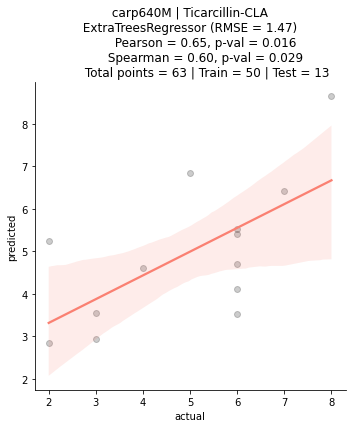

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ticarcillin using carp640M
         dataset size = 81 | training set = 64 | testing set = 17
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:00<00:00,  1.43s/it]


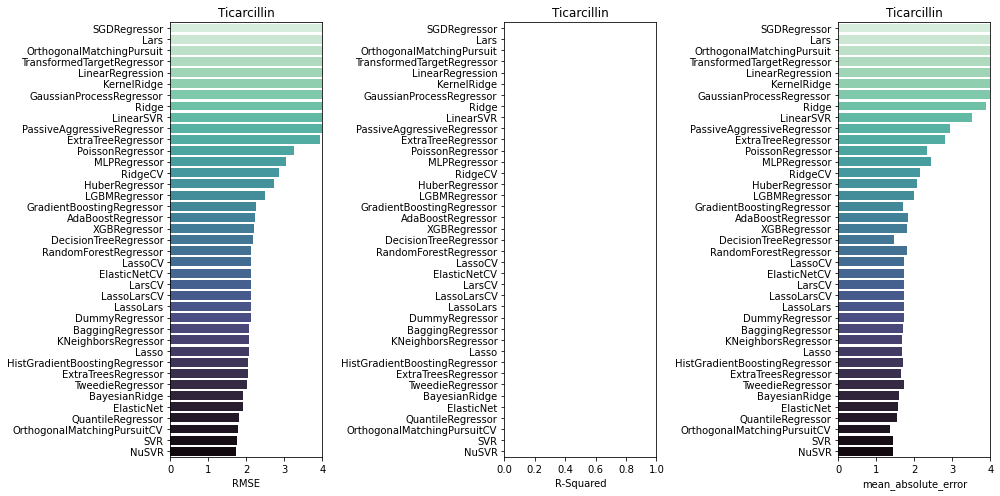

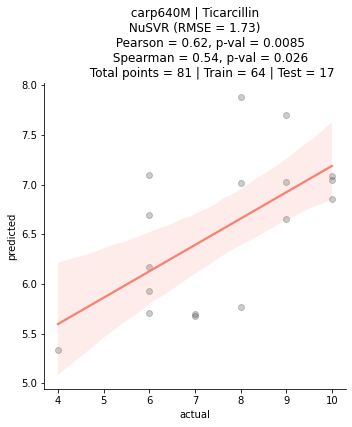

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefotaxime-CLA using carp640M
         dataset size = 57 | training set = 45 | testing set = 12
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:36<00:00,  1.15it/s]


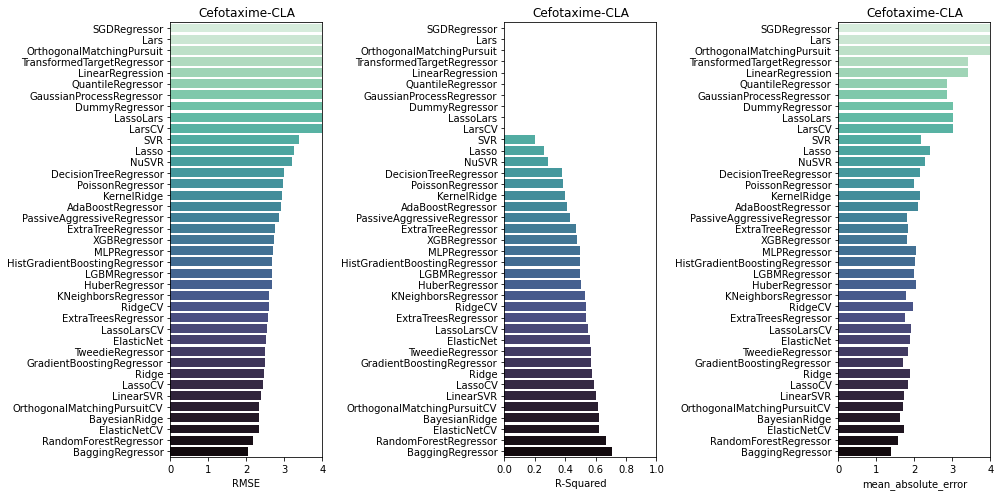

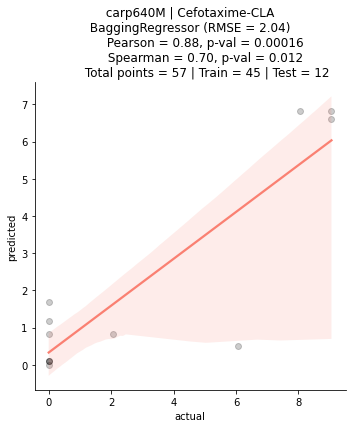

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Meropenem using carp640M
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:48<00:00,  1.16s/it]


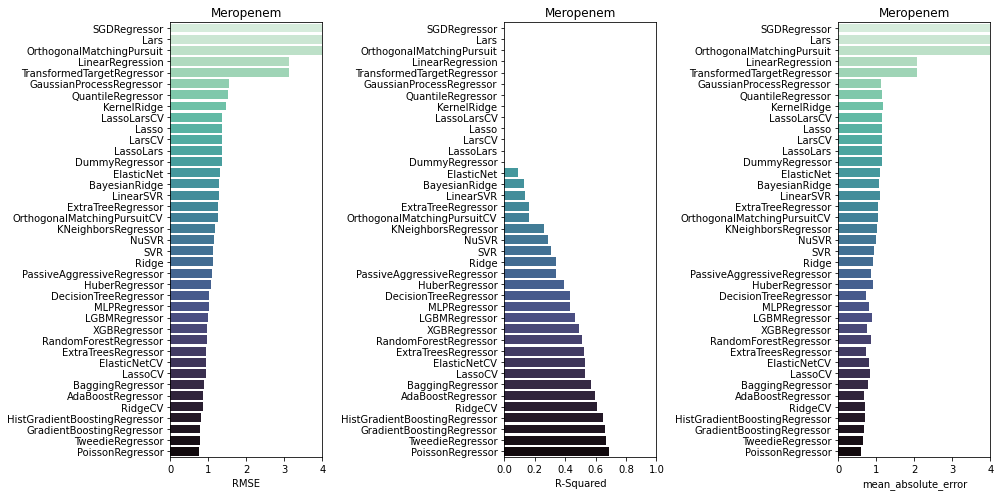

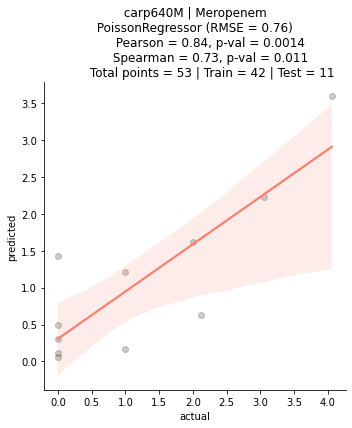

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefuroxime using carp640M
         dataset size = 53 | training set = 42 | testing set = 11
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:50<00:00,  1.19s/it]


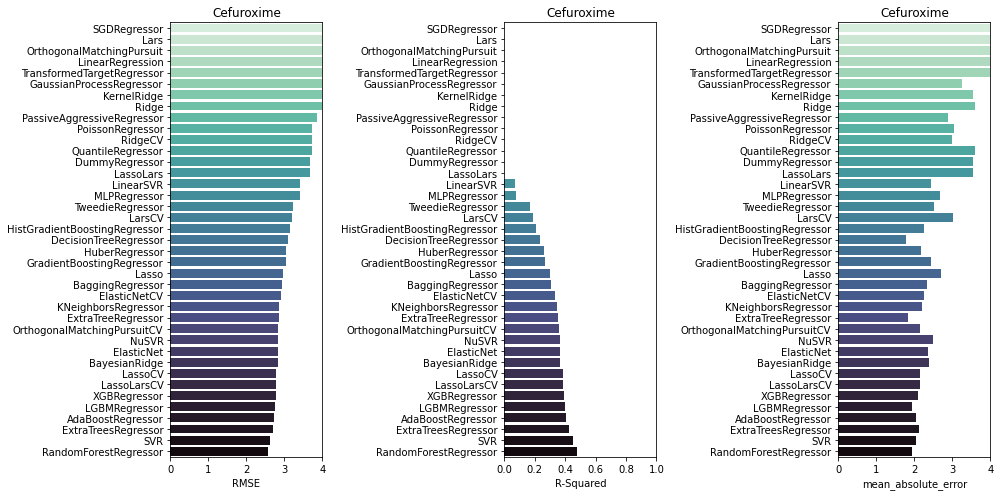

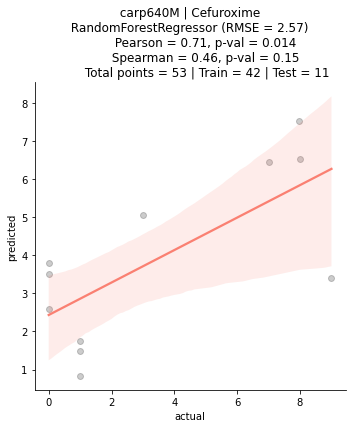

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Cefpirome using carp640M
         dataset size = 39 | training set = 31 | testing set = 8
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:47<00:00,  1.13s/it]


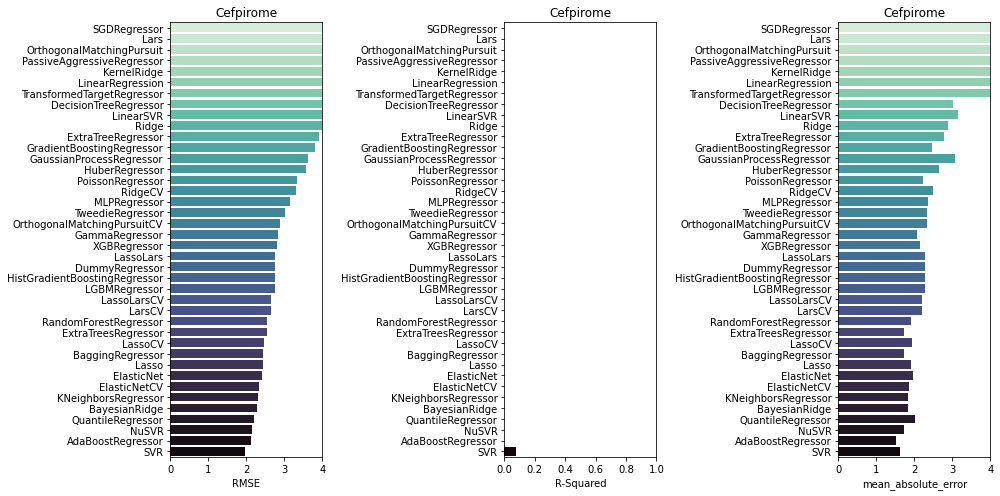

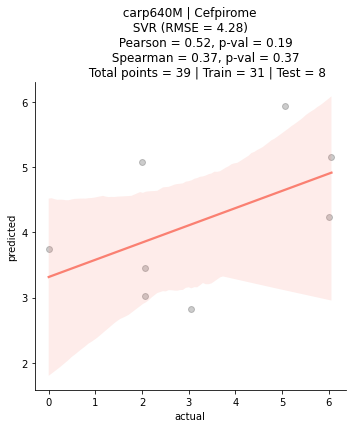

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Moxalactam using carp640M
         dataset size = 34 | training set = 27 | testing set = 7
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [00:35<00:00,  1.17it/s]


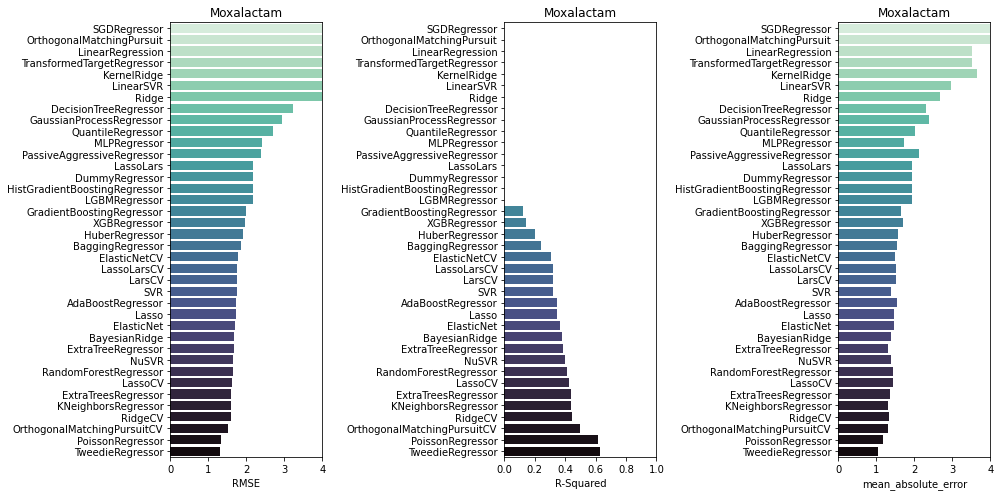

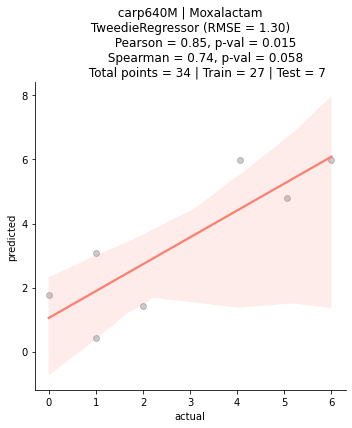

🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀
               Starting analysis for Ampicillin using carp640M
         dataset size = 65 | training set = 52 | testing set = 13
🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀🦀


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [01:03<00:00,  1.52s/it]


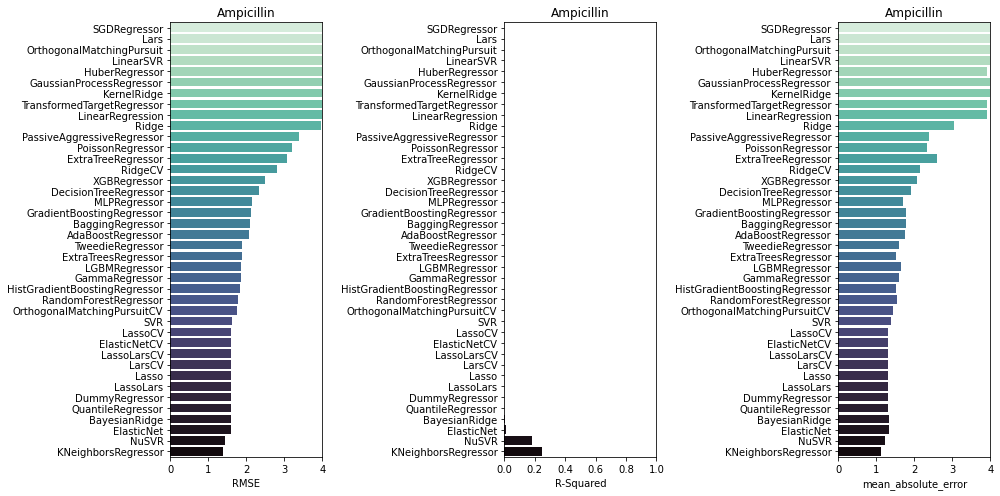

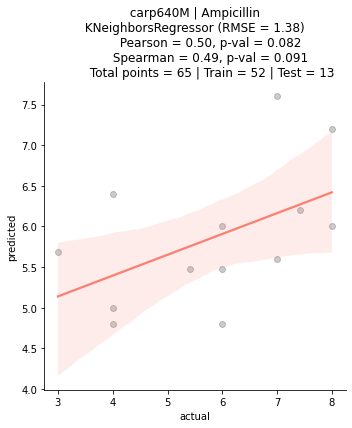

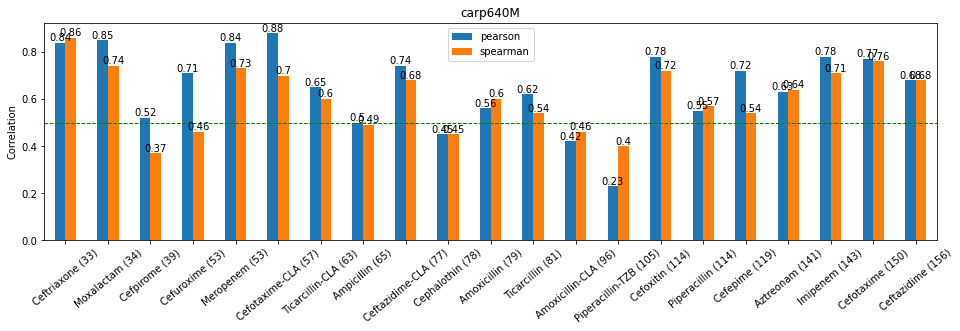

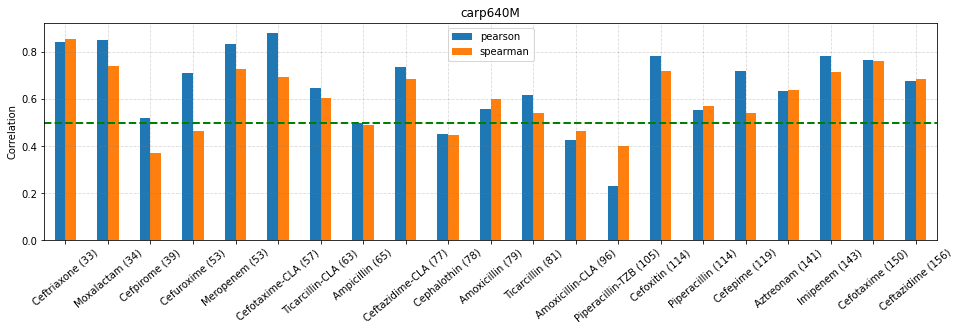

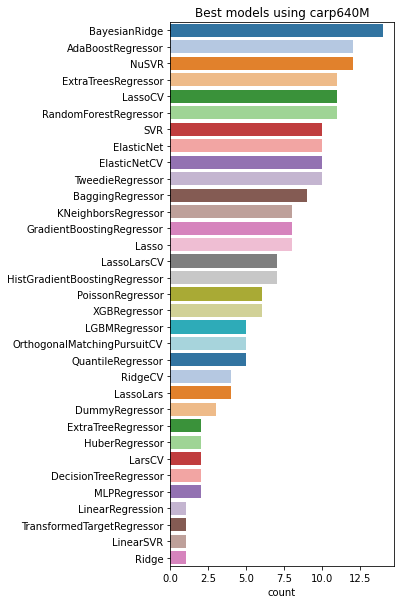

In [24]:
# set plm model
model = "carp640M"

# to collect metrics
anti_lst         = []
model_lst        = []
rmse_lst         = []
mae_lst          = []
r_lst            = []
r_adj_lst        = []
pear_lst         = []
pearp_lst        = []
spear_lst        = []
spearp_lst       = []
test_size_lst    = []
data_size_lst    = []
train_size_lst   = []
top10_models_lst = []

# do regression for each antibiotic
for antibio in uniq_anti:

    # select antibiotic
    df2 = df[df.antibiotic == antibio]
    
    # data split
    X = pd.DataFrame(df2[model].to_list())
    y = pd.DataFrame(df2.log2_fold.to_list())
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 22)
    
    print("\N{crab}"*29)
    print(f"               Starting analysis for {antibio} using {model}")
    print(f"         dataset size = {len(df2)} | training set = {len(X_train)} | testing set = {len(X_test)}")
    print("\N{crab}"*29)
    
    # set regr conditions and run the model | https://scikit-learn.org/stable/modules/classes.html#regression-metrics
    reg = LazyRegressor(verbose = 0, ignore_warnings = True, custom_metric = mean_absolute_error)
    models, predictions = reg.fit(X_train, X_test, y_train, y_test)   
    
    # collect metrics for the best model 
    best_model      = models[['RMSE']].idxmin()[0]
    df_best         = models[models.index.str.contains(best_model)]
    best_rmse       = df_best["RMSE"][0]
    best_adjusted_r = df_best["Adjusted R-Squared"][0] 
    best_r_squared  = df_best["R-Squared"][0] 
    best_mae        = df_best["mean_absolute_error"][0] 
    
    # collect metrics for top10 models
    df_top10_models = models.sort_values("RMSE").head(10)
    top10_names     = df_top10_models.index.to_list()
    top10_rmse      = df_top10_models.RMSE.to_list()
    top10_models    = dict(zip(top10_names, top10_rmse))

    # do preds w/best model
    df_preds              = pd.DataFrame()
    df_preds["actual"]    = y_test
    df_preds["predicted"] = reg.models[best_model].predict(X_test)
    
    # compute corrs
    pearson_corr,   pearson_p   = stats.pearsonr(df_preds["actual"], df_preds["predicted"])
    spearmanr_corr, spearmanr_p = stats.spearmanr(df_preds["actual"], df_preds["predicted"])
    
    # barplots of all models
    fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize=(14,7))
    sns.barplot(y = models.index, x = "RMSE", data = models, palette = "mako_r", ax = ax1).set_title(antibio)
    ax1.set(xlim = (0, 4), ylabel = (""))
    sns.barplot(y = models.index, x = "R-Squared", data = models, palette = "mako_r", ax = ax2).set_title(antibio)
    ax2.set(xlim = (0, 1), ylabel = (""))
    sns.barplot(y = models.index, x = "mean_absolute_error", data = models, palette = "mako_r", ax = ax3).set_title(antibio)
    ax3.set(xlim = (0, 4), ylabel = (""))
    plt.tight_layout()
    plt.show()
    
    # scatterplot preds vs actual
    sns.lmplot(
        data = df_preds, x = "actual", y = "predicted", height = 5, 
        scatter_kws = {"color": "black", 'alpha':0.2}, line_kws = {"color": "salmon"})
    plt.title(
        f" {model} | {antibio} \n {best_model} (RMSE = %.2f) \n \
        Pearson = %.2f, p-val = %.2g \n \
        Spearman = %.2f, p-val = %.2g \n \
        Total points = {len(df2)} | Train = {len(y_train)} | Test = {len(y_test)}" 
        %(best_rmse, pearson_corr, pearson_p, spearmanr_corr, spearmanr_p), size=12)
    plt.show()   

    # append data
    anti_lst.append(antibio)
    model_lst.append(best_model)
    rmse_lst.append(best_rmse)
    mae_lst.append(best_mae)
    r_lst.append(best_r_squared)
    r_adj_lst.append(best_adjusted_r)
    pear_lst.append(pearson_corr)
    pearp_lst.append(pearson_p)
    spear_lst.append(spearmanr_corr)
    spearp_lst.append(spearmanr_p)
    data_size_lst.append(len(df2))
    train_size_lst.append(len(X_train))
    test_size_lst.append(len(X_test))
    top10_models_lst.append(top10_models)
    
# create a df with metrics
df_metrics_carp = pd.DataFrame()
df_metrics_carp["anti"]         = anti_lst  
df_metrics_carp["best_model"]   = model_lst  
df_metrics_carp["rmse"]         = rmse_lst 
df_metrics_carp["mae"]          = mae_lst
df_metrics_carp["r2"]           = r_lst 
df_metrics_carp["pearson"]      = pear_lst 
df_metrics_carp["pearson_p"]    = pearp_lst 
df_metrics_carp["spearman"]     = spear_lst 
df_metrics_carp["spearman_p"]   = spearp_lst 
df_metrics_carp["data_size"]    = data_size_lst 
df_metrics_carp["train_size"]   = train_size_lst 
df_metrics_carp["test_size"]    = test_size_lst 
df_metrics_carp["top10_models"] = top10_models_lst
df_metrics_carp["anti_lab"]     = df_metrics_carp["anti"] + " " + "(" + df_metrics_carp["data_size"].astype(str) + ")"
df_metrics_carp = df_metrics_carp.sort_values("data_size", ascending=True)

# plot df metrics
ax = df_metrics_carp.round({'pearson': 2, 'spearman': 2}).plot.bar(
    x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=1)
plt.ylabel("Correlation")
plt.xlabel("")
plt.title(model)
for container in ax.containers:
    ax.bar_label(container)
plt.show()
    
df_metrics_carp.plot.bar(x ='anti_lab', y = ['pearson', 'spearman'], rot = 40, figsize=(16,4))
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.ylabel("Correlation")
plt.grid(color = "grey", linestyle="--", alpha=0.3)
plt.title(model)
plt.xlabel("")
plt.show()

plt.figure(figsize=(4,10))
sns.countplot(
    y     = df_metrics_carp.top10_models.explode().to_list(), palette= "tab20",
    order = pd.value_counts(df_metrics_carp.top10_models.explode().to_list()).index)
plt.title(f"Best models using {model}")
plt.show()

# model comparison 

In [25]:
# add the plm 
df_metrics_bep["model"] = "Bepler"
df_metrics_carp["model"] = "CARP640M"
df_metrics_esm["model"] = "ESM"
df_metrics_esm1b["model"] = "ESM1b"
df_metrics_esm1b_pca["model"] = "PCA_ESM1b"
df_metrics_aac["model"] = "aa_composition"
df_metrics_t5["model"] = "T5XLU50"
df_metrics_t5_pca["model"] = "PCA_T5XLU50"
df_metrics_t5bfd["model"] = "T5BFD"
df_metrics_xlnet["model"] = "XLNet"

# concat the data 
df_metrics_all = pd.concat([
    df_metrics_bep, df_metrics_carp, df_metrics_esm, df_metrics_esm1b, df_metrics_esm1b_pca,
    df_metrics_aac, df_metrics_t5, df_metrics_t5_pca, df_metrics_t5bfd, df_metrics_xlnet])

# add the antibiotic class
penicillins = ["Amoxicillin","Ticarcillin","Piperacillin", "Piperacillin-TZB",
               "Amoxicillin-CLA","Ampicillin","Ticarcillin-CLA"]

cephalosporins = ["Cephalothin","Cefuroxime","Cefoxitin", "Ceftazidime", "Ceftriaxone","Cefotaxime",
                  "Ceftazidime-CLA", "Cefotaxime-CLA", "Cefepime", "Cefpirome"]

carbapenems = ["Imipenem","Meropenem"]

monobactams = ["Aztreonam","Moxalactam"]

filters = [df_metrics_all.anti.str.contains('|'.join(penicillins)), 
           df_metrics_all.anti.str.contains('|'.join(cephalosporins)),
           df_metrics_all.anti.str.contains('|'.join(carbapenems)),
           df_metrics_all.anti.str.contains('|'.join(monobactams))]

values = ["Penicillins", "Cephalosporins", "Carbapenems", "Monobactams"]

df_metrics_all["anti_class"] = np.select(filters, values)
df_metrics_all

,anti,best_model,rmse,mae,r2,pearson,pearson_p,spearman,spearman_p,data_size,train_size,test_size,top10_models,anti_lab,model,anti_class
11,Ceftriaxone,RandomForestRegressor,3.20,2.30,0.40,0.74,0.06,0.82,0.02,33,26,7,"{'RandomForestRegressor': 3.197482972452653, '...",Ceftriaxone (33),Bepler,Cephalosporins
19,Moxalactam,MLPRegressor,1.51,1.29,0.50,0.78,0.04,0.68,0.09,34,27,7,"{'MLPRegressor': 1.50869874376584, 'RandomFore...",Moxalactam (34),Bepler,Monobactams
18,Cefpirome,BayesianRidge,2.03,1.51,0.02,0.58,0.13,0.30,0.47,39,31,8,"{'BayesianRidge': 2.029321922219595, 'SVR': 2....",Cefpirome (39),Bepler,Cephalosporins
17,Cefuroxime,PoissonRegressor,2.56,1.89,0.48,0.69,0.02,0.56,0.08,53,42,11,"{'PoissonRegressor': 2.563380653375655, 'Ortho...",Cefuroxime (53),Bepler,Cephalosporins
16,Meropenem,KNeighborsRegressor,1.06,0.89,0.39,0.64,0.04,0.35,0.29,53,42,11,"{'KNeighborsRegressor': 1.0616724590697946, 'P...",Meropenem (53),Bepler,Carbapenems
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5,Cefepime,ExtraTreeRegressor,1.89,1.58,0.59,0.82,0.00,0.59,0.00,119,95,24,"{'ExtraTreeRegressor': 1.8948107412839132, 'Po...",Cefepime (119),XLNet,Cephalosporins
6,Aztreonam,SVR,5.27,3.61,-0.92,0.65,0.00,0.71,0.00,141,112,29,"{'SVR': 2.98760408566907, 'NuSVR': 3.015224323...",Aztreonam (141),XLNet,Monobactams
4,Imipenem,BaggingRegressor,0.87,0.73,0.38,0.65,0.00,0.52,0.00,143,114,29,"{'BaggingRegressor': 0.8669968505029069, 'KNei...",Imipenem (143),XLNet,Carbapenems
7,Cefotaxime,XGBRegressor,2.28,1.77,0.53,0.76,0.00,0.78,0.00,150,120,30,"{'XGBRegressor': 2.281795483733071, 'RandomFor...",Cefotaxime (150),XLNet,Cephalosporins


In [26]:
# save the data 
# df_metrics_all.to_csv("../results/training/regressor_comparison.csv", index = False)

## best regressor 

In [3]:
# read the data 
df_metrics_all       = pd.read_csv("../results/training/regressor_comparison.csv")

# detect the dict objetcs 
df_metrics_all["top10_models"] = df_metrics_all["top10_models"].apply(lambda x: eval(x))

# split by plm 
df_metrics_bep       = df_metrics_all[df_metrics_all.model == "Bepler"] 
df_metrics_carp      = df_metrics_all[df_metrics_all.model == "CARP640M"]
df_metrics_esm       = df_metrics_all[df_metrics_all.model == "ESM"]
df_metrics_esm1b     = df_metrics_all[df_metrics_all.model == "ESM1b"]
df_metrics_esm1b_pca = df_metrics_all[df_metrics_all.model == "PCA_ESM1b"]
df_metrics_aac       = df_metrics_all[df_metrics_all.model == "aa_composition"]
df_metrics_t5        = df_metrics_all[df_metrics_all.model == "T5XLU50"]
df_metrics_t5_pca    = df_metrics_all[df_metrics_all.model == "PCA_T5XLU50"]
df_metrics_t5bfd     = df_metrics_all[df_metrics_all.model == "T5BFD"]
df_metrics_xlnet     = df_metrics_all[df_metrics_all.model == "XLNet"]
meta_df = [
    df_metrics_bep, df_metrics_carp, df_metrics_esm, df_metrics_esm1b, df_metrics_esm1b_pca,
    df_metrics_aac, df_metrics_t5, df_metrics_t5_pca, df_metrics_t5bfd, df_metrics_xlnet
]
df_metrics_all

,anti,best_model,rmse,mae,r2,pearson,pearson_p,spearman,spearman_p,data_size,train_size,test_size,top10_models,anti_lab,model,anti_class
0,Ceftriaxone,RandomForestRegressor,3.20,2.30,0.40,0.74,0.06,0.82,0.02,33,26,7,"{'RandomForestRegressor': 3.197482972452653, '...",Ceftriaxone (33),Bepler,Cephalosporins
1,Moxalactam,MLPRegressor,1.51,1.29,0.50,0.78,0.04,0.68,0.09,34,27,7,"{'MLPRegressor': 1.50869874376584, 'RandomFore...",Moxalactam (34),Bepler,Monobactams
2,Cefpirome,BayesianRidge,2.03,1.51,0.02,0.58,0.13,0.30,0.47,39,31,8,"{'BayesianRidge': 2.029321922219595, 'SVR': 2....",Cefpirome (39),Bepler,Cephalosporins
3,Cefuroxime,PoissonRegressor,2.56,1.89,0.48,0.69,0.02,0.56,0.08,53,42,11,"{'PoissonRegressor': 2.563380653375655, 'Ortho...",Cefuroxime (53),Bepler,Cephalosporins
4,Meropenem,KNeighborsRegressor,1.06,0.89,0.39,0.64,0.04,0.35,0.29,53,42,11,"{'KNeighborsRegressor': 1.0616724590697946, 'P...",Meropenem (53),Bepler,Carbapenems
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,Cefepime,ExtraTreeRegressor,1.89,1.58,0.59,0.82,0.00,0.59,0.00,119,95,24,"{'ExtraTreeRegressor': 1.8948107412839132, 'Po...",Cefepime (119),XLNet,Cephalosporins
206,Aztreonam,SVR,5.27,3.61,-0.92,0.65,0.00,0.71,0.00,141,112,29,"{'SVR': 2.98760408566907, 'NuSVR': 3.015224323...",Aztreonam (141),XLNet,Monobactams
207,Imipenem,BaggingRegressor,0.87,0.73,0.38,0.65,0.00,0.52,0.00,143,114,29,"{'BaggingRegressor': 0.8669968505029069, 'KNei...",Imipenem (143),XLNet,Carbapenems
208,Cefotaxime,XGBRegressor,2.28,1.77,0.53,0.76,0.00,0.78,0.00,150,120,30,"{'XGBRegressor': 2.281795483733071, 'RandomFor...",Cefotaxime (150),XLNet,Cephalosporins


In [4]:
# per each antibiotic, we have 10 rows, one per each model
# here is an example for imipenem
df_metrics_all[df_metrics_all.anti == "Imipenem"]

,anti,best_model,rmse,mae,r2,pearson,pearson_p,spearman,spearman_p,data_size,train_size,test_size,top10_models,anti_lab,model,anti_class
18,Imipenem,KNeighborsRegressor,0.77,0.58,0.51,0.74,0.00,0.72,0.00,143,114,29,"{'KNeighborsRegressor': 0.7679736878326875, 'N...",Imipenem (143),Bepler,Carbapenems
39,Imipenem,MLPRegressor,0.74,0.63,0.55,0.78,0.00,0.71,0.00,143,114,29,"{'MLPRegressor': 0.739297774661454, 'ExtraTree...",Imipenem (143),CARP640M,Carbapenems
60,Imipenem,AdaBoostRegressor,0.85,0.73,0.41,0.72,0.00,0.67,0.00,143,114,29,"{'AdaBoostRegressor': 0.8470759683168424, 'Gra...",Imipenem (143),ESM,Carbapenems
81,Imipenem,AdaBoostRegressor,0.76,0.66,0.52,0.79,0.00,0.63,0.00,143,114,29,"{'AdaBoostRegressor': 0.762987842622335, 'Hist...",Imipenem (143),ESM1b,Carbapenems
102,Imipenem,HuberRegressor,0.82,0.60,0.44,0.67,0.00,0.60,0.00,143,114,29,"{'HuberRegressor': 0.8249570603691664, 'XGBReg...",Imipenem (143),PCA_ESM1b,Carbapenems
123,Imipenem,XGBRegressor,0.93,0.68,0.29,0.61,0.00,0.72,0.00,143,114,29,"{'XGBRegressor': 0.9260818321619394, 'NuSVR': ...",Imipenem (143),aa_composition,Carbapenems
144,Imipenem,BaggingRegressor,0.79,0.64,0.49,0.72,0.00,0.49,0.01,143,114,29,"{'BaggingRegressor': 0.7852993544231033, 'AdaB...",Imipenem (143),T5XLU50,Carbapenems
165,Imipenem,LGBMRegressor,0.90,0.70,0.33,0.64,0.00,0.64,0.00,143,114,29,"{'LGBMRegressor': 0.9022789513515876, 'XGBRegr...",Imipenem (143),PCA_T5XLU50,Carbapenems
186,Imipenem,XGBRegressor,0.75,0.63,0.53,0.74,0.00,0.64,0.00,143,114,29,"{'XGBRegressor': 0.7528827320735106, 'Gradient...",Imipenem (143),T5BFD,Carbapenems
207,Imipenem,BaggingRegressor,0.87,0.73,0.38,0.65,0.00,0.52,0.00,143,114,29,"{'BaggingRegressor': 0.8669968505029069, 'KNei...",Imipenem (143),XLNet,Carbapenems


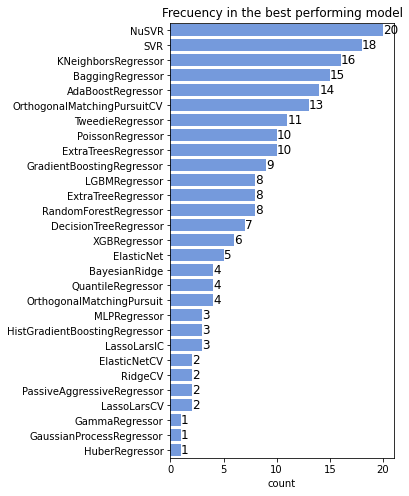

In [5]:
plt.figure(figsize=(4,8))
ax = sns.countplot(data = df_metrics_all, y = "best_model", color = "cornflowerblue", 
             order = pd.value_counts(df_metrics_all.best_model).index)
plt.ylabel("")
plt.xlabel("count")
plt.title("Frecuency in the best performing model")
ax.bar_label(ax.containers[0], size = 12); 

In [6]:
# take the top3 models and append it as a new col 
df_metrics_all["top3_models"] = df_metrics_all["top10_models"].apply(lambda x: dict(list(x.items())[:3]))

# show an example of the top10 and top3
print(f" Top10 models \n {df_metrics_all.top10_models[0]} \n\n")
print(f" Top3 models \n {df_metrics_all.top3_models[0]}")

 Top10 models 
 {'RandomForestRegressor': 3.197482972452653, 'ExtraTreeRegressor': 3.2772985159041075, 'TweedieRegressor': 3.2978998509381934, 'BaggingRegressor': 3.3296382601720063, 'KNeighborsRegressor': 3.345535501265968, 'ExtraTreesRegressor': 3.3870321842670426, 'ElasticNet': 3.412188870151196, 'PoissonRegressor': 3.5263947056537885, 'BayesianRidge': 3.560615712973376, 'RidgeCV': 3.5775406911641725} 


 Top3 models 
 {'RandomForestRegressor': 3.197482972452653, 'ExtraTreeRegressor': 3.2772985159041075, 'TweedieRegressor': 3.2978998509381934}


In [7]:
# show another example
print(f" Top10 models \n {df_metrics_all.top10_models[1]} \n\n")
print(f" Top3 models \n {df_metrics_all.top3_models[1]}")

 Top10 models 
 {'MLPRegressor': 1.50869874376584, 'RandomForestRegressor': 1.773967678991001, 'NuSVR': 1.7801822229856872, 'KNeighborsRegressor': 1.7969981469852365, 'ExtraTreesRegressor': 1.8012566203316742, 'SVR': 1.8296104315650772, 'TweedieRegressor': 1.8467347699761807, 'BayesianRidge': 1.864308095785286, 'RidgeCV': 1.939549397135761, 'GradientBoostingRegressor': 1.9740614186074477} 


 Top3 models 
 {'MLPRegressor': 1.50869874376584, 'RandomForestRegressor': 1.773967678991001, 'NuSVR': 1.7801822229856872}


In [8]:
# create a list of keys 
keys_list = []

for ele in df_metrics_all["top3_models"]:
    keys_list.extend(list(ele.keys()))

# create a df and count frecs
df_top3 = pd.DataFrame({"keys": keys_list})
df_top3 = df_top3.groupby("keys").size().reset_index(name="frequency")
df_top3 = df_top3.sort_values("frequency", ascending = False).reset_index(drop = True)
df_top3.head()

,keys,frequency
0,SVR,57
1,NuSVR,53
2,ExtraTreesRegressor,47
3,AdaBoostRegressor,36
4,RandomForestRegressor,36


In [9]:
# 210 * 3 = 630 expected data points 
len(keys_list)

630

In [10]:
# the same but for top 10 models 
keys_list2 = []

for ele in df_metrics_all["top10_models"]:
    keys_list2.extend(list(ele.keys()))

df_top10 = pd.DataFrame({"keys": keys_list2})
df_top10 = df_top10.groupby("keys").size().reset_index(name="frequency")
df_top10 = df_top10.sort_values("frequency", ascending = False).reset_index(drop = True)
df_top10.head()

,keys,frequency
0,BayesianRidge,131
1,RandomForestRegressor,127
2,ExtraTreesRegressor,112
3,SVR,110
4,NuSVR,109


In [11]:
# 210 * 10 = 2100 expected data points 
len(keys_list2)

2100

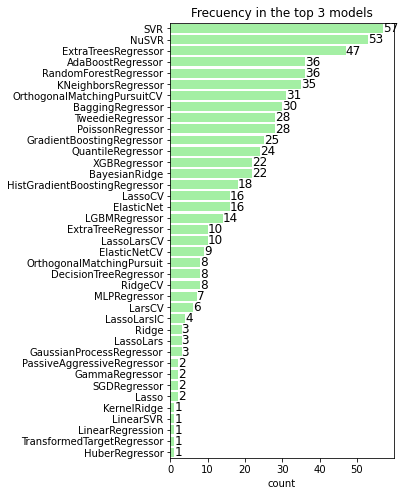

In [12]:
plt.figure(figsize=(4,8))
ax = sns.barplot(data = df_top3, x = "frequency", y = "keys", color = "palegreen")
plt.ylabel("")
plt.xlabel("count")
plt.title("Frecuency in the top 3 models")
ax.bar_label(ax.containers[0], size = 12); 

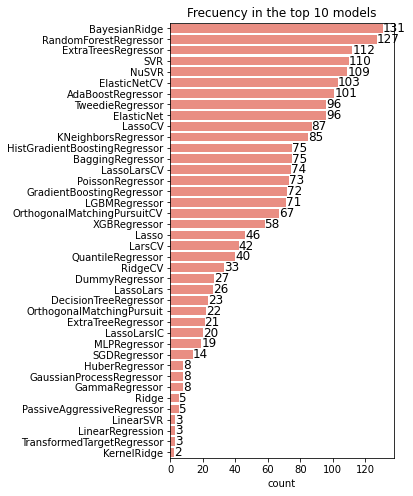

In [13]:
plt.figure(figsize=(4,8))
ax = sns.barplot(data = df_top10, x = "frequency", y = "keys", color = "salmon")
plt.ylabel("")
plt.xlabel("count")
plt.title("Frecuency in the top 10 models")
ax.bar_label(ax.containers[0], size = 12); 

NuSVR appears to be the best regression algorithm for this data 

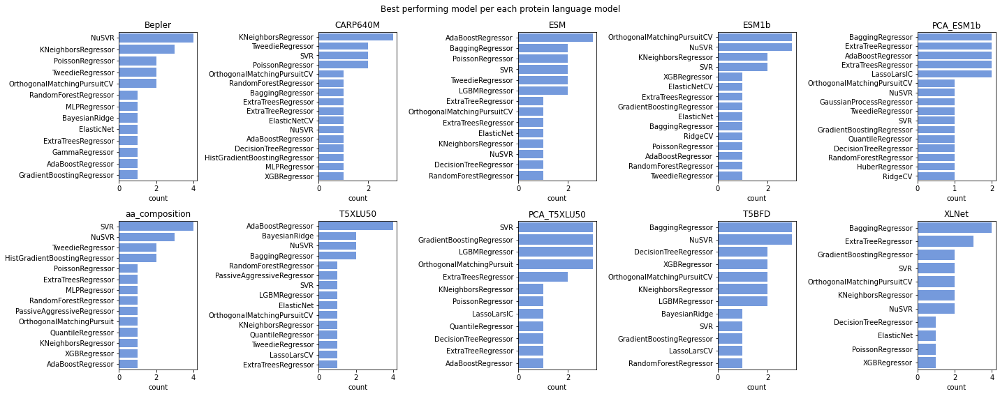

In [58]:
# create a plot of the most frecuent regressor per each plm
# list of unique plms 
model_names = df_metrics_all["model"].unique()

# set the fig composition
fig, axs = plt.subplots(ncols = 5, nrows = 2, figsize = (20,8))

for i, model in enumerate(model_names):

    # create the axis order
    row = i // 5
    col = i % 5
    ax = axs[row][col]
    
    # take the data of the corresponding pml
    data = df_metrics_all[df_metrics_all["model"] == model]
    
    # plot
    sns.countplot(data = data, y = "best_model", color = "cornflowerblue", ax = ax,
                  order = data["best_model"].value_counts().sort_values(ascending=False).index)
    ax.set_title(model)
    ax.set_ylabel("")
    plt.tight_layout()
    plt.suptitle("Best performing model per each protein language model")

## best plm 

In [28]:
filter_pearson = []
for df in meta_df:
    print(f"{df.model.unique()} = {len(df[df.pearson > 0.5])}")
    filter_pearson.append(len(df[df.pearson > 0.5]))

['Bepler'] = 16
['CARP640M'] = 18
['ESM'] = 17
['ESM1b'] = 19
['PCA_ESM1b'] = 15
['aa_composition'] = 13
['T5XLU50'] = 15
['PCA_T5XLU50'] = 16
['T5BFD'] = 18
['XLNet'] = 18


In [29]:
# compute meand and standard error of pearson
mean_pearson = []
error_pearson = []
for df in meta_df:
    print(f"{df.model.unique()} = {df.pearson.mean()} +/- {df.pearson.sem()}")
    mean_pearson.append(df.pearson.mean())
    error_pearson.append(df.pearson.sem())

['Bepler'] = 0.6104581954673527 +/- 0.030975052368383542
['CARP640M'] = 0.6534699766236803 +/- 0.03640339387730311
['ESM'] = 0.6519670795934479 +/- 0.03271306777377635
['ESM1b'] = 0.6382816284901909 +/- 0.03201197781388761
['PCA_ESM1b'] = 0.5969100307750904 +/- 0.05518878650656312
['aa_composition'] = 0.5600766879012778 +/- 0.04758460626471058
['T5XLU50'] = 0.604922418169973 +/- 0.044420921830335955
['PCA_T5XLU50'] = 0.605856220177171 +/- 0.04632305567761261
['T5BFD'] = 0.6644995569983668 +/- 0.03700179192709682
['XLNet'] = 0.6478629825610868 +/- 0.04069882347805285


In [30]:
filter_spearman = []
for df in meta_df:
    print(f"{df.model.unique()} = {len(df[df.spearman > 0.5])}")
    filter_spearman.append(len(df[df.spearman > 0.5]))

['Bepler'] = 12
['CARP640M'] = 15
['ESM'] = 17
['ESM1b'] = 13
['PCA_ESM1b'] = 14
['aa_composition'] = 15
['T5XLU50'] = 13
['PCA_T5XLU50'] = 16
['T5BFD'] = 16
['XLNet'] = 17


In [31]:
mean_spearman = []
error_spearman = []
for df in meta_df:
    print(f"{df.model.unique()} = {df.spearman.mean()} +/- {df.spearman.sem()}")
    mean_spearman.append(df.spearman.mean())
    error_spearman.append(df.spearman.sem())

['Bepler'] = 0.5556810114564202 +/- 0.031173284908490244
['CARP640M'] = 0.6052916889779498 +/- 0.02896078458764064
['ESM'] = 0.6017465044703956 +/- 0.028960200925028597
['ESM1b'] = 0.5484219075071047 +/- 0.031981286144517486
['PCA_ESM1b'] = 0.5317532930472135 +/- 0.043185765318952206
['aa_composition'] = 0.5552582074005032 +/- 0.044436123193820516
['T5XLU50'] = 0.5395018056583645 +/- 0.049633045092298614
['PCA_T5XLU50'] = 0.5706278188464627 +/- 0.04032042701513246
['T5BFD'] = 0.6259756720567354 +/- 0.040613423957298875
['XLNet'] = 0.5960646949310506 +/- 0.03676846793593792


In [32]:
df_best_plm = pd.DataFrame()
df_best_plm["model"] = ["Bepler","CARP640M","ESM","ESM1b","PCA_ESM1b","aa_composition","T5XLU50","PCA_T5XLU50","T5BFD","XLNet"]
df_best_plm["times_pearson"]  = filter_pearson
df_best_plm["times_spearman"] = filter_spearman
df_best_plm["mean_pearson"]   = mean_pearson
df_best_plm["mean_spearman"]  = mean_spearman
df_best_plm["error_pearson"]   = error_pearson
df_best_plm["error_spearman"]  = error_spearman
df_best_plm.sort_values("mean_spearman")

,model,times_pearson,times_spearman,mean_pearson,mean_spearman,error_pearson,error_spearman
4,PCA_ESM1b,15,14,0.60,0.53,0.06,0.04
6,T5XLU50,15,13,0.60,0.54,0.04,0.05
3,ESM1b,19,13,0.64,0.55,0.03,0.03
5,aa_composition,13,15,0.56,0.56,0.05,0.04
0,Bepler,16,12,0.61,0.56,0.03,0.03
7,PCA_T5XLU50,16,16,0.61,0.57,0.05,0.04
9,XLNet,18,17,0.65,0.60,0.04,0.04
2,ESM,17,17,0.65,0.60,0.03,0.03
1,CARP640M,18,15,0.65,0.61,0.04,0.03
8,T5BFD,18,16,0.66,0.63,0.04,0.04


Text(0, 0.5, 'Mean Pearson correlation')

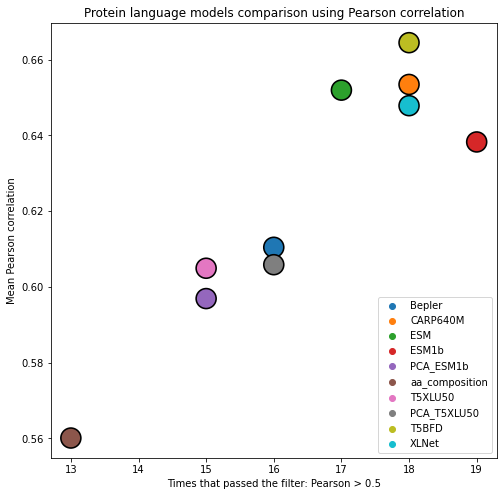

In [33]:
plt.figure(figsize=(8,8))
sns.scatterplot(
    data = df_best_plm, x = "times_pearson", y = "mean_pearson", hue = "model", s = 400, edgecolor = "black")
plt.legend(loc="lower right")
plt.title("Protein language models comparison using Pearson correlation")
plt.xlabel("Times that passed the filter: Pearson > 0.5")
plt.ylabel("Mean Pearson correlation")

Text(0, 0.5, 'Mean Spearman correlation')

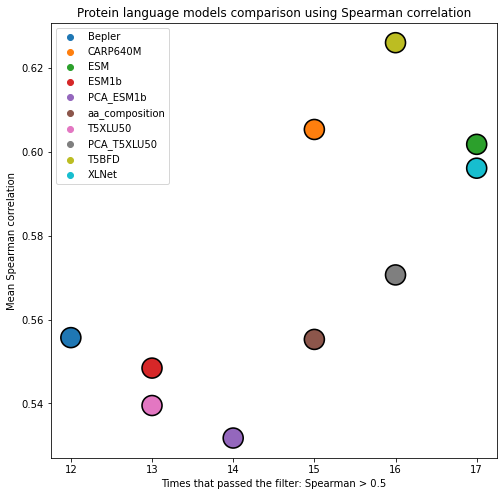

In [34]:
plt.figure(figsize=(8,8))
sns.scatterplot(
    data = df_best_plm, x = "times_spearman", y = "mean_spearman", hue = "model", s = 400, edgecolor = "black")
plt.legend(loc="upper left")
plt.title("Protein language models comparison using Spearman correlation")
plt.xlabel("Times that passed the filter: Spearman > 0.5")
plt.ylabel("Mean Spearman correlation")

In [ ]:
# from https://openreview.net/forum?id=gHwpv9pSEP2
# non-parametric distance-based model
# regularized linear model
# tree-based ensemble model
# mio: other 

# regularized = [
#     "SVR","NuSVR", "HuberRegressor", "LinearSVR", "RidgeCV", "BayesianRidge", "Ridge", "LinearRegression",
#     "ElasticNetCV", "LassoCV", "LassoLarsIC", "LassoLarsCV", "GeneralizedLinearRegressor", "ElasticNet", "Lasso",
#     "RANSACRegressor", "OrthogonalMatchingPursuitCV", "PassiveAggressiveRegressor", "OrthogonalMatchingPursuit", 
#     "LassoLars", "KernelRidge"
# ]
# 
# distance = [
#     "PoissonRegressor", "KNeighborsRegressor", "GammaRegressor", "TweedieRegressor",,,,,
# ]
# 
# tree = [
#     "BaggingRegressor","RandomForestRegressor","XGBRegressor", "ExtraTreesRegressor", "AdaBoostRegressor",
#     "HistGradientBoostingRegressor", "LGBMRegressor", "DecisionTreeRegressor", "ExtraTreeRegressor"
# ]
# 
# other = [
#     "GradientBoostingRegressor", "MLPRegressor", "TransformedTargetRegressor", "Lars", "LarsCV", "SGDRegressor",
#     "GaussianProcessRegressor", "DummyRegressor",
# ]
# 
# 
# filters = [df_metrics_all.model.str.contains('|'.join(regularized)), 
#            df_metrics_all.model.str.contains('|'.join(distance)),
#            df_metrics_all.model.str.contains('|'.join(tree)),
#            df_metrics_all.model.str.contains('|'.join(other))]
# 
# values = ["non-parametric distance-based model", "Cephalosporins", "Carbapenems", "Monobactams"]
# 
# df_metrics_all["anti_class"] = np.select(filters, values)
# df_metrics_all

Text(0.5, 0, '')

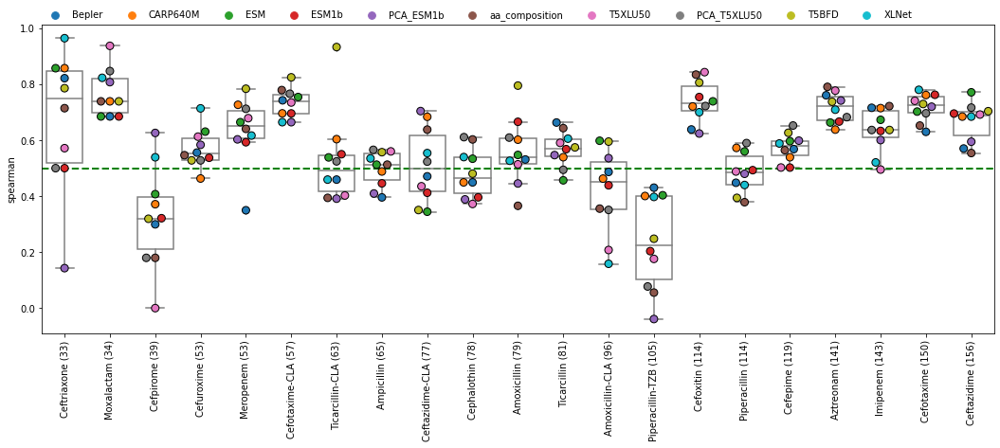

In [35]:
mods = {
    'boxprops':{'facecolor':'none', 'edgecolor':'grey'},
    'medianprops':{'color':'grey'},
    'whiskerprops':{'color':'grey'},
    'capprops':{'color':'grey'}
}

plt.figure(figsize=(18,6))
ax = sns.boxplot(x="anti_lab", y="spearman", data=df_metrics_all, color="lightgrey",  **mods)
plt.xticks(rotation = 90)
sns.swarmplot(x="anti_lab", y="spearman", data=df_metrics_all, hue="model", s=8, edgecolor="black", linewidth=1, ax=ax, alpha = 1)
plt.legend(loc = (0, 1), ncol=10 , frameon = False)
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.xlabel("")

Text(0.5, 0, '')

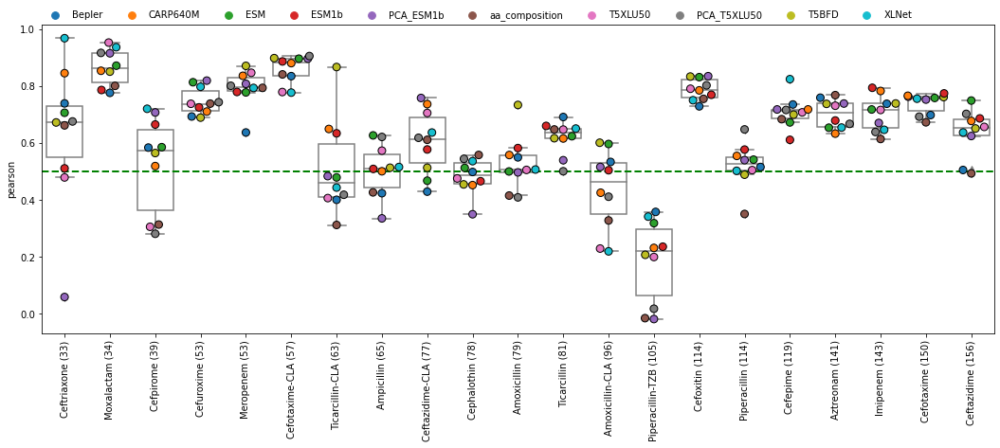

In [36]:
plt.figure(figsize=(18,6))
ax = sns.boxplot(x="anti_lab", y="pearson", data=df_metrics_all, color="lightgrey",  **mods)
plt.xticks(rotation = 90)
sns.swarmplot(x="anti_lab", y="pearson", data=df_metrics_all, hue="model", s=8, edgecolor="black", linewidth=1, ax=ax, alpha = 1)
plt.legend(loc = (0, 1), ncol=10 , frameon = False)
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.xlabel("")

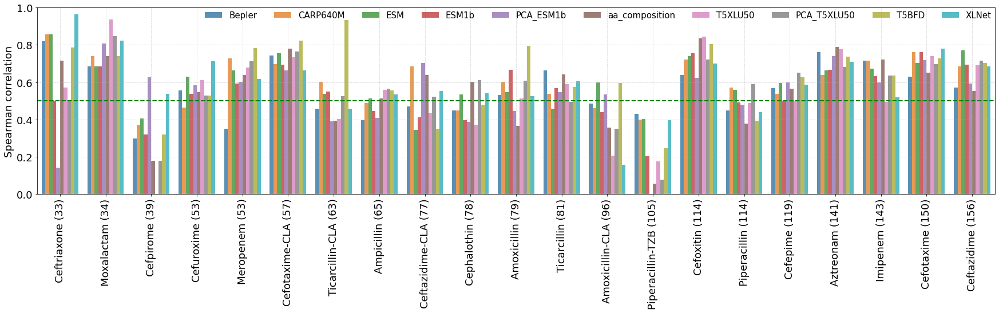

In [39]:
plt.figure(figsize=(30,6))
sns.barplot(
    data = df_metrics_all,
    x = "anti_lab", y = "spearman", palette="tab10", alpha = 0.8,
    hue = "model")
plt.grid(linestyle = "--", alpha = 0.5)
plt.xlabel("")
plt.ylabel("Spearman correlation",fontsize=18)
# plt.title("Serin betalactamases")
plt.xticks(rotation=90, fontsize=18)
plt.yticks(fontsize=18)
plt.ylim(0,1)
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.legend(ncol=10, borderaxespad=0, frameon = False, fontsize=15)

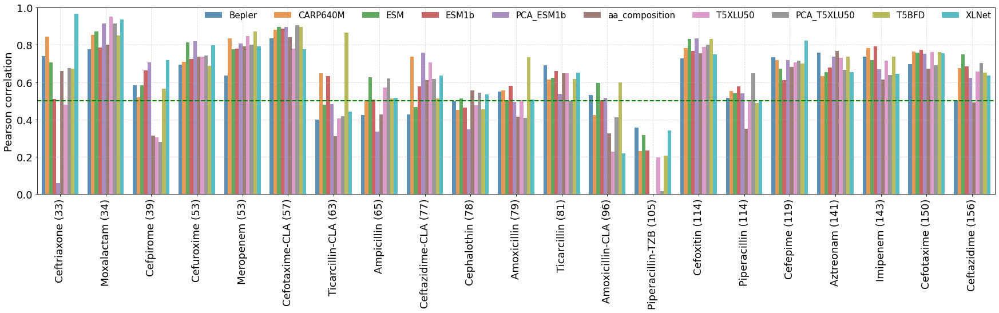

In [40]:
plt.figure(figsize=(30,6))
sns.barplot(
    data = df_metrics_all,
    x = "anti_lab", y = "pearson", palette="tab10", alpha = 0.8,
    hue = "model")
plt.grid(linestyle = "--", alpha = 0.5)
plt.xlabel("")
plt.ylabel("Pearson correlation",fontsize=18)
# plt.title("Serin betalactamases")
plt.xticks(rotation=90, fontsize=18)
plt.yticks(fontsize=18)
plt.ylim(0,1)
plt.axhline(0.5, color='green', linestyle='dashed', linewidth=2)
plt.legend(ncol=10, borderaxespad=0, frameon = False, fontsize=15)

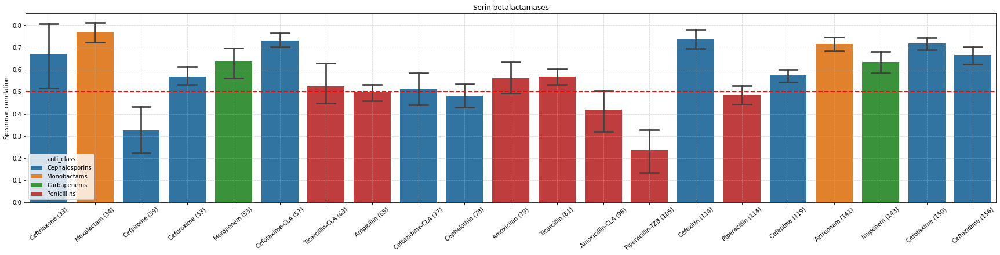

In [41]:
plt.figure(figsize=(30,6))
sns.barplot(
    data = df_metrics_all,
    x = "anti_lab", y = "spearman", dodge = False, capsize=.4,
    hue = "anti_class")
plt.xticks(rotation = 40)
plt.grid(linestyle = "--", alpha = 0.5)
plt.ylabel("Spearman correlation")
plt.xlabel("")
plt.title("Serin betalactamases")
plt.axhline(0.5, color='red', linestyle='dashed', linewidth=2)

Fin